In [112]:
import rasterio as rio
import os
import numpy as np
import matplotlib.pyplot as plt
import shutil
from scipy.interpolate import interp2d
import pandas as pd

from geogrid import GeogridOptical
from autoRIFT import autoRIFT
from osgeo import gdal, osr
import struct
import re
from datetime import date
import datetime
# import xml.etree.ElementTree as ET
# import urllib.request
import time
import subprocess
import cv2
import scipy.io as sio

from autorift_utilities import rio_write
# os.environ['PROJ_LIB'] = '/Users/jukesliu/opt/anaconda3/envs/newautoriftenv/share/proj'

gdal.AllRegister() # register all GDAL drivers

## 1) Resample DEM and other autoRIFT/geogrid input rasters to the desired chip size

Recommended chip size is >= 16*pixel_resolution

#### Customizable parameters for geogrid:

    dhdx, dhdy:              x/y local surface slope maps (unitless)
    vx,vy:                   x/y reference velocity maps (in units of m/yr)
    srx, sry:                x/y velocity search range limit maps (in units of m/yr)
    csminx, csminy:          x/y chip size minimum maps (in units of m; constant ratio between x and y)
    csmaxx, csmaxy:          x/y chip size maximum maps (in units of m; constant ratio between x and y)
    ssm:                     stable surface mask (boolean)

In [117]:
######### ENTER CHIP SIZE, DEM INFO, AND REFERENCE VELOCITY INFO ########### 
CHIPSIZE_M = 100 # enter in desired grid size in meters (default is 32 pixels)

# enter in the path to your best DEM over the region
# dempath = '/Volumes/SGlacier/TG_autorift_inputs/'
dempath = '/Volumes/SURGE_DISK/LO/'
demname = 'LO_ArcticDEM_clipped.tif'

# path to the reference files for geogrid (vx, vy, ssm)
# refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
refvpath =  '/Volumes/SURGE_DISK/LO/'
vx_fname = '' # name of reference vx file (if you don't have anything, use empty quotes)
vy_fname = '' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

### Check DEM (critical for georeferencing):

In [118]:
# Read and grab info from your DEM
refdem = rio.open(dempath+demname) # open DEM using rasterio
elev = refdem.read(1) # read in the first and only band (elevations)

# grab the x and y grid values from the DEM:
dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

# grab the resampled x and y grid values from the DEM
new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)

(393, 465)


/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/117720316.py:9: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/117720316.py:10: DeprecationWarning:         `interp2d` is deprecated!
        `interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

        For legacy code, nearly bug-for-bug compatible replacements are
        `RectBivariateSpline` on regular

Resampled to new dimensions: (393, 465)


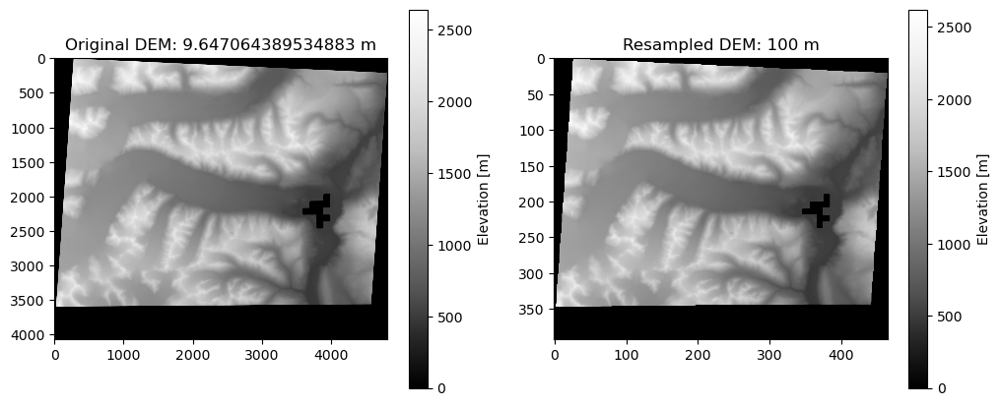

Save resampled DEM to /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif


In [119]:
dem_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m.tif'

if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
    # Create thew new x and y grid values using DEM bounds and the chipsize
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_resamp.shape)
    
    # Resample to your new DEM bounds
    f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
    dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
    dem_resamp = np.flipud(dem_resamp) # flip up down
    print("Resampled to new dimensions:",dem_resamp.shape)
    
    # Display the two DEMs as a visual check
    fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
    im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
    ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
    fig.colorbar(im1, ax=ax1,label='Elevation [m]')

    im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
    ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
    fig.colorbar(im2, ax=ax2,label='Elevation [m]')
    plt.show()
    
    # Save the resampled DEM to georeferenced tif file
    print("Save resampled DEM to", dempath+dem_outfile)
    rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
else:
    # load the empty grid
    dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
    print(dem_outfile, ' already exists.')

In [120]:
def generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling):
    import rasterio as rio
    import os
    
    # GRAB DEM INFO
    refdem = rio.open(dempath+demname) # open DEM using rasterio
    elev = refdem.read(1) # read in the first and only band (elevations)

    # grab the x and y grid values from the DEM:
    dem_x = np.linspace(refdem.bounds.left, refdem.bounds.right, num=np.shape(elev)[1])
    dem_y = np.linspace(refdem.bounds.top, refdem.bounds.bottom, num=np.shape(elev)[0])

    # grab the resampled x and y grid values from the DEM
    new_x = np.arange(refdem.bounds.left, refdem.bounds.right, CHIPSIZE_M)
    new_y = np.arange(refdem.bounds.top, refdem.bounds.bottom, -CHIPSIZE_M)
    
    # RESAMPLE THE DEM
    dem_outfile = demname[:-4]+'_'+str(CHIPSIZE_M)+'m.tif'
    if not os.path.exists(dempath+dem_outfile): # if the resampled DEM does not exist already
        # Create thew new x and y grid values using DEM bounds and the chipsize
        dem_resamp = np.zeros((len(new_y), len(new_x))) # create an empty resampled DEM grid
        print(dem_resamp.shape)

        # Resample to your new DEM bounds
        f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
        dem_resamp = f(new_x,new_y) # resample the NIR data to the DSM coordinates
        dem_resamp = np.flipud(dem_resamp) # flip up down
        print("Resampled to new dimensions:",dem_resamp.shape)

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(elev, cmap='Greys_r', vmin=0)
        ax1.set_title('Original DEM: '+str(refdem.transform[0])+' m') # original spatial resolution
        fig.colorbar(im1, ax=ax1,label='Elevation [m]')

        im2 = ax2.imshow(dem_resamp, cmap='Greys_r', vmin=0)
        ax2.set_title('Resampled DEM: '+str(CHIPSIZE_M)+' m') # new spatial resolution
        fig.colorbar(im2, ax=ax2,label='Elevation [m]')
        plt.show()

        # Save the resampled DEM to georeferenced tif file
        print("Save resampled DEM to", dempath+dem_outfile)
        rio_write(dempath+dem_outfile, dem_resamp, refdem, CHIPSIZE_M)
    else:
        # load the existing resampled DEM
        dem_r = rio.open(dempath+dem_outfile) # open DEM using rasterio
        dem_resamp = dem_r.read(1) # read in the first and only band (elevations)
        print(dem_outfile, ' already exists.')
    
    # CREATE DHDX, DHDY
    dhdx_outfile = demname[:-4]+'_dhdx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    dhdy_outfile = demname[:-4]+'_dhdy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if not os.path.exists(dempath+dhdx_outfile) or not os.path.exists(dempath+dhdy_outfile): # if either is missing
        # Produce dhdx and dhdy maps from resampled DEM
        dhdx = np.gradient(dem_resamp, axis=1)/CHIPSIZE_M
        dhdy = np.gradient(dem_resamp, axis=0)/CHIPSIZE_M

        # Filter out borders with high gradient values
        grad_thresh = 5
        dhdx[abs(dhdx) > grad_thresh] = 0; dhdy[abs(dhdy) > grad_thresh] = 0

        # absolute value of the max gradient values expected:
        dhmax = 1

        # Display the two DEMs as a visual check
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
        im1 = ax1.imshow(dhdx, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax1.set_title('dhdx') # surface slope x
        fig.colorbar(im1, ax=ax1)

        im2 = ax2.imshow(dhdy, cmap='Greys_r', vmin=-dhmax, vmax=dhmax)
        ax2.set_title('dhdy') # surface slope y
        fig.colorbar(im2, ax=ax2)
        plt.show()

        # Save the gradient maps to tif files
        print("Save surface slope maps to", dempath)
        rio_write(dempath+dhdx_outfile, dhdx, refdem, CHIPSIZE_M) # dhdx
        rio_write(dempath+dhdy_outfile, dhdy, refdem, CHIPSIZE_M)
    else:
        print(dhdy_outfile, 'and', dhdx_outfile, 'already exist.')

    # VX, VY, SRX, SRY
    vx_outfile = 'vx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    vy_outfile = 'vy_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    srx_outfile = 'srx_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    sry_outfile = 'sry_'+str(CHIPSIZE_M)+'m.tif' # generate new filename
    if vx_fname != '':
        if not os.path.exists(refvpath+vx_outfile) or not os.path.exists(refvpath+vy_outfile): # if either vx, vy missing
            # open the files with rasterio
            vx_reader = rio.open(refvpath+vx_fname); vx0 = vx_reader.read(1)
            vy_reader = rio.open(refvpath+vy_fname); vy0 = vy_reader.read(1)
            vx0[vx0 < -3e5] = 0
            vy0[vy0 < -3e5] = 0
            vx_x = np.linspace(vx_reader.bounds.left, vx_reader.bounds.right, num=np.shape(vx0)[1])
            vx_y = np.linspace(vx_reader.bounds.top, vx_reader.bounds.bottom, num=np.shape(vx0)[0])
            vy_x = np.linspace(vy_reader.bounds.left, vy_reader.bounds.right, num=np.shape(vy0)[1])
            vy_y = np.linspace(vy_reader.bounds.top, vy_reader.bounds.bottom, num=np.shape(vy0)[0])

            # Resample to the DEM grid
            fx = interp2d(vx_x, vx_y, vx0)
            fy = interp2d(vy_x, vy_y, vy0)
            vx_resamp = np.flipud(fx(new_x,new_y)) 
            vy_resamp = np.flipud(fy(new_x,new_y)) # flip up down

            # Display the two velocity files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(vx_resamp, cmap='Greys_r'); ax1.set_title('vx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(vy_resamp, cmap='Greys_r'); ax2.set_title('vy'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # CALCULATE SEARCH RANGE LIMITS MULTIPLY VX AND VY BY SOME NUMBER
            srx_resamp = vx_resamp*sr_scaling; sry_resamp = vy_resamp*sr_scaling

            # Display the two search range files as a visual check
            fig, (ax1,ax2) = plt.subplots(1,2, figsize=(12,5))
            im1 = ax1.imshow(srx_resamp, cmap='Greys_r'); ax1.set_title('srx'); fig.colorbar(im1, ax=ax1)
            im2 = ax2.imshow(sry_resamp, cmap='Greys_r'); ax2.set_title('sry'); fig.colorbar(im2, ax=ax2)
            plt.show()

            # save the reference velocity and search range maps
            rio_write(refvpath+vx_outfile, vx_resamp, refdem, CHIPSIZE_M) # vx
            rio_write(refvpath+vy_outfile, vy_resamp, refdem, CHIPSIZE_M) # vy
            rio_write(refvpath+srx_outfile, srx_resamp, refdem, CHIPSIZE_M) # srx
            rio_write(refvpath+sry_outfile, sry_resamp, refdem, CHIPSIZE_M) # sry
        else:
            print(vx_outfile, ',', vy_outfile, ',', srx_outfile, ',', sry_outfile, 'already exist.')  
    
    # MASKS
    ssm_outfile = 'ssm_'+str(CHIPSIZE_M)+'m.tif' # generate new filename

    if not os.path.exists(refvpath+ssm_outfile):  # overwrite all
        if os.path.exists(refvpath+'ice_mask_200mbuffer.tif'):
            # read it in, process (resample, mask, etc.) and resave
            ssmreader = rio.open(refvpath+'ice_mask_200mbuffer.tif')
            ssm = ssmreader.read(1)
            ssm[ssm > 0] = 1; #ssm[ssm < 0.0] = 0; # make binary
            ssm = ssm < 1 # find all stable areas (where.tif = 0)

            # do the same for Turner Glacier mask
            tgreader = rio.open(refvpath+'TG_mask.tif'); tg_mask = tgreader.read(1)
            tg_mask[tg_mask > 0] = 1; tg_mask = tg_mask > 0


            # grab x and y-values
            ssm_x = np.linspace(ssmreader.bounds.left, ssmreader.bounds.right, num=np.shape(ssm)[1])
            ssm_y = np.linspace(ssmreader.bounds.top, ssmreader.bounds.bottom, num=np.shape(ssm)[0])

            # Resample to the DEM grid
            f_ssm = interp2d(ssm_x, ssm_y, ssm)
            ssm_resamp = np.flipud(f_ssm(new_x,new_y))

            # plot
            fig, ax = plt.subplots(1,1)
            ssm_im = ax.imshow(ssm_resamp,cmap='gray',vmin=0)
            ax.set_title('Stable Surface Mask')
            fig.colorbar(ssm_im, ax=ax)
            plt.show()

            # export
            rio_write(refvpath+ssm_outfile, ssm_resamp, refdem, CHIPSIZE_M)
    else:
        print(ssm_outfile,'already exists.')
    
    return dem_outfile, dhdx_outfile, dhdy_outfile, #vx_outfile, vy_outfile, srx_outfile, sry_outfile, ssm_outfile
        

GMTED2010N70_UTM33_clipped_100m.tif  already exists.


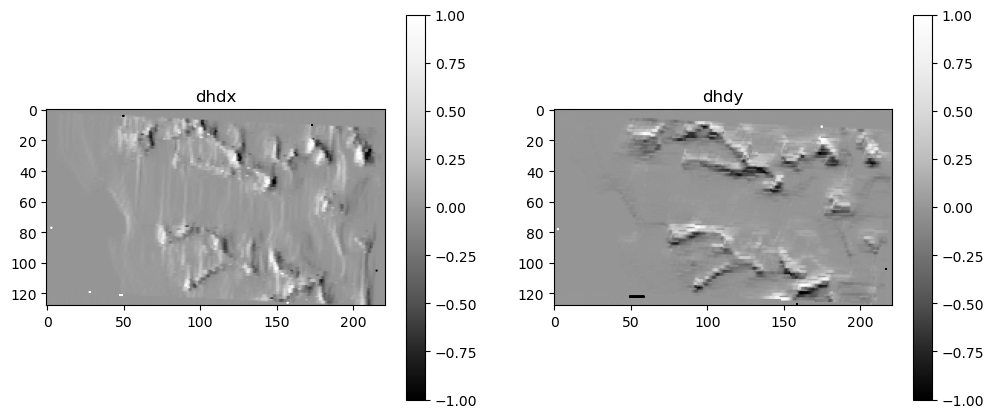

Save surface slope maps to /Volumes/SGlacier 1/AV/


('GMTED2010N70_UTM33_clipped_100m.tif',
 'GMTED2010N70_UTM33_clipped_dhdx_100m.tif',
 'GMTED2010N70_UTM33_clipped_dhdy_100m.tif')

In [57]:
# # # ONE CHIPSIZE:
generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)

# # MANY CHIPSIZES:
# # for CHIPSIZE_M in [100,150,160,200,300,350,400]:
# for CHIPSIZE_M in [100,200,300]:
#     generate_geogrid_inputs(CHIPSIZE_M, dempath, demname, refvpath, vx_fname, vy_fname, sr_scaling)
#     print(); print()

# # COULD MAKE AN EQUIVALENT LOOP FOR MAY SEARCH RANGE SCALING FACTORS - FIND OPTIMAL PARAMATERS

## 2) Run geogrid with resampled DEM and other inputs

In [138]:
###### SET PATH PROCESSING PATHS ##########################
out_path = '/Users/jukesliu/Desktop/TEST_out/' # output file path

# # LS test:
# imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/'
# im1_name = 'LC08_L1TP_062018_20200401_20200410_01_T1_B8_BufferTurner.TIF'
# im2_name = 'LC08_L1TP_062018_20200417_20200423_01_T1_B8_BufferTurner.TIF'
# img_type = 'OPT'

# S2 test:
# imgpath = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/'
# im1_name = 'S2A_7VEG_20200427_B08_clipped.tif'
# im2_name = 'S2A_7VEG_20200510_B08_clipped.tif'
# img_type = 'OPT'

# # PS test:
imgpath = '/Volumes/SGlacier/TG_2020/NEW_TRY/'
im1_name = 'PS_20200306.tif'
im2_name = 'PS_20200312.tif'
img_type = 'OPT'

#########################################################

In [157]:
def run_geogrid_inhouse(out_path, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                        dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm): # optional inputs
    import rasterio as rio
    import os
    
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    ############ Clear all old geogrid files ##########################
    for file in os.listdir(out_path):
        if file.startswith('window') and file.endswith('.tif'):
            print('removed', file)
            os.remove(out_path+file)
    print('Old files cleared.'); print()

    dem_info = gdal.Info(dem, format='json') # grab info from DEM
    print('Obtained DEM info.'); print()
    ############ Run geogrid optical  ##########################
    print('Processing optical images with geogrid.'); print()
    obj = GeogridOptical() # initialize geogrid object

    ############ Coregister the optical data (from coregisterLoadMetadataOptical) #############
    x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s, 0)

    # grab dates from file names
    im1_name = indir_m.split('/')[-1]; im2_name = indir_s.split('/')[-1]
    if im1_name.startswith('L') and im2_name.startswith('L'):
        ds1 = im1_name.split('_')[3]
        ds2 = im2_name.split('_')[3]
    elif 'S2' in im1_name and 'S2' in im2_name:
        ds1 = im1_name.split('_')[2]
        ds2 = im2_name.split('_')[2]
    elif 'PS' in im1_name and 'PS' in im2_name:
        ds1 = im1_name.split('_')[1]
        ds2 = im2_name.split('_')[1]
    else:
        raise Exception('Optical data NOT supported yet!') 
    print('Optical images coregistered.'); print()

    ########### Load geogrid inputs and run (from runGeogridOptical) ################

    # grab info from above
    print(ds1, ds2)
    obj.startingX = trans[0]; obj.startingY = trans[3]
    obj.XSize = trans[1]; obj.YSize = trans[5]
    d0 = datetime.date(int(ds1[0:4]),int(ds1[4:6]),int(ds1[6:8]))
    d1 = datetime.date(int(ds2[0:4]),int(ds2[4:6]),int(ds2[6:8]))
    date_dt_base = d1 - d0
    obj.repeatTime = date_dt_base.total_seconds()
    obj.numberOfLines = ysize1; obj.numberOfSamples = xsize1
    obj.gridSpacingX = dem_info['geoTransform'][1] # output grid spacing is the same as the DEM

    # customize no data value and minimimum chip size
    obj.nodata_out = NO_DATA_VAL
    obj.chipSizeX0 = MINCHIPSIZE

    # set raster paths and names
    obj.dat1name = indir_m # first image
    obj.demname = dem # DEM
    obj.dhdxname = dhdx; obj.dhdyname = dhdy # surface slope
    obj.vxname = vx; obj.vyname = vy # reference velocity
    obj.srxname = srx; obj.sryname = sry # search range limits
    obj.csminxname = csminx; obj.csminyname = csminy # min chip size
    obj.csmaxxname = csmaxx; obj.csmaxyname = csmaxy # max chip size
    obj.ssmname = ssm # stable surface mask
    obj.winlocname = "window_location.tif"
    obj.winoffname = "window_offset.tif"
    obj.winsrname = "window_search_range.tif"
    obj.wincsminname = "window_chip_size_min.tif"
    obj.wincsmaxname = "window_chip_size_max.tif"
    obj.winssmname = "window_stable_surface_mask.tif"
    obj.winro2vxname = "window_rdr_off2vel_x_vec.tif"
    obj.winro2vyname = "window_rdr_off2vel_y_vec.tif"

    obj.runGeogrid() # RUN GEOGRID
    print('Optical geogrid finished.'); print()

    ############ Move files produced to the out_path directory ##############
    for file in os.listdir(os.getcwd()):
        if file.startswith('window') and file.endswith('.tif'):
            shutil.move(os.getcwd()+'/'+file, out_path+file)
    print('Geogrid output files moved')

### Set custom Geogrid parameters

     input "dhdxname"/"dhdyname"                          -> output "winro2vxname"/"winro2vyname"
     input "dhdxname"/"dhdyname" and "vxname"/"vyname"    -> output "winro2vxname"/"winro2vyname" and "winoffname" 
     input "dhdxname"/"dhdyname" and "srxname"/"sryname"  -> output "winro2vxname"/"winro2vyname" and "winsrname"
     input "csminxname"/"csminyname"                      -> output "wincsminname"
     input "csmaxxname"/"csmaxyname"                      -> output "wincsmaxname"
     input "ssmname"                                      -> output "winssmname"

#### Best  MINCHIPSIZE >= SCALAR*PIXRES where SCALAR = 16 or some other power of 2

    LS = 200
    S2 = 160
    PS = 100

In [ ]:
# ###### SET CUSTOM PARAMETERS FOR GEOGRID ################
# dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
# indir_m = imgpath+im1_name
# indir_s = imgpath+im2_name
# out_path = '/Volumes/SGlacier/TEST_out/'
# MINCHIPSIZE = 100 # smallest chip size allowed in image horizontal direction (in m)
# NO_DATA_VAL = -32767 # no data value in the output products
# temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

# if MINCHIPSIZE > CHIPSIZE_M:
#     warning = 'Your minimum chip size for autoRIFT exceeds the output grid size (CHIPSIZE_M). '
#     warning += 'Please increase the resampled DEM gridsize (CHIPSIZE_M).'
#     print(warning)

# # optional inputs (set as '' to leave blank)
# dhdx = dempath+dhdx_outfile
# dhdy = dempath+dhdy_outfile
# # vx = refvpath+vx_outfile
# # vy = refvpath+vy_outfile
# # srx = refvpath+srx_outfile
# # sry = refvpath+sry_outfile
# # csminx = refvpath+csminx_fname
# # csminy = refvpath+csminy_fname
# # csmaxx = refvpath+csmaxx_fname
# # csmaxy = refvpath+csmaxy_fname
# # ssm = refvpath+ssm_outfile # stable surface mask 

# # dhdx = ''
# # dhdy = ''
# vx = ''
# vy = ''
# srx = ''
# sry = ''
# csminx = ''
# csminy = ''
# csmaxx = ''
# csmaxy = ''
# ssm = ''
# #########################################################

In [ ]:
# run_geogrid_inhouse(out_path, img_type, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
#                     dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm, # optional inputs
#                     temp_dir)

## 3) Run autoRIFT with new parameters

In [70]:
# identify files produced from geogrid
gp = out_path

# remove all empty grids
for grid in os.listdir(gp): 
    if grid.startswith('window') and grid.endswith('.tif'):
        reader = rio.open(gp+grid) # read dataset
        data_found = False 
        for band in range(1,reader.count+1):
            testband = reader.read(band) # read in the band
            if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                data_found = True
        if not data_found:
            print(grid, 'has no data. Removed.')
            os.remove(gp+grid)
        else:
            print(grid)

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/SGlacier/VG/autorift_output_VG/'

In [71]:
# fill in AutoRIFT parameters using the files - make all of these function arguments
mpflag = 0 # leave multiprocessing off

# GRID LOCATION (required) from window_location.tif
grid_location = rio.open(gp+'window_location.tif')
xGrid = grid_location.read(1) # 1st band in window location
yGrid = grid_location.read(2) # 2nd band in window location

# optional parameters (default None or zero until filled)
init_offset = None; search_range = None
chip_size_min = None; chip_size_max = None
offset2vx = None; offset2vy = None; stable_surface_mask = None
Dx0 = None; Dy0 = None; CSMINx0 = None
SRx0 = None; SRy0 = None;
CSMAXx0 = None; CSMAXy0 = None; SSM = None
noDataMask = np.zeros(xGrid.shape).astype(int)

if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
    init_offset = rio.open(gp+'window_offset.tif')
    Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
    search_range = rio.open(gp+'window_search_range.tif')
    SRx0 = search_range.read(1); SRy0 = search_range.read(2)
if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
    chip_size_min = rio.open(gp+'window_chip_size_min.tif')
    CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
    chip_size_max = rio.open(gp+'window_chip_size_max.tif')
    CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
    offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
    offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
    stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
    noDataMask = stable_surface_mask.read(1)
    
# other parameters
nodata = NO_DATA_VAL # use same as in previous steps
geogrid_run_info=None
print('AutoRIFT parameters loaded.')

RasterioIOError: /Volumes/SGlacier/VG/autorift_output_VG/window_location.tif: No such file or directory

In [ ]:
######################### CHOOSE FILTERS & SAMPLING ########################
# Filters:
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'WAL'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
############################################################################
print('Filters and autoRIFT sample rates chosen.')

In [159]:
# AutoRIFT  
def run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATIO, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodataval, geogrid_run_info):
    CHIPSIZE_M = MINCHIPSIZE # set minimum chip size equal
    
    # requires grid location from geogrid
    origSize = xGrid.shape # grab original size from xGrid
    
    print('Processing optical images with autoRIFT.'); print()
    optflag = 1 # turn on optical flag
    # Coregister and read in the two images (from loadProductOptical())
    obj = GeogridOptical()
    x1a, y1a, xsize1, ysize1, x2a, y2a, xsize2, ysize2, trans = obj.coregister(indir_m, indir_s, 0)

    # read dates from filenames
    indir_m = indir_m.split('/')[-1]; indir_s = indir_s.split('/')[-1]
    if 'LC0' in indir_m and 'LC0' in indir_s:
        ds1 = indir_m.split('_')[3]; ds2 = indir_s.split('_')[3]
        sat = 'LS'
    elif 'S2' in indir_m and 'S2' in indir_s:
        ds1 = indir_m.split('_')[2]; ds2 = indir_s.split('_')[2]
        sat = 'S2'
    elif 'PS' in indir_m and 'PS' in indir_s:
        ds1 = indir_m.split('_')[1]
        ds2 = indir_s.split('_')[1]
        sat = 'PS'
    else:
        raise Exception('Data type NOT supported yet!')
        
            
    print('DATES: ')
    print(ds1, ds2); print(sat)

    # read in the images
    DS1 = gdal.Open(indir_m); DS2 = gdal.Open(indir_s)
    I1 = DS1.ReadAsArray(xoff=x1a, yoff=y1a, xsize=xsize1, ysize=ysize1)
    I1 = I1.astype(np.float32)
    I2 = DS2.ReadAsArray(xoff=x2a, yoff=y2a, xsize=xsize2, ysize=ysize2)
    I2 = I2.astype(np.float32)
    DS1=None; DS2=None # clear DS1 and DS2

#     # Initialize autoRIFT object (from runAutorift())
#     obj = autoRIFT()
# #         obj.configure()

        
    ############# Initialize autoRIFT object (from runAutorift()) ##################
    obj = autoRIFT()
#     obj.configure()
    
    obj.MultiThread = mpflag # multiprocessing
    obj.I1 = I1; obj.I2 = I2 # assign the images
    obj.xGrid = xGrid; obj.yGrid = yGrid # assign the grid 

    # GENERATE NO DATA MASK
    # where offset searching will be skipped based on 
    # 1) imported nodata mask and/or 2) zero values in the image
    for ii in range(obj.xGrid.shape[0]):
        for jj in range(obj.xGrid.shape[1]):
            if (obj.yGrid[ii,jj] != nodata)&(obj.xGrid[ii,jj] != nodata):
                if (I1[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0)|(I2[obj.yGrid[ii,jj]-1,obj.xGrid[ii,jj]-1]==0):
                    noDataMask[ii,jj] = True
                    
    # SEARCH RANGE
    if SRx0 is None:
        # default is a zero array
#        ###########     uncomment to customize SearchLimit based on velocity distribution 
        if Dx0 is not None:
            obj.SearchLimitX = np.int32(4+(25-4)/(np.max(np.abs(Dx0[np.logical_not(noDataMask)]))-np.min(np.abs(Dx0[np.logical_not(noDataMask)])))*(np.abs(Dx0)-np.min(np.abs(Dx0[np.logical_not(noDataMask)]))))
        else:
            obj.SearchLimitX = 15
        obj.SearchLimitY = 15
#        ###########
        obj.SearchLimitX = obj.SearchLimitX * np.logical_not(noDataMask)
        obj.SearchLimitY = obj.SearchLimitY * np.logical_not(noDataMask)
    else:
        obj.SearchLimitX = SRx0
        obj.SearchLimitY = SRy0
       ############ add buffer to search range
        obj.SearchLimitX[obj.SearchLimitX!=0] = obj.SearchLimitX[obj.SearchLimitX!=0] + 2
        obj.SearchLimitY[obj.SearchLimitY!=0] = obj.SearchLimitY[obj.SearchLimitY!=0] + 2
    
    # CHIP SIZE
    if CSMINx0 is not None:
        obj.ChipSizeMaxX = CSMAXx0
        obj.ChipSizeMinX = CSMINx0
        
        gridspacingx = MINCHIPSIZE # use the grid spacing from above
        chipsizex0 = MINCHIPSIZE
        pixsizex = trans[1] # grab from coregister function
    
        obj.ChipSize0X = int(np.ceil(chipsizex0/pixsizex/4)*4)
        obj.GridSpacingX = int(obj.ChipSize0X*gridspacingx/chipsizex0)

        RATIO_Y2X = CSMINy0/CSMINx0
        obj.ScaleChipSizeY = np.median(RATIO_Y2X[(CSMINx0!=nodata)&(CSMINy0!=nodata)])
#         obj.ScaleChipSizeY = 1 # USE SCALE OF 1 for square pixels
    else:
        if ((optflag == 1)&(xGrid is not None)):
            obj.ChipSizeMaxX = 32 # pixels
            obj.ChipSizeMinX = 16 # pixels
            obj.ChipSize0X = 16 # pixels
    
    # DOWNSTREAM SEARCH OFFSET
    if Dx0 is not None:
        obj.Dx0 = Dx0
        obj.Dy0 = Dy0
    else:
        obj.Dx0 = obj.Dx0 * np.logical_not(noDataMask)
        obj.Dy0 = obj.Dy0 * np.logical_not(noDataMask)

    # REPLACE NO DATA VALUES WITH 0
    obj.xGrid[noDataMask] = 0
    obj.yGrid[noDataMask] = 0
    obj.Dx0[noDataMask] = 0
    obj.Dy0[noDataMask] = 0
    if SRx0 is not None:
        obj.SearchLimitX[noDataMask] = 0
        obj.SearchLimitY[noDataMask] = 0
    if CSMINx0 is not None:
        obj.ChipSizeMaxX[noDataMask] = 0
        obj.ChipSizeMinX[noDataMask] = 0
    
    # convert azimuth offset to vertical offset as used in autoRIFT convention for SAR images
    if optflag == 0:
        obj.Dy0 = -1 * obj.Dy0
        
    ############## AutoRIFT Pre-processing (from runAutorift()) ############################
    t1 = time.time()
    print("Pre-process Start!!!")
    
    # FILTERING:
    if FILTER == 'WAL': 
        obj.preprocess_filt_wal() # WALLIS FILTER
#         obj.zeroMask = 1 # removes edges
        obj.WallisFilterWidth = WALLISFILTERWIDTH # optional, default supposedly 21
    elif FILTER == 'HPS':
        obj.preprocess_filt_hps() # HIGH PASS FILTER
    elif FILTER == 'SOB':
        obj.preprocess_filt_sob() # SOBEL FILTER
    elif FILTER == 'LAP':
        obj.preprocess_filt_lap()
    elif FILTER == 'DB':
        obj.preprocess_db() # LOGARITHMIC OPERATOR (NO FILTER), FOR TOPOGRAPHY
    else:
        print(FILTER, 'not recognized. Using default high pass filter instead.')
        obj.preprocess_filt_hps() # HIGH PASS FILTER
        
    print("Pre-process Done!!!")
    print(time.time()-t1)
    
    # CONVERT TO UNIFORM DATA TYPE
    t1 = time.time()
#    obj.DataType = 0
    obj.uniform_data_type()
    print("Uniform Data Type Done!!!")
    print(time.time()-t1)
    
    # OTHER :
    obj.sparseSearchSampleRate = 1
#    obj.colfiltChunkSize = 4

    obj.OverSampleRatio = 64
    if CSMINx0 is not None:
        obj.OverSampleRatio = {obj.ChipSize0X:16,obj.ChipSize0X*2:32,obj.ChipSize0X*4:64,obj.ChipSize0X*8:64}
    
    # SEE ORIGINAL CODE TO EXPORT PREPROCESSED IMAGES
    
    ####################### Run AutoRIFT (from runAutorift())  ############################
    t1 = time.time()
    print("AutoRIFT Start!!!")
    obj.runAutorift()
    print("AutoRIFT Done!!!")
    print(time.time()-t1)
    
    kernel = np.ones((3,3),np.uint8)
    noDataMask = cv2.dilate(noDataMask.astype(np.uint8),kernel,iterations = 1)
    noDataMask = noDataMask.astype(np.bool)

    # AT THIS POINT, THESE VARIABLES WILL BE CREATED:
    # obj.Dx, obj.Dy, obj.InterpMask, obj.ChipSizeX, obj.GridSpacingX, 
    # obj.ScaleChipSizeY, obj.SearchLimitX, obj.SearchLimitY, obj.origSize, noDataMask
    
    # PLOT RESULTS
    fig, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(15,5))
    im1 = ax1.imshow(obj.Dx); ax1.set_title('Dx'); fig.colorbar(im1, ax=ax1)
    im2 = ax2.imshow(obj.Dy); ax2.set_title('Dy'); fig.colorbar(im2, ax=ax2)
    im3 = ax3.imshow(np.sqrt((obj.Dx**2) + (obj.Dy**2))); ax3.set_title('D_total'); fig.colorbar(im3,ax=ax3)
    plt.suptitle(ds1+' to '+ds2)
    plt.show()

    ####################### Write outputs (from runAutorift())  ############################
    t1 = time.time()
    print("Write Outputs Start!!!")
          
    # Write text file with parameters
    f =  open(out_path+'parameters_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.txt', 'w')
    f.write('Geogrid/AutoRIFT parameters for offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.tif:')
    f.write('NO_DATA_VAL: '+str(NO_DATA_VAL))
    f.write('Min chip size: '+str(MINCHIPSIZE))
    f.write('DEM: '+dem)
    f.write('dhdx: '+dhdx); f.write('dhdy: '+dhdy)
    f.write('vx: '+vx); f.write('vy: '+vy)
    f.write('srx: '+srx); f.write('sry: '+sry)
    f.write('csminx: '+csminx); f.write('csminy: '+csminy)
    f.write('csmaxx: '+csmaxx); f.write('csmaxy: '+csmaxy)
    f.write('stable surface mask: '+ssm)
    f.write('FILTER: '+FILTER)
    f.write('WALLISFILTERWIDTH: '+str(WALLISFILTERWIDTH))
    f.write('Spare search sample rate: '+str(SPARSE_SEARCH_SAMPLE_RATE))
    f.write('Oversample ratio: '+str(OVERSAMPLE_RATIO))
    if offset2vx is not None and offset2vy is not None:
        f.write('Velocity.TIF file created.')
    else:
        f.write('Velocity.TIF not created.')
    f.close() # close the parameter text file
          
    # open the window_location.tif file to gdalinfo
    ds = gdal.Open(gp+'window_location.tif')
    tran = ds.GetGeoTransform()
    proj = ds.GetProjection()
    srs = ds.GetSpatialRef()
    
    # initialize arrays
    DX = np.zeros(origSize,dtype=np.float32) * np.nan; DY = np.zeros(origSize,dtype=np.float32) * np.nan
    INTERPMASK = np.zeros(origSize,dtype=np.float32); CHIPSIZEX = np.zeros(origSize,dtype=np.float32)
    SEARCHLIMITX = np.zeros(origSize,dtype=np.float32); SEARCHLIMITY = np.zeros(origSize,dtype=np.float32)
    
    # fill in arays
    Dx = obj.Dx; Dy = obj.Dy; InterpMask = obj.InterpMask; ChipSizeX = obj.ChipSizeX
    SearchLimitX = obj.SearchLimitX; SearchLimitY = obj.SearchLimitY
    DX[0:Dx.shape[0],0:Dx.shape[1]] = Dx;  DY[0:Dy.shape[0],0:Dy.shape[1]] = Dy
    INTERPMASK[0:InterpMask.shape[0],0:InterpMask.shape[1]] = InterpMask
    CHIPSIZEX[0:ChipSizeX.shape[0],0:ChipSizeX.shape[1]] = ChipSizeX
    SEARCHLIMITX[0:SearchLimitX.shape[0],0:SearchLimitX.shape[1]] = SearchLimitX
    SEARCHLIMITY[0:SearchLimitY.shape[0],0:SearchLimitY.shape[1]] = SearchLimitY
    
    # mask out no data
    DX[noDataMask] = np.nan; DY[noDataMask] = np.nan
    INTERPMASK[noDataMask] = 0; CHIPSIZEX[noDataMask] = 0
    SEARCHLIMITX[noDataMask] = 0; SEARCHLIMITY[noDataMask] = 0
    if SSM is not None:
        SSM[noDataMask] = False
    DX[SEARCHLIMITX == 0] = np.nan; DY[SEARCHLIMITX == 0] = np.nan
    INTERPMASK[SEARCHLIMITX == 0] = 0; CHIPSIZEX[SEARCHLIMITX == 0] = 0
    if SSM is not None:
        SSM[SEARCHLIMITX == 0] = False

    # SAVE TO OFFSET.MAT FILE
    sio.savemat('offset_'+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+'.mat', # offset mat filename
                {'Dx':DX,'Dy':DY,'InterpMask':INTERPMASK,'ChipSizeX':CHIPSIZEX})
    print('Offset.mat written.')
    
    # CREATE THE GEOTIFFS
    driver = gdal.GetDriverByName('GTiff')
    
    # OFFSET.TIF
    outRaster = driver.Create("offset_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # offset filename
                              int(xGrid.shape[1]), int(xGrid.shape[0]), 5, gdal.GDT_Float32)
    outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj) # projections
    outband = outRaster.GetRasterBand(1); outband.WriteArray(DX) # DX
    outband.FlushCache()
    outband = outRaster.GetRasterBand(2); outband.WriteArray(DY) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((DX**2) + (DY**2))) # DY
    outband.FlushCache()
    outband = outRaster.GetRasterBand(4); outband.WriteArray(INTERPMASK) # INTERPMASK
    outband.FlushCache()
    outband = outRaster.GetRasterBand(5); outband.WriteArray(CHIPSIZEX) # CHIPSIZE
    outband.FlushCache()
    del outRaster
    print('Offset.tif written.')
    
    # VELOCITY.TIF
    if offset2vx is not None and offset2vy is not None:
        ds = gdal.Open(offset2vx) #### VX
        band = ds.GetRasterBand(1); offset2vx_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vx_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2vr = band.ReadAsArray()
        else:
                offset2vr = None
        band=None; ds=None
        offset2vx_1[offset2vx_1 == nodata] = np.nan
        offset2vx_2[offset2vx_2 == nodata] = np.nan

        ds = gdal.Open(offset2vy) #### VY
        band = ds.GetRasterBand(1); offset2vy_1 = band.ReadAsArray()
        band = ds.GetRasterBand(2); offset2vy_2 = band.ReadAsArray()
        if ds.RasterCount > 2:
                band = ds.GetRasterBand(3)
                offset2va = band.ReadAsArray()
        else:
                offset2va = None
        band=None; ds=None
        offset2vy_1[offset2vy_1 == nodata] = np.nan; offset2vy_2[offset2vy_2 == nodata] = np.nan
        
        if offset2va is not None:
            offset2va[offset2va == nodata] = np.nan

        VX = offset2vx_1 * DX + offset2vx_2 * DY
        VY = offset2vy_1 * DX + offset2vy_2 * DY
        VX = VX.astype(np.float32); VY = VY.astype(np.float32)

        outRaster = driver.Create("velocity_"+ds1+'_'+ds2+'_'+str(CHIPSIZE_M)+'m_'+sat+".tif", # velocity filename
                                  int(xGrid.shape[1]), int(xGrid.shape[0]), 3, gdal.GDT_Float32)
        outRaster.SetGeoTransform(tran); outRaster.SetProjection(proj)
        outband = outRaster.GetRasterBand(1); outband.WriteArray(VX) # VX
        outband.FlushCache()
        outband = outRaster.GetRasterBand(2); outband.WriteArray(VY) # VY
        outband.FlushCache()
        outband = outRaster.GetRasterBand(3); outband.WriteArray(np.sqrt((VX**2) + (VY**2))) # V
        outband.FlushCache()
        del outRaster
        print('Velocity.tif written.')
    
    print("Write Outputs Done!!!")
    print(time.time()-t1)
    
    # Move files produced to the out_path directory
    for file in os.listdir(os.getcwd()):
        if 'offset' in file or ('velocity' in file and '.tif' in file):
            shutil.move(os.getcwd()+'/'+file, out_path+file)

In [ ]:
# run autoRIFT with function
run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, OVERSAMPLE_RATIO, MINCHIPSIZE,
                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                         noDataMask, nodata, geogrid_run_info)

# 4) Run geogrid and autoRIFT on all images in a folder

## Check that the image files and dates are being read correctly

In [221]:
s2path = '/Volumes/SGlacier/S2_MZ/' # input S2 images
LSpath = '/Volumes/SGlacier/LS_MZ/' # input LS images
PSpath = '/Volumes/SGlacier/MZ_PS_noncloudy/'

# s2path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel2/' # input S2 images
# LS8path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/LS8images/useable_images/' # input LS8 images
# PSpath = '/Volumes/SGlacier/PS_March2020/'
# S1path = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/'
# PSpath = '/Volumes/SGlacier/surge_projects/Working_clipped_2019/'
# boxpath = '/Users/surging/Documents/TG/BoxTurner/BoxTurner_UTM_07.shp' # the shapefile for Turner
# autoriftpath = '/Users/surging/Documents/TG/autoRIFT/' # path to the autorift scripts
# vmap_path = '/Users/surging/Documents/TG/vmap_test/' # output velocity map folder
# basepath = '/Users/surging/Documents/TG/optical-offset-tracking/' # path where this script is located

######### Set minimum and maximum time separation and the platform (L8, S2, PS, S1) ###############
platform = 'S2'
startdate = '20130101' # inclusive start date
enddate = '20240101' # inclusive end date
min_dt = 14 # minimum time separation between images
max_dt = 60 # maximum time separation between images
###############################################################################################

In [222]:
# assign the folder path based on the platform
if platform == 'S2': # sentinel-2
    path = s2path
    ext = '_clipped.tif' # image filename extension
    img_type = 'OPT'
    date_split_idx = 2 # split filename by underscore, index corresponds to image date
elif platform == 'LS': # landsat 8
    path = LSpath
    ext = '.TIF'
    img_type = 'OPT'
    date_split_idx = 3
elif platform == 'PS': # PlanetScope
    path = PSpath
    ext = '.tif'  
    img_type = 'OPT'
    date_split_idx = 1
else:
    print('Platform', platform, 'not recognized. Options are "S2", "LS", "PS"')

# record all possible images and their dates
dates = []; files = []  
for file in os.listdir(path):
    if file.endswith(ext):
        date = file.split('_')[date_split_idx] # grab the date from the filename
        dates.append(date); files.append(file) # store the date and filename
files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
files_df

,filename,date
0,S2B_42SYH_20200119_B08_clipped.tif,20200119
1,S2B_42SYH_20200129_B08_clipped.tif,20200129
2,S2B_42SYH_20200208_B08_clipped.tif,20200208
3,S2A_42SYH_20200223_B08_clipped.tif,20200223
4,S2B_42SYH_20200228_B08_clipped.tif,20200228
...,...,...
78,S2A_42SYH_20211204_B08_clipped.tif,20211204
79,S2B_42SYH_20211209_B08_clipped.tif,20211209
80,S2A_42SYH_20211214_B08_clipped.tif,20211214
81,S2A_42SYH_20211224_B08_clipped.tif,20211224


In [223]:
# filter out those before and afte the input start and end date
files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
files_df = files_df.reset_index(drop=True) # reset index for searching
files_df

,filename,date
0,S2B_42SYH_20200119_B08_clipped.tif,20200119
1,S2B_42SYH_20200129_B08_clipped.tif,20200129
2,S2B_42SYH_20200208_B08_clipped.tif,20200208
3,S2A_42SYH_20200223_B08_clipped.tif,20200223
4,S2B_42SYH_20200228_B08_clipped.tif,20200228
...,...,...
78,S2A_42SYH_20211204_B08_clipped.tif,20211204
79,S2B_42SYH_20211209_B08_clipped.tif,20211209
80,S2A_42SYH_20211214_B08_clipped.tif,20211214
81,S2A_42SYH_20211224_B08_clipped.tif,20211224


In [219]:
# for rownum in range(0,len(files_df)-1):
#     if rownum == 0: # for the first row, idx1 = 0 and idx2 = 1
#         idx1 = rownum
#     idx2 = idx1+1 # reset index 2 as the next item 

#     if idx1 < len(files_df) and idx2 < len(files_df): # don't surpass the end of the data
#         # identify the successive image pairs:
#         m = files_df.loc[idx1,'filename']; 

#         # grab the two dates and convert to datetime objects
#         d1s = m.split('_')[date_split_idx]; 
#         d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); 
        
        
#         # grab the dt days for all files after the first date
#         files_df['dt'] = (pd.to_datetime(files_df.date,format='%Y%m%d') - d1).dt.days
#         # grab all those that have the correct date:
#         match_df = files_df[(files_df.dt >= min_dt) & (files_df.dt <= max_dt)] 
#         if len(match_df) > 0: # if files are found with the correct date separation, continue
#             for idx, row in match_df.iterrows():
#                 # grab the secondary image
#                 s = row.filename
#                 d2s = s.split('_')[date_split_idx]
#                 d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
#                 dt = d2-d1; dt = int(dt.days)

#                 # run 
#                 print(d1s, d2s)
#         else: # otherwise
#             print('No image pair with correct time separation found. Skip to next.')
            
            
#     idx1 += 1 # just go to the next available image
#     if idx2 >= len(files_df)-1:
#         print('Finished searching.')
#         break

In [148]:
# # drop duplicate dates for S2, keep the original over the PS imitation
# if platform == 'S2':
#     unique_dates = list(set(files_df.date))
#     for date in unique_dates:
#         date_df = files_df[files_df.date == date]
#         if len(date_df) > 1: # if there's a duplicate
#             for idx, row in date_df.iterrows():
#                 if row.filename.startswith('S2P'):
#                     files_df = files_df.drop(idx)
# files_df

## Set final run parameters and paths

In [224]:
CHIPSIZE_LIST = [200] # chipsizes to run [meters]
PLATFORM_LIST = ['S2','LS','PS'] # LS, S2 or PS or any combination of the two

In [225]:
########## PARAMETERS FOR GEOGRID #################################################### 
# out_path = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/output_AutoRIFT/' # output file path
out_path = '/Volumes/SGlacier/MZ_autorift_output_allpairs_dt14to60/' # output file path
dem = dempath+dem_outfile # path to the resampled DEM produced in the previous step (outfile name)
#             MINCHIPSIZE = CHIPSIZE_M # smallest chip size allowed in image horizontal direction (in m)
#             print(MINCHIPSIZE)
NO_DATA_VAL = -32767 # no data value in the output products
temp_dir = '/Users/jukesliu/Documents/TURNER/DATA/IMAGERY/sentinel1/coreg_files/'

# PARAMETERS FOR AUTORIFT CHOSEN
# options are HPS (high pass), WAL (wallis), SOB (sobel), DB (logarithmic operator)
FILTER = 'HPS'
WALLISFILTERWIDTH = 32 # only for wallis filter, must be a power of 2

# Sampling:
SPARSE_SEARCH_SAMPLE_RATE = 16 # how many samples to skip to speed up processing
OVERSAMPLE_RATIO = 0 # enter in a constant scalar or 0 for default parameters
print('Filters and autoRIFT sample rates chosen.')
############################################################################################

Filters and autoRIFT sample rates chosen.


In [226]:
######### ENTER DEM INFO, AND REFERENCE VELOCITY INFO ########### 
# enter in the path to your best DEM over the region
# # dempath = '/Users/jukesliu/Documents/TURNER/DATA/ICE_THICKNESS/surface/DEMs_previous/'
dempath = '/Volumes/SGlacier/MZ/' 
demname = 'SRTM_1arc_v3_UTM42_clipped.tif'

# path to the reference files for geogrid (vx, vy, ssm)
# refvpath = '/Users/jukesliu/Documents/TURNER/DATA/VELOCITY_MAPS/forAutoRIFT/' 
# vx_fname = 'vx_cropped.tif' # name of reference vx file
# vy_fname = 'vy_cropped.tif' # name of reference vy file
refvpath = '/Volumes/SGlacier/MZ/' 
# refvpath = '/Volumes/SGlacier/TG_autorift_inputs/' 
vx_fname = '' # name of reference vx file
vy_fname = '' # name of reference vy file

sr_scaling = 16 # multiply by vx and vy to generate search range limits
############################################################################

## Run all possible pairs of images:

Number of files found: 83
(54, 72)
Resampled to new dimensions: (54, 72)


/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/11044236.py:25: DeprecationWarning: `interp2d` is deprecated!
`interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

For legacy code, nearly bug-for-bug compatible replacements are
`RectBivariateSpline` on regular grids, and `bisplrep`/`bisplev` for
scattered 2D data.

In new code, for regular grids use `RegularGridInterpolator` instead.
For scattered data, prefer `LinearNDInterpolator` or
`CloughTocher2DInterpolator`.

For more details see
`https://gist.github.com/ev-br/8544371b40f414b7eaf3fe6217209bff`

  f = interp2d(dem_x, dem_y, elev) # create DEM interpolation object
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/11044236.py:26: DeprecationWarning:         `interp2d` is deprecated!
        `interp2d` is deprecated in SciPy 1.10 and will be removed in SciPy 1.12.0.

        For legacy code, nearly bug-for-bug compatible replacements are
        `RectBivariateSpline` on regular 

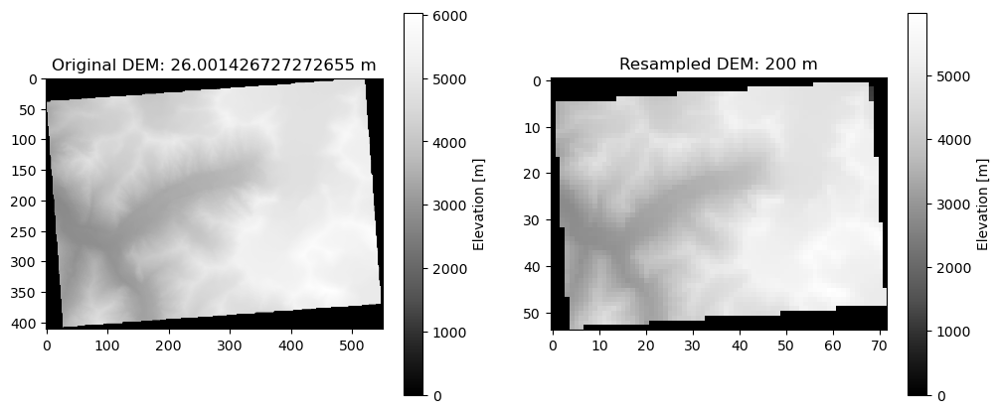

Save resampled DEM to /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif


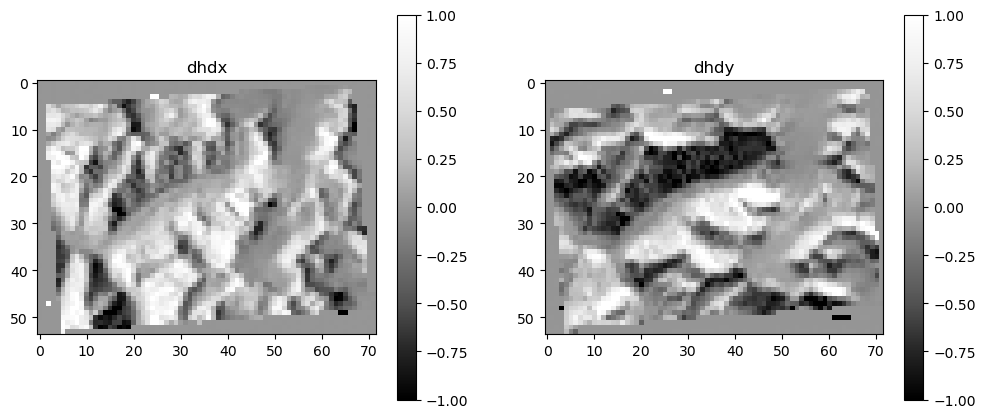

Save surface slope maps to /Volumes/SGlacier/MZ/
20200119 20200208
S2B_42SYH_20200119_B08_clipped.tif S2B_42SYH_20200208_B08_clipped.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200208

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x vector: window_rdr_off2vel_x_vec.tif
Window rdr_off2vel_y vector: window_rdr_off2vel_y_vec.tif
Output Nodata Value: -32767



/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1541869640350342


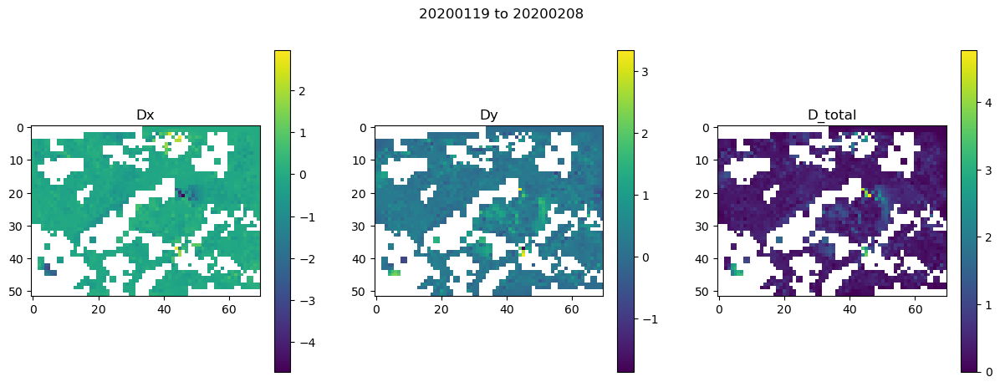

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019671916961669922
20200119 20200223
S2B_42SYH_20200119_B08_clipped.tif S2A_42SYH_20200223_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200223

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

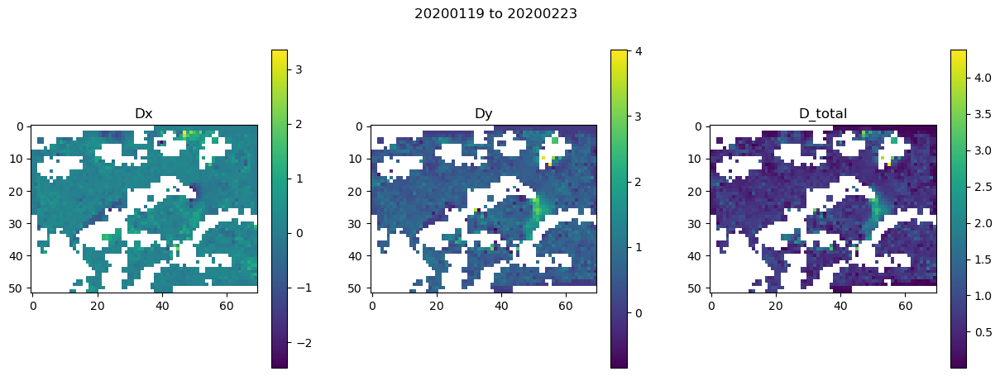

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01845240592956543
20200119 20200228
S2B_42SYH_20200119_B08_clipped.tif S2B_42SYH_20200228_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200228

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

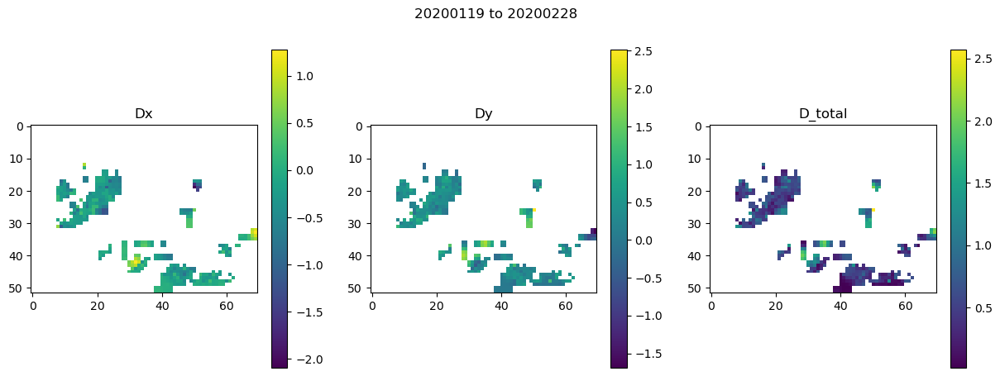

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01734614372253418
20200119 20200304
S2B_42SYH_20200119_B08_clipped.tif S2A_42SYH_20200304_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200304

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

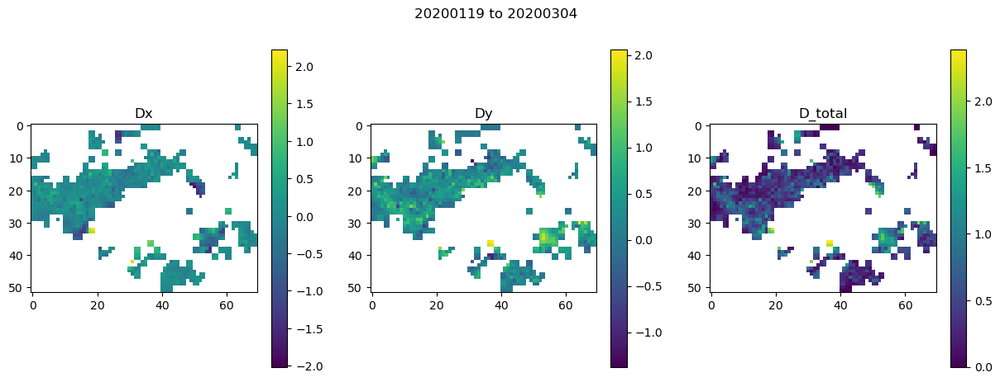

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01740288734436035
20200119 20200309
S2B_42SYH_20200119_B08_clipped.tif S2B_42SYH_20200309_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200309

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

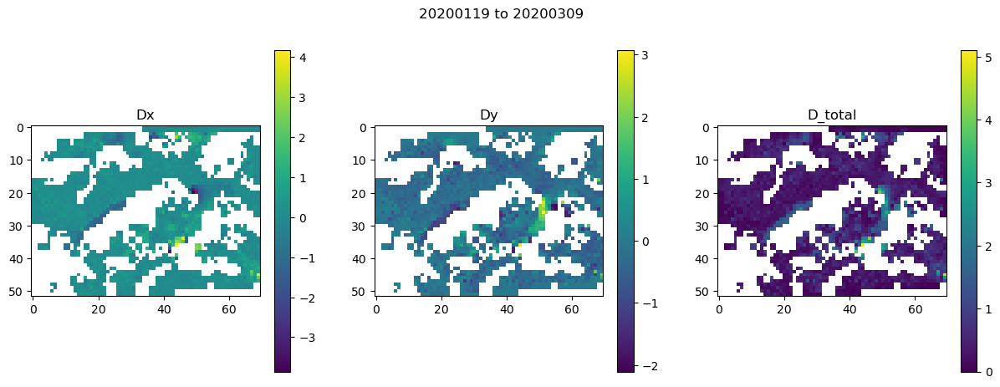

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017555952072143555
20200119 20200314
S2B_42SYH_20200119_B08_clipped.tif S2A_42SYH_20200314_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200314

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

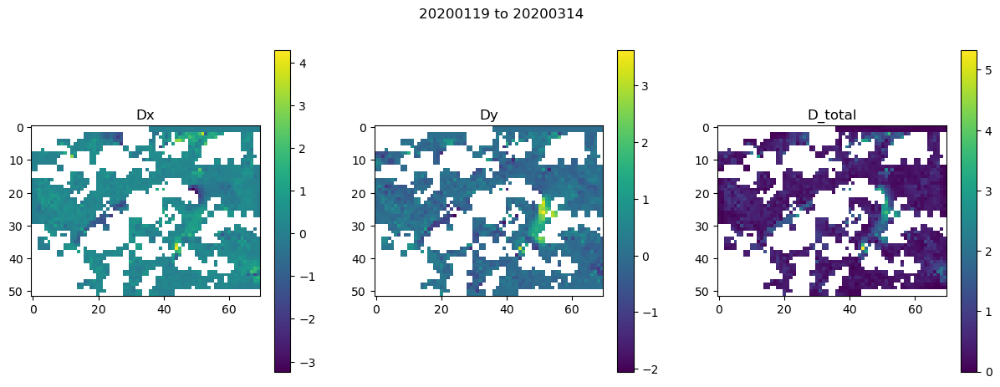

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017084836959838867
20200119 20200319
S2B_42SYH_20200119_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200119 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

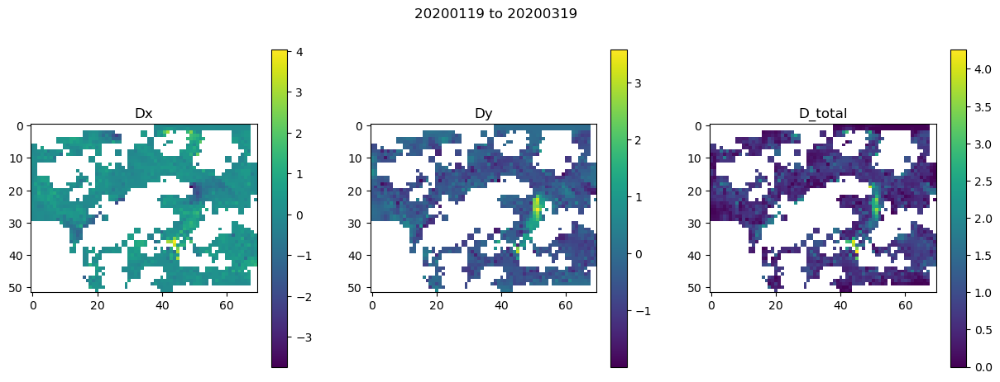

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017982959747314453
20200129 20200223
S2B_42SYH_20200129_B08_clipped.tif S2A_42SYH_20200223_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200223

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1250348091125488


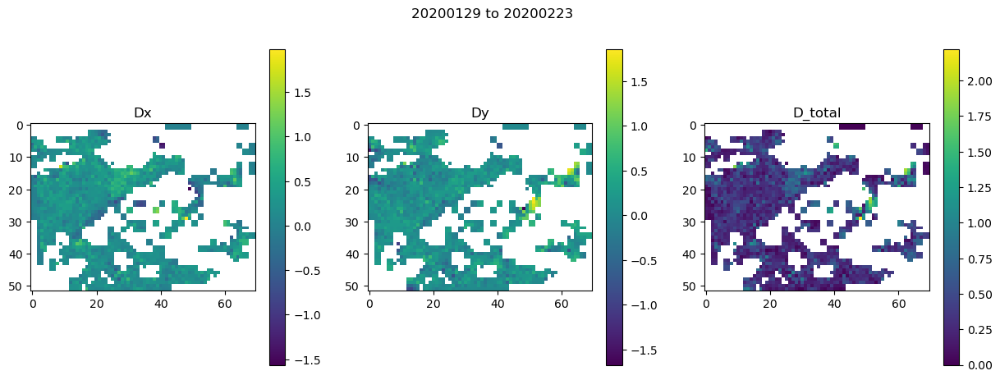

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017837047576904297
20200129 20200228
S2B_42SYH_20200129_B08_clipped.tif S2B_42SYH_20200228_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200228

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

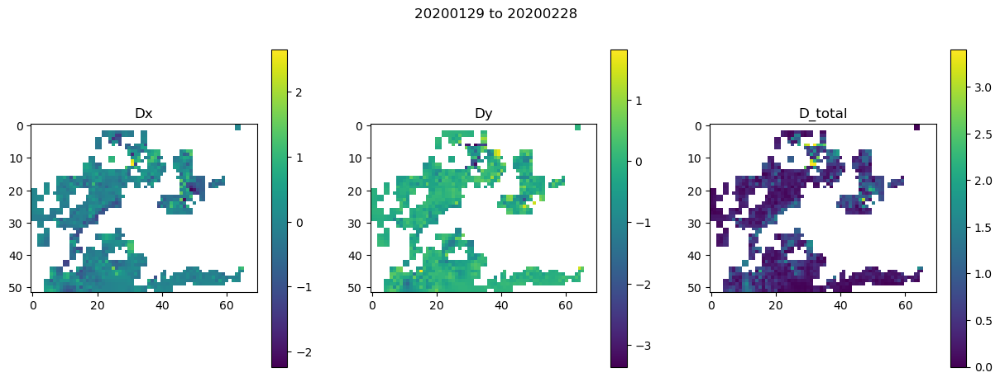

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019073009490966797
20200129 20200304
S2B_42SYH_20200129_B08_clipped.tif S2A_42SYH_20200304_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200304

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

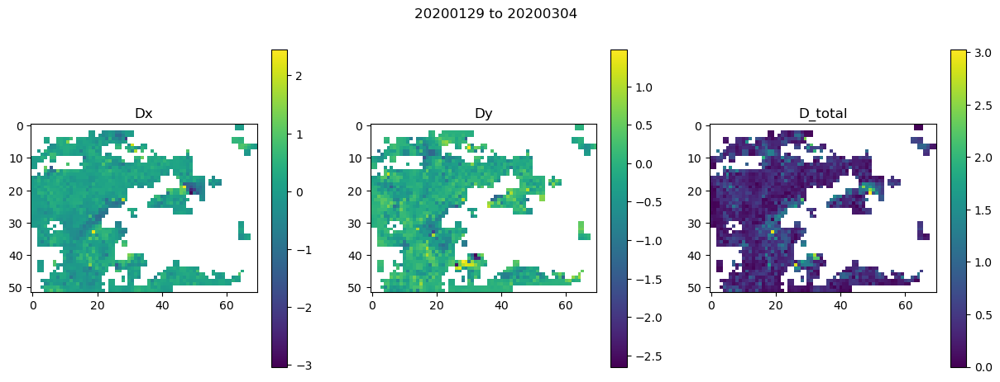

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01846480369567871
20200129 20200309
S2B_42SYH_20200129_B08_clipped.tif S2B_42SYH_20200309_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200309

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

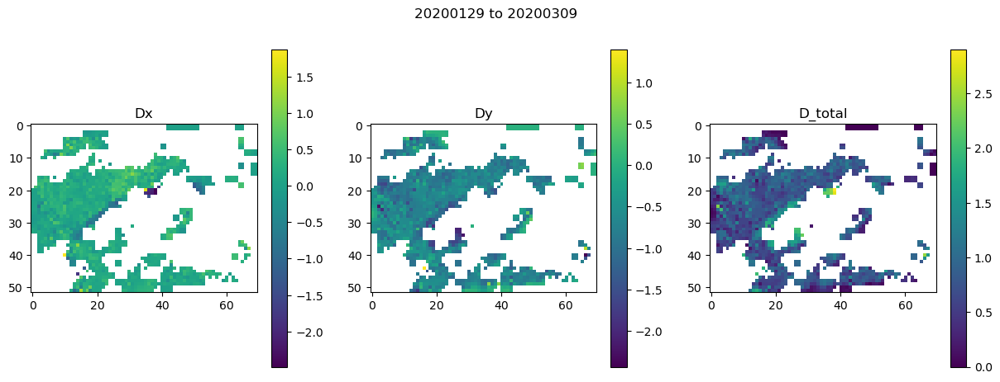

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01974797248840332
20200129 20200314
S2B_42SYH_20200129_B08_clipped.tif S2A_42SYH_20200314_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200314

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

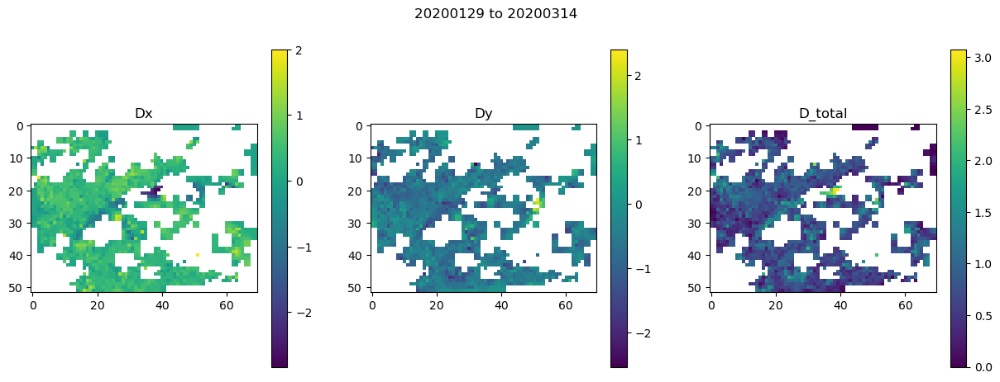

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01777195930480957
20200129 20200319
S2B_42SYH_20200129_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

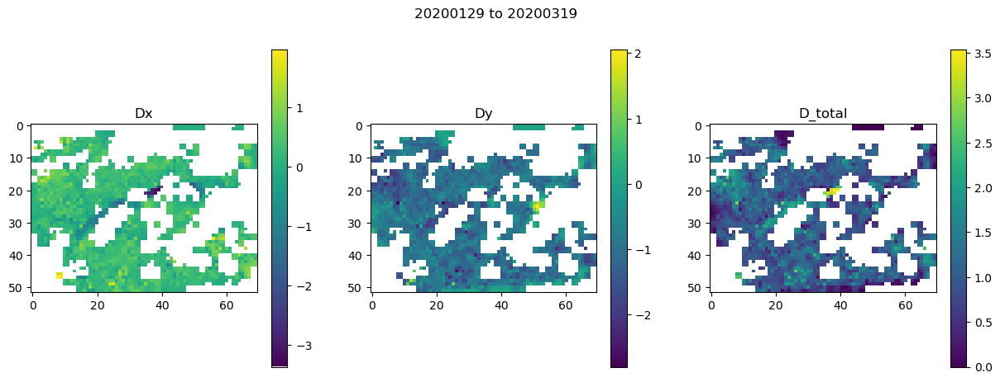

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016089200973510742
20200129 20200329
S2B_42SYH_20200129_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200129 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

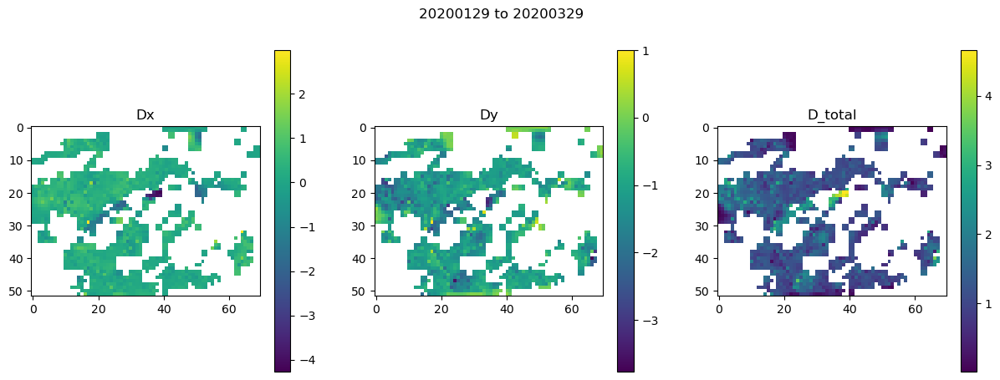

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016187191009521484
20200208 20200223
S2B_42SYH_20200208_B08_clipped.tif S2A_42SYH_20200223_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200223

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0874760150909424


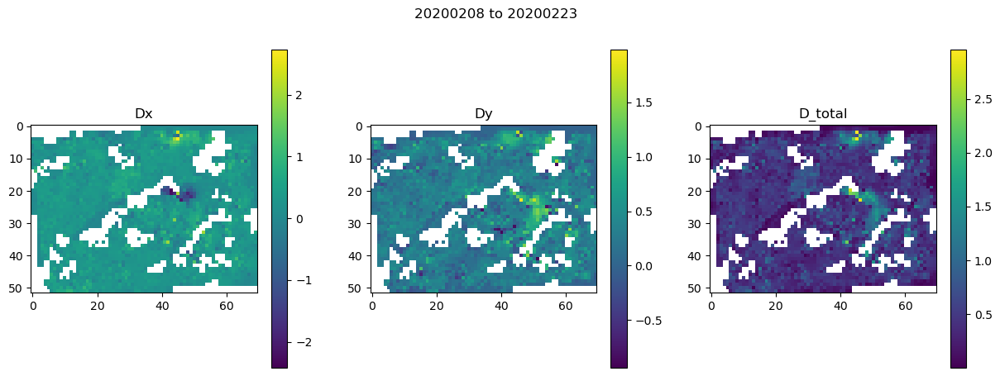

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01772284507751465
20200208 20200228
S2B_42SYH_20200208_B08_clipped.tif S2B_42SYH_20200228_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200228

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

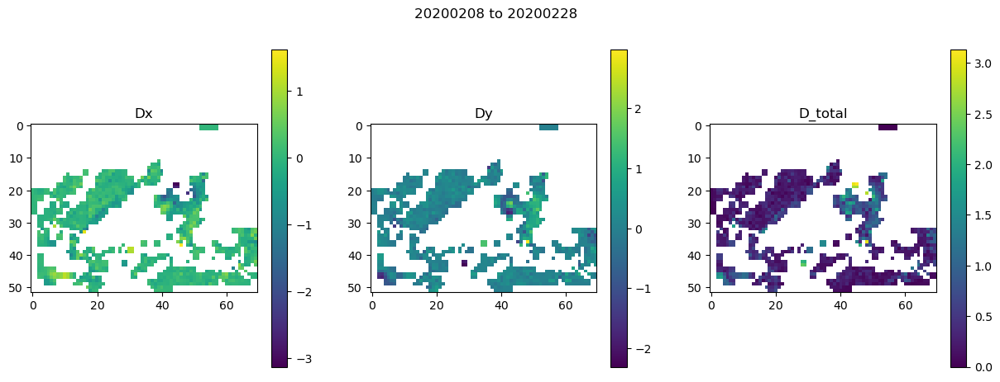

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016267061233520508
20200208 20200304
S2B_42SYH_20200208_B08_clipped.tif S2A_42SYH_20200304_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200304

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

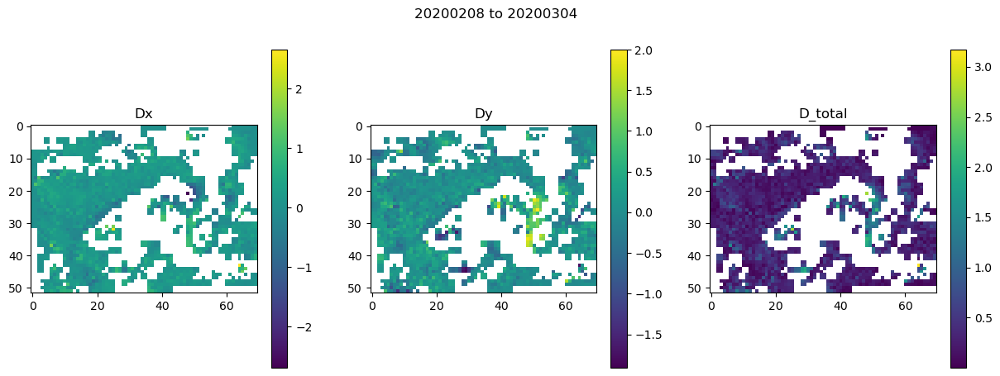

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018018007278442383
20200208 20200309
S2B_42SYH_20200208_B08_clipped.tif S2B_42SYH_20200309_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200309

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

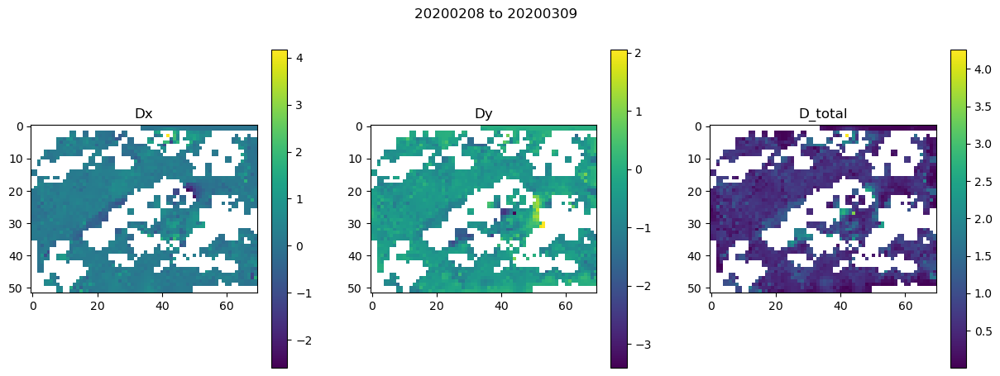

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01768803596496582
20200208 20200314
S2B_42SYH_20200208_B08_clipped.tif S2A_42SYH_20200314_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200314

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

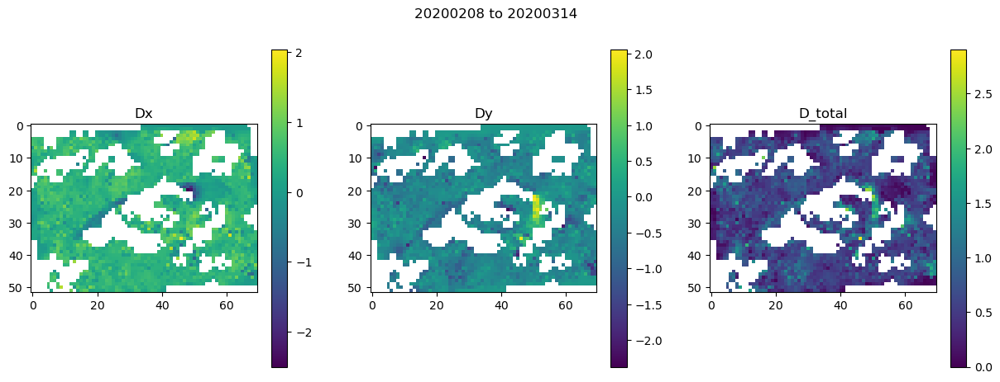

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01881694793701172
20200208 20200319
S2B_42SYH_20200208_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

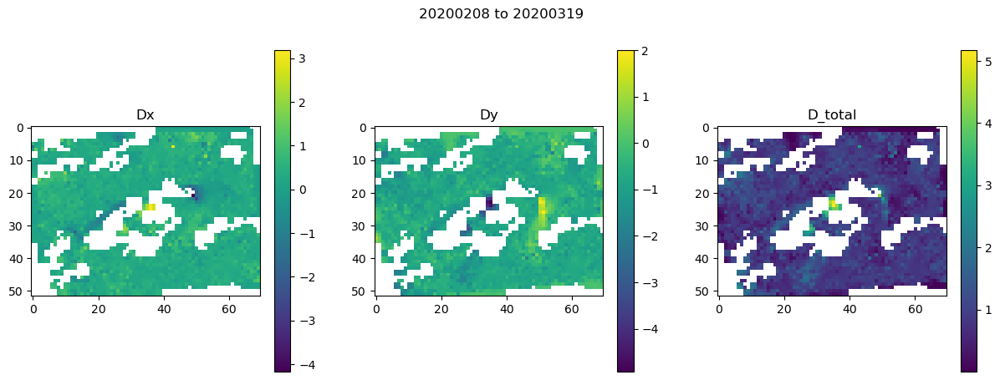

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017950057983398438
20200208 20200329
S2B_42SYH_20200208_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

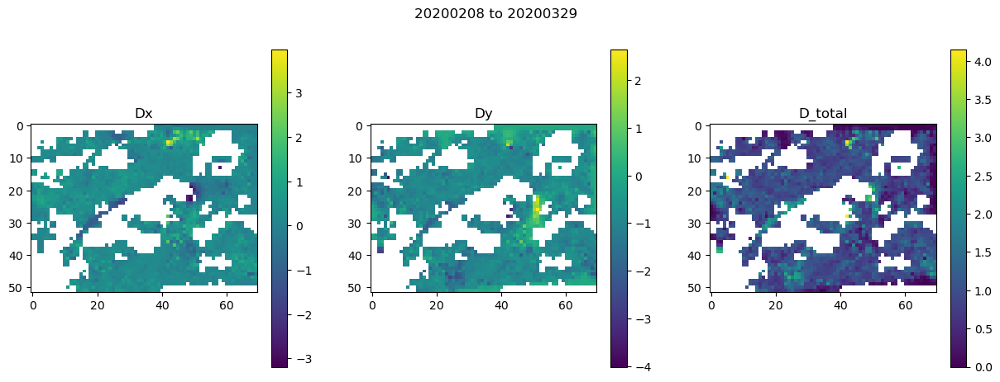

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017742156982421875
20200208 20200403
S2B_42SYH_20200208_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

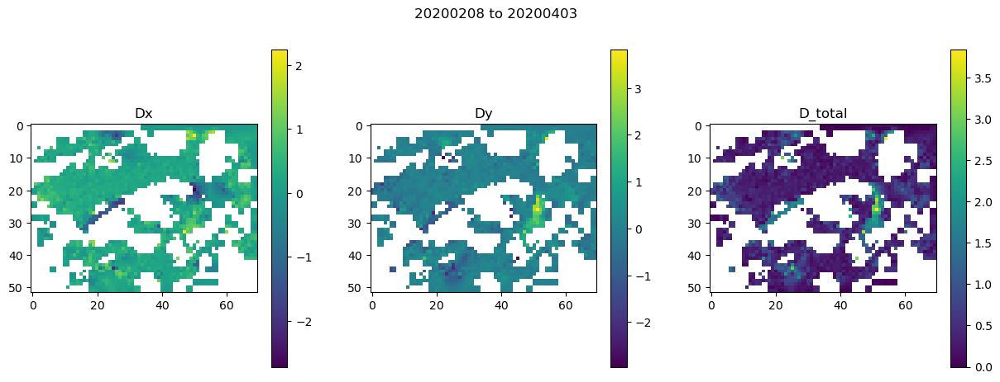

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019198179244995117
20200208 20200408
S2B_42SYH_20200208_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200208 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

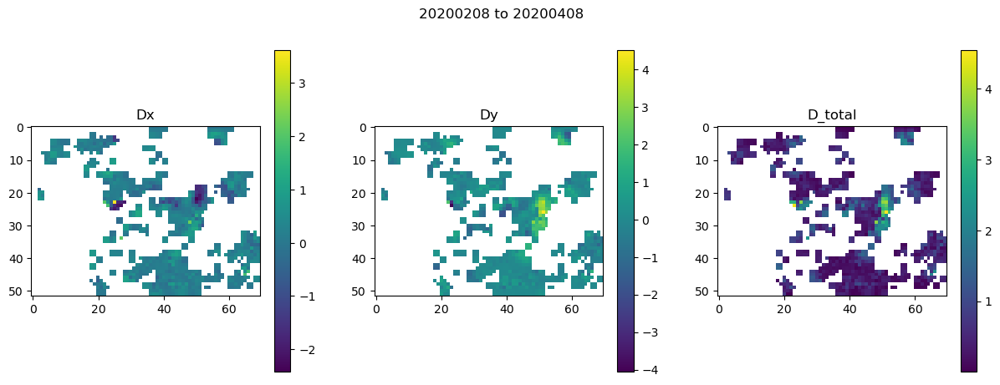

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01659989356994629
20200223 20200309
S2A_42SYH_20200223_B08_clipped.tif S2B_42SYH_20200309_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200309

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0928819179534912


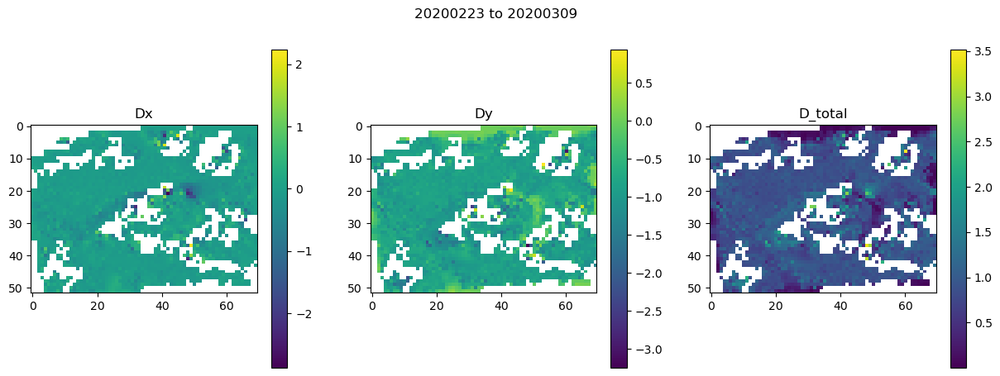

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016904354095458984
20200223 20200314
S2A_42SYH_20200223_B08_clipped.tif S2A_42SYH_20200314_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200314

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

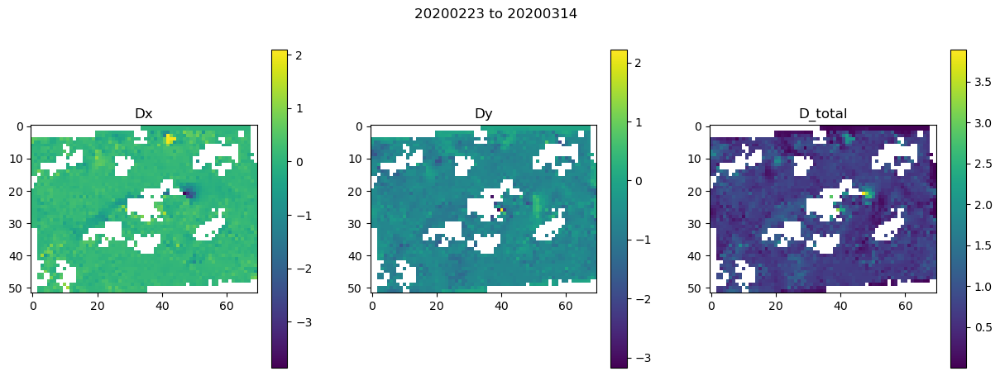

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0181882381439209
20200223 20200319
S2A_42SYH_20200223_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

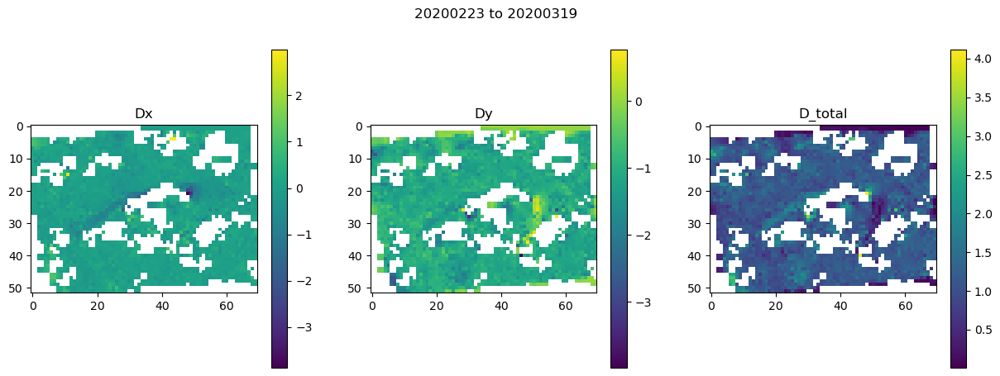

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0237729549407959
20200223 20200329
S2A_42SYH_20200223_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

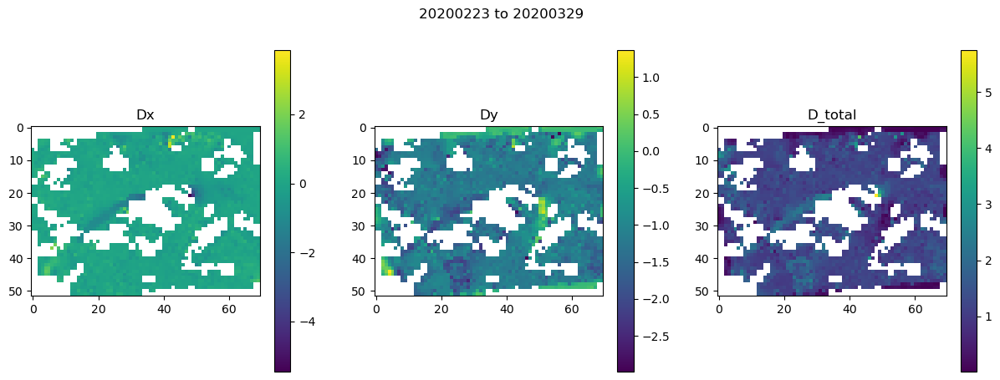

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017045021057128906
20200223 20200403
S2A_42SYH_20200223_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

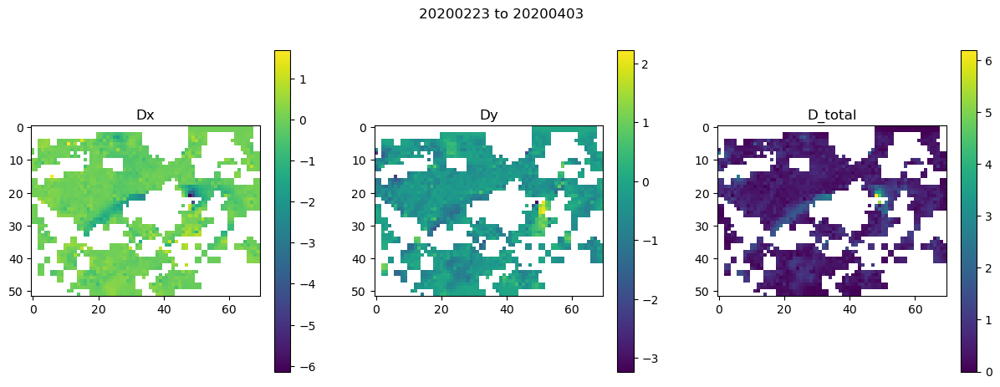

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019294023513793945
20200223 20200408
S2A_42SYH_20200223_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

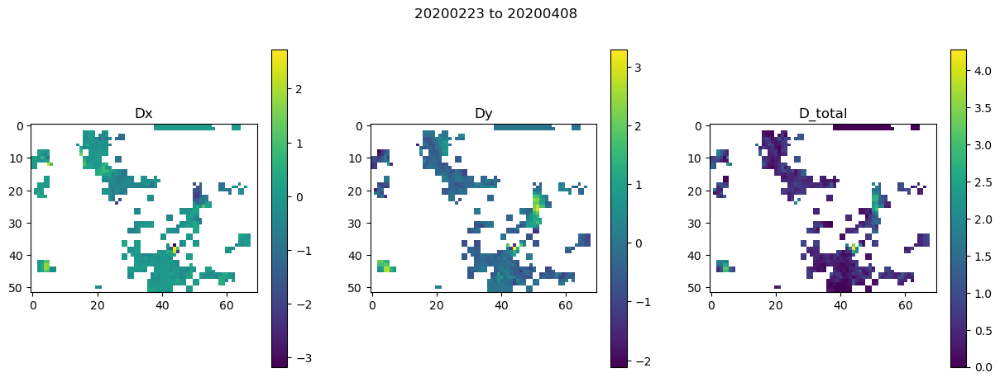

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020450115203857422
20200223 20200418
S2A_42SYH_20200223_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

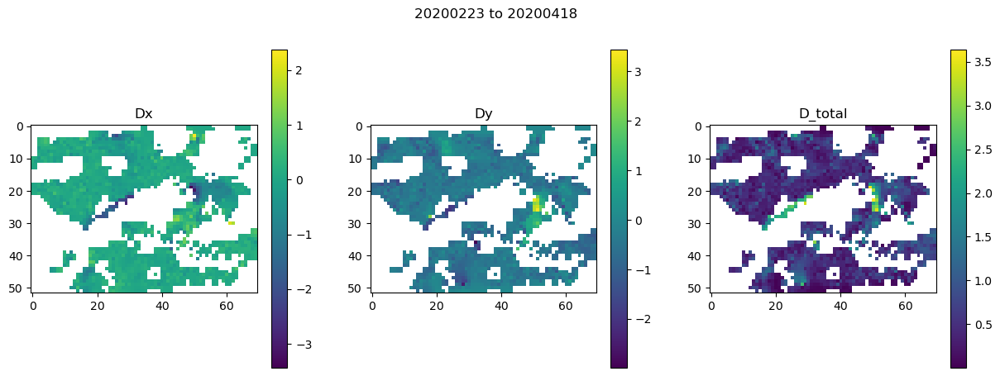

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02000594139099121
20200223 20200423
S2A_42SYH_20200223_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200223 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

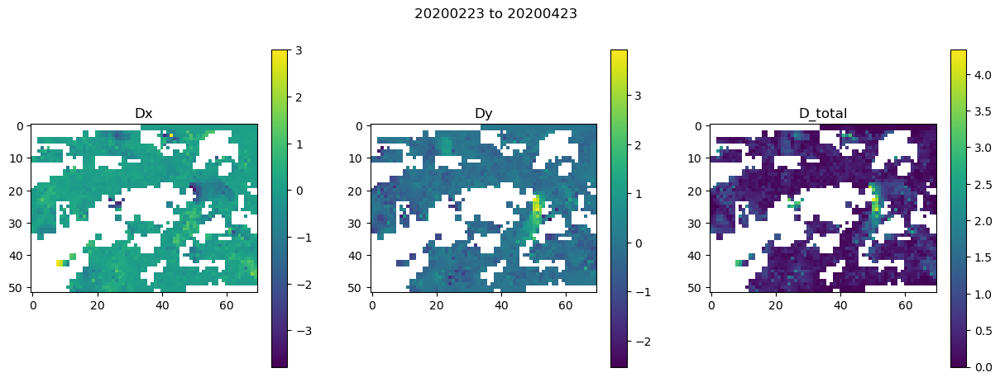

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.022549152374267578
20200228 20200314
S2B_42SYH_20200228_B08_clipped.tif S2A_42SYH_20200314_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200314

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
0.9728400707244873


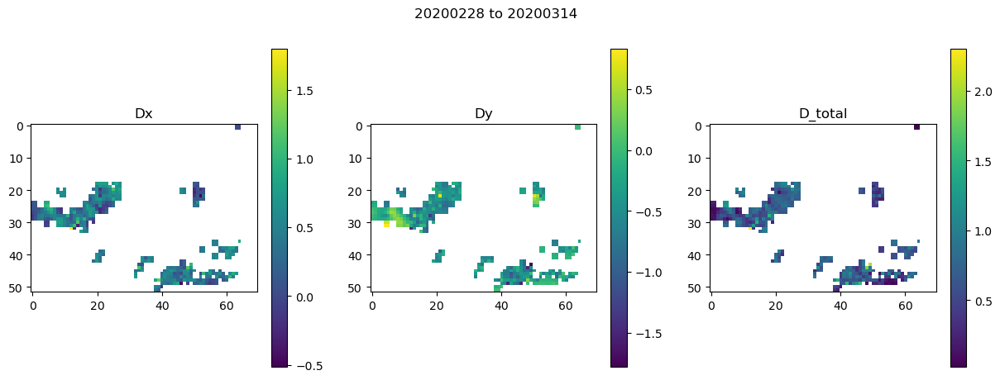

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019563913345336914
20200228 20200319
S2B_42SYH_20200228_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

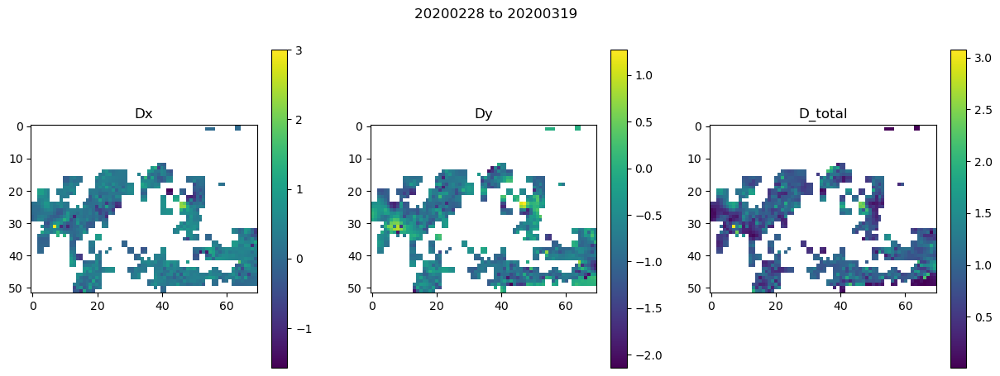

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018517017364501953
20200228 20200329
S2B_42SYH_20200228_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

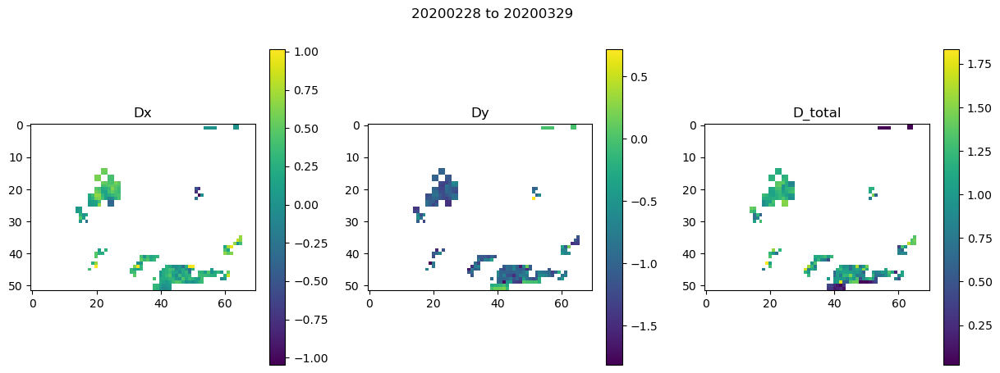

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01672816276550293
20200228 20200403
S2B_42SYH_20200228_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

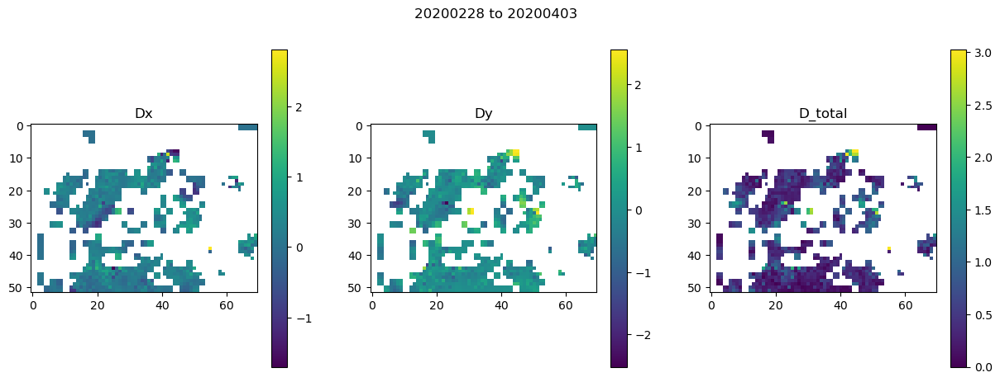

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017155170440673828
20200228 20200408
S2B_42SYH_20200228_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

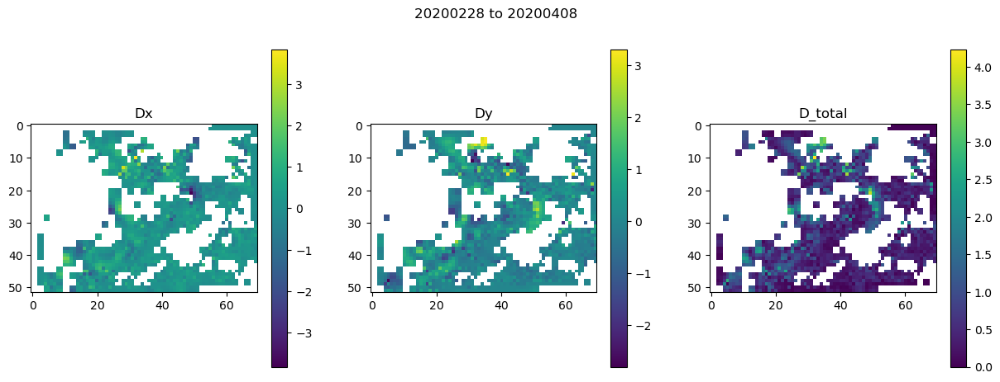

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01706218719482422
20200228 20200418
S2B_42SYH_20200228_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

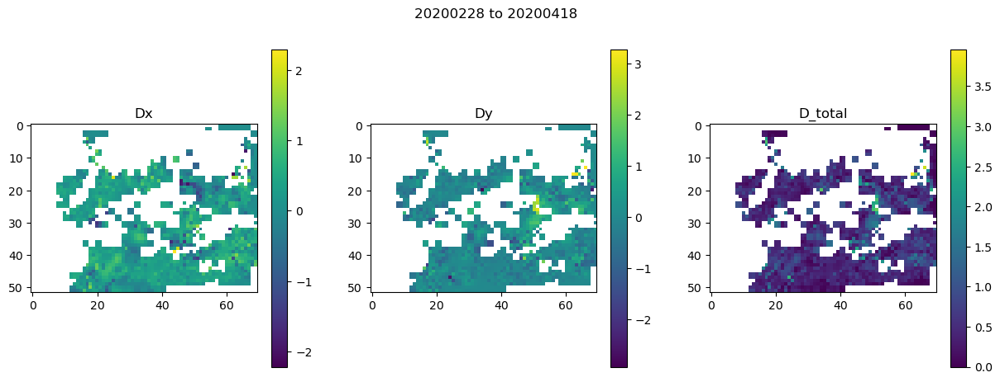

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01795673370361328
20200228 20200423
S2B_42SYH_20200228_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

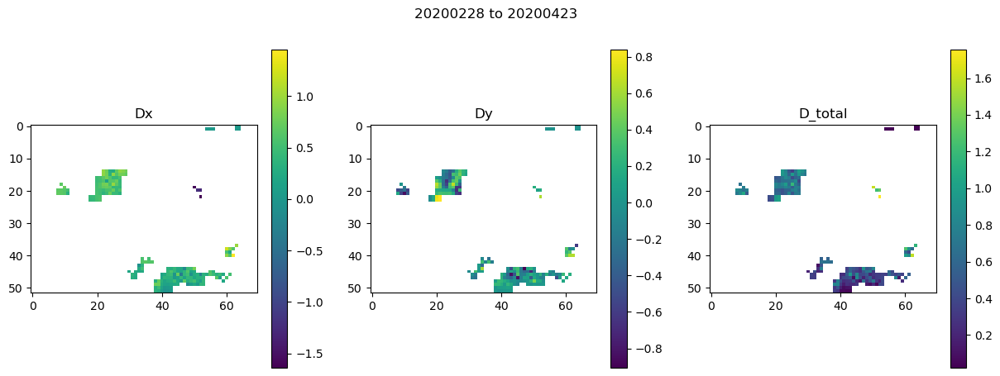

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017646074295043945
20200228 20200428
S2B_42SYH_20200228_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200228 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

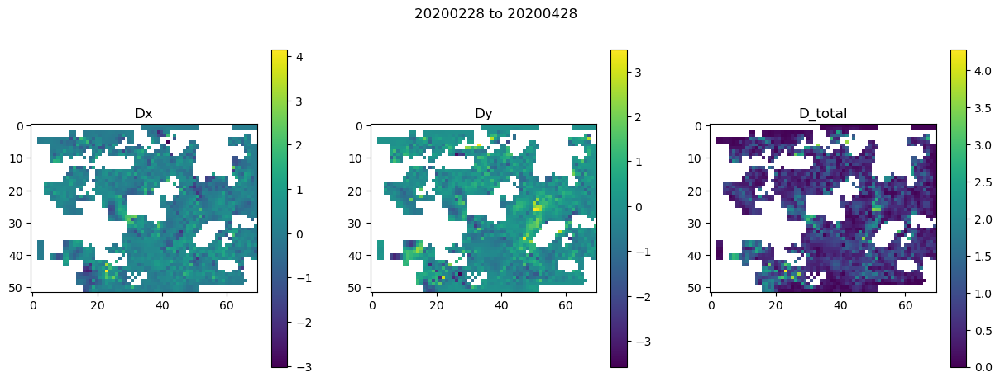

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021091222763061523
20200304 20200319
S2A_42SYH_20200304_B08_clipped.tif S2B_42SYH_20200319_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200319

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.134856939315796


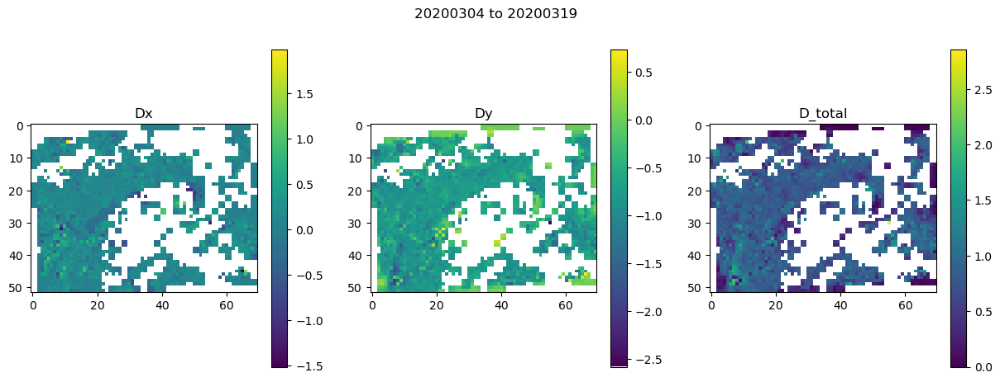

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018340110778808594
20200304 20200329
S2A_42SYH_20200304_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

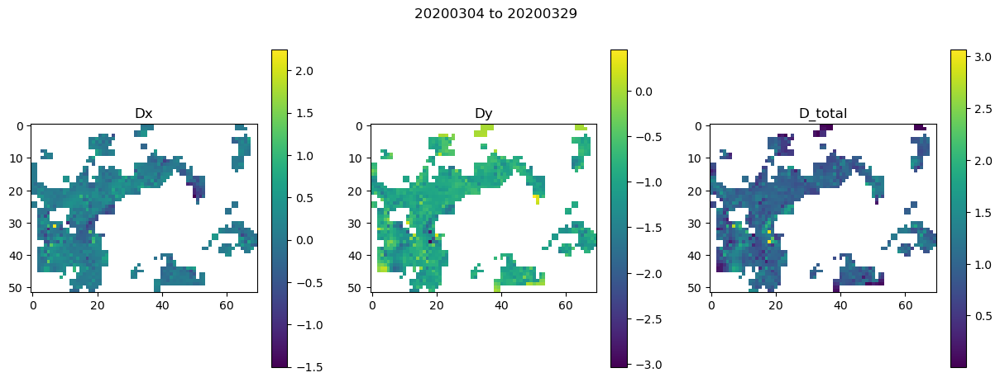

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0181119441986084
20200304 20200403
S2A_42SYH_20200304_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

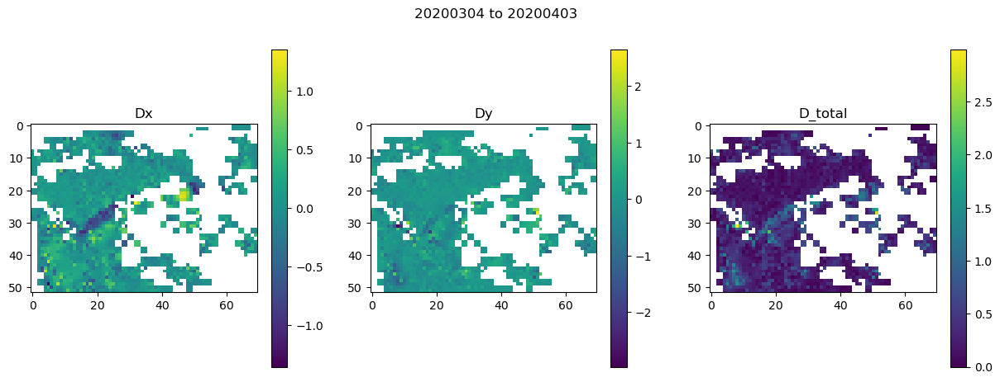

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021898984909057617
20200304 20200408
S2A_42SYH_20200304_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

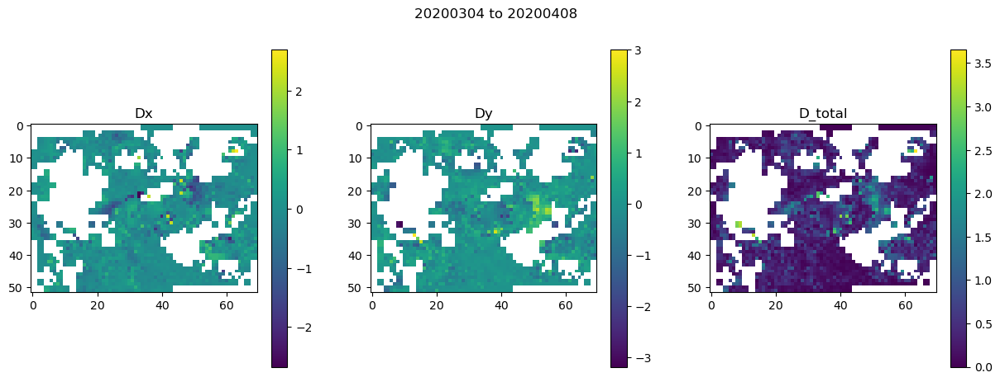

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019398212432861328
20200304 20200418
S2A_42SYH_20200304_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

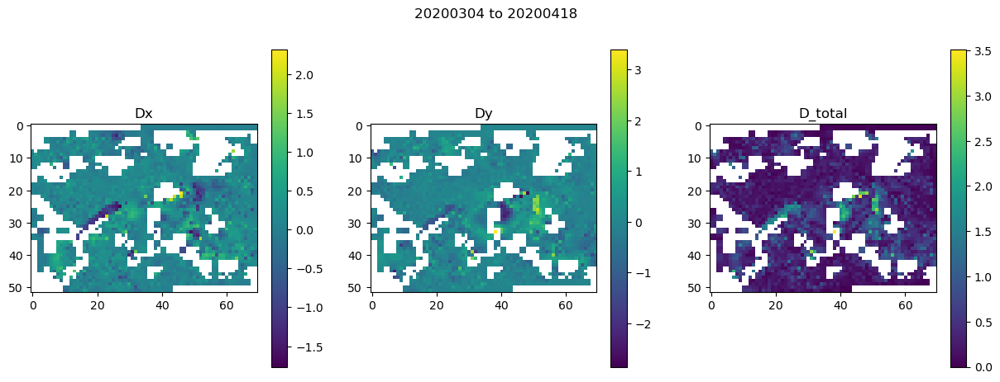

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017379283905029297
20200304 20200423
S2A_42SYH_20200304_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

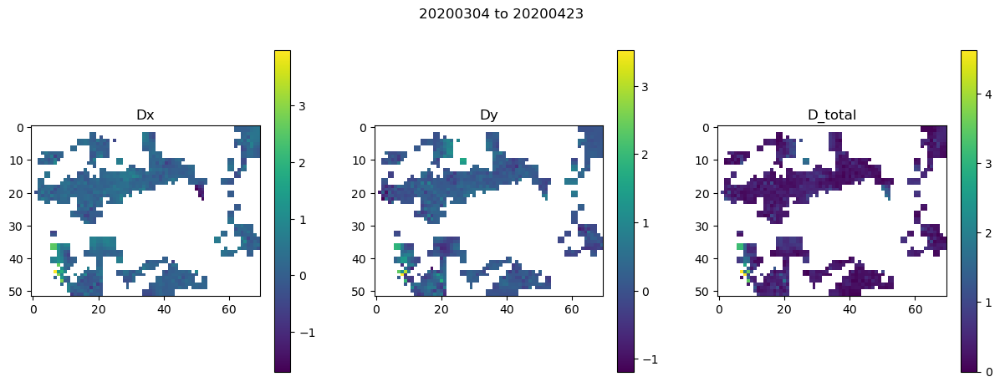

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01655721664428711
20200304 20200428
S2A_42SYH_20200304_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200304 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

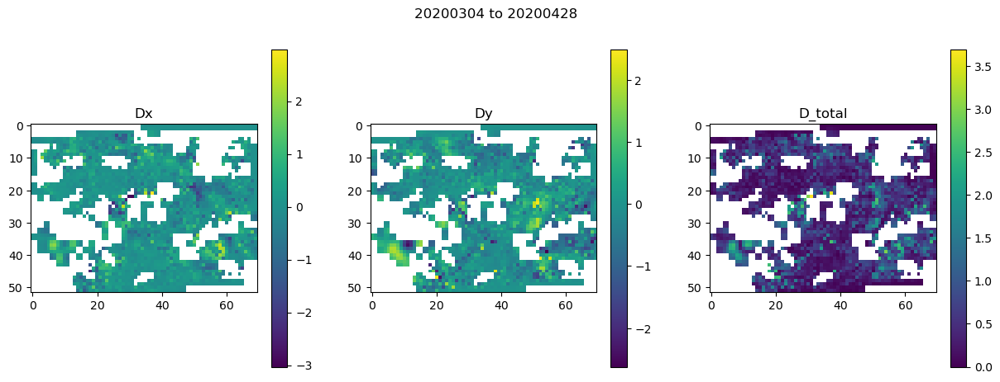

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016844987869262695
20200309 20200329
S2B_42SYH_20200309_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.086987018585205


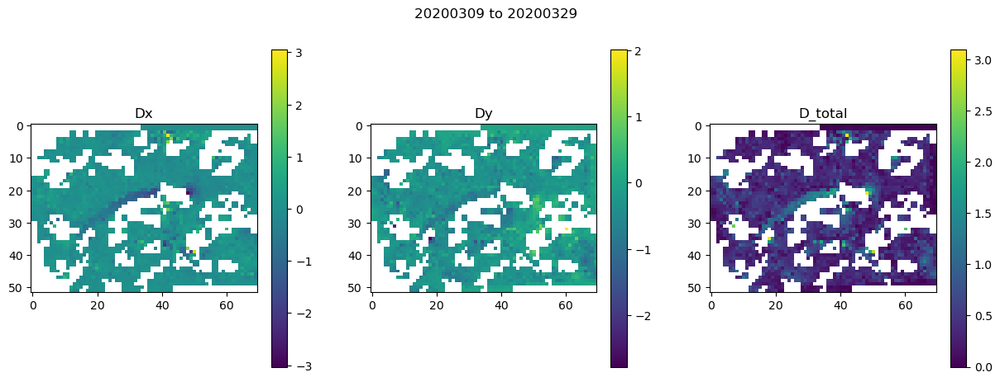

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016964197158813477
20200309 20200403
S2B_42SYH_20200309_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

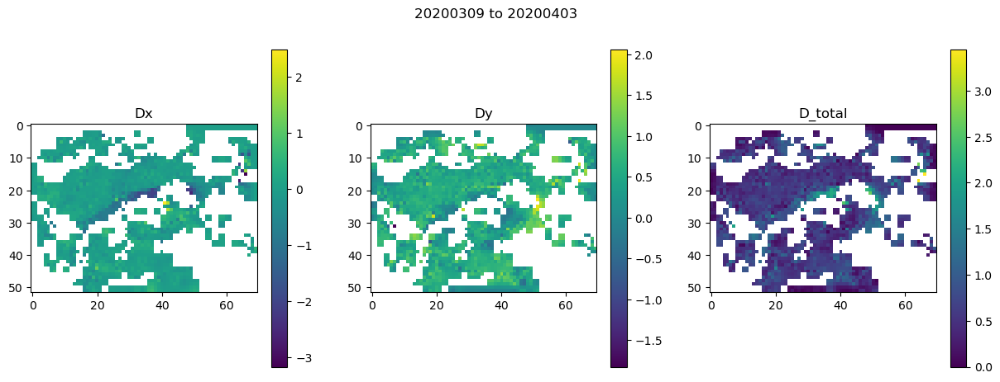

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017460107803344727
20200309 20200408
S2B_42SYH_20200309_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

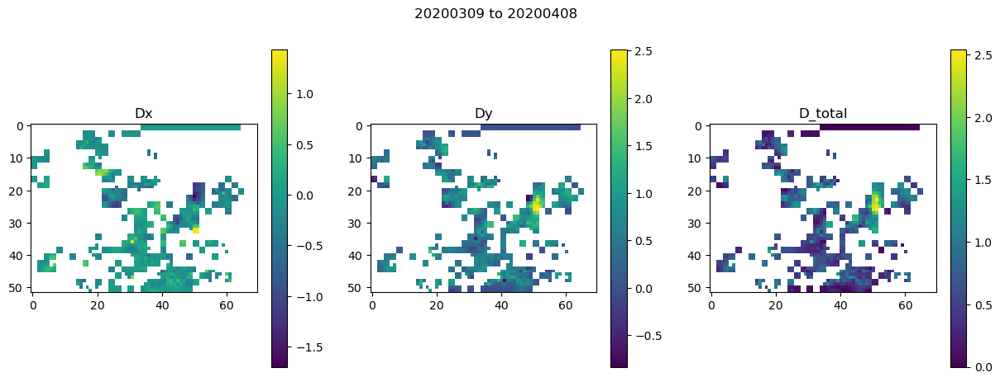

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02105402946472168
20200309 20200418
S2B_42SYH_20200309_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

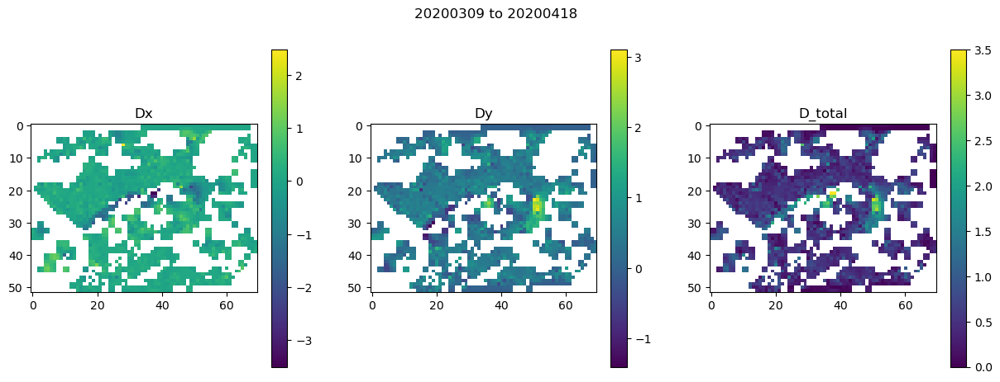

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01875901222229004
20200309 20200423
S2B_42SYH_20200309_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

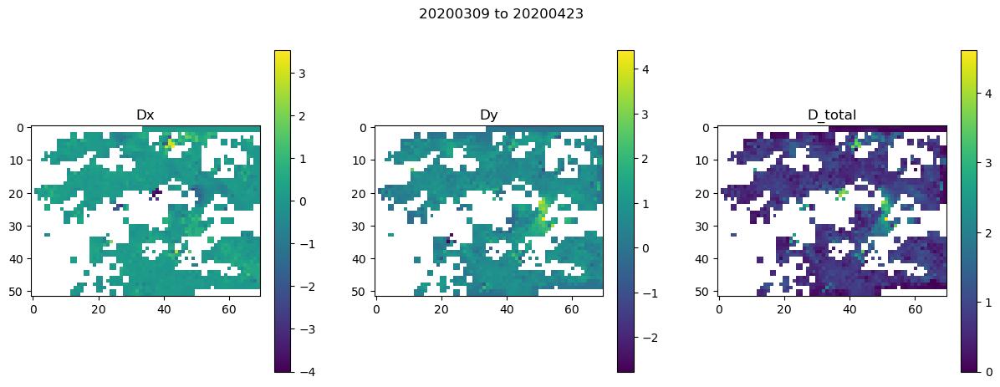

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017641067504882812
20200309 20200428
S2B_42SYH_20200309_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200309 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

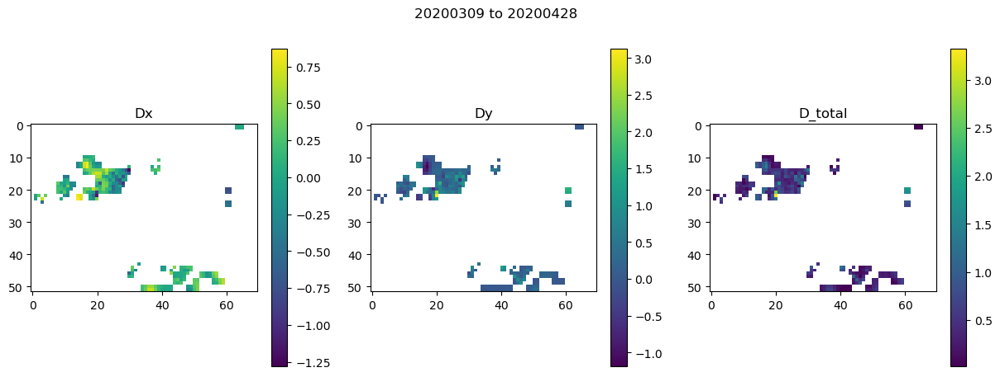

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01821279525756836
20200314 20200329
S2A_42SYH_20200314_B08_clipped.tif S2B_42SYH_20200329_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200329

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1230738162994385


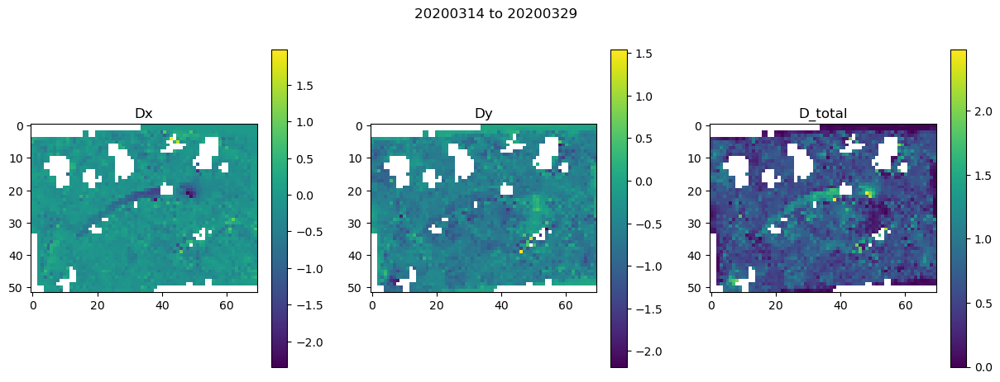

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018351078033447266
20200314 20200403
S2A_42SYH_20200314_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

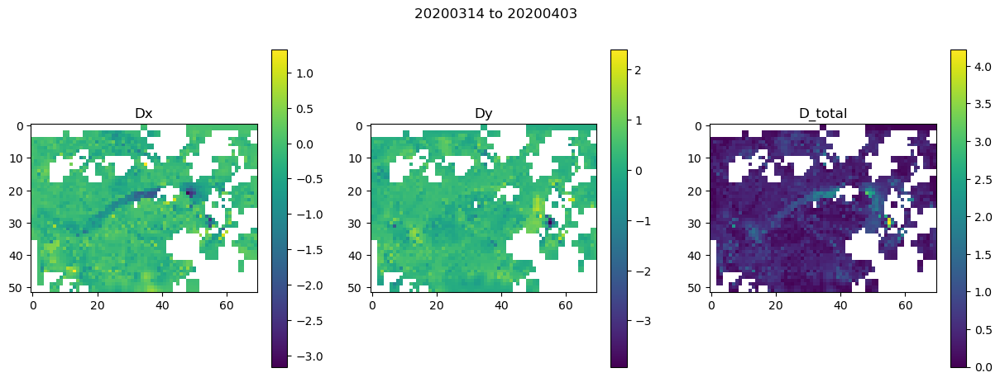

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017383813858032227
20200314 20200408
S2A_42SYH_20200314_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

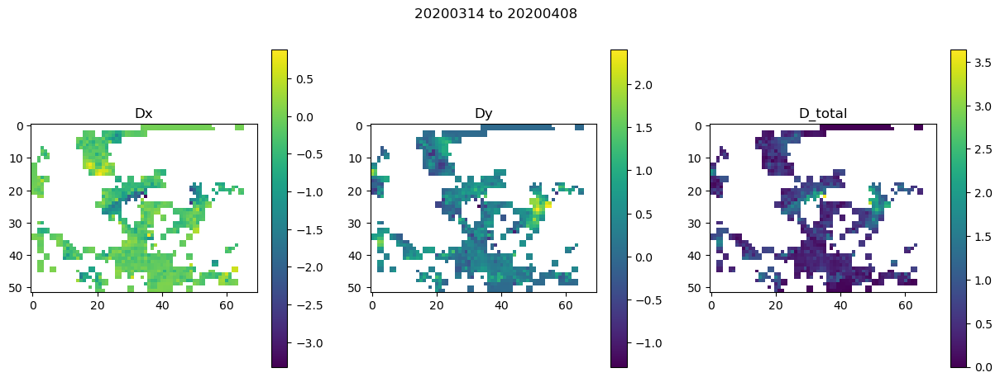

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024679899215698242
20200314 20200418
S2A_42SYH_20200314_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

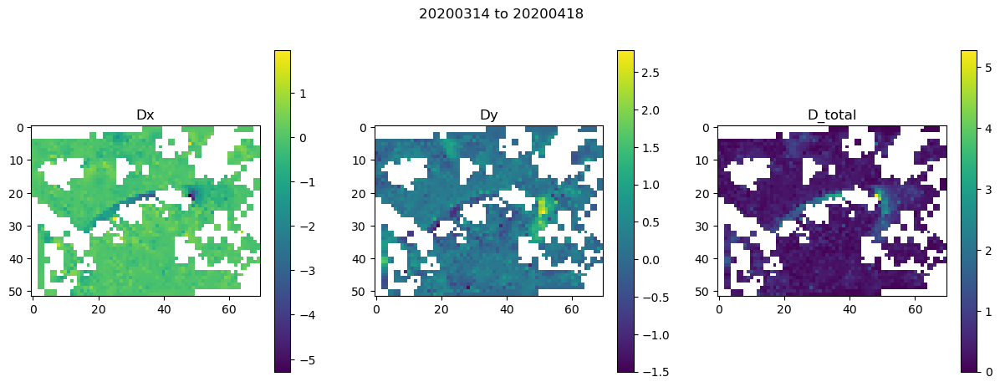

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01662611961364746
20200314 20200423
S2A_42SYH_20200314_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

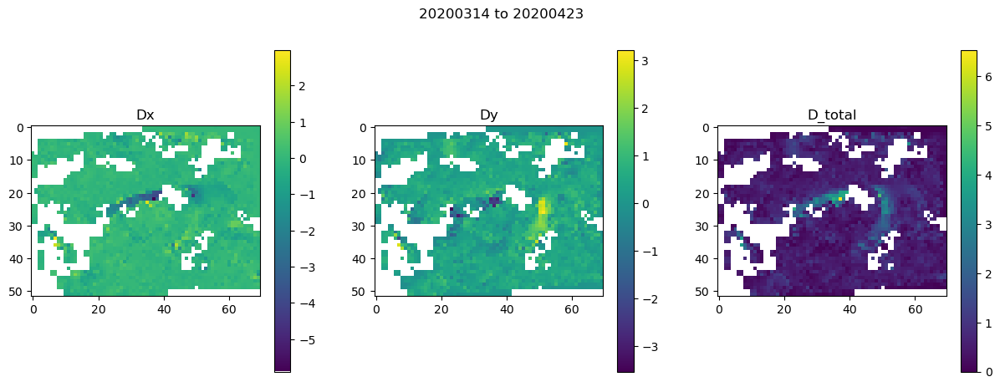

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016624927520751953
20200314 20200428
S2A_42SYH_20200314_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200314 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

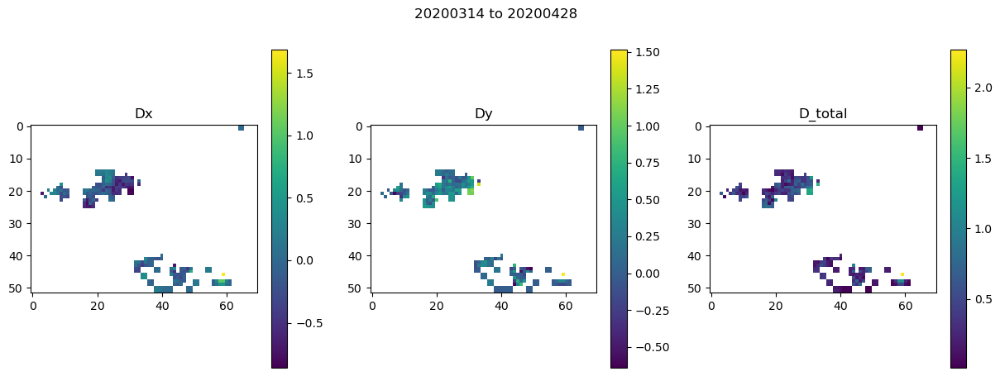

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018514156341552734
20200319 20200403
S2B_42SYH_20200319_B08_clipped.tif S2A_42SYH_20200403_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200403

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1209840774536133


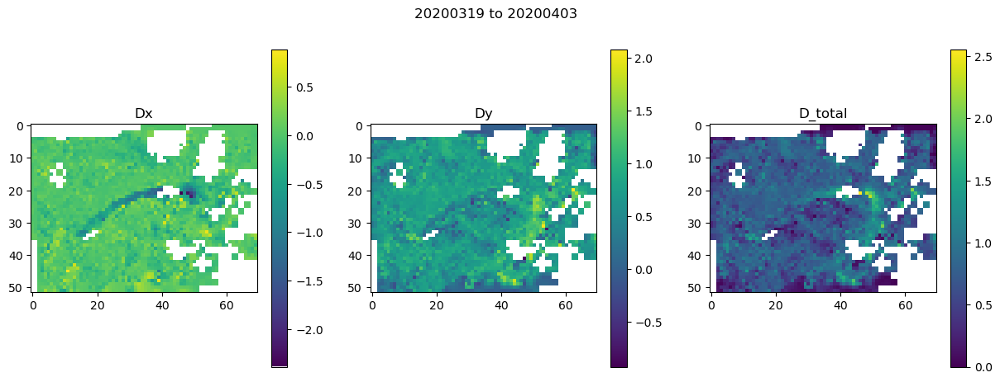

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017986059188842773
20200319 20200408
S2B_42SYH_20200319_B08_clipped.tif S2B_42SYH_20200408_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200408

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

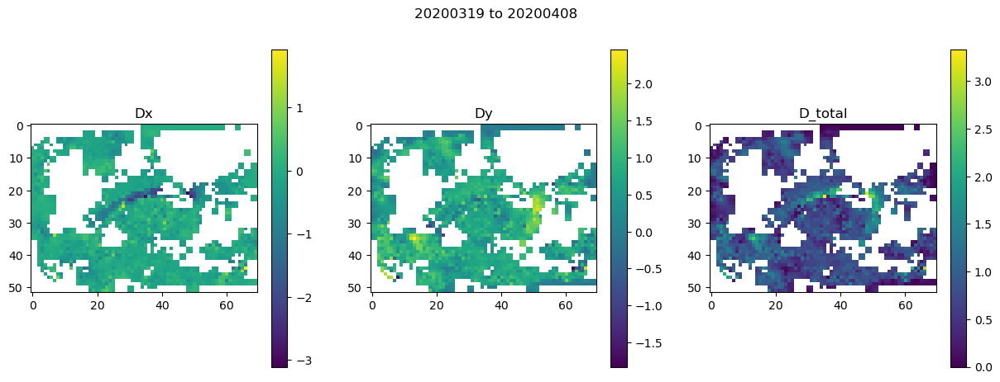

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01952815055847168
20200319 20200418
S2B_42SYH_20200319_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

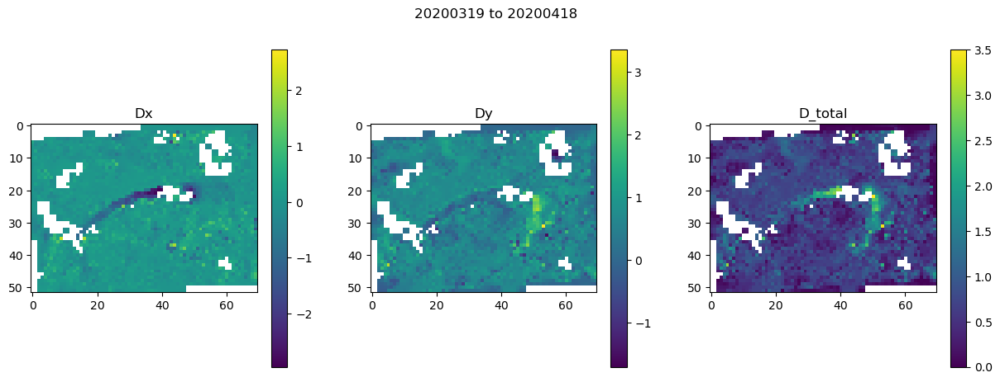

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01834893226623535
20200319 20200423
S2B_42SYH_20200319_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

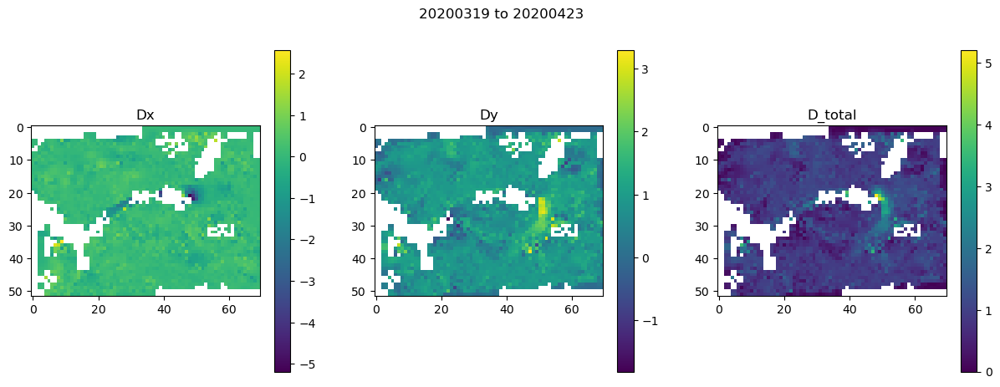

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01861882209777832
20200319 20200428
S2B_42SYH_20200319_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

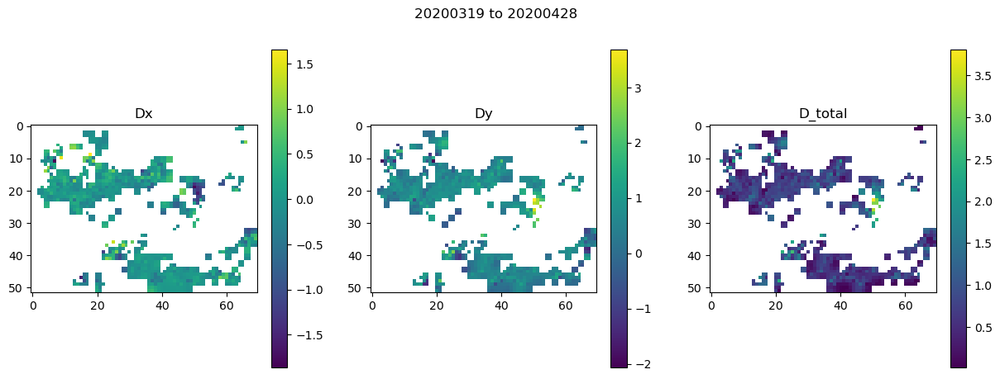

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018515825271606445
20200319 20200518
S2B_42SYH_20200319_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200319 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

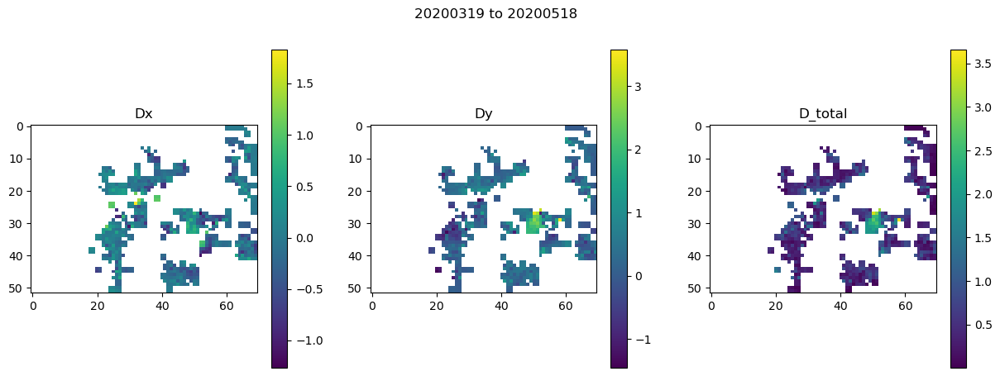

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.024171829223632812
20200329 20200418
S2B_42SYH_20200329_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1180119514465332


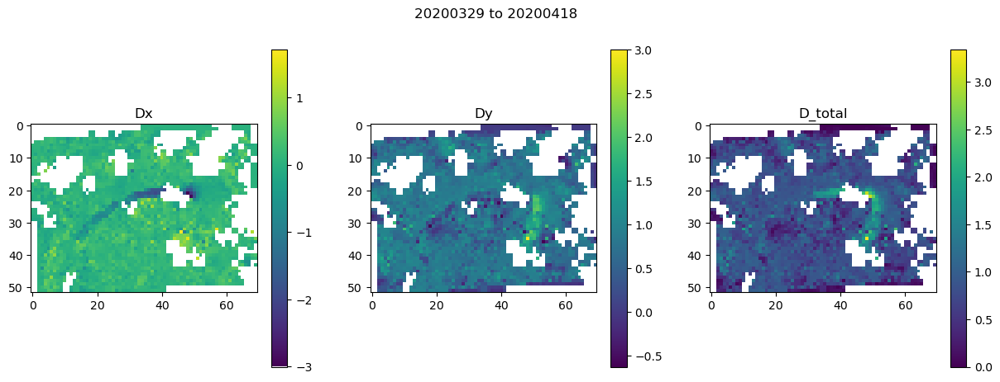

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017303943634033203
20200329 20200423
S2B_42SYH_20200329_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

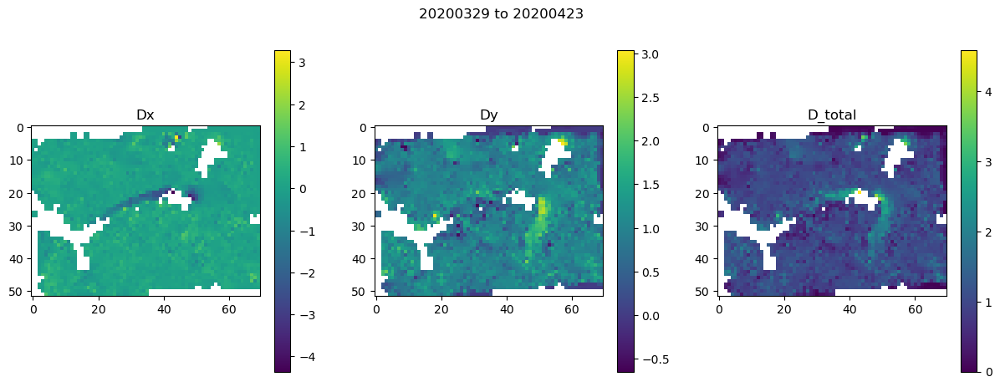

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017364978790283203
20200329 20200428
S2B_42SYH_20200329_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

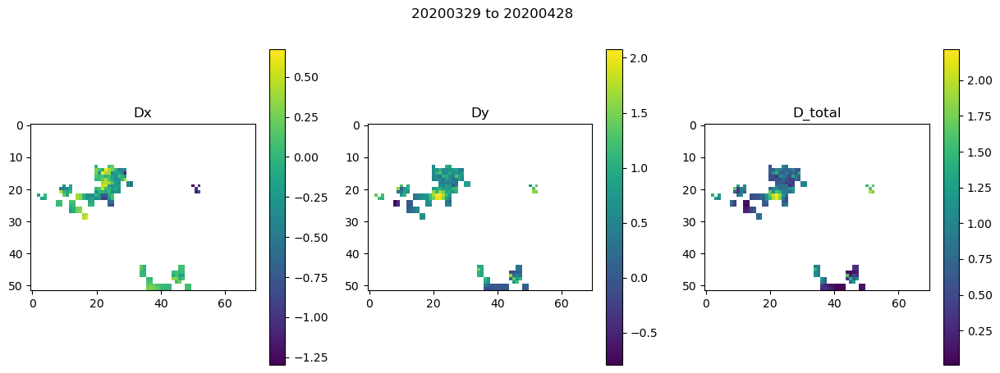

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017309904098510742
20200329 20200518
S2B_42SYH_20200329_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

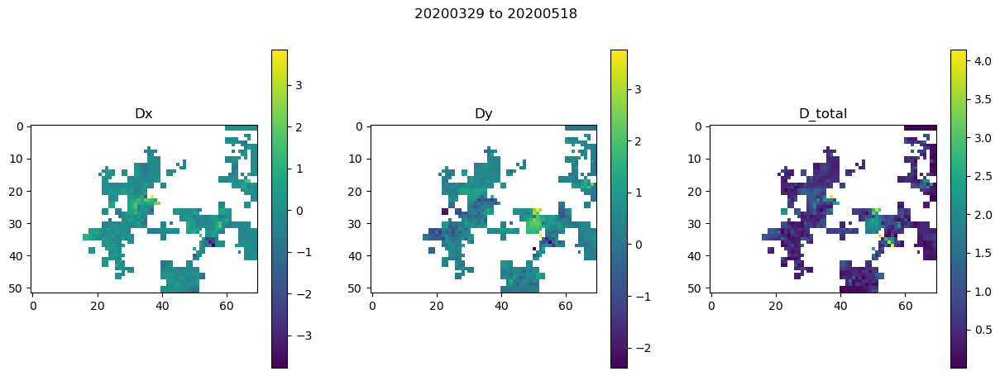

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018025875091552734
20200329 20200523
S2B_42SYH_20200329_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

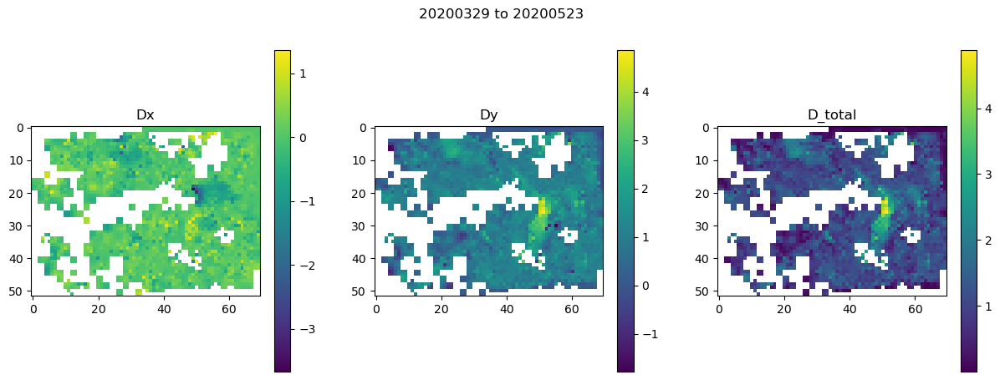

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017353057861328125
20200329 20200528
S2B_42SYH_20200329_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200329 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

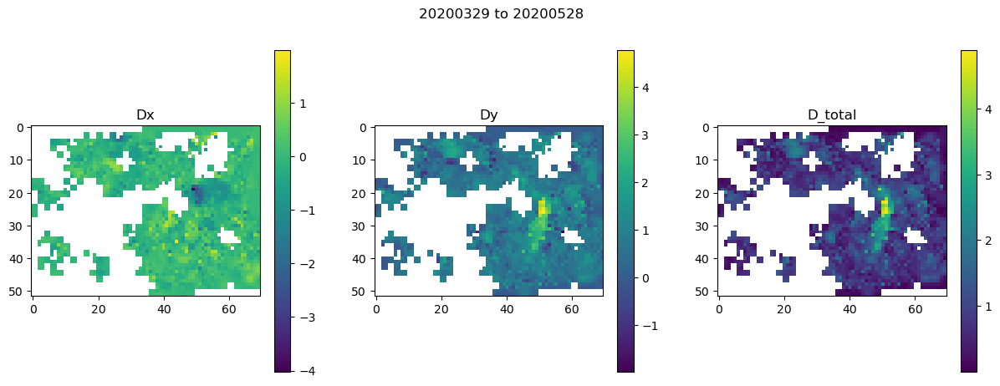

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0211179256439209
20200403 20200418
S2A_42SYH_20200403_B08_clipped.tif S2B_42SYH_20200418_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200418

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1174969673156738


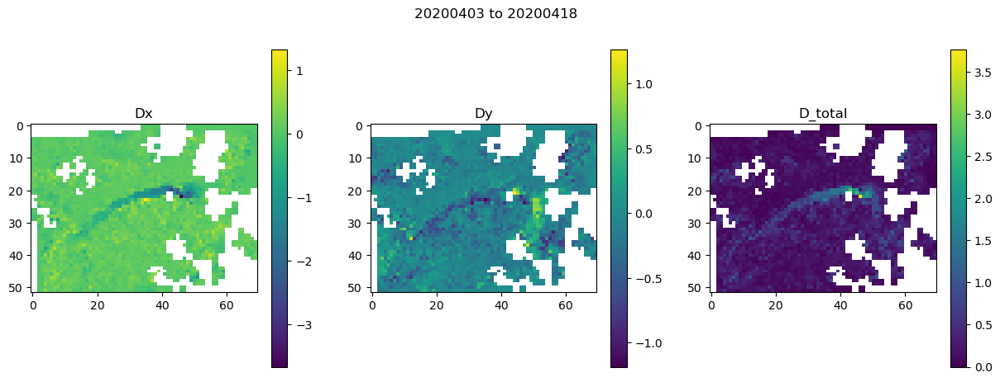

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017998933792114258
20200403 20200423
S2A_42SYH_20200403_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

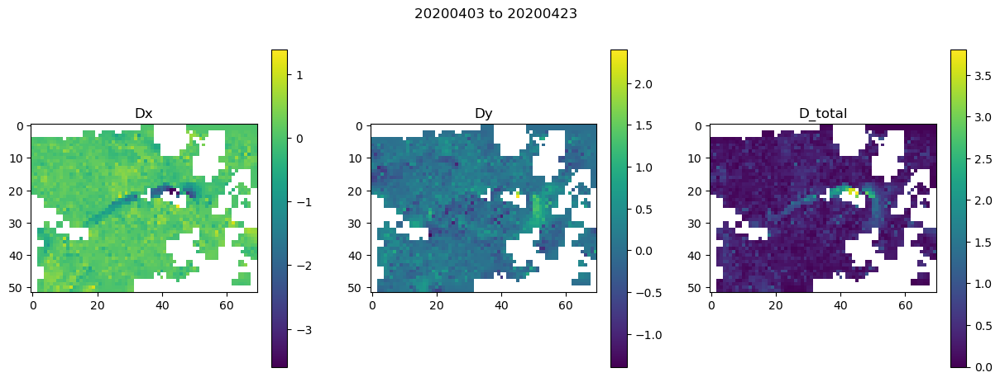

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019104957580566406
20200403 20200428
S2A_42SYH_20200403_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

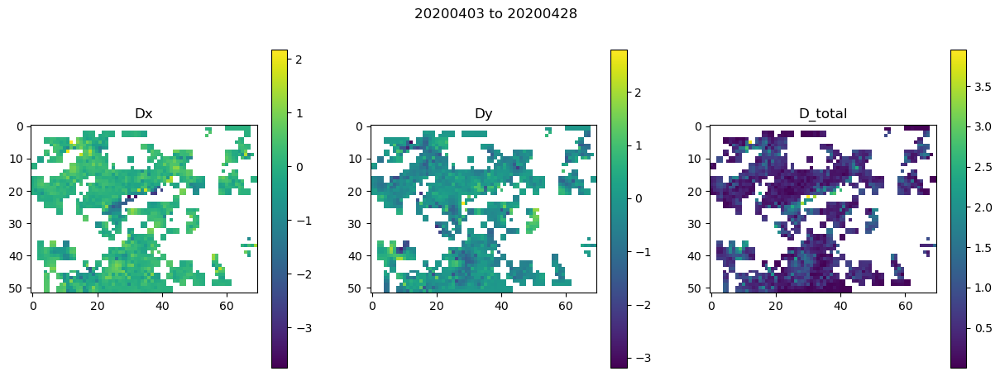

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017931222915649414
20200403 20200518
S2A_42SYH_20200403_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

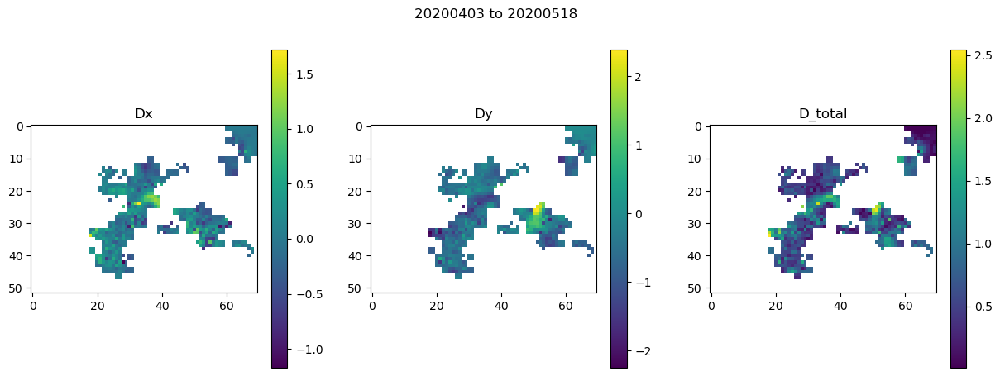

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021066904067993164
20200403 20200523
S2A_42SYH_20200403_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

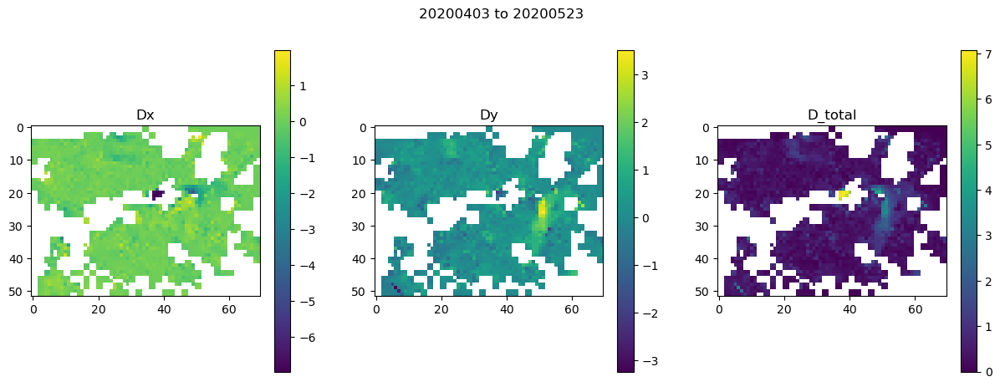

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017974853515625
20200403 20200528
S2A_42SYH_20200403_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200403 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Windo

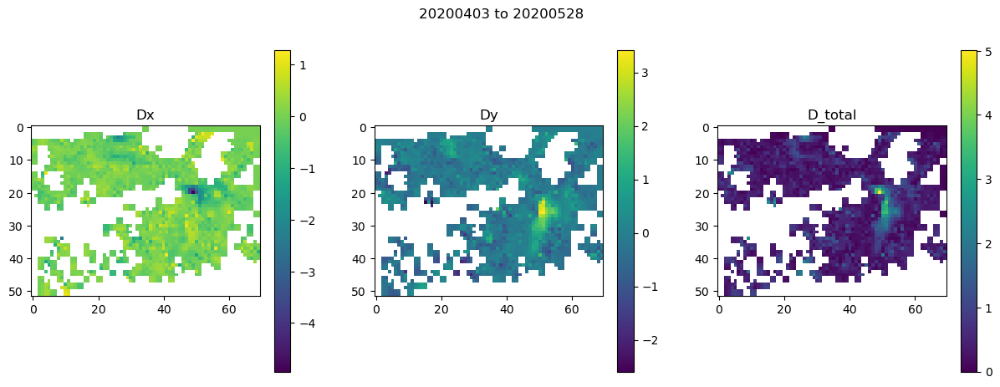

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018240928649902344
20200408 20200423
S2B_42SYH_20200408_B08_clipped.tif S2A_42SYH_20200423_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200408 20200423

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0875389575958252


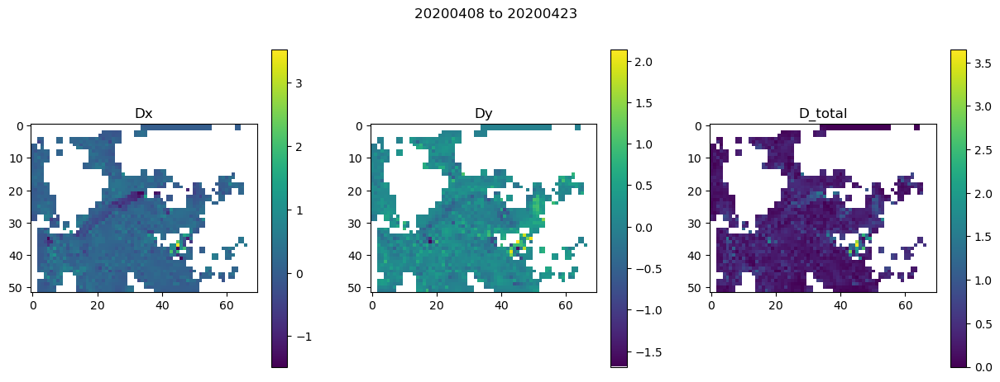

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016958951950073242
20200408 20200428
S2B_42SYH_20200408_B08_clipped.tif S2B_42SYH_20200428_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200408 20200428

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

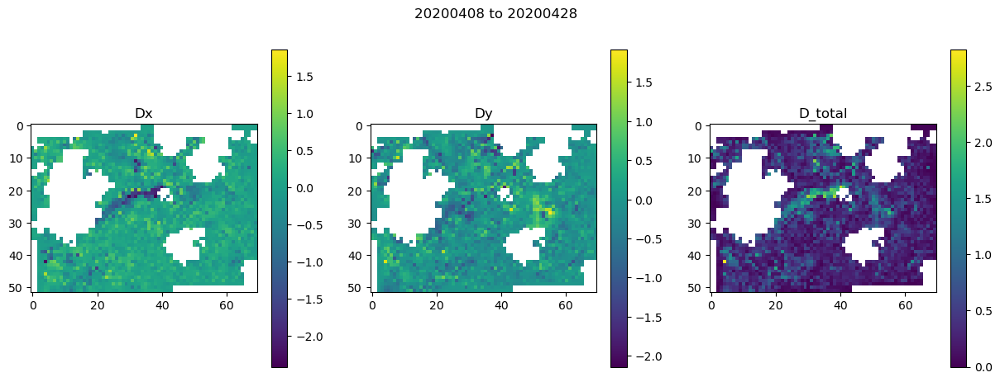

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017232179641723633
20200408 20200518
S2B_42SYH_20200408_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200408 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

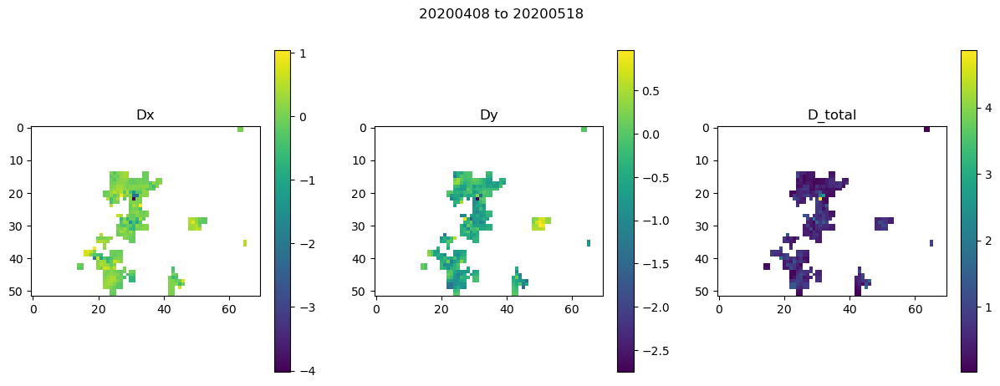

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01805400848388672
20200408 20200523
S2B_42SYH_20200408_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200408 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

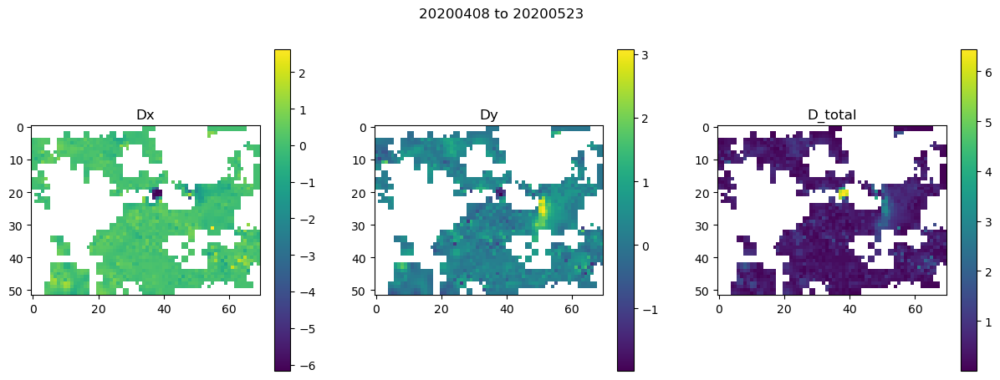

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019087791442871094
20200408 20200528
S2B_42SYH_20200408_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200408 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

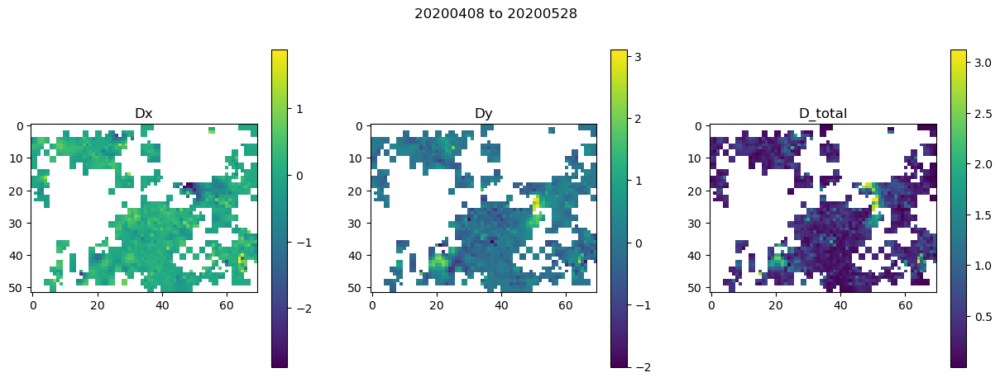

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018224716186523438
20200418 20200518
S2B_42SYH_20200418_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200418 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0135560035705566


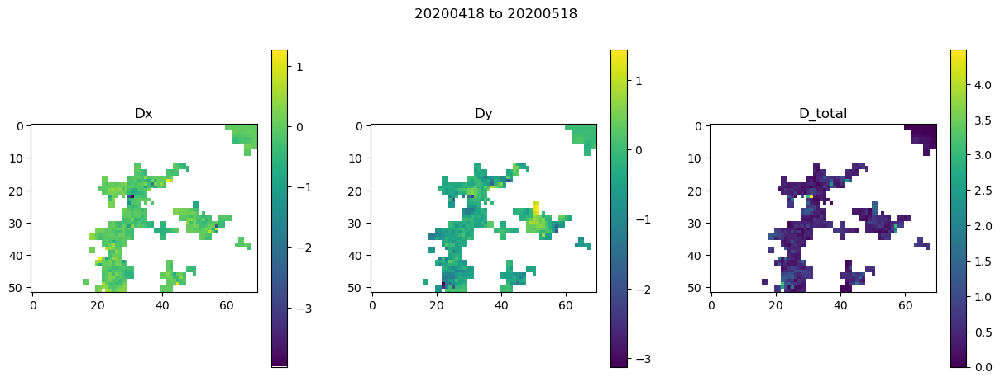

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019548892974853516
20200418 20200523
S2B_42SYH_20200418_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200418 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

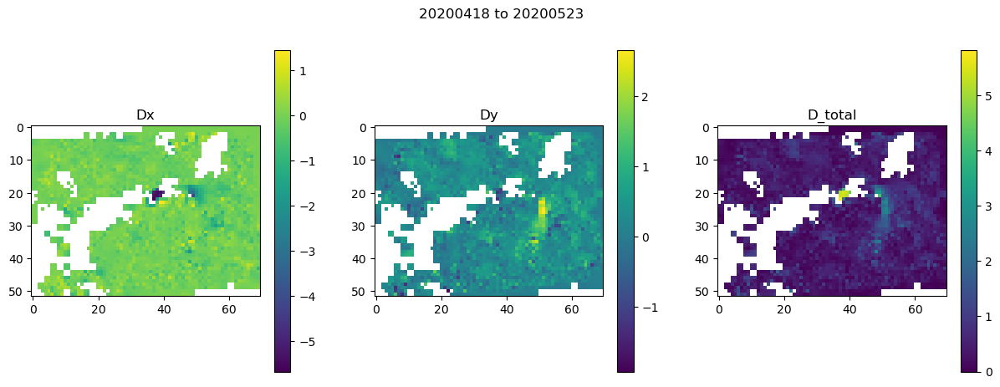

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018191814422607422
20200418 20200528
S2B_42SYH_20200418_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200418 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

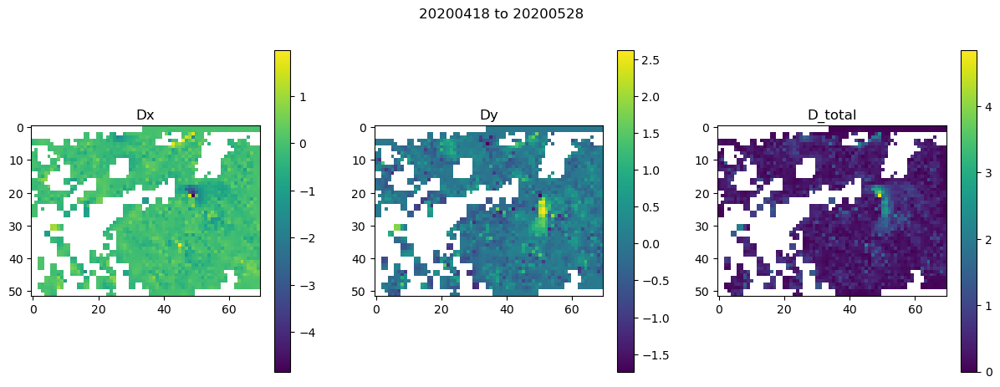

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01994490623474121
20200418 20200612
S2B_42SYH_20200418_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200418 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

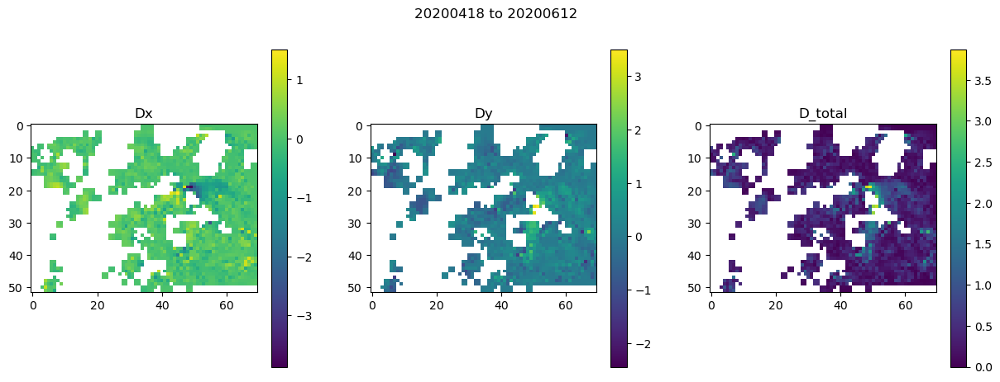

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019629955291748047
20200423 20200518
S2A_42SYH_20200423_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200423 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0717828273773193


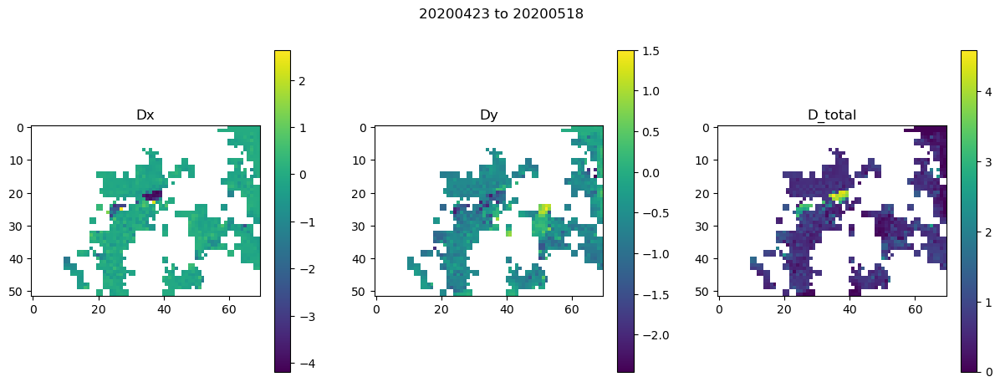

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0171201229095459
20200423 20200523
S2A_42SYH_20200423_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200423 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

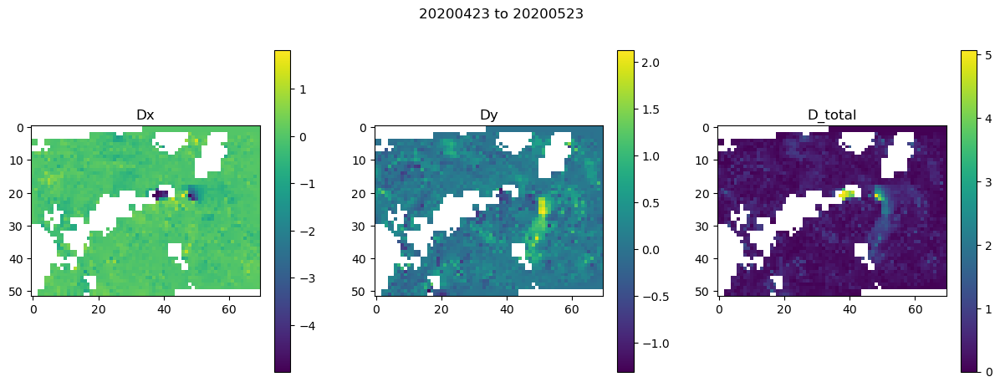

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017019033432006836
20200423 20200528
S2A_42SYH_20200423_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200423 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

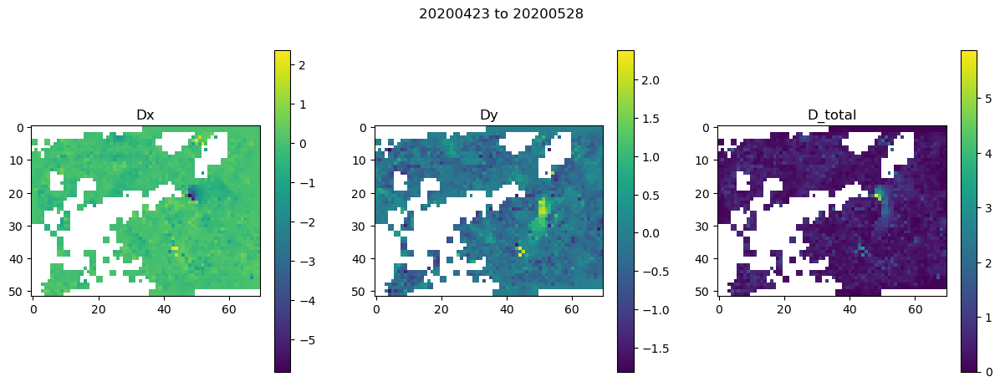

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017264842987060547
20200423 20200612
S2A_42SYH_20200423_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200423 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

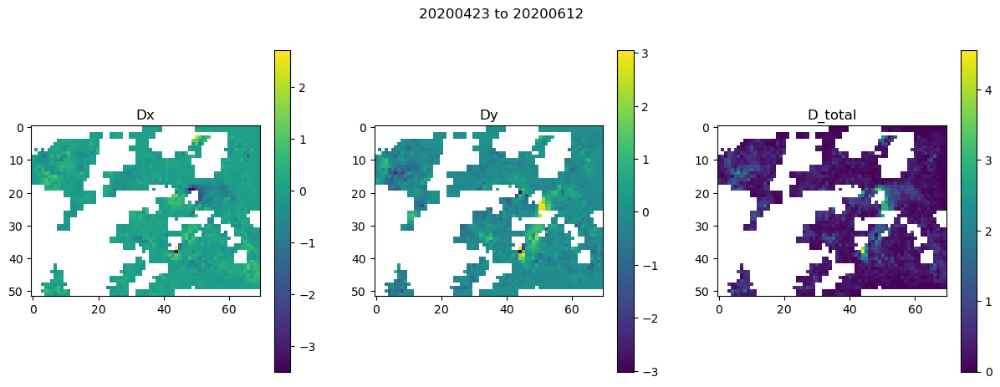

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019236087799072266
20200423 20200622
S2A_42SYH_20200423_B08_clipped.tif S2A_42SYH_20200622_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200423 20200622

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

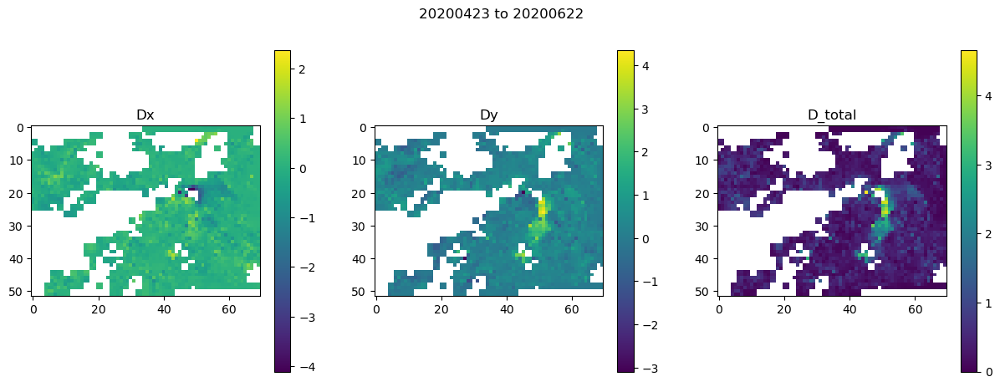

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018151044845581055
20200428 20200518
S2B_42SYH_20200428_B08_clipped.tif S2B_42SYH_20200518_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200428 20200518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
0.82955002784729


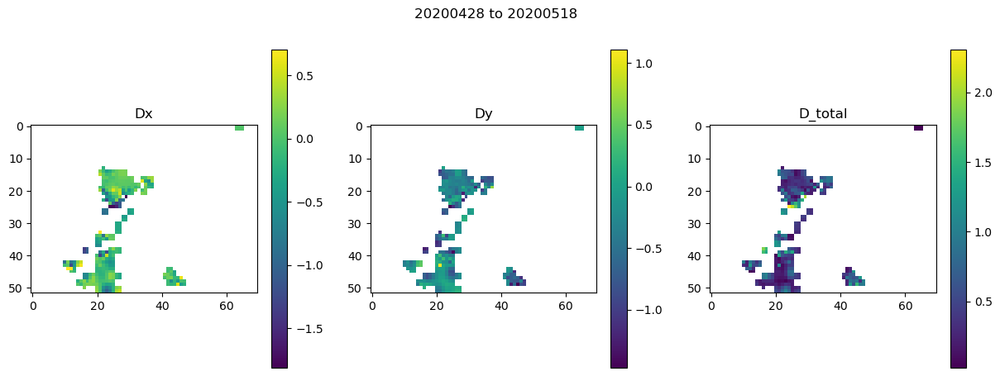

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019082069396972656
20200428 20200523
S2B_42SYH_20200428_B08_clipped.tif S2A_42SYH_20200523_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200428 20200523

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

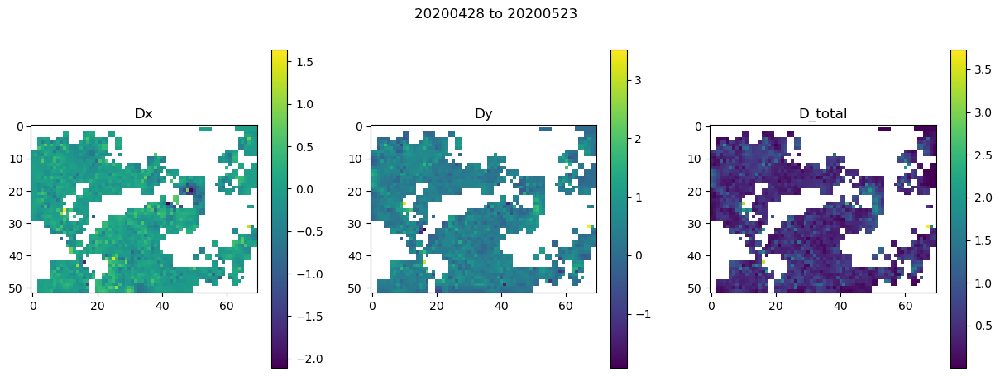

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018178224563598633
20200428 20200528
S2B_42SYH_20200428_B08_clipped.tif S2B_42SYH_20200528_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200428 20200528

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

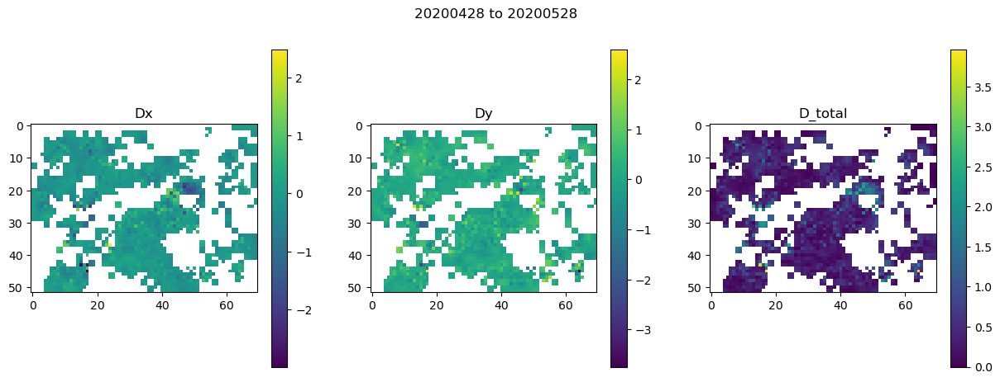

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020226716995239258
20200428 20200612
S2B_42SYH_20200428_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200428 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

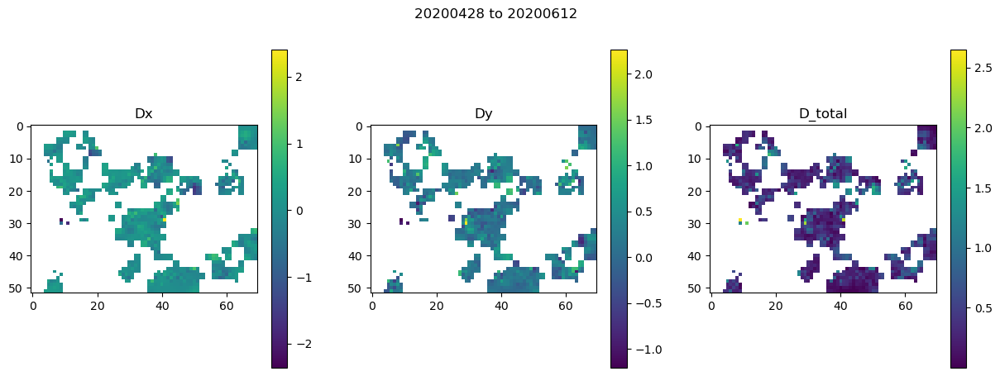

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018752098083496094
20200428 20200622
S2B_42SYH_20200428_B08_clipped.tif S2A_42SYH_20200622_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200428 20200622

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

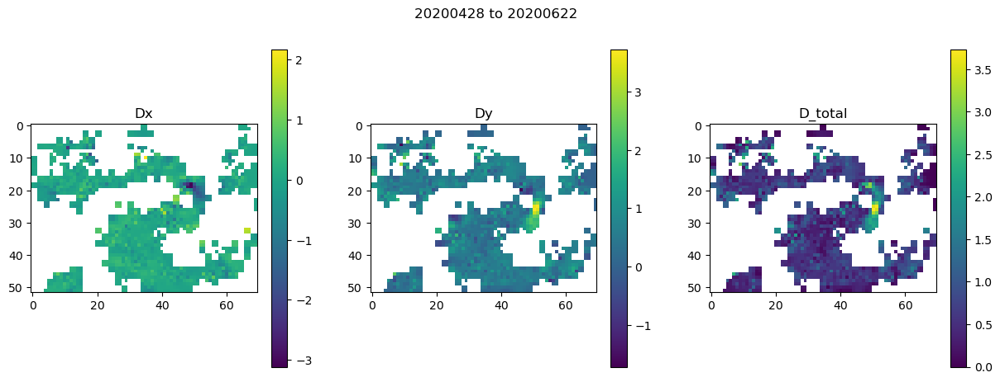

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.020457983016967773
20200518 20200612
S2B_42SYH_20200518_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200518 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
0.996243953704834


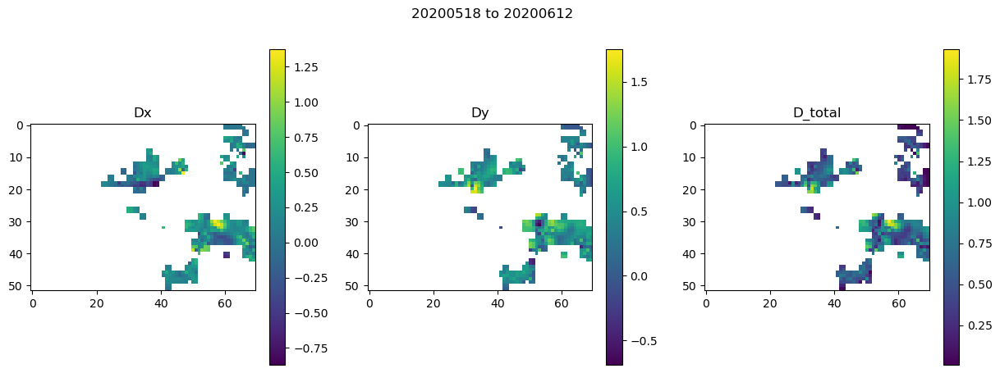

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018373966217041016
20200518 20200622
S2B_42SYH_20200518_B08_clipped.tif S2A_42SYH_20200622_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200518 20200622

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

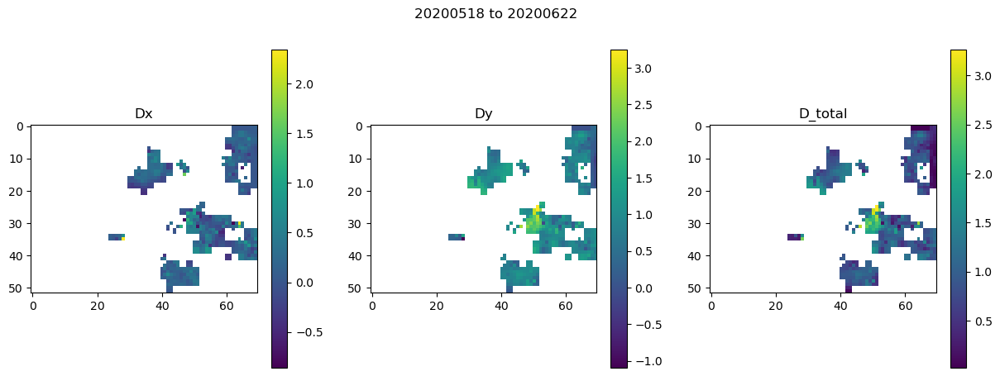

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018140077590942383
20200518 20200707
S2B_42SYH_20200518_B08_clipped.tif S2B_42SYH_20200707_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200518 20200707

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

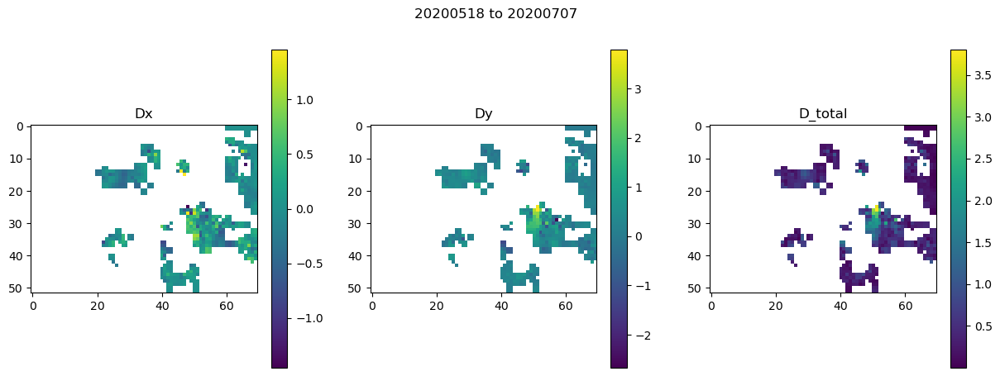

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018139123916625977
20200518 20200712
S2B_42SYH_20200518_B08_clipped.tif S2A_42SYH_20200712_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200518 20200712

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

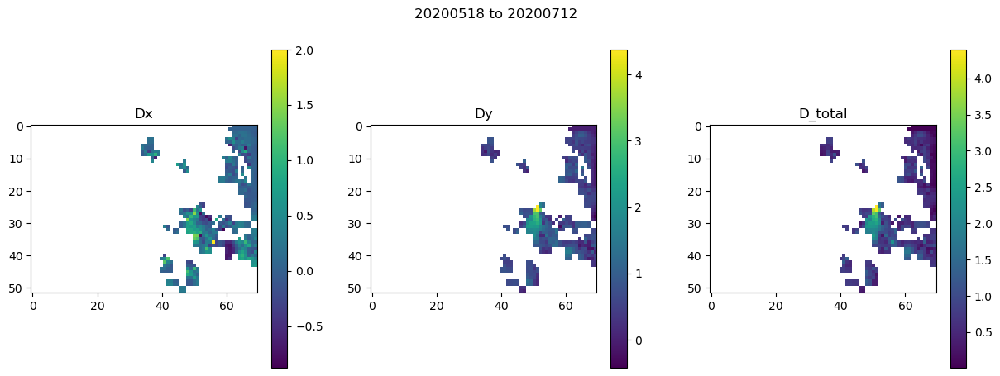

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01741790771484375
20200523 20200612
S2A_42SYH_20200523_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200523 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1069529056549072


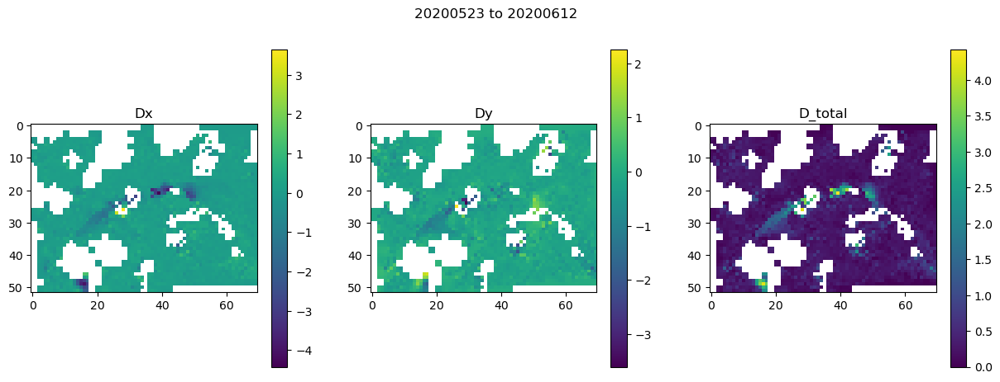

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0171968936920166
20200523 20200622
S2A_42SYH_20200523_B08_clipped.tif S2A_42SYH_20200622_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200523 20200622

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wind

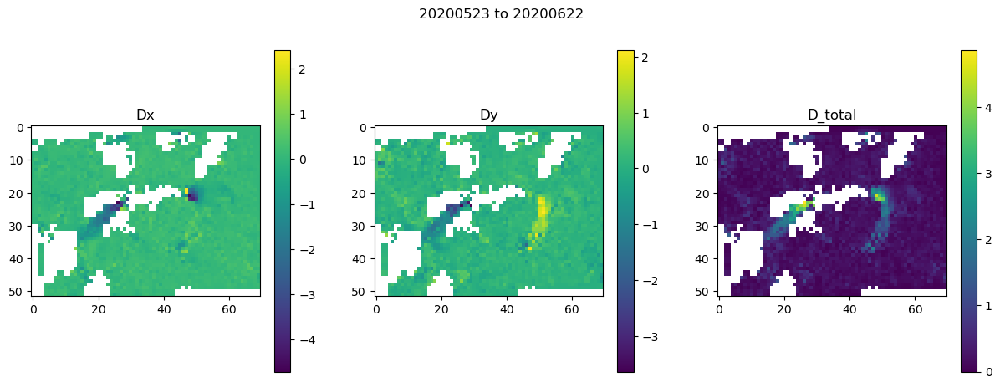

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01810002326965332
20200523 20200707
S2A_42SYH_20200523_B08_clipped.tif S2B_42SYH_20200707_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200523 20200707

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

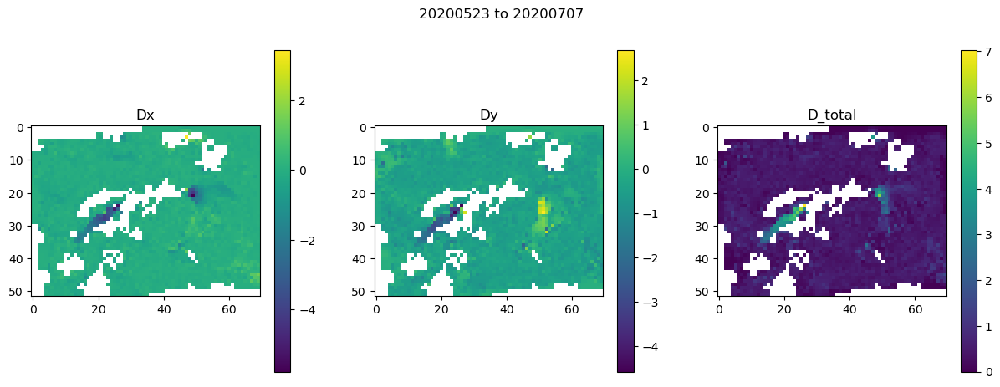

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018342256546020508
20200523 20200712
S2A_42SYH_20200523_B08_clipped.tif S2A_42SYH_20200712_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200523 20200712

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

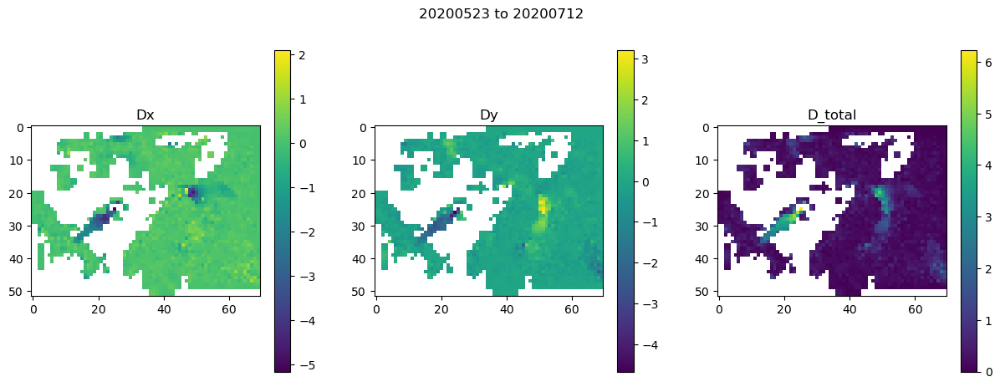

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01837611198425293
20200528 20200612
S2B_42SYH_20200528_B08_clipped.tif S2A_42SYH_20200612_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200528 20200612

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1271867752075195


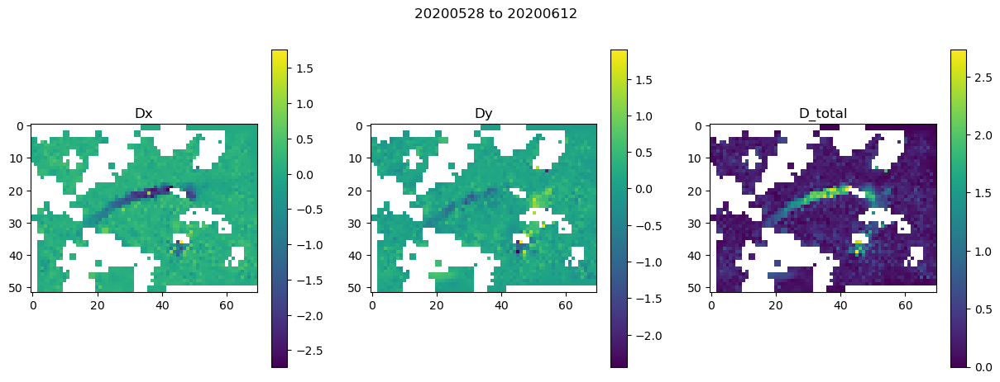

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018173933029174805
20200528 20200622
S2B_42SYH_20200528_B08_clipped.tif S2A_42SYH_20200622_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200528 20200622

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

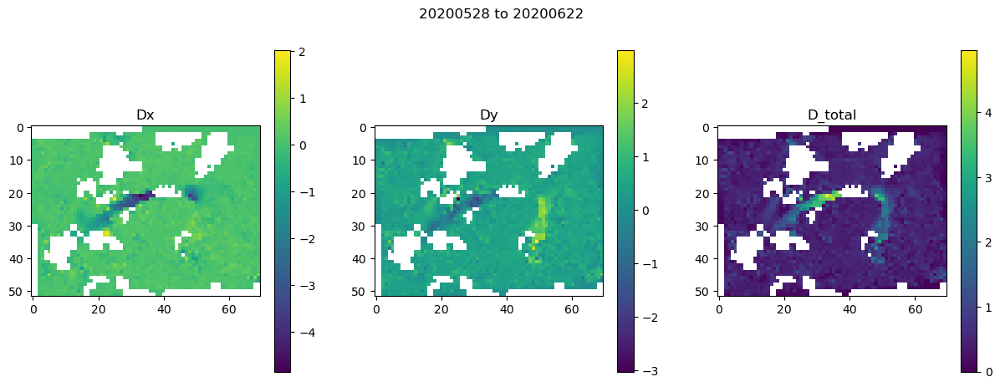

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01818394660949707
20200528 20200707
S2B_42SYH_20200528_B08_clipped.tif S2B_42SYH_20200707_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200528 20200707

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

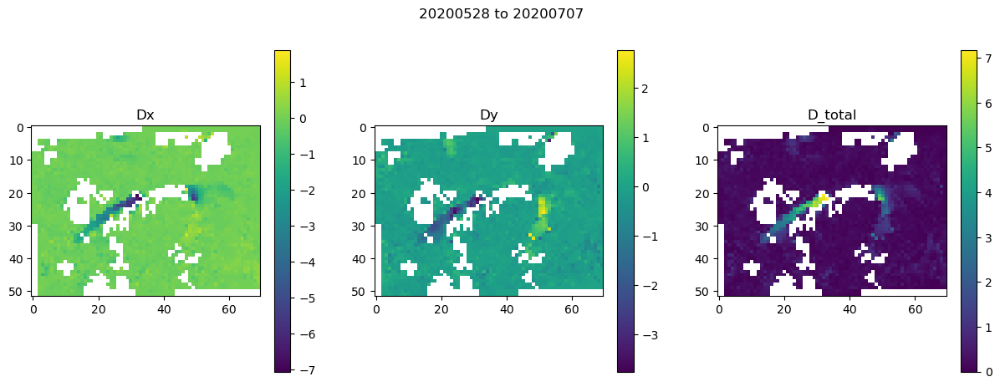

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01970696449279785
20200528 20200712
S2B_42SYH_20200528_B08_clipped.tif S2A_42SYH_20200712_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200528 20200712

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

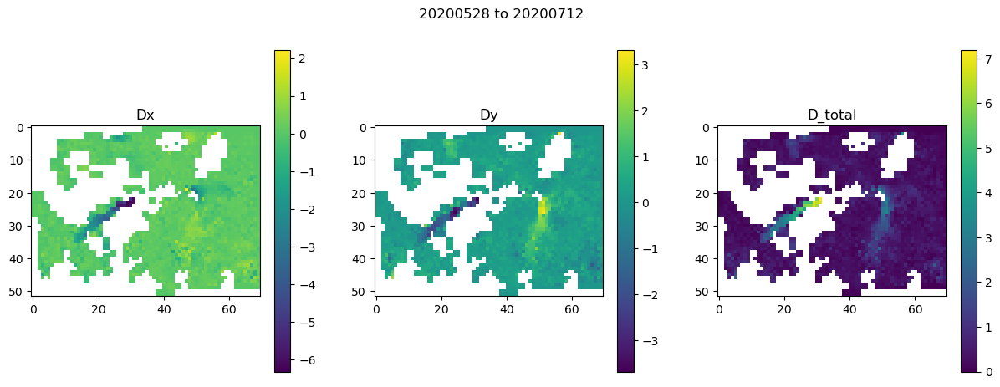

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018752098083496094
20200612 20200707
S2A_42SYH_20200612_B08_clipped.tif S2B_42SYH_20200707_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200612 20200707

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1088879108428955


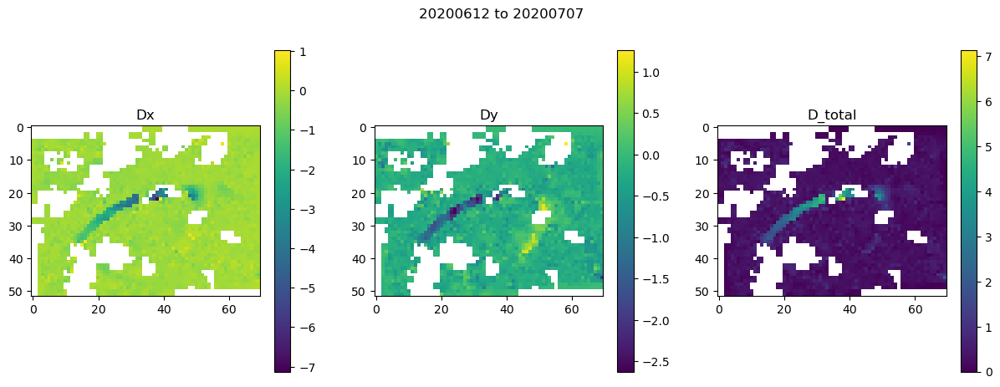

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017743825912475586
20200612 20200712
S2A_42SYH_20200612_B08_clipped.tif S2A_42SYH_20200712_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200612 20200712

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

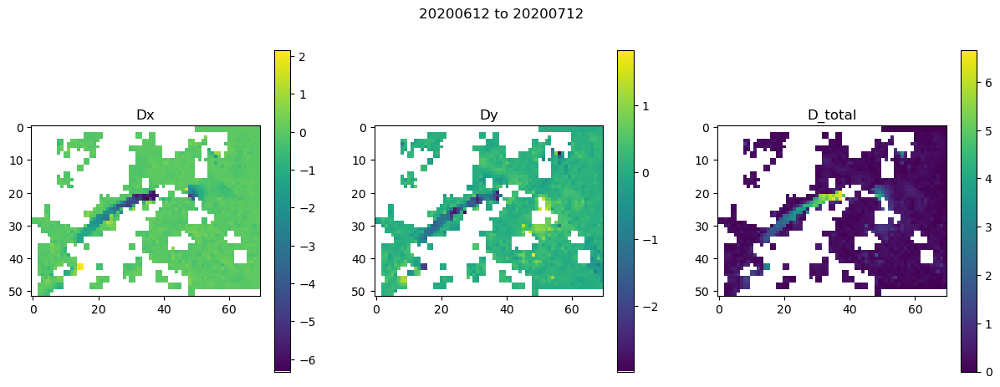

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01739192008972168
20200612 20200801
S2A_42SYH_20200612_B08_clipped.tif S2A_42SYH_20200801_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200612 20200801

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

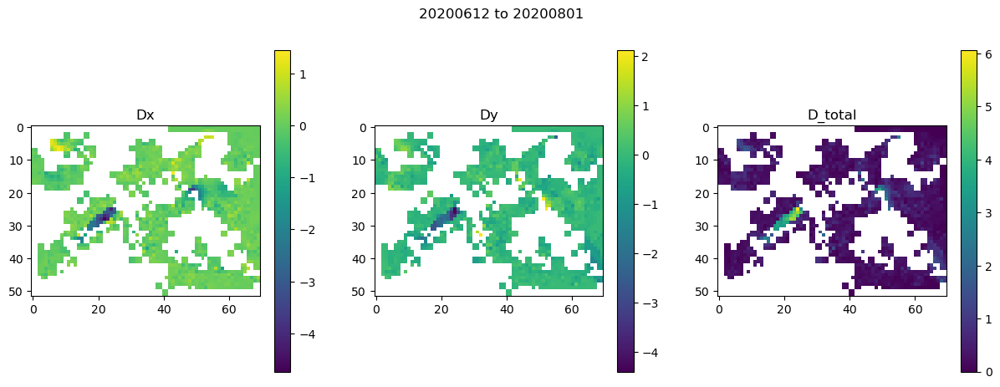

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01731705665588379
20200612 20200806
S2A_42SYH_20200612_B08_clipped.tif S2B_42SYH_20200806_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200612 20200806

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

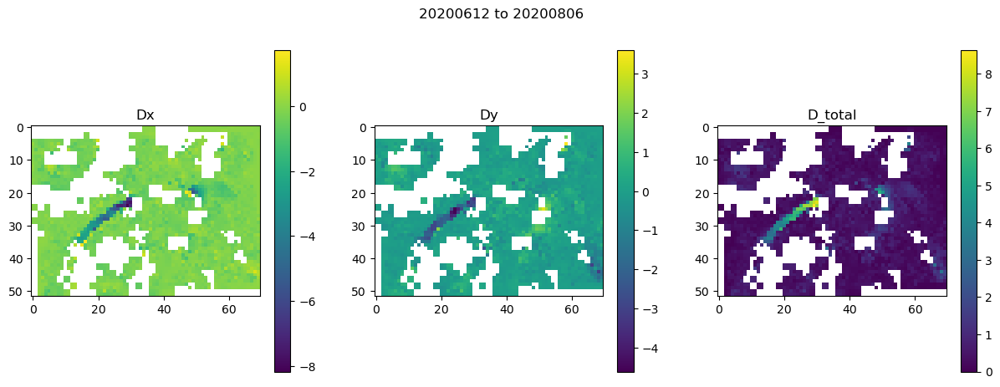

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01797199249267578
20200612 20200811
S2A_42SYH_20200612_B08_clipped.tif S2A_42SYH_20200811_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200612 20200811

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

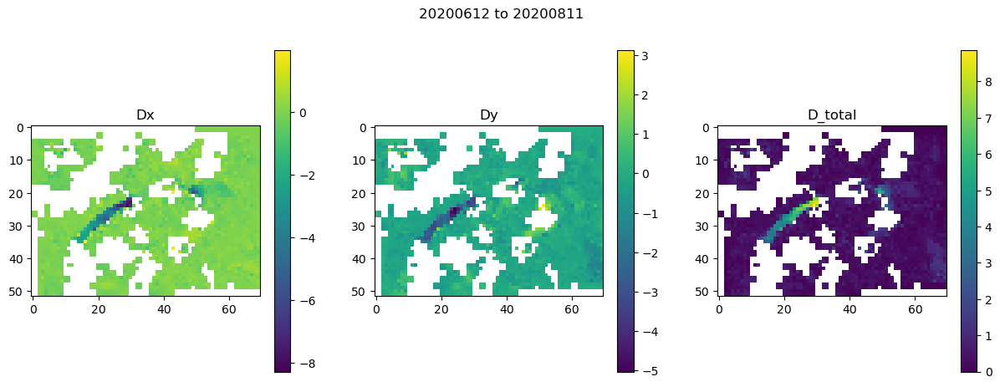

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017922163009643555
20200622 20200707
S2A_42SYH_20200622_B08_clipped.tif S2B_42SYH_20200707_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200707

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1099750995635986


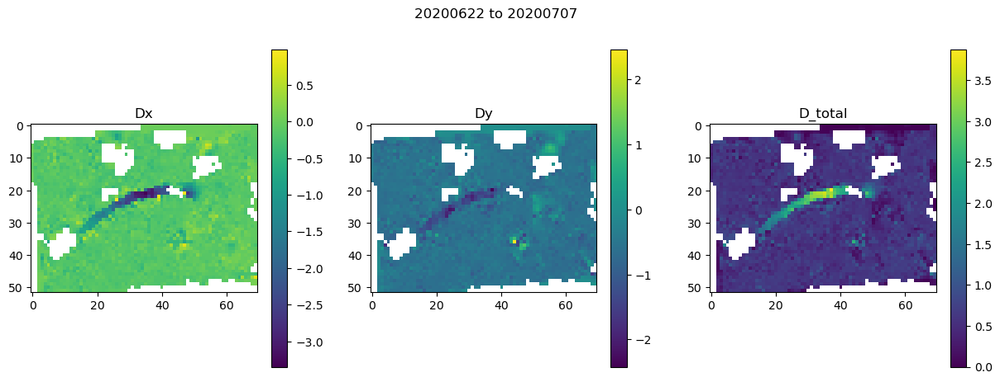

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018229007720947266
20200622 20200712
S2A_42SYH_20200622_B08_clipped.tif S2A_42SYH_20200712_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200712

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

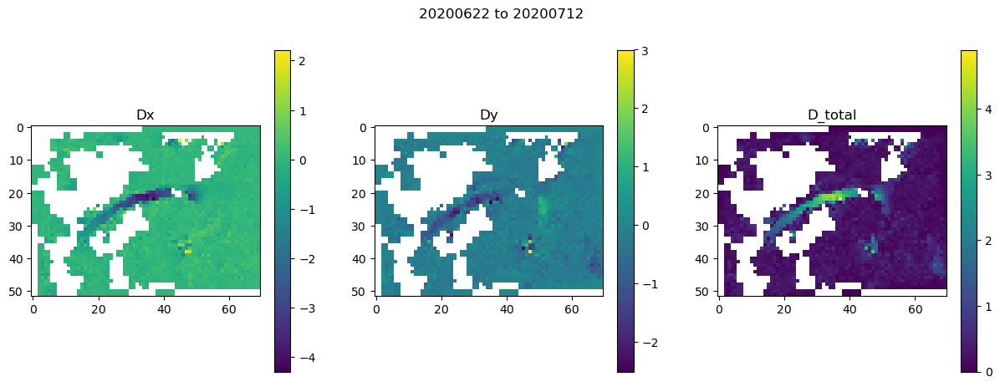

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018300294876098633
20200622 20200801
S2A_42SYH_20200622_B08_clipped.tif S2A_42SYH_20200801_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200801

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

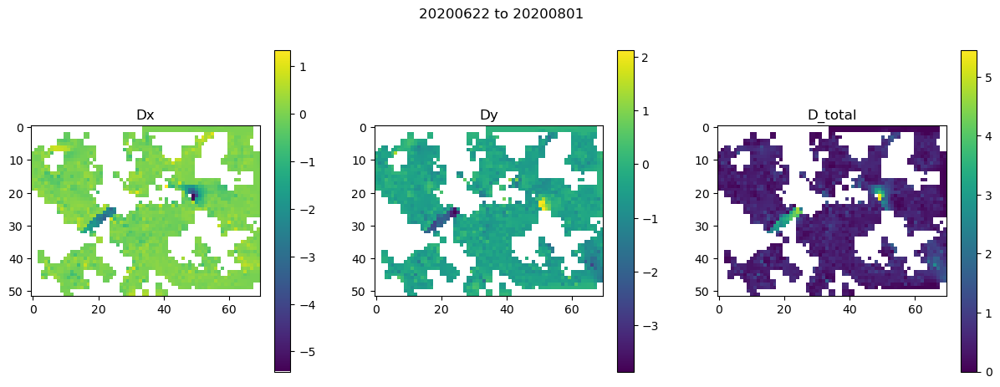

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01870584487915039
20200622 20200806
S2A_42SYH_20200622_B08_clipped.tif S2B_42SYH_20200806_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200806

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

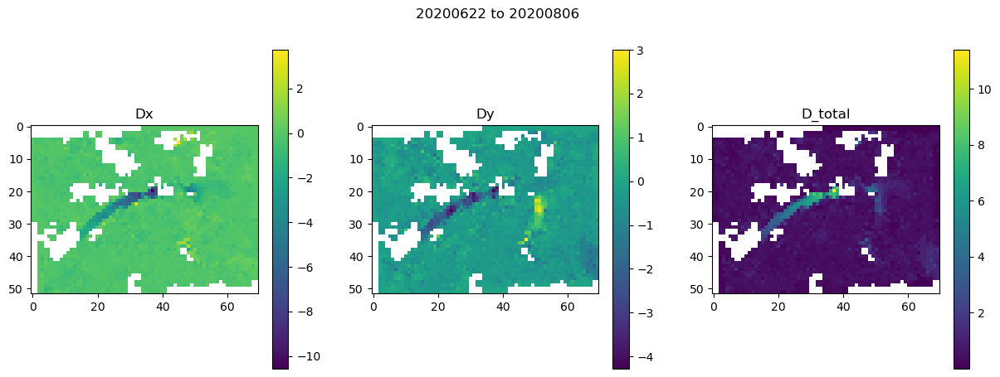

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01819324493408203
20200622 20200811
S2A_42SYH_20200622_B08_clipped.tif S2A_42SYH_20200811_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200811

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

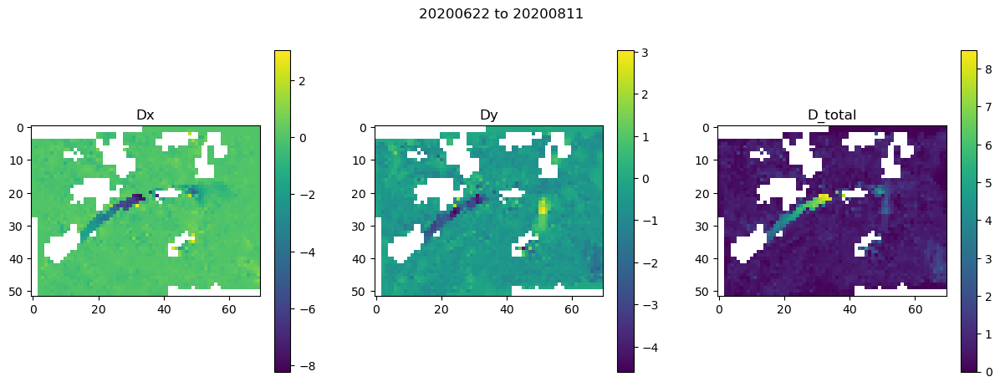

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017887115478515625
20200622 20200816
S2A_42SYH_20200622_B08_clipped.tif S2B_42SYH_20200816_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200816

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

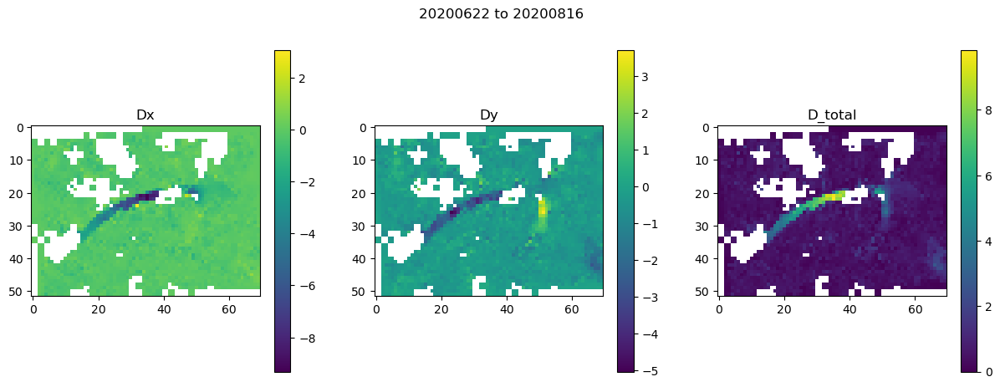

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018353939056396484
20200622 20200821
S2A_42SYH_20200622_B08_clipped.tif S2A_42SYH_20200821_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200622 20200821

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

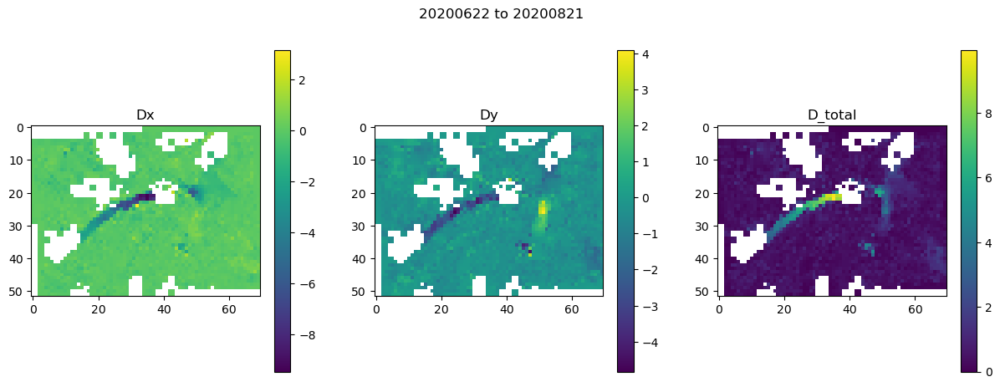

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018344879150390625
20200707 20200801
S2B_42SYH_20200707_B08_clipped.tif S2A_42SYH_20200801_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200801

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0869059562683105


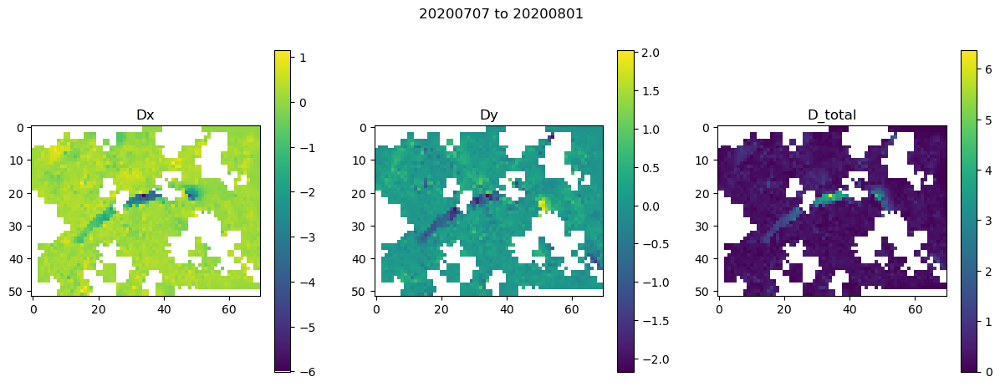

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01744699478149414
20200707 20200806
S2B_42SYH_20200707_B08_clipped.tif S2B_42SYH_20200806_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200806

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

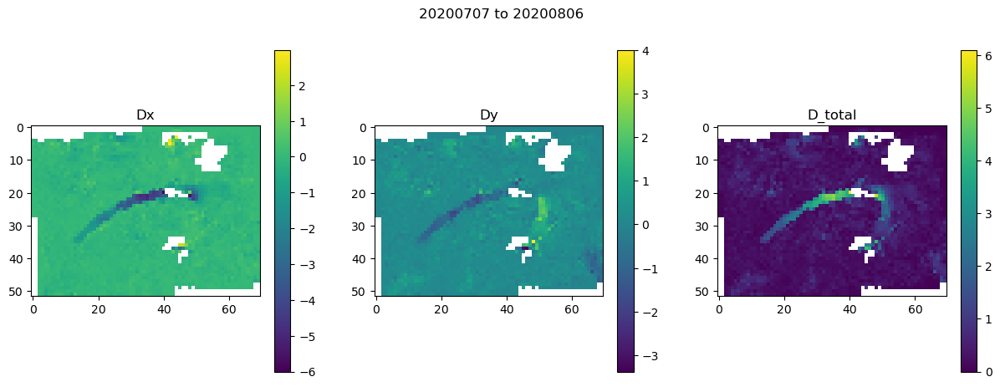

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018419981002807617
20200707 20200811
S2B_42SYH_20200707_B08_clipped.tif S2A_42SYH_20200811_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200811

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

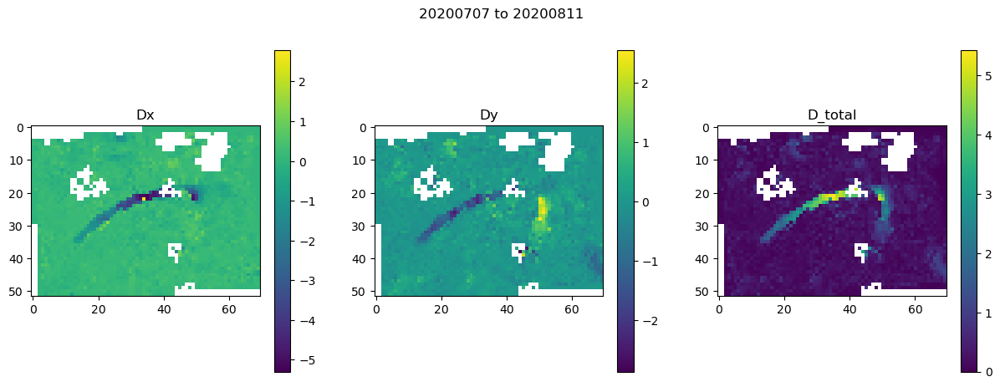

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017354965209960938
20200707 20200816
S2B_42SYH_20200707_B08_clipped.tif S2B_42SYH_20200816_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200816

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

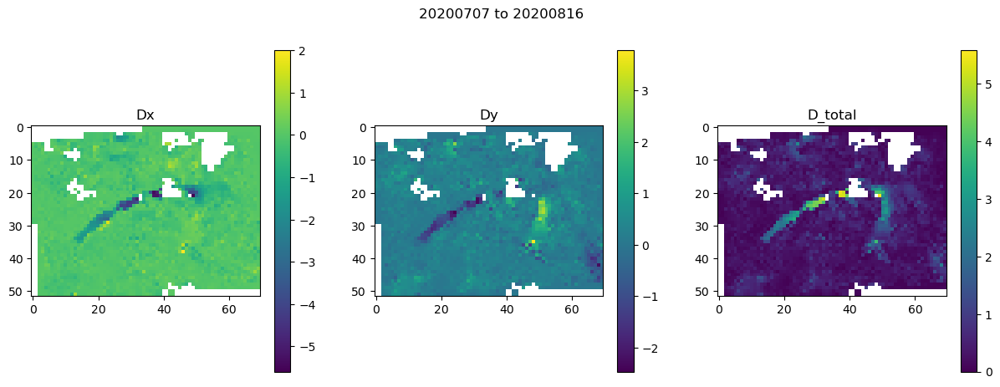

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018678903579711914
20200707 20200821
S2B_42SYH_20200707_B08_clipped.tif S2A_42SYH_20200821_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200821

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

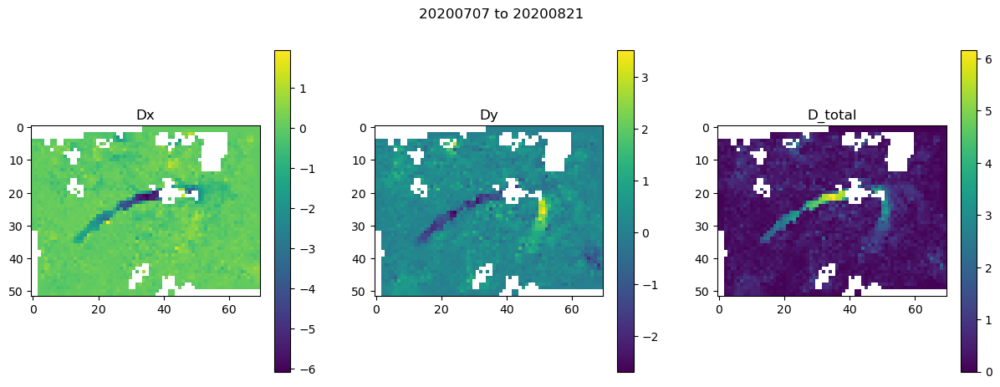

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01812887191772461
20200707 20200905
S2B_42SYH_20200707_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200707 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

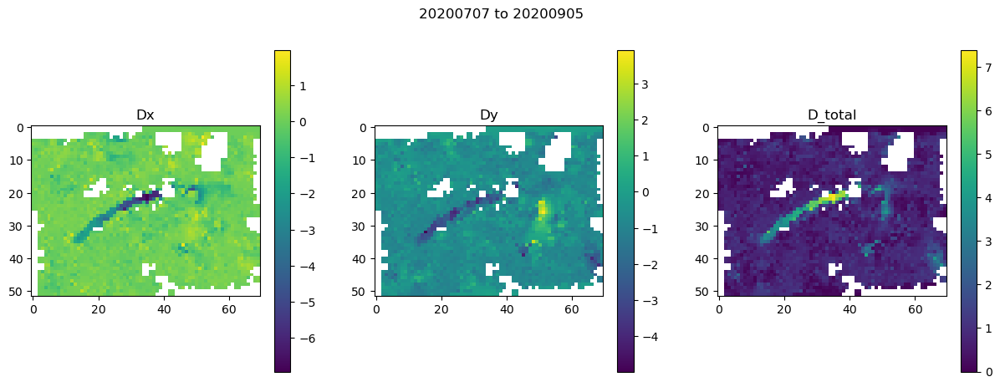

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021541833877563477
20200712 20200801
S2A_42SYH_20200712_B08_clipped.tif S2A_42SYH_20200801_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200801

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1419968605041504


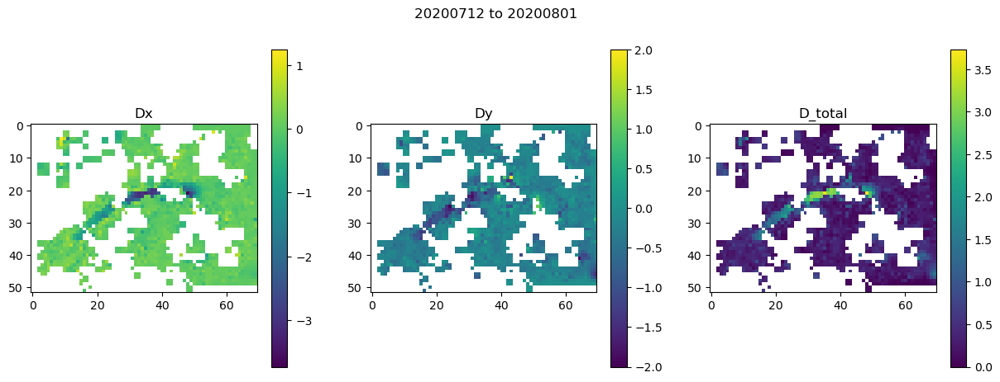

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018584012985229492
20200712 20200806
S2A_42SYH_20200712_B08_clipped.tif S2B_42SYH_20200806_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200806

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

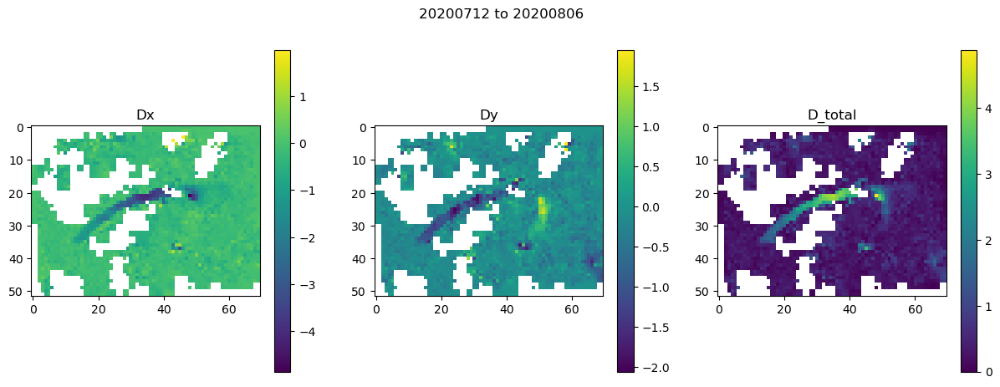

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01878809928894043
20200712 20200811
S2A_42SYH_20200712_B08_clipped.tif S2A_42SYH_20200811_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200811

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

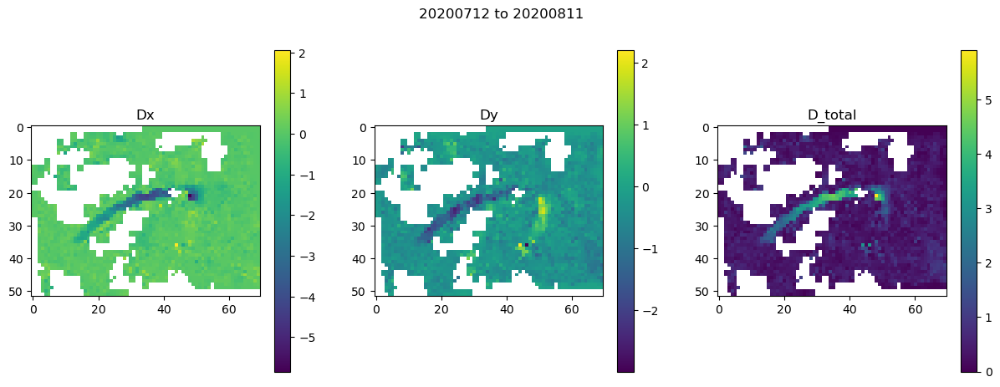

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01867389678955078
20200712 20200816
S2A_42SYH_20200712_B08_clipped.tif S2B_42SYH_20200816_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200816

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

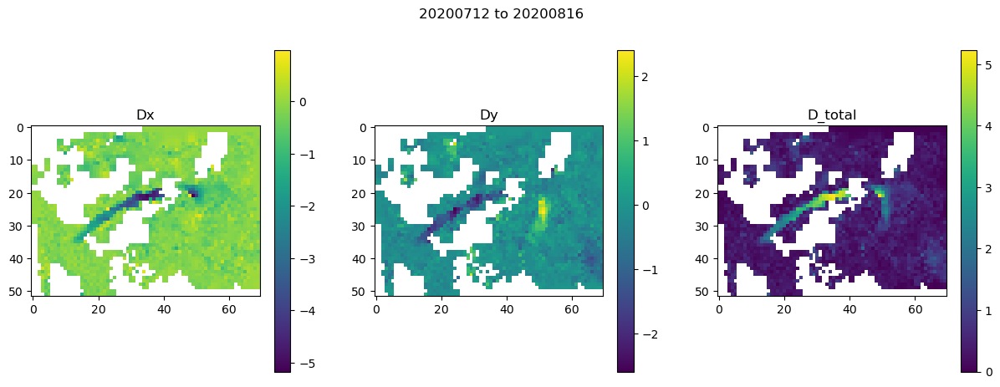

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01742100715637207
20200712 20200821
S2A_42SYH_20200712_B08_clipped.tif S2A_42SYH_20200821_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200821

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

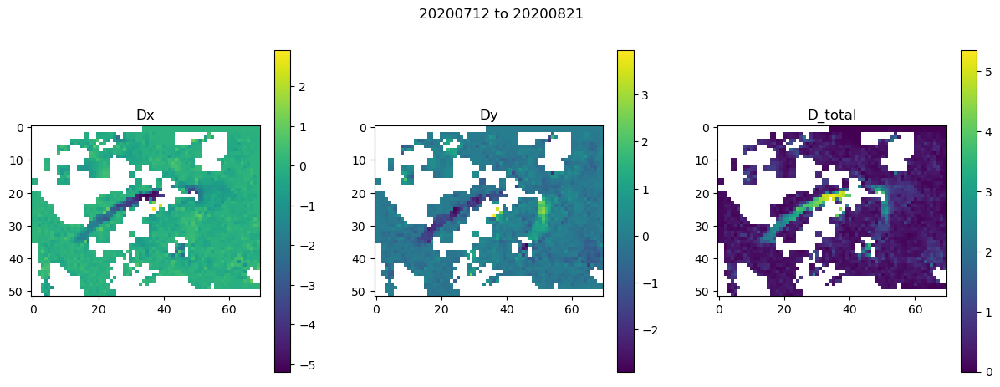

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017420053482055664
20200712 20200905
S2A_42SYH_20200712_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

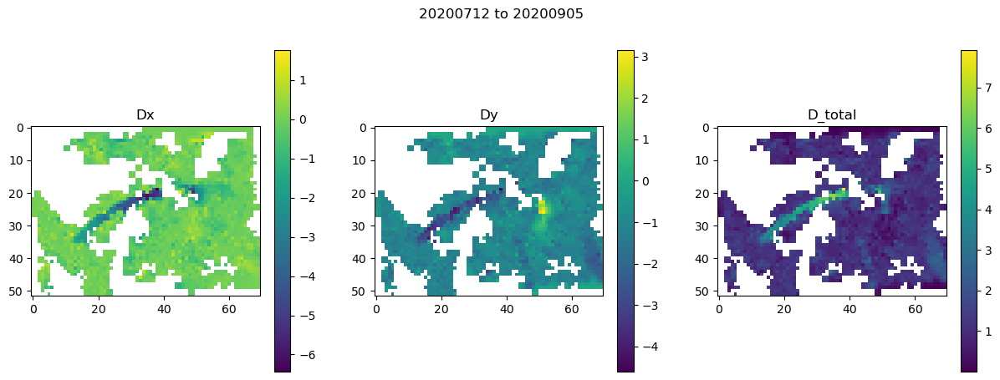

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01730513572692871
20200712 20200910
S2A_42SYH_20200712_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200712 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

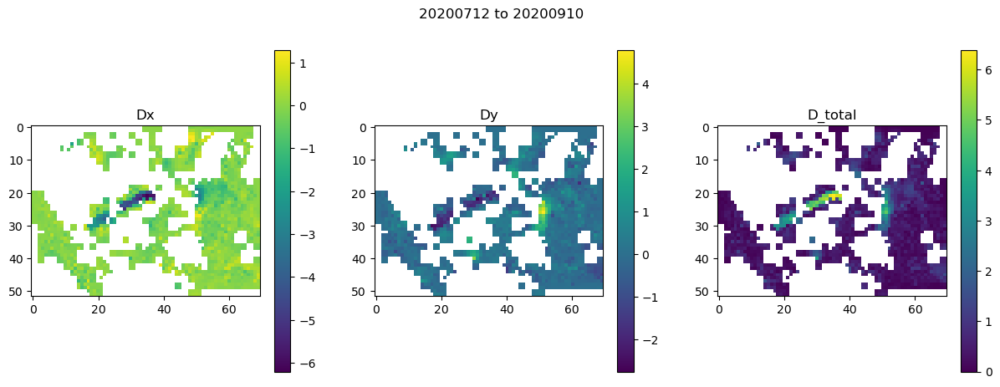

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01748490333557129
20200801 20200816
S2A_42SYH_20200801_B08_clipped.tif S2B_42SYH_20200816_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200816

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.130946159362793


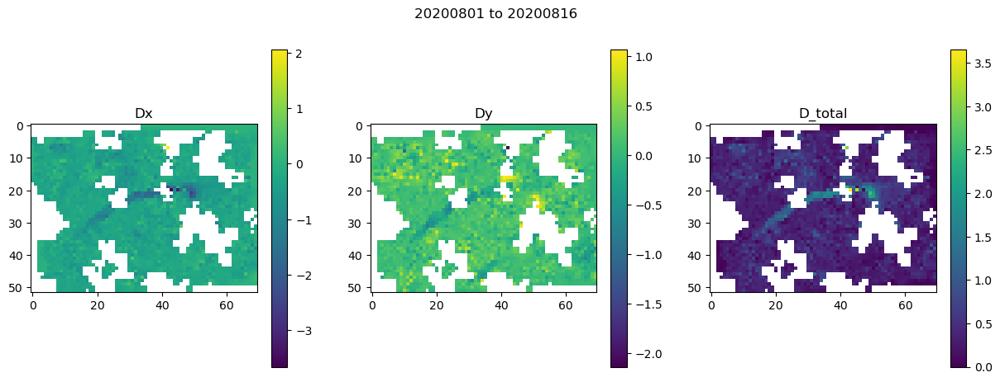

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018876075744628906
20200801 20200821
S2A_42SYH_20200801_B08_clipped.tif S2A_42SYH_20200821_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200821

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

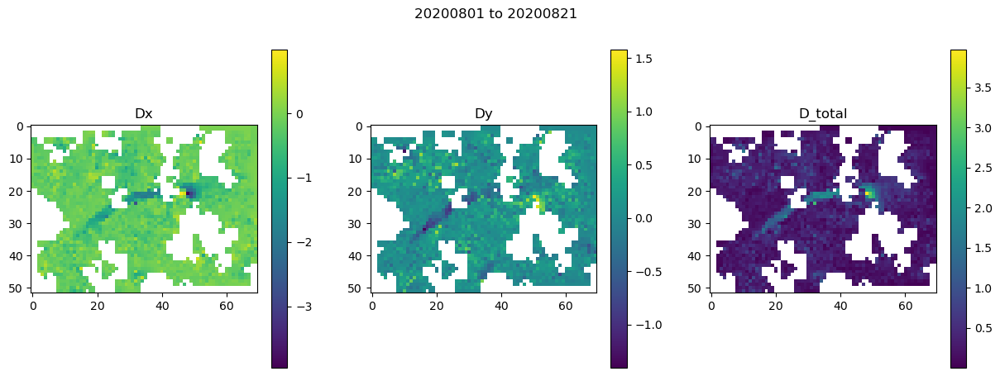

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01818227767944336
20200801 20200905
S2A_42SYH_20200801_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

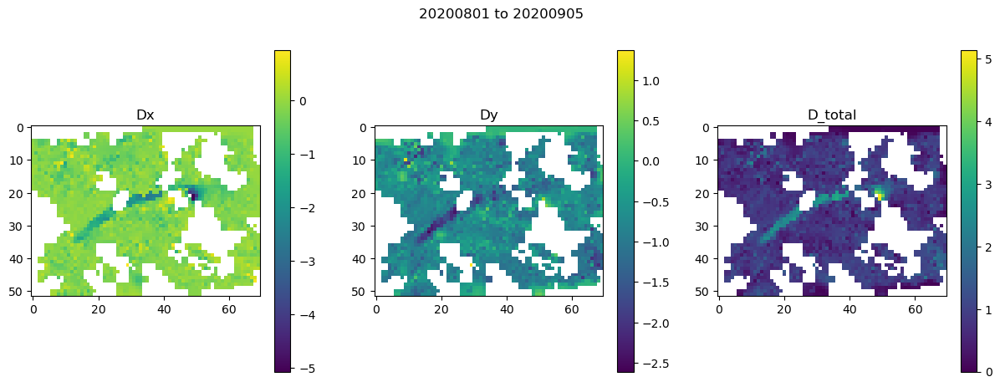

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01971602439880371
20200801 20200910
S2A_42SYH_20200801_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

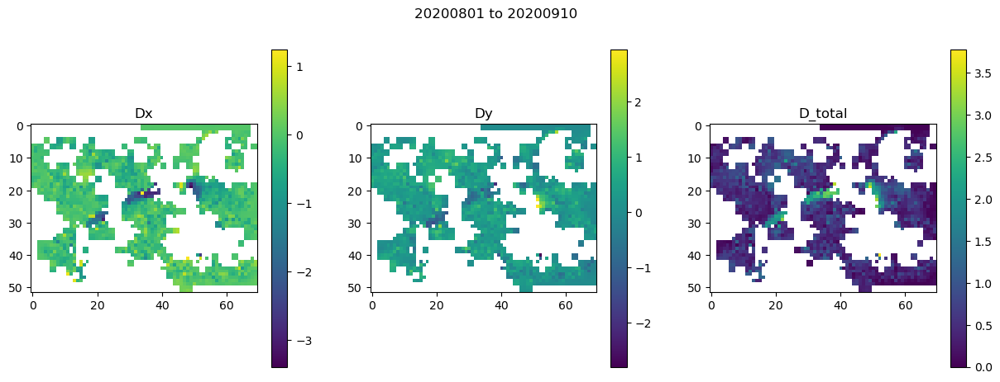

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018896818161010742
20200801 20200915
S2A_42SYH_20200801_B08_clipped.tif S2B_42SYH_20200915_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

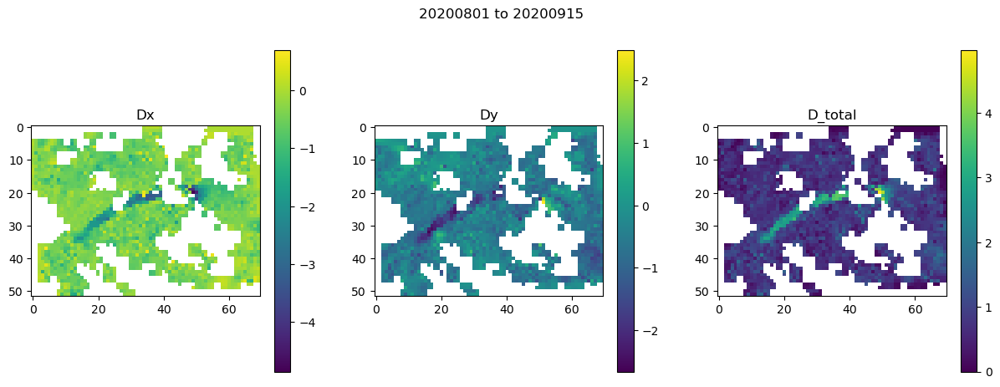

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.02070784568786621
20200801 20200920
S2A_42SYH_20200801_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

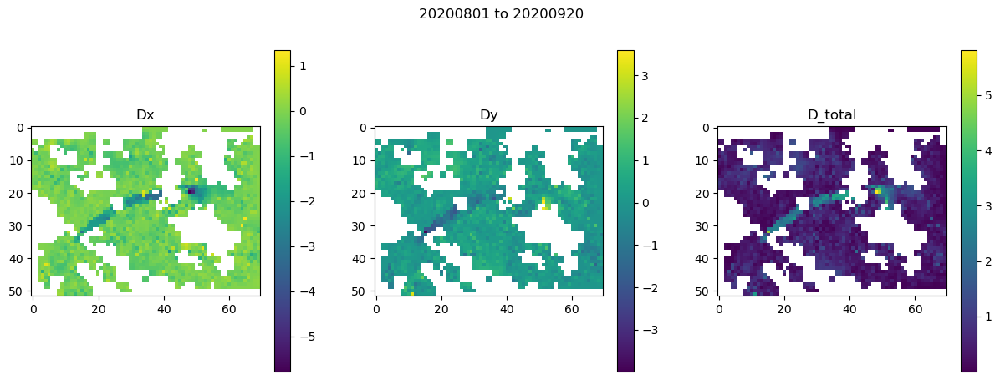

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018924951553344727
20200801 20200925
S2A_42SYH_20200801_B08_clipped.tif S2B_42SYH_20200925_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200801 20200925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

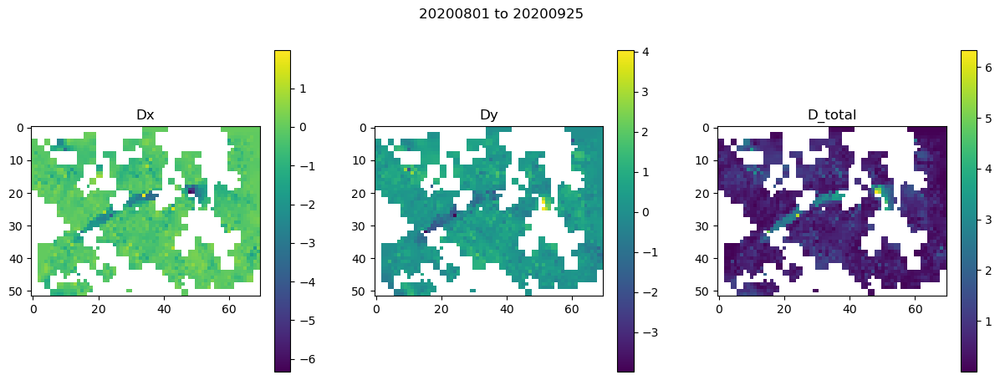

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017204999923706055
20200806 20200821
S2B_42SYH_20200806_B08_clipped.tif S2A_42SYH_20200821_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200821

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0498478412628174


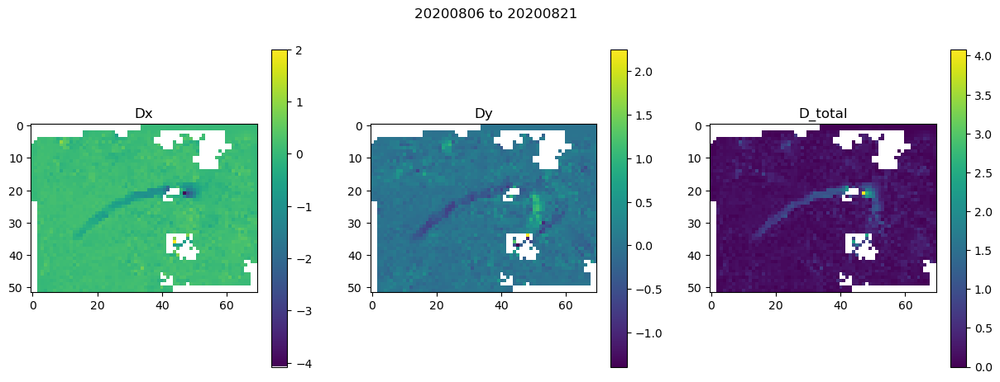

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017472028732299805
20200806 20200905
S2B_42SYH_20200806_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

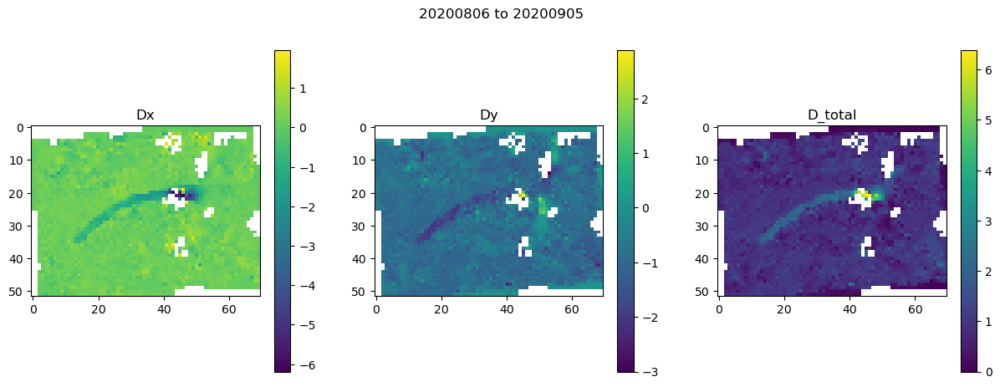

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017427921295166016
20200806 20200910
S2B_42SYH_20200806_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

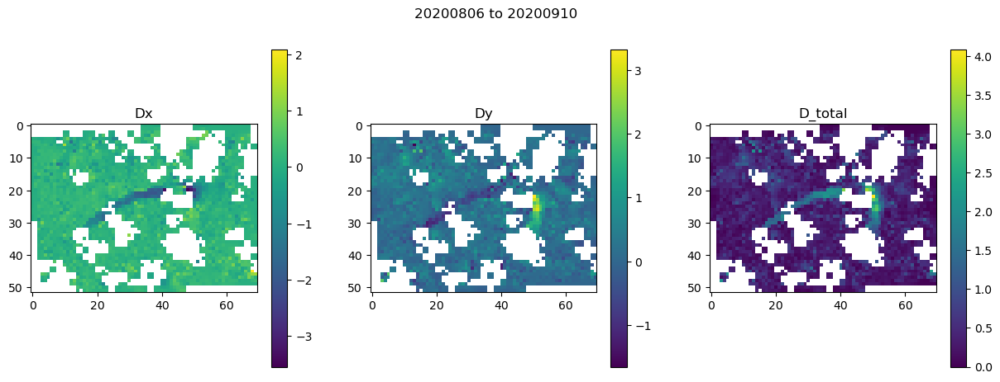

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019153118133544922
20200806 20200915
S2B_42SYH_20200806_B08_clipped.tif S2B_42SYH_20200915_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

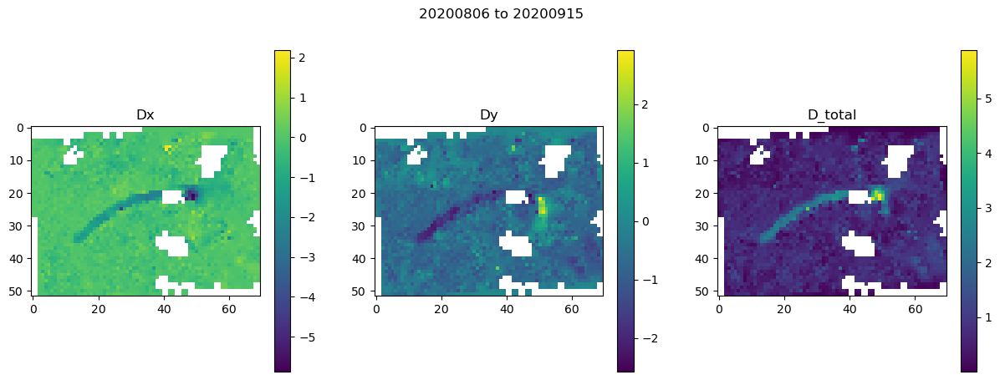

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01818394660949707
20200806 20200920
S2B_42SYH_20200806_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

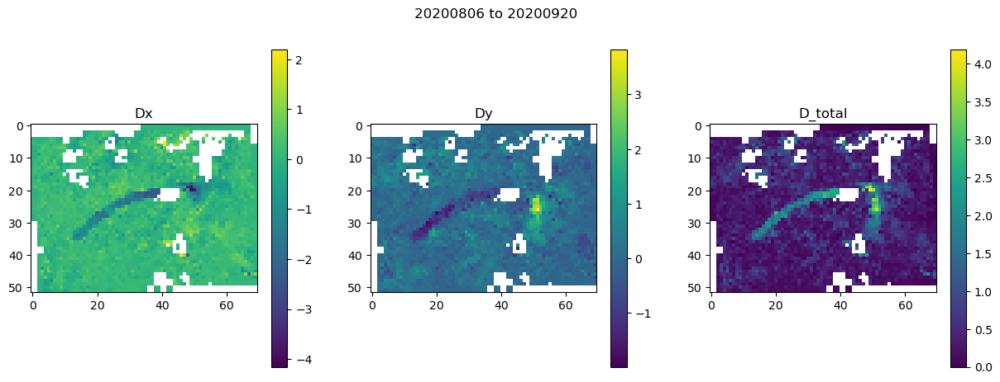

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01868605613708496
20200806 20200925
S2B_42SYH_20200806_B08_clipped.tif S2B_42SYH_20200925_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200806 20200925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4320000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

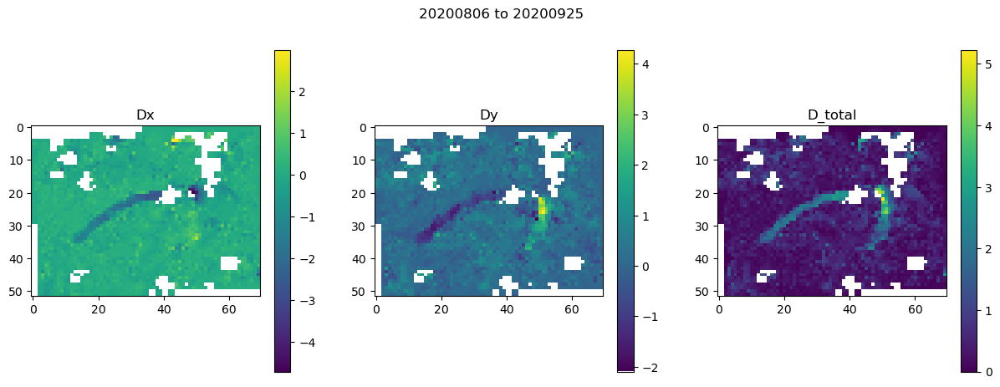

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018291950225830078
20200811 20200905
S2A_42SYH_20200811_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200811 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1254918575286865


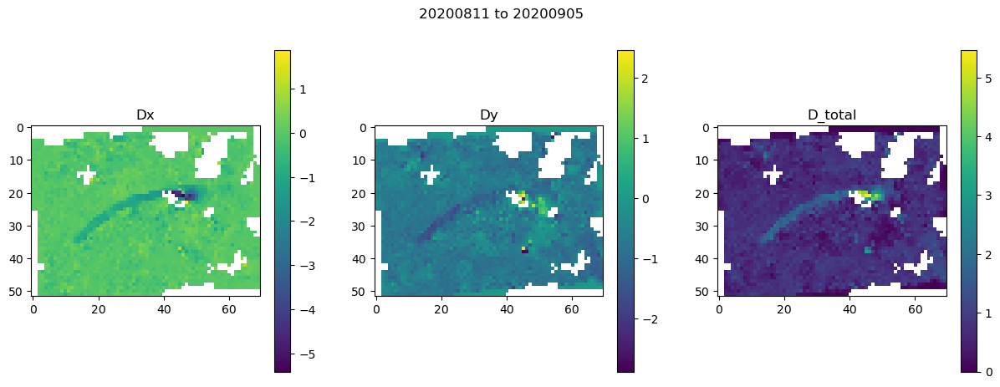

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.021806955337524414
20200811 20200910
S2A_42SYH_20200811_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200811 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

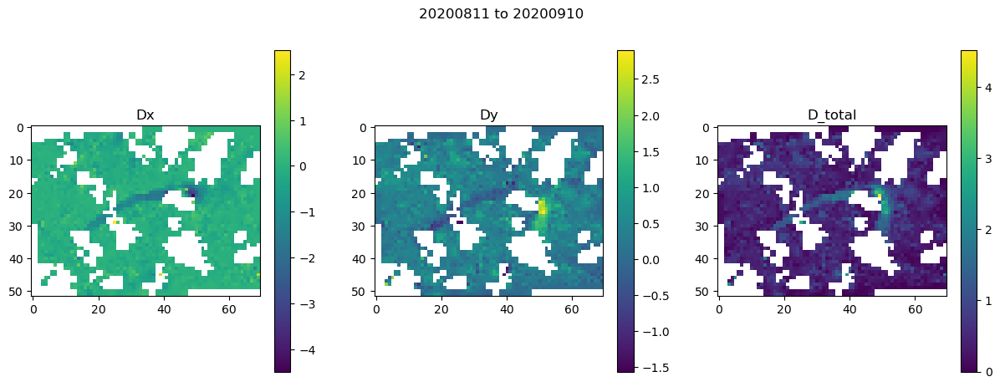

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01895594596862793
20200811 20200915
S2A_42SYH_20200811_B08_clipped.tif S2B_42SYH_20200915_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200811 20200915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

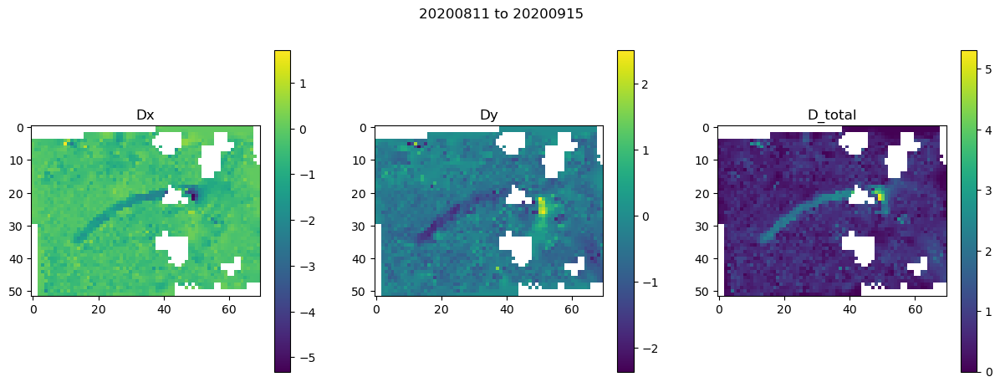

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018523216247558594
20200811 20200920
S2A_42SYH_20200811_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200811 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

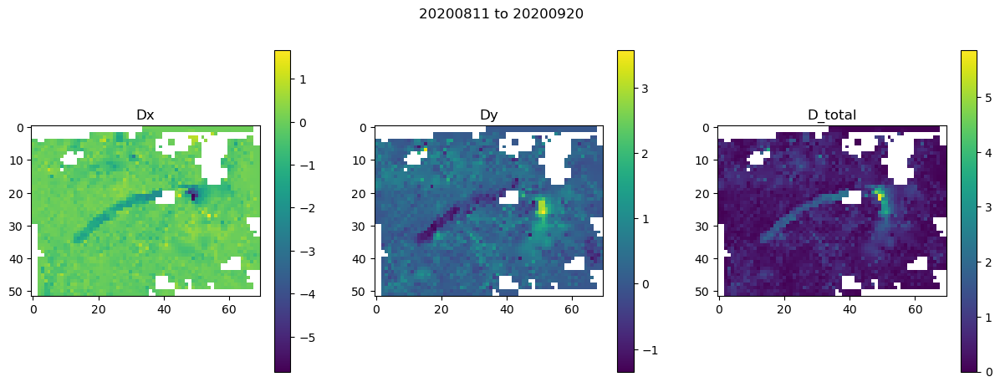

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017554044723510742
20200811 20200925
S2A_42SYH_20200811_B08_clipped.tif S2B_42SYH_20200925_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200811 20200925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3888000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

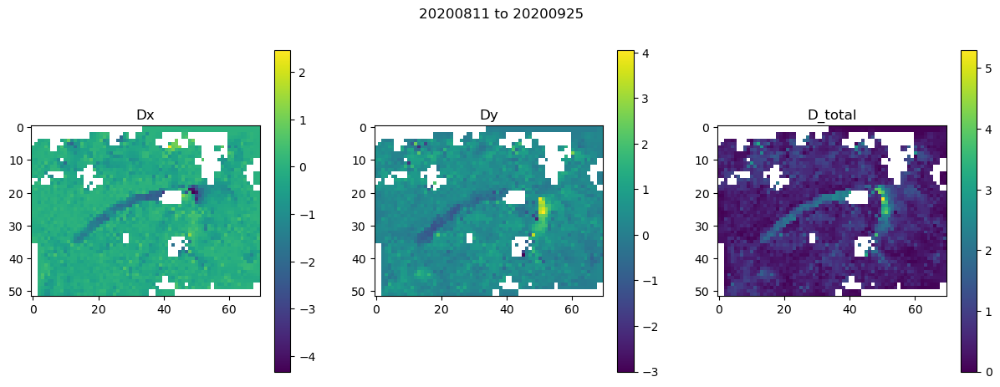

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.016808271408081055
20200816 20200905
S2B_42SYH_20200816_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.0903637409210205


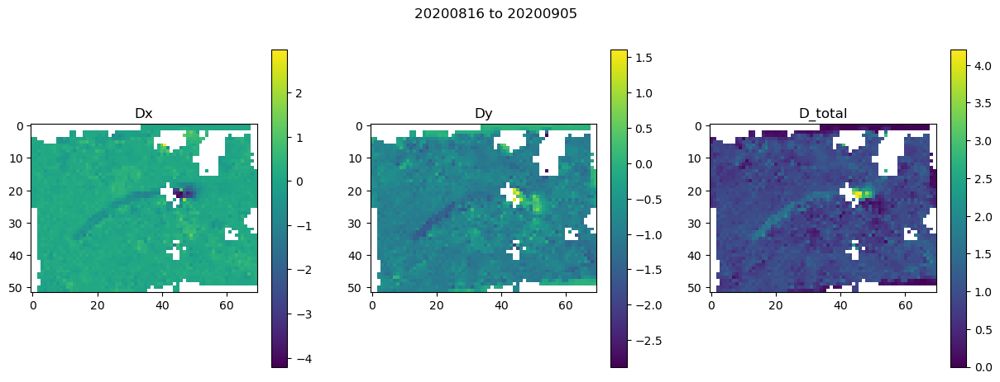

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018481969833374023
20200816 20200910
S2B_42SYH_20200816_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

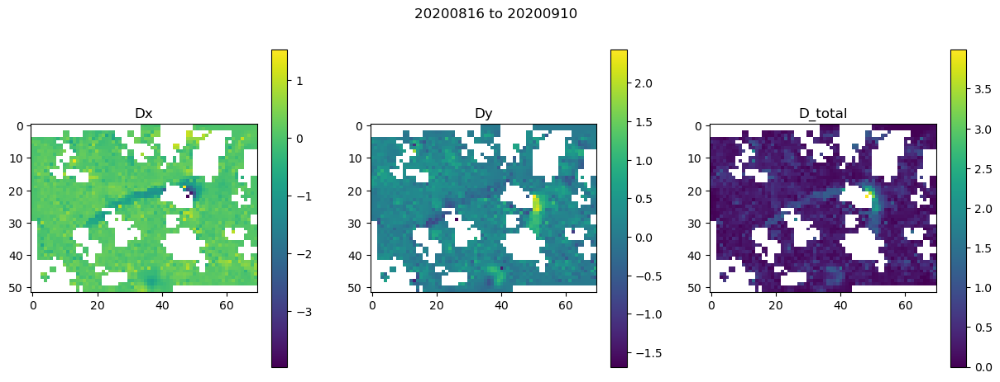

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01746511459350586
20200816 20200915
S2B_42SYH_20200816_B08_clipped.tif S2B_42SYH_20200915_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20200915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

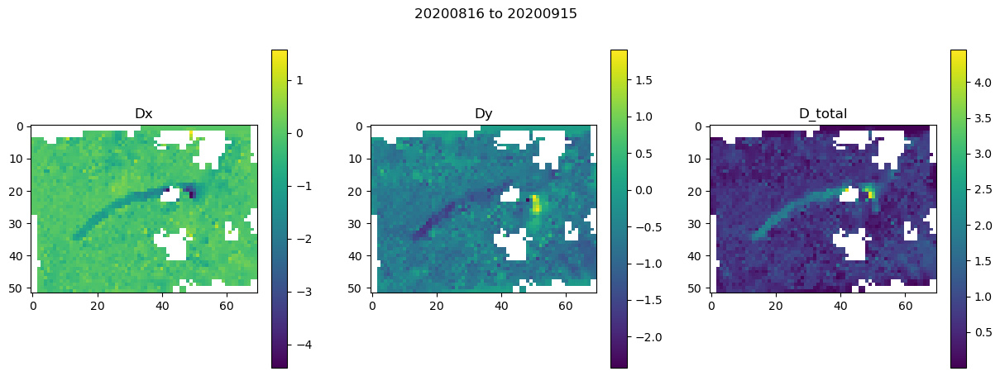

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01763916015625
20200816 20200920
S2B_42SYH_20200816_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Window

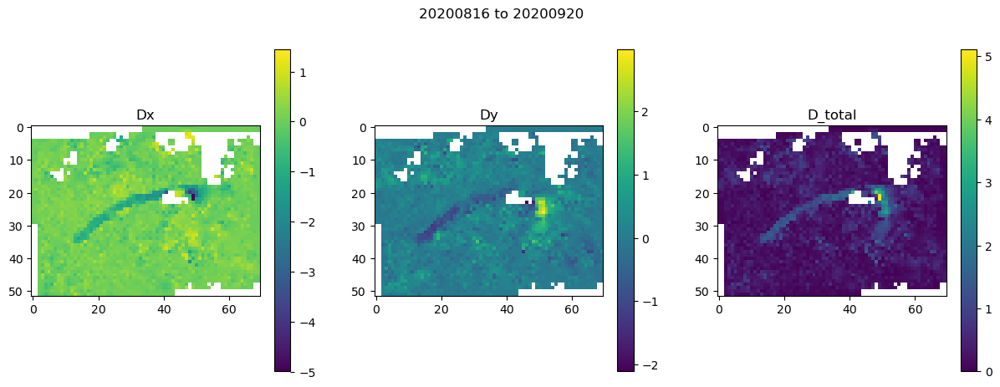

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01980900764465332
20200816 20200925
S2B_42SYH_20200816_B08_clipped.tif S2B_42SYH_20200925_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20200925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3456000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

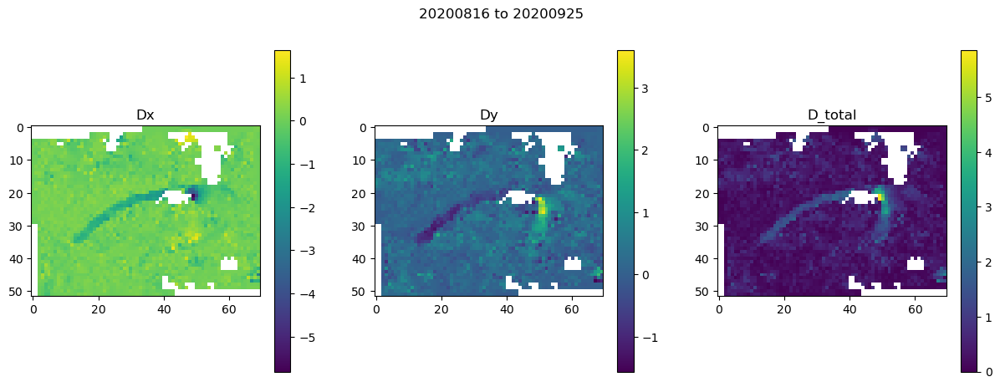

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.018926143646240234
20200816 20201015
S2B_42SYH_20200816_B08_clipped.tif S2B_42SYH_20201015_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200816 20201015

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

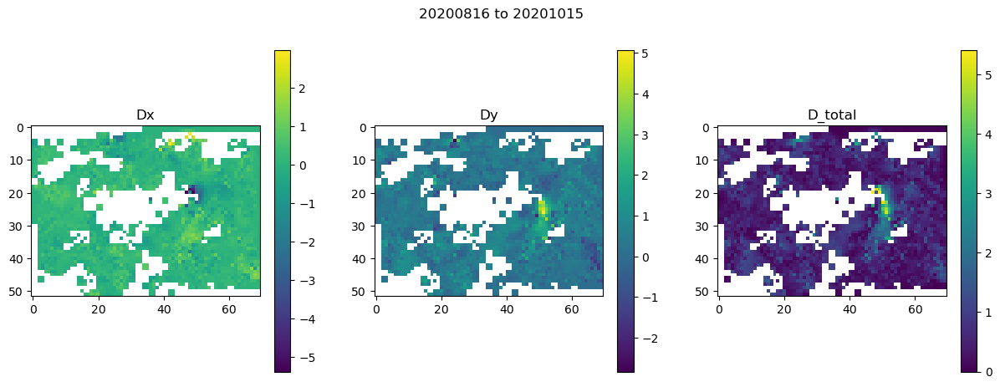

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019357919692993164
20200821 20200905
S2A_42SYH_20200821_B08_clipped.tif S2B_42SYH_20200905_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20200905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
1.1069221496582031


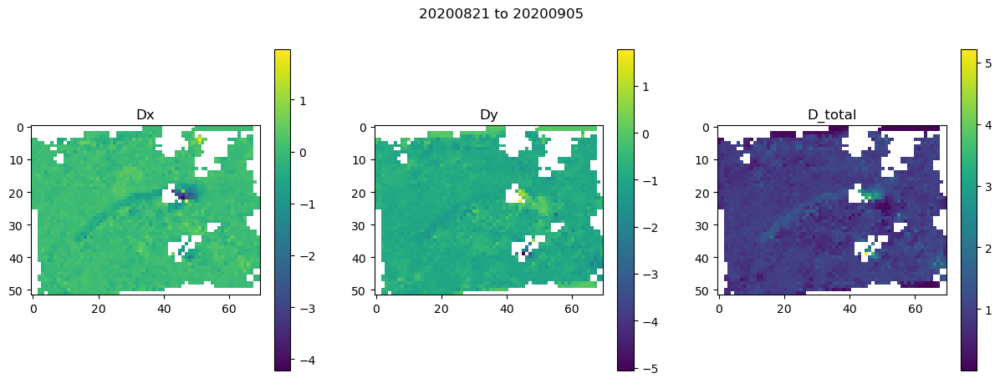

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01919722557067871
20200821 20200910
S2A_42SYH_20200821_B08_clipped.tif S2A_42SYH_20200910_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20200910

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1728000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

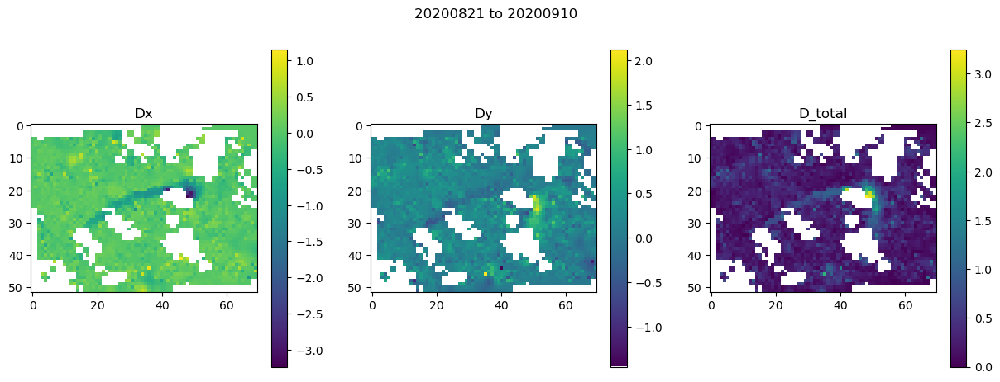

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01948380470275879
20200821 20200915
S2A_42SYH_20200821_B08_clipped.tif S2B_42SYH_20200915_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20200915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2160000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

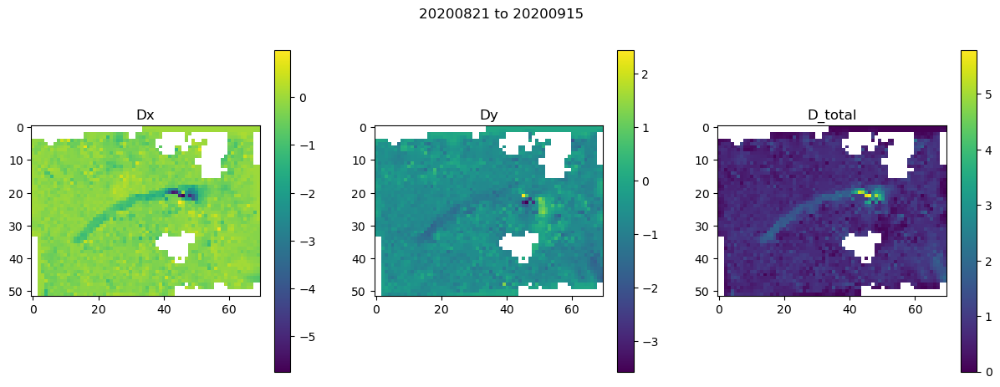

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01857900619506836
20200821 20200920
S2A_42SYH_20200821_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 2592000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

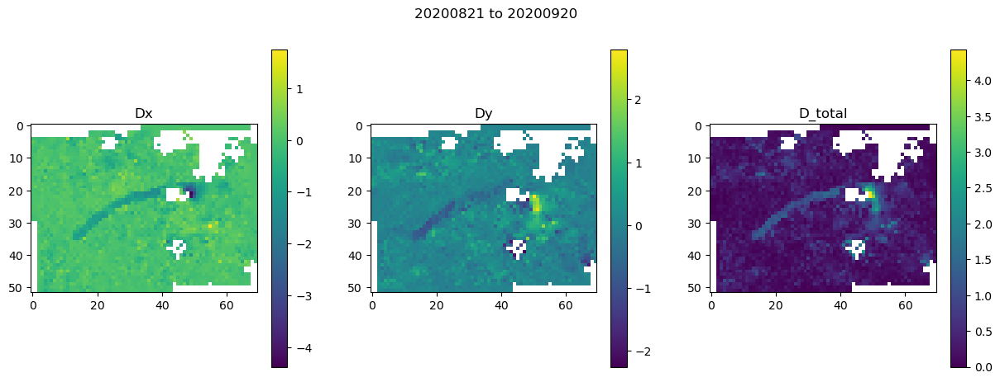

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.01769709587097168
20200821 20200925
S2A_42SYH_20200821_B08_clipped.tif S2B_42SYH_20200925_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20200925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 3024000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Win

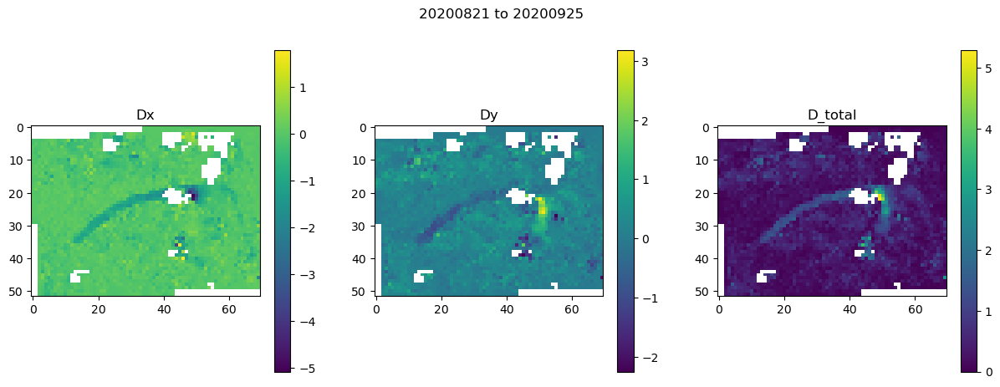

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.019702911376953125
20200821 20201015
S2A_42SYH_20200821_B08_clipped.tif S2B_42SYH_20201015_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20201015

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 4752000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

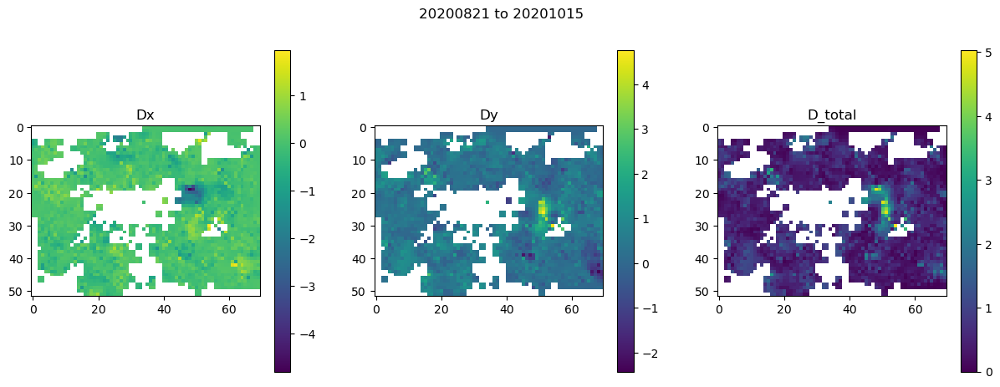

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017444849014282227
20200821 20201020
S2A_42SYH_20200821_B08_clipped.tif S2A_42SYH_20201020_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200821 20201020

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 5184000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

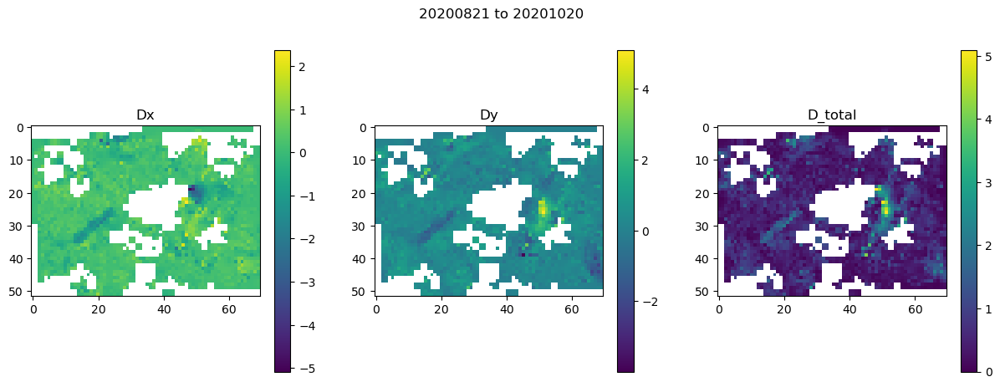

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.017378807067871094
20200905 20200920
S2B_42SYH_20200905_B08_clipped.tif S2A_42SYH_20200920_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20200905 20200920

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 771000.0  10.0
Y-direction coordinate: 4288520.0  -10.0
Dimensions: 1424  1062

Map inputs: 
EPSG: 32642
Smallest Allowable Chip Size in m: 200
Repeat Time: 1296000.0
XLimits: 771000.0  785240.0
YLimits: 4277900.0  4288520.0
Extent in km: 14.24  10.62
DEM: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_200m.tif
Slopes: /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdx_200m.tif  /Volumes/SGlacier/MZ/SRTM_1arc_v3_UTM42_clipped_dhdy_200m.tif

Outputs: 
Wi

In [ ]:
# for all satellites
for platform in PLATFORM_LIST:
    # assign the folder path based on the platform
    if platform == 'S2': # sentinel-2
        path = s2path
        ext = '_clipped.tif' # image filename extension
        img_type = 'OPT'
        date_split_idx = 2 # split filename by underscore, index corresponds to image date
    elif platform == 'LS': # landsat
        path = LSpath
        ext = '.TIF'
        img_type = 'OPT'
        date_split_idx = 3
    elif platform == 'PS': # PlanetScope
        path = PSpath
        ext = '.tif' 
        img_type = 'OPT'
        date_split_idx = 1
    else:
        print('Platform', platform, 'not recognized. Options are "S2", "LS", "PS"')

    # record all possible images and their dates
    dates = []; files = []  
    for file in os.listdir(path):
        if file.endswith(ext):
            date = file.split('_')[date_split_idx] # grab the date from the filename
            dates.append(date); files.append(file) # store the date and filename
    files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
    files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
    files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
    files_df = files_df.reset_index(drop=True) # reset index for searching
    print("Number of files found:",len(files_df))
    
    for min_chipsize in CHIPSIZE_LIST: # MULTIPLE CHIP SIZES
        MINCHIPSIZE = min_chipsize
        
        [dem_outfile, dhdx_outfile, dhdy_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
                                                                         refvpath, vx_fname, vy_fname, 
                                                                         sr_scaling)
        #######################################################################
        # # CHOOSE OPTIONAL INPUTS: (set as '' to leave blank)
        # # 1) surface slope:
        #   dhdx = ''; dhdy = ''  
        dhdx = dempath+dhdx_outfile; dhdy = dempath+dhdy_outfile
        
        # # 2) reference velocity:
        vx = ''; vy = ''    
#         vx = refvpath+'vx_'+str(MINCHIPSIZE)+'m.tif'; vy = refvpath+'vy_'+str(MINCHIPSIZE)+'m.tif'
        
        # # 3) chip sizes:
        csminx = ''; csminy = ''
        csmaxx = ''; csmaxy = ''  
        #             csminx = refvpath+csminx_fname; csminy = refvpath+csminy_fname
        #             csmaxx = refvpath+csmaxx_fname; csmaxy = refvpath+csmaxy_fname
        
        # # 4) stable surface mask:
        ssm = ''
        #             ssm = refvpath+ssm_outfile # stable surface mask 
        
        # # 5) search range limit:
        srx = ''; sry = '' # for best results, never input search range limit
        #######################################################################
        
        for rownum in range(0,len(files_df)-1):
            if rownum == 0: # for the first row, idx1 = 0 and idx2 = 1
                idx1 = rownum
            idx2 = idx1+1 # reset index 2 as the next item 

            if idx1 < len(files_df) and idx2 < len(files_df): # don't surpass the end of the data
                # identify the successive image pairs:
                m = files_df.loc[idx1,'filename']; 

                # grab the two dates and convert to datetime objects
                d1s = m.split('_')[date_split_idx]; 
                d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); 

                # grab the dt days for all files after the first date
                files_df['dt'] = (pd.to_datetime(files_df.date,format='%Y%m%d') - d1).dt.days
                # grab all those that have the correct date:
                match_df = files_df[(files_df.dt >= min_dt) & (files_df.dt <= max_dt)] 
                if len(match_df) > 0: # if files are found with the correct date separation, continue
                    for idx, row in match_df.iterrows():
                        # grab the secondary image
                        s = row.filename
                        d2s = s.split('_')[date_split_idx]
                        d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                        dt = d2-d1; dt = int(dt.days)

                        # run!
                        if not os.path.exists(out_path+'velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif'):
                            print(d1s, d2s)
                            
                            # run geogrid and autoRIFT
                            if m is not None and s is not None:
                                print(m,s)
                                indir_m = path+m; indir_s = path+s # path to the two images

                                # ADJUST CODE TO NOT HAVE TO CHANGE THIS BETWEEN SK AND LOWELL
                                dem = dempath+dem_outfile
                                dhdx = dempath+dhdx_outfile
                                dhdy = dempath+dhdy_outfile
                                ###################### RUN GEOGRID ################################
                                run_geogrid_inhouse(out_path, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                                                    dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm)

                                ##################### PREP AUTORIFT ##############################
                                gp = out_path # identify files produced from geogrid
                                # remove all empty grids
                                for grid in os.listdir(gp): 
                                    if grid.startswith('window') and grid.endswith('.tif'):
                                        reader = rio.open(gp+grid) # read dataset
                                        data_found = False 
                                        for band in range(1,reader.count+1):
                                            testband = reader.read(band) # read in the band
                                            if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                                                data_found = True
                                        if not data_found:
                                            print(grid, 'has no data. Removed.')
                                            os.remove(gp+grid)

                                # fill in AutoRIFT parameters using the files
                                mpflag = 0 # leave multiprocessing off

                                # GRID LOCATION (required) from window_location.tif
                                grid_location = rio.open(gp+'window_location.tif')
                                xGrid = grid_location.read(1) # 1st band in window location
                                yGrid = grid_location.read(2) # 2nd band in window location

                                # optional parameters (default None or zero until filled)
                                init_offset = None; search_range = None
                                chip_size_min = None; chip_size_max = None
                                offset2vx = None; offset2vy = None; stable_surface_mask = None
                                Dx0 = None; Dy0 = None; CSMINx0 = None
                                SRx0 = None; SRy0 = None;
                                CSMAXx0 = None; CSMAXy0 = None; SSM = None
                                noDataMask = np.zeros(xGrid.shape).astype(int)

                                if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
                                    init_offset = rio.open(gp+'window_offset.tif')
                                    Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
                                if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
                                    search_range = rio.open(gp+'window_search_range.tif')
                                    SRx0 = search_range.read(1); SRy0 = search_range.read(2)
                                if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
                                    chip_size_min = rio.open(gp+'window_chip_size_min.tif')
                                    CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
                                if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
                                    chip_size_max = rio.open(gp+'window_chip_size_max.tif')
                                    CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
                                if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
                                    offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
                                if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
                                    offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
                                if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
                                    stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
                                    noDataMask = stable_surface_mask.read(1)

                                # other parameters
                                nodata = NO_DATA_VAL # use same as in previous steps
                                geogrid_run_info=None
                                print('AutoRIFT parameters loaded.')

                                ##################### RUN AUTORIFT ##############################
                                # run autoRIFT with function
                                run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                                                         FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, 
                                                         OVERSAMPLE_RATIO, MINCHIPSIZE,
                                                         Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                                                     noDataMask, nodata, geogrid_run_info=None)
                        else:
                            print('velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif already exists.')
                else: # otherwise
                    print('No image pair with correct time separation found. Skip to next.')

            idx1 += 1 # just go to the next available image
            if idx2 >= len(files_df)-1:
                print('Finished searching.')
                break

## Run successive pairs of images only:

Number of files found: 103
LO_ArcticDEM_clipped_100m.tif  already exists.
LO_ArcticDEM_clipped_dhdy_100m.tif and LO_ArcticDEM_clipped_dhdx_100m.tif already exist.
20210119 20210127
S2A_8VLM_20210119_B08_clipped.tif S2B_8VLM_20210127_B08_clipped.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210119 20210127

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x vector: window_rdr_off2ve

/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1398: RuntimeWarning: divide by zero encountered in divide
  DxMadmin = np.ones(Dx.shape) / OverSampleRatio / SearchLimitX * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1399: RuntimeWarning: divide by zero encountered in divide
  DyMadmin = np.ones(Dy.shape) / OverSampleRatio / SearchLimitY * 2;
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1217: RuntimeWarning: All-NaN slice encountered
  r, k = function_base._ureduce(a, func=_nanmedian, axis=axis, out=out,
/opt/anaconda3/envs/autorift/lib/python3.8/site-packages/autoRIFT/autoRIFT.py:1352: RuntimeWarning: Mean of empty slice
  C = np.nanmean(B,axis=0).reshape(output_size)
/var/folders/3x/b7l093_n5fj39h7yr0krrj68gncyc1/T/ipykernel_87506/2022748542.py:180: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this

AutoRIFT Done!!!
34.6519889831543


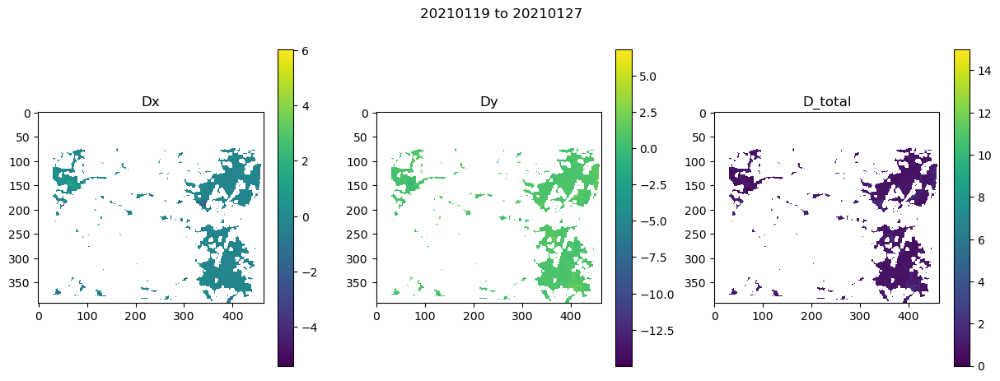

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.3298161029815674
S2B_8VLM_20210127_B08_clipped.tif S2B_8VLM_20210203_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210127 20210203

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

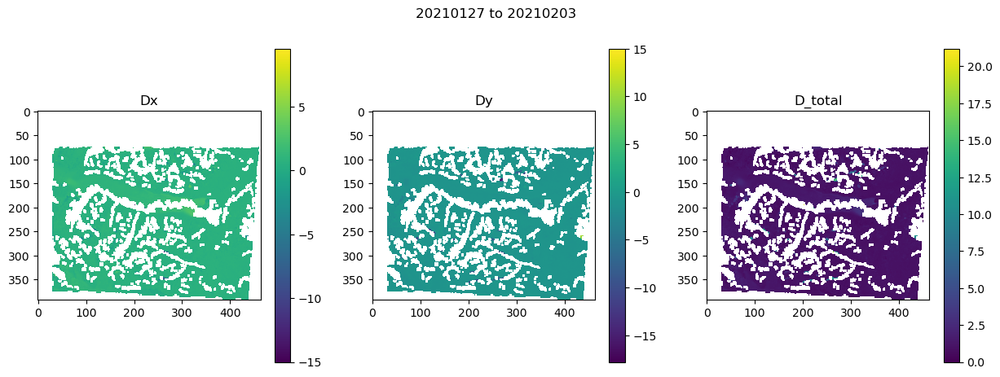

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.25092506408691406
20210203 20210208
S2B_8VLM_20210203_B08_clipped.tif S2A_8VLM_20210208_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210203 20210208

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

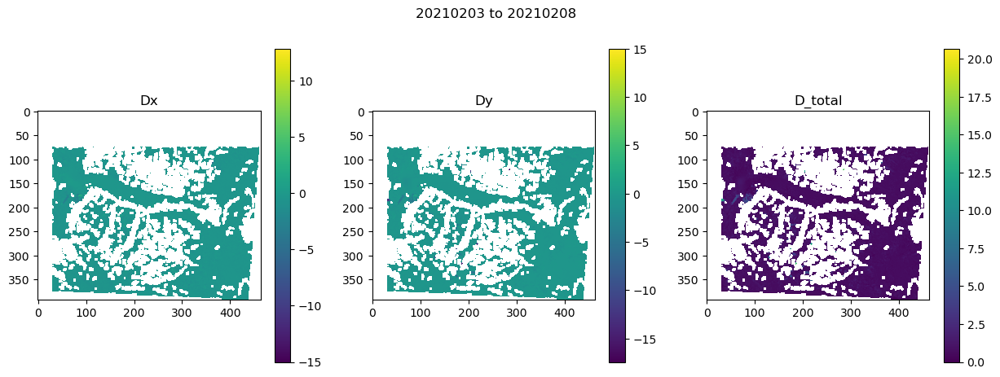

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.290215969085693
20210208 20210213
S2A_8VLM_20210208_B08_clipped.tif S2B_8VLM_20210213_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210208 20210213

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wi

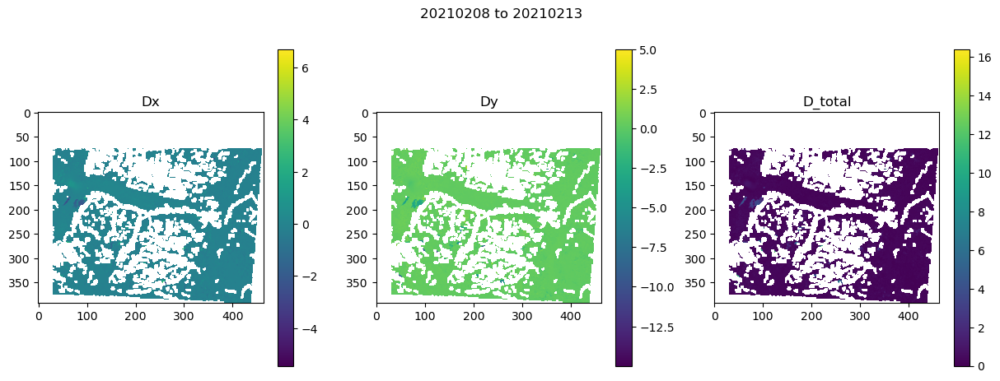

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2807648181915283
20210213 20210223
S2B_8VLM_20210213_B08_clipped.tif S2B_8VLM_20210223_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210213 20210223

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

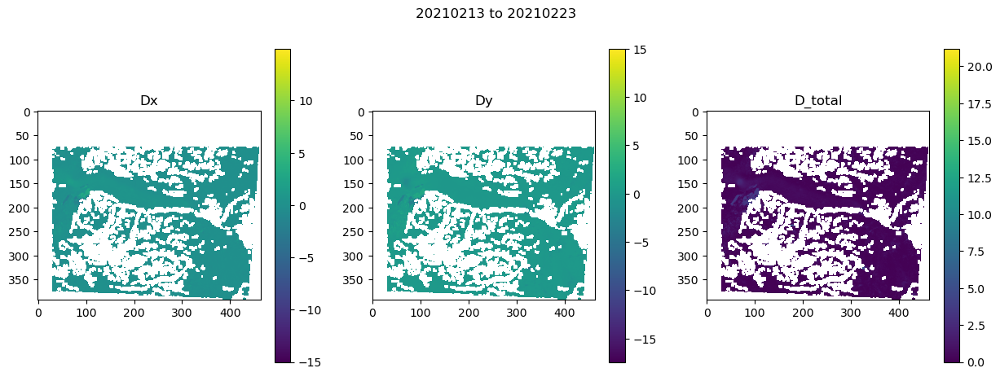

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2863638401031494
S2B_8VLM_20210223_B08_clipped.tif S2B_8VLM_20210308_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210223 20210308

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

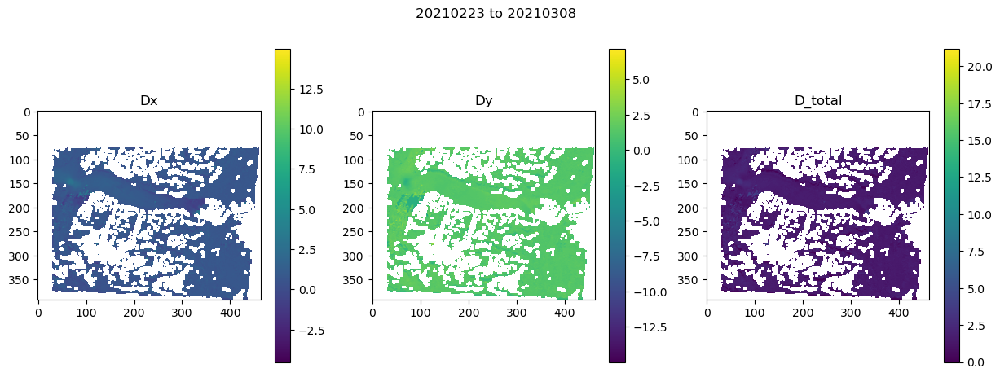

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.26307177543640137
S2B_8VLM_20210308_B08_clipped.tif S2B_8VLM_20210315_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210308 20210315

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

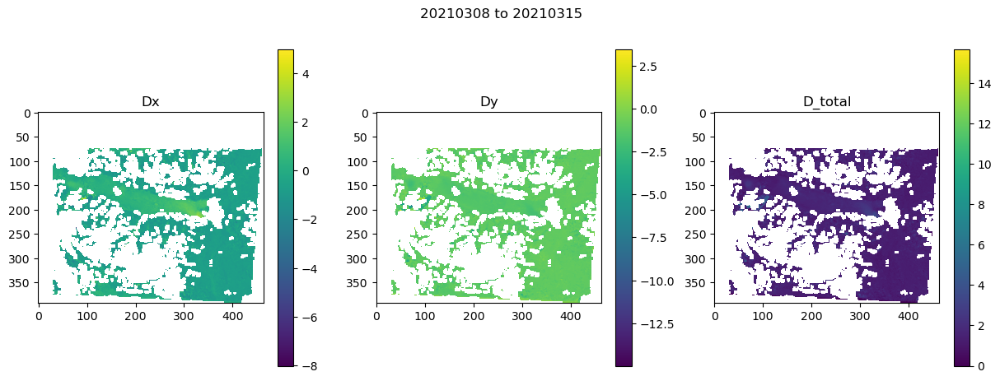

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3106527328491211
S2B_8VLM_20210315_B08_clipped.tif S2A_8VLM_20210320_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210315 20210320

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

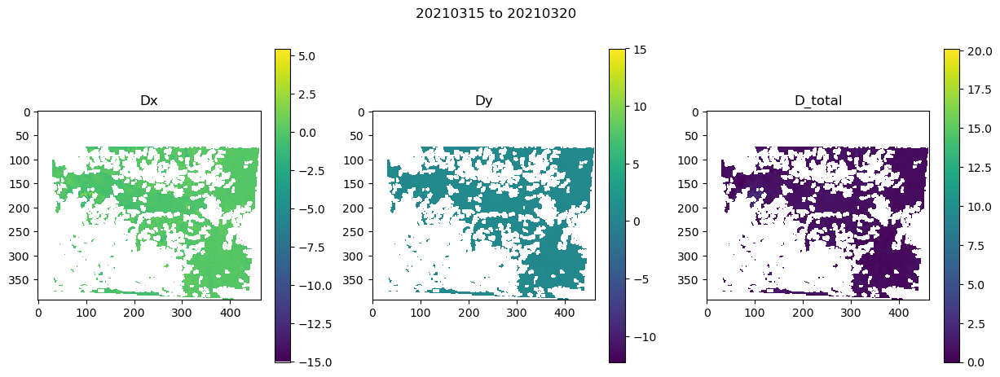

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.33340001106262207
S2A_8VLM_20210320_B08_clipped.tif S2B_8VLM_20210325_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210320 20210325

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

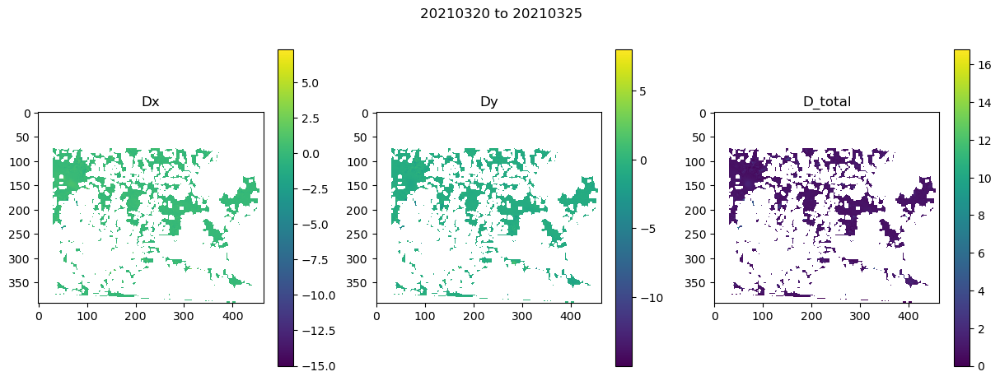

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3325178623199463
20210325 20210402
S2B_8VLM_20210325_B08_clipped.tif S2A_8VLM_20210402_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210325 20210402

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

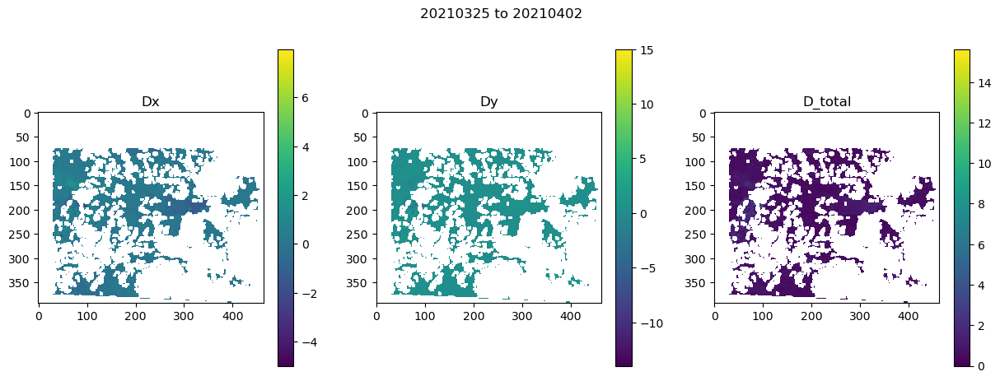

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.27071070671081543
S2A_8VLM_20210402_B08_clipped.tif S2B_8VLM_20210407_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210402 20210407

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

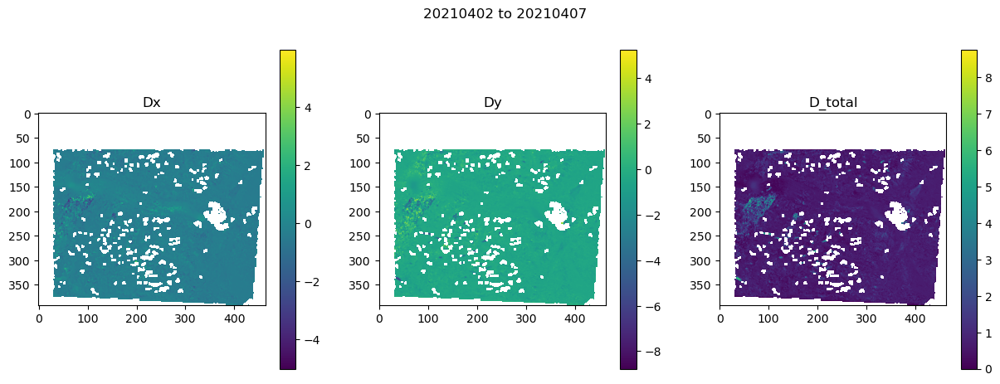

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3089599609375
S2B_8VLM_20210407_B08_clipped.tif S2B_8VLM_20210417_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210407 20210417

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

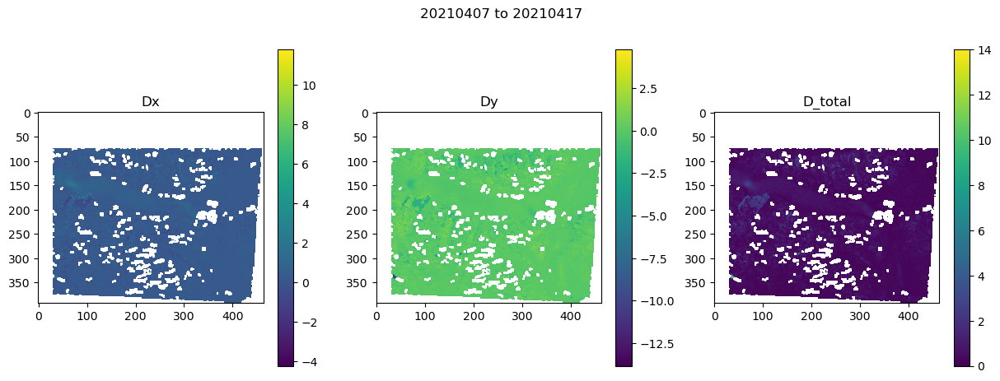

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30729198455810547
20210417 20210422
S2B_8VLM_20210417_B08_clipped.tif S2A_8VLM_20210422_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210417 20210422

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

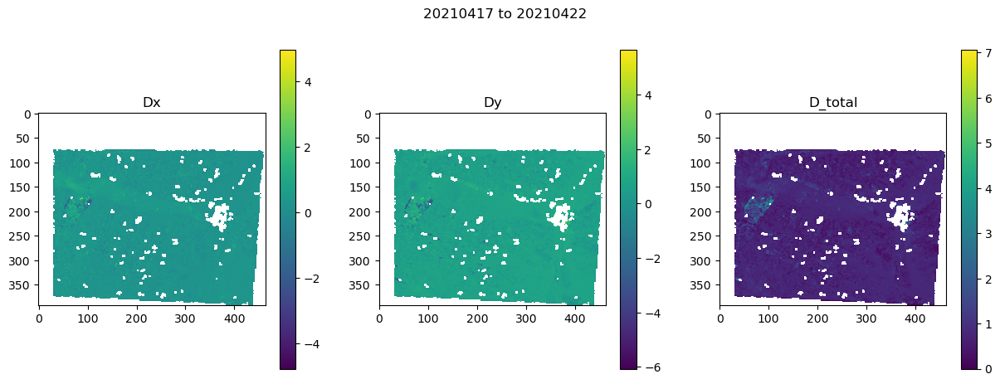

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.34279680252075195
20210422 20210427
S2A_8VLM_20210422_B08_clipped.tif S2B_8VLM_20210427_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210422 20210427

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

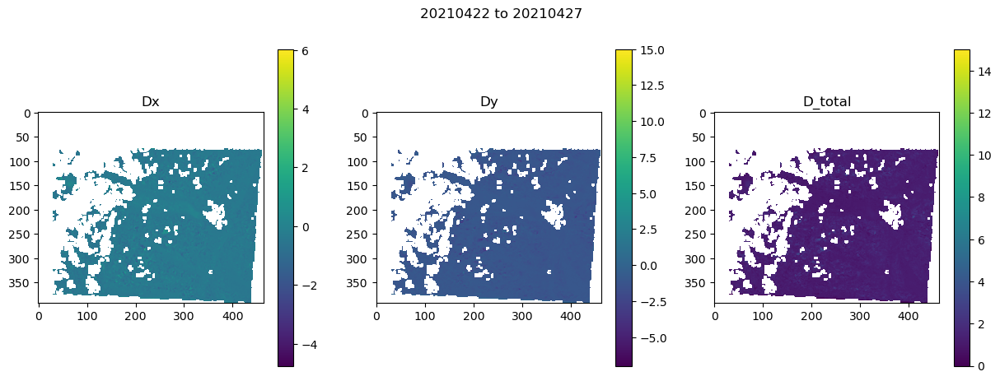

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30403709411621094
S2B_8VLM_20210427_B08_clipped.tif S2A_8VLM_20210502_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210427 20210502

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

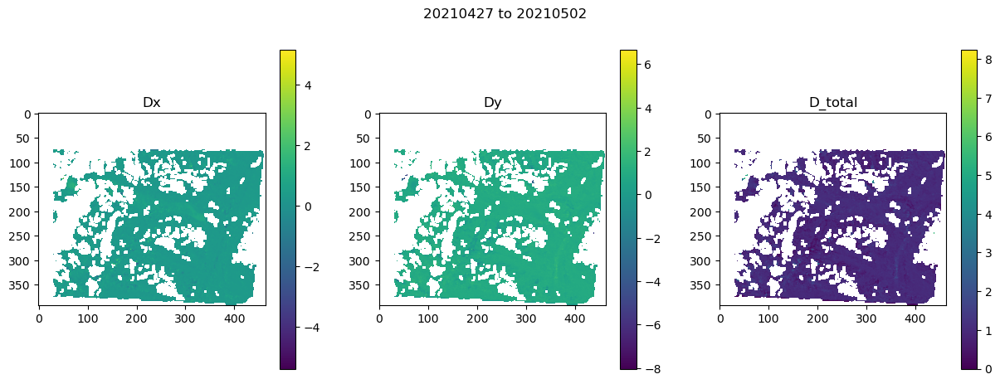

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7496519088745117
S2A_8VLM_20210502_B08_clipped.tif S2B_8VLM_20210507_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210502 20210507

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

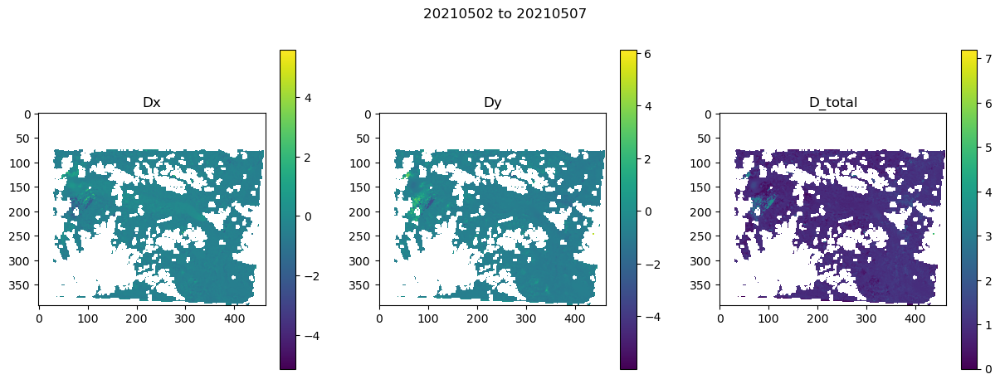

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32361316680908203
S2B_8VLM_20210507_B08_clipped.tif S2A_8VLM_20210512_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210507 20210512

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

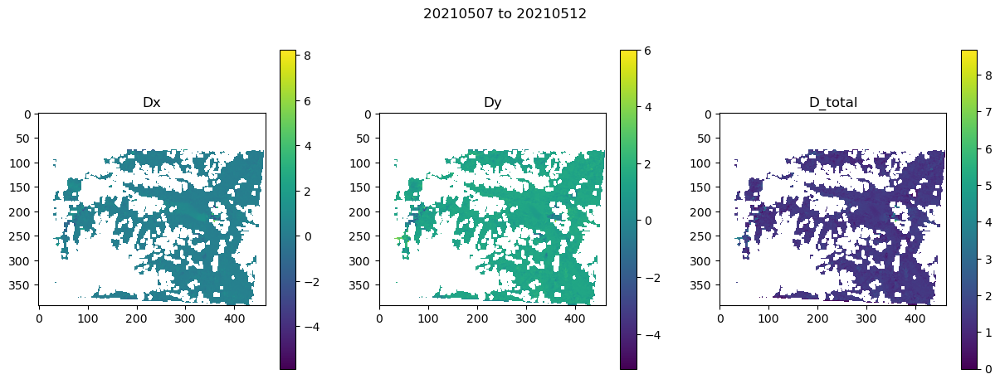

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29326796531677246
S2A_8VLM_20210512_B08_clipped.tif S2B_8VLM_20210517_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210512 20210517

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

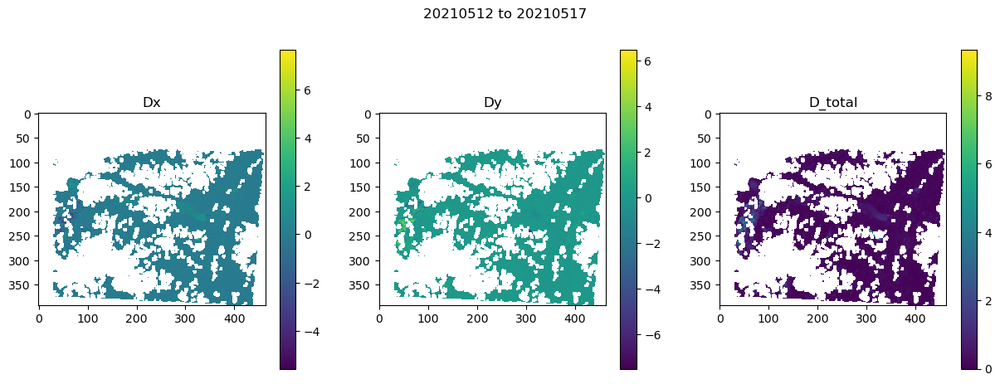

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.09456205368042
20210517 20210601
S2B_8VLM_20210517_B08_clipped.tif S2A_8VLM_20210601_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210517 20210601

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wi

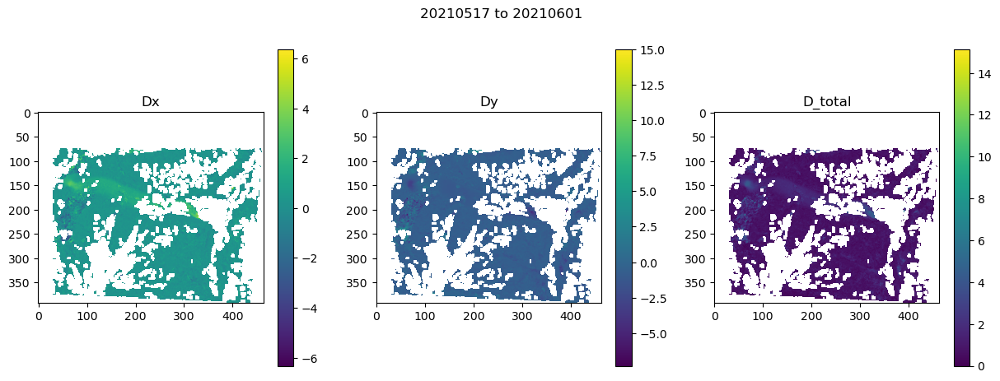

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
6.369632005691528
S2A_8VLM_20210601_B08_clipped.tif S2A_8VLM_20210608_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210601 20210608

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif


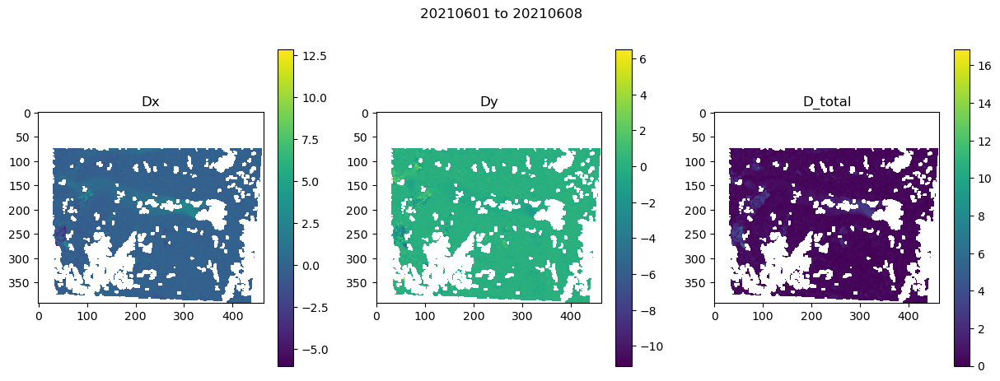

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.35422325134277344
20210608 20210613
S2A_8VLM_20210608_B08_clipped.tif S2B_8VLM_20210613_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210608 20210613

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

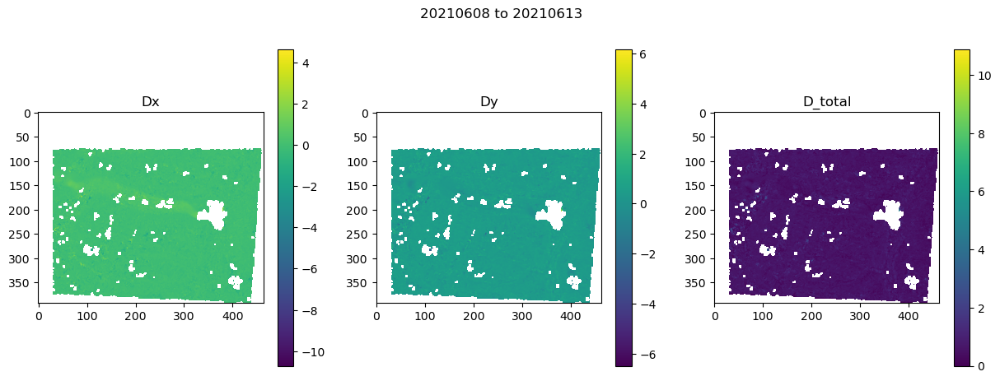

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2601323127746582
20210613 20210623
S2B_8VLM_20210613_B08_clipped.tif S2B_8VLM_20210623_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210613 20210623

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

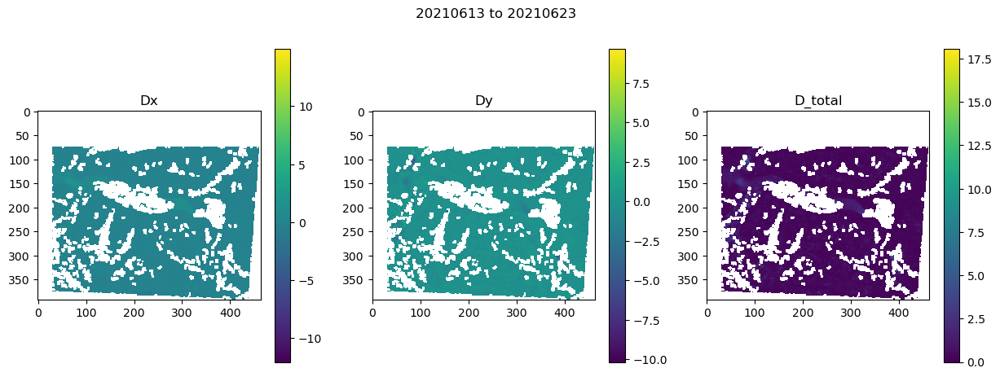

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.323822021484375
S2B_8VLM_20210623_B08_clipped.tif S2A_8VLM_20210628_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210623 20210628

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif


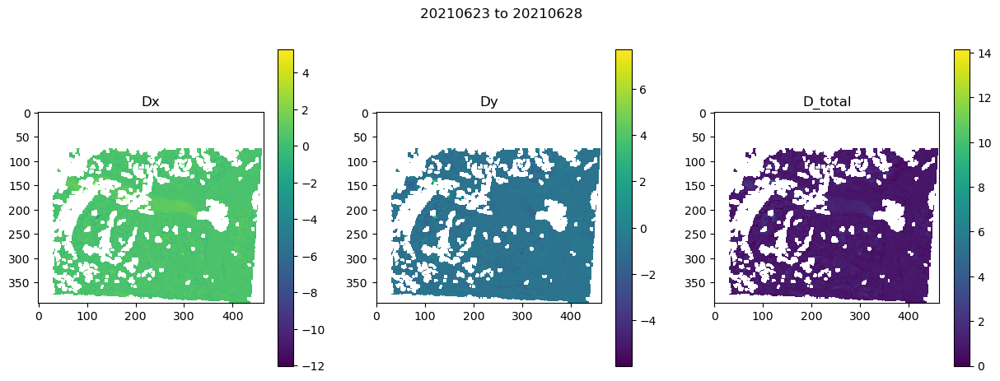

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3005349636077881
20210628 20210703
S2A_8VLM_20210628_B08_clipped.tif S2B_8VLM_20210703_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210628 20210703

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

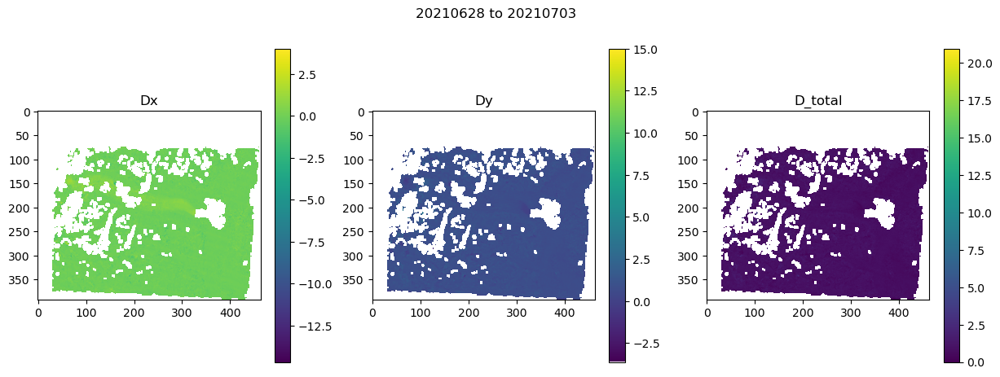

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.26369690895080566
S2B_8VLM_20210703_B08_clipped.tif S2A_8VLM_20210708_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210703 20210708

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

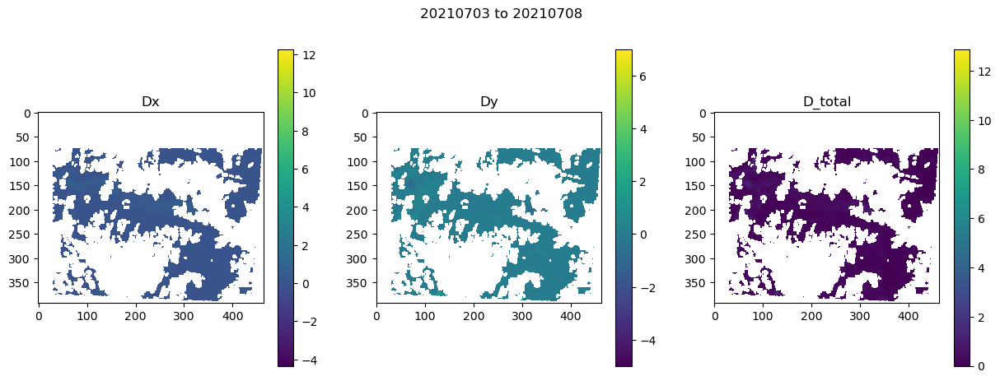

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3199779987335205
S2A_8VLM_20210708_B08_clipped.tif S2A_8VLM_20210718_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210708 20210718

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

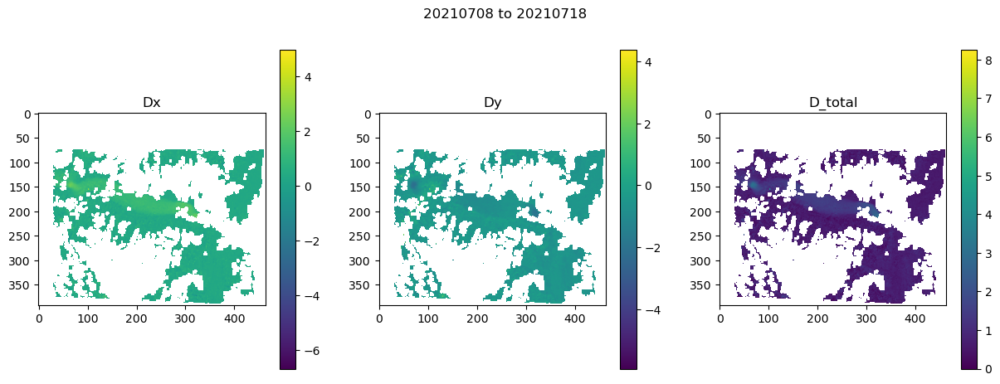

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.31698107719421387
20210718 20210728
S2A_8VLM_20210718_B08_clipped.tif S2A_8VLM_20210728_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210718 20210728

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

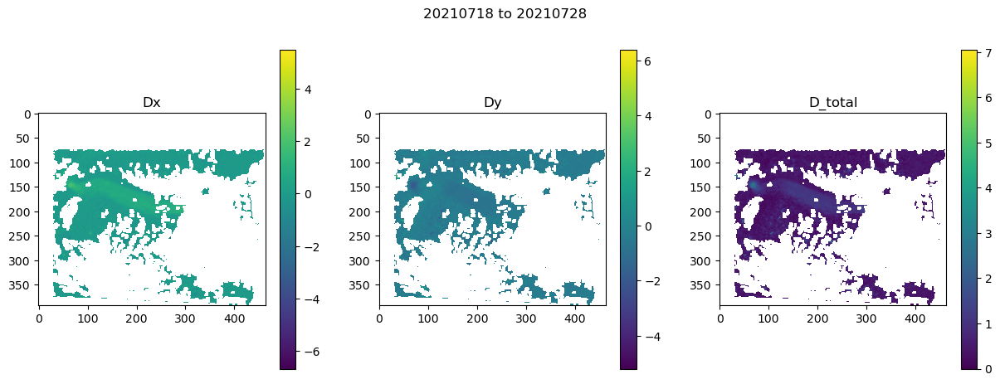

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.302401065826416
20210728 20210807
S2A_8VLM_20210728_B08_clipped.tif S2A_8VLM_20210807_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210728 20210807

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wi

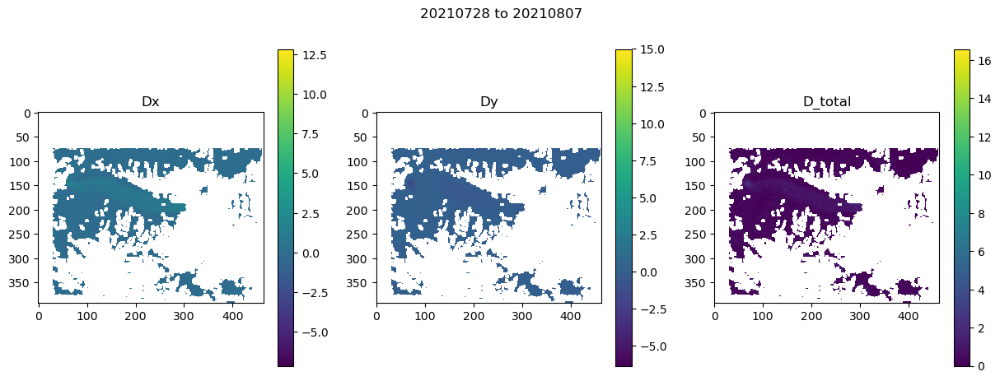

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2874939441680908
S2A_8VLM_20210807_B08_clipped.tif S2B_8VLM_20210815_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210807 20210815

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

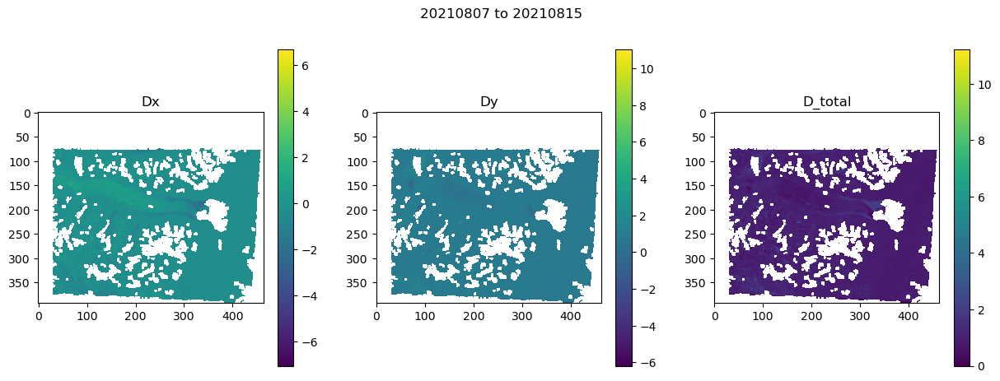

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.33010387420654297
20210815 20210820
S2B_8VLM_20210815_B08_clipped.tif S2A_8VLM_20210820_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210815 20210820

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

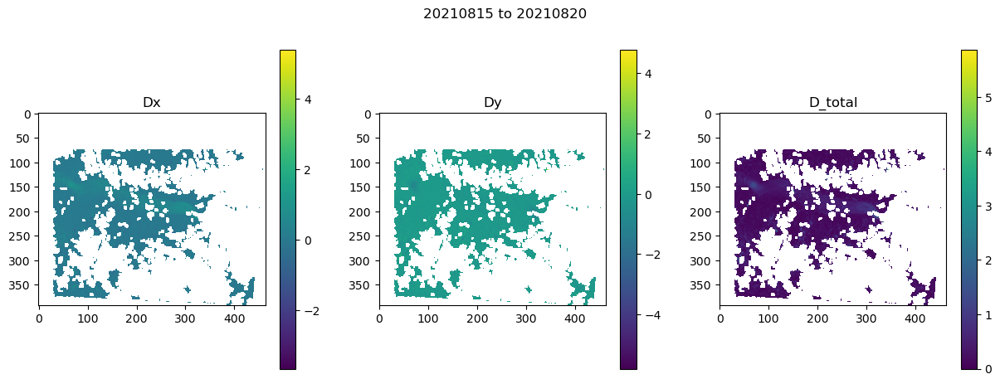

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9933450222015381
20210820 20210830
S2A_8VLM_20210820_B08_clipped.tif S2A_8VLM_20210830_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210820 20210830

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

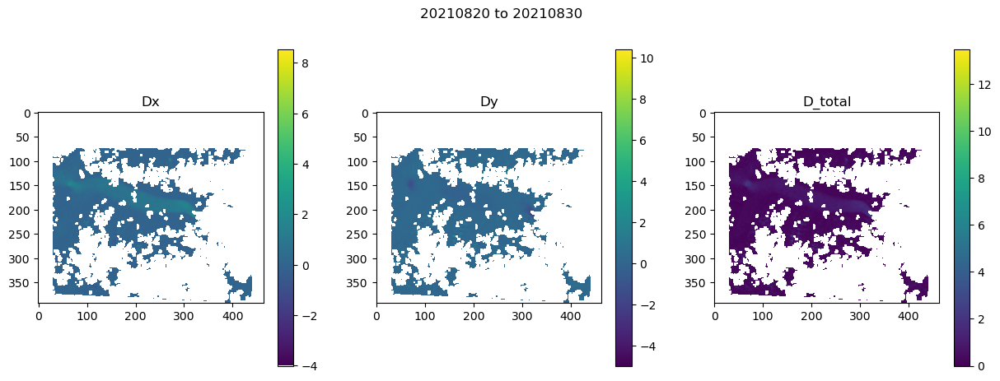

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2882990837097168
S2A_8VLM_20210830_B08_clipped.tif S2A_8VLM_20210919_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210830 20210919

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

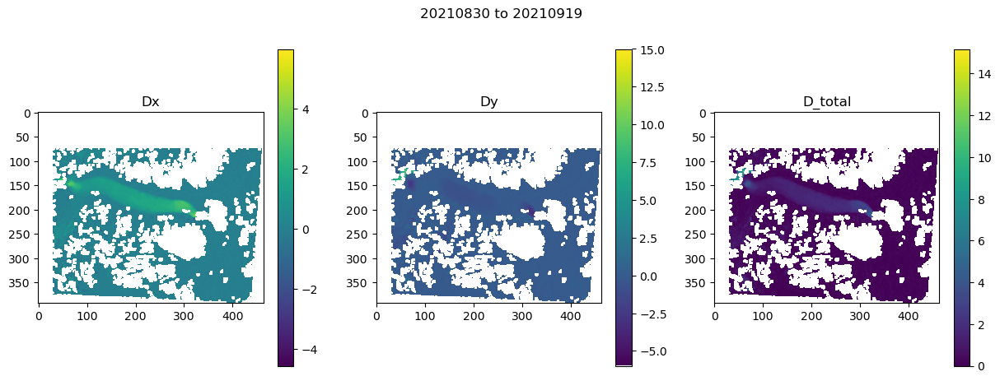

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30039501190185547
S2A_8VLM_20210919_B08_clipped.tif S2B_8VLM_20210924_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210919 20210924

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

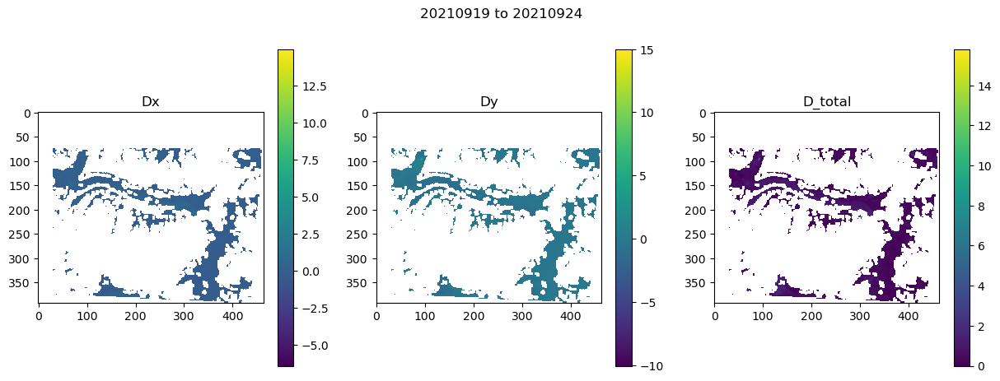

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.094923973083496
S2B_8VLM_20210924_B08_clipped.tif S2A_8VLM_20210929_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210924 20210929

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif


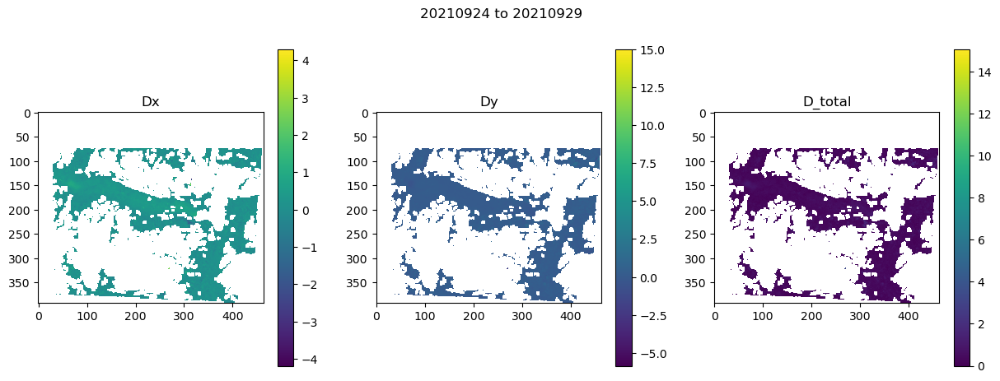

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3189702033996582
S2A_8VLM_20210929_B08_clipped.tif S2A_8VLM_20211009_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210929 20211009

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

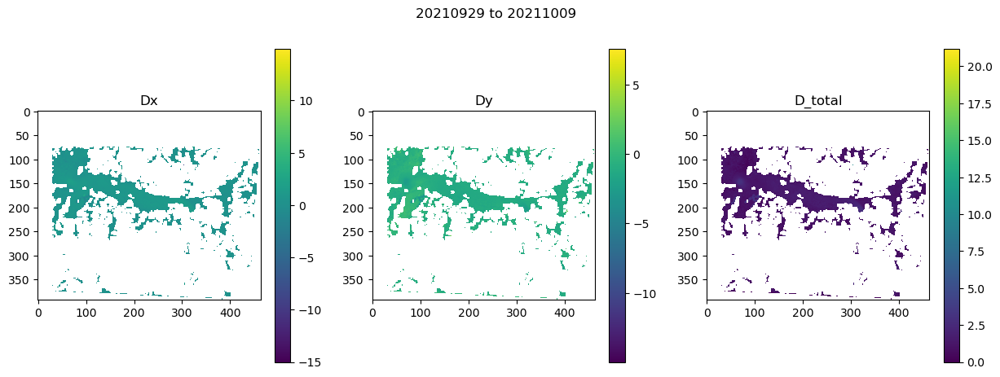

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29540300369262695
S2A_8VLM_20211009_B08_clipped.tif S2A_8VLM_20211016_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211009 20211016

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

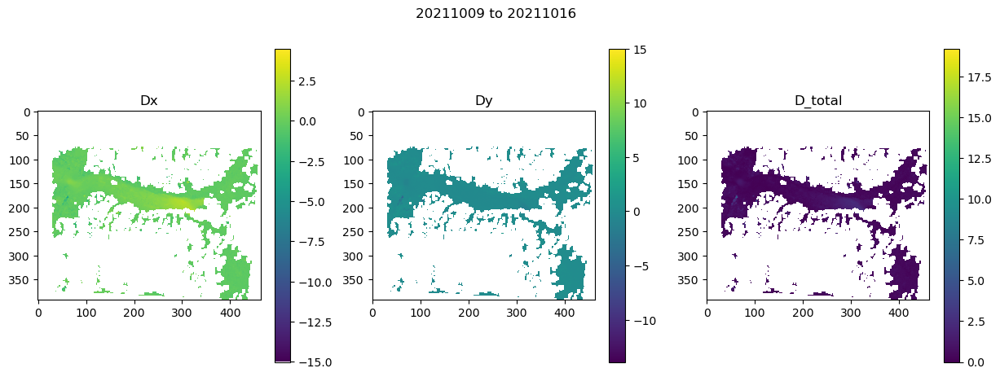

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3222689628601074
S2A_8VLM_20211016_B08_clipped.tif S2B_8VLM_20211021_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211016 20211021

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

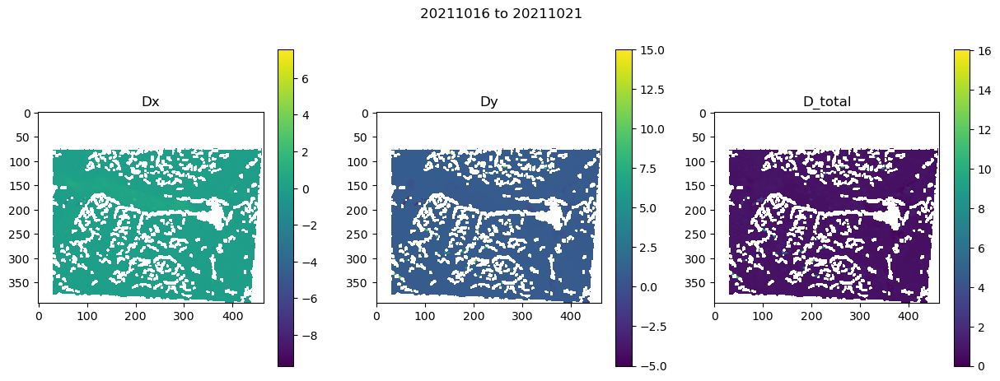

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
7.271513223648071
20211021 20211031
S2B_8VLM_20211021_B08_clipped.tif S2B_8VLM_20211031_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211021 20211031

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wi

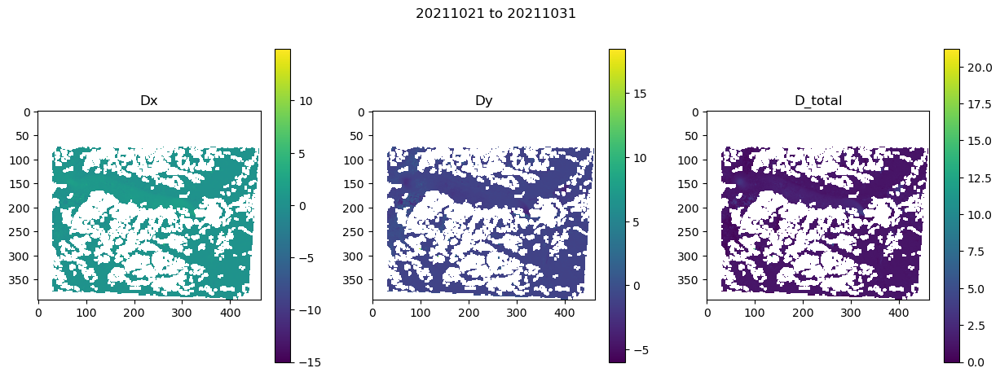

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3214759826660156
S2B_8VLM_20211031_B08_clipped.tif S2B_8VLM_20211113_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211031 20211113

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

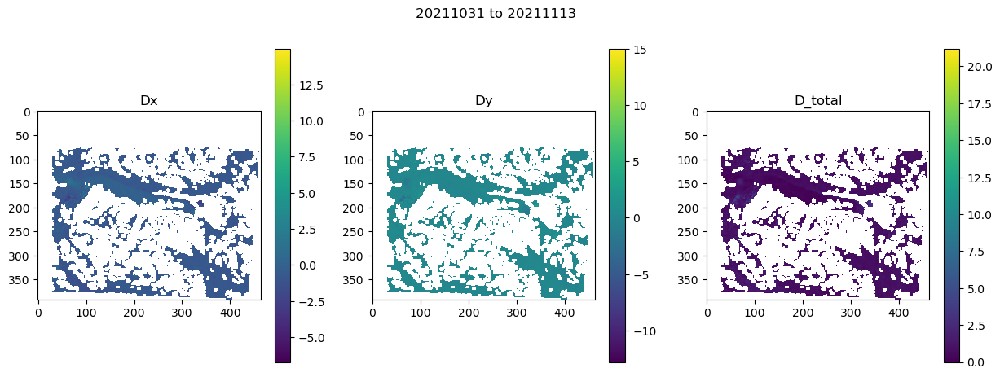

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.07036018371582031
20211113 20220117
20211113 20220221
20211113 20220223
20211113 20220303
20211113 20220308
20211113 20220320
20211113 20220402
20211113 20220404
20211113 20220412
20211113 20220417
20211113 20220419
20211113 20220422
20211113 20220504
20211113 20220512
20211113 20220519
20211113 20220522
20211113 20220524
20211113 20220529
20211113 20220601
20211113 20220603
20211113 20220608
20211113 20220611
20211113 20220616
20211113 20220618
20211113 20220621
20211113 20220623
20211113 20220626
20211113 20220628
20211113 20220701
20211113 20220703
20211113 20220706
20211113 20220708
20211113 20220718
20211113 20220721
20211113 20220726
20211113 20220807
20211113 20220812
20211113 20220820
20211113 20220904
20211113 20220911
20211113 20220916
20211113 20221004
20211113 20221006
20211113 20221029
20211113 20221108
20211113 20221118
No image pair with correct time separation fo

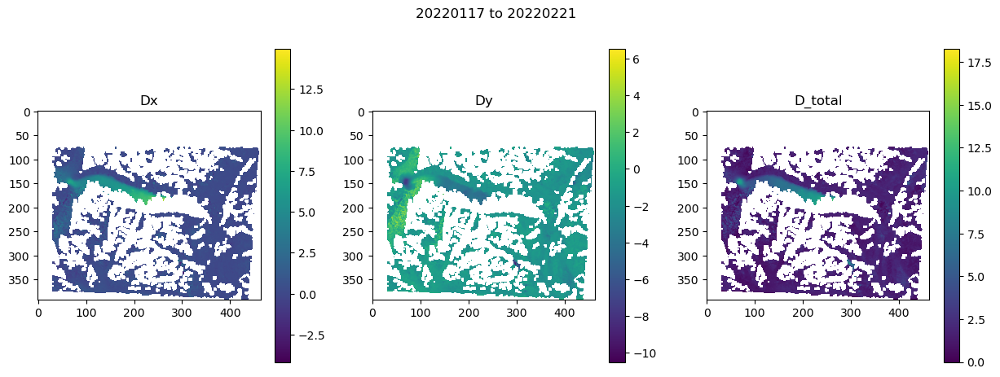

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32895588874816895
20220221 20220303
S2B_8VLM_20220221_B08_clipped.tif S2B_8VLM_20220303_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220221 20220303

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

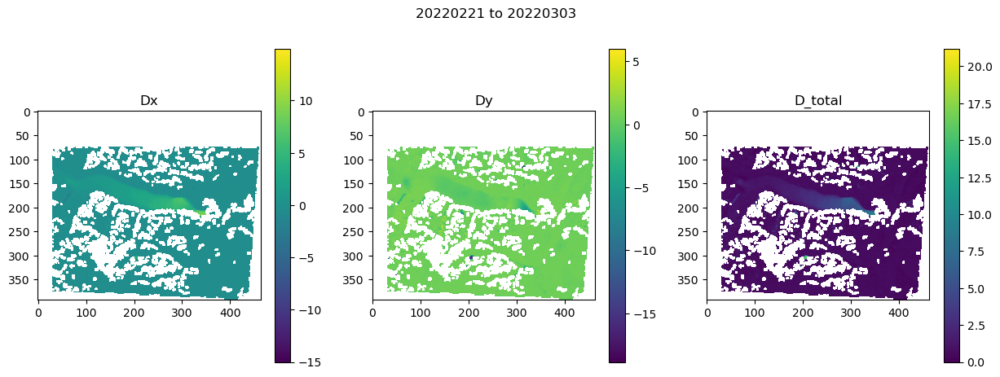

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2974231243133545
S2B_8VLM_20220303_B08_clipped.tif S2A_8VLM_20220308_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220303 20220308

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

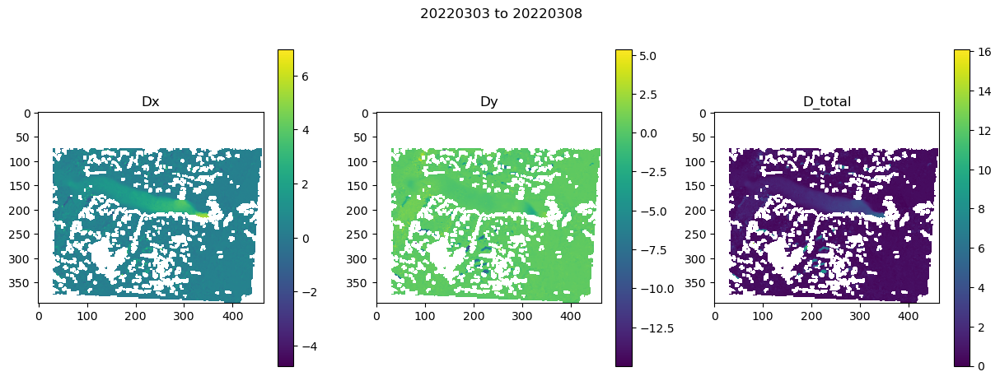

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.24809503555297852
S2A_8VLM_20220308_B08_clipped.tif S2B_8VLM_20220320_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220308 20220320

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.t

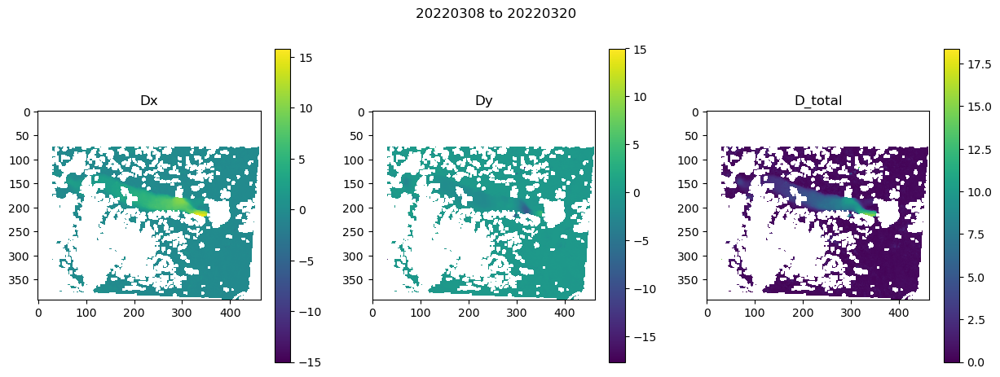

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2847118377685547
S2B_8VLM_20220320_B08_clipped.tif S2B_8VLM_20220402_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220320 20220402

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1123200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

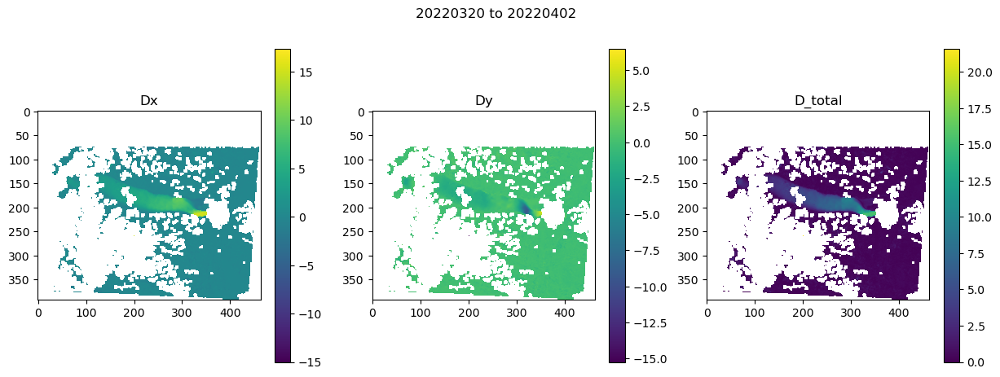

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3087139129638672
20220402 20220412
S2B_8VLM_20220402_B08_clipped.tif S2B_8VLM_20220412_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220402 20220412

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

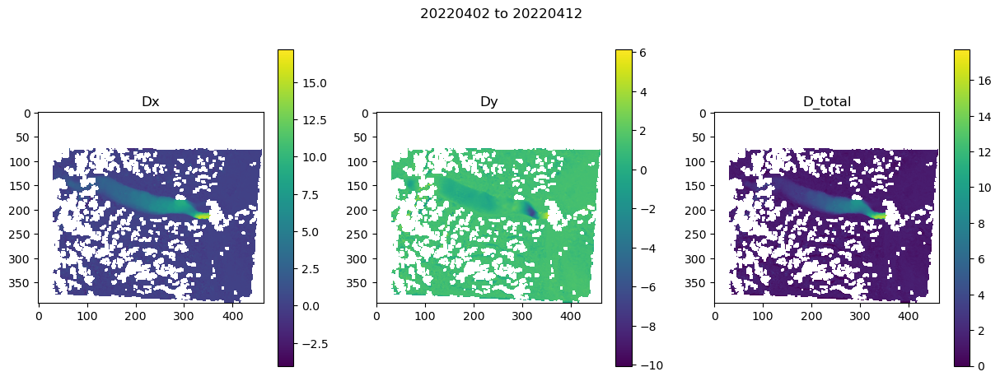

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.28603100776672363
S2B_8VLM_20220412_B08_clipped.tif S2A_8VLM_20220417_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220412 20220417

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

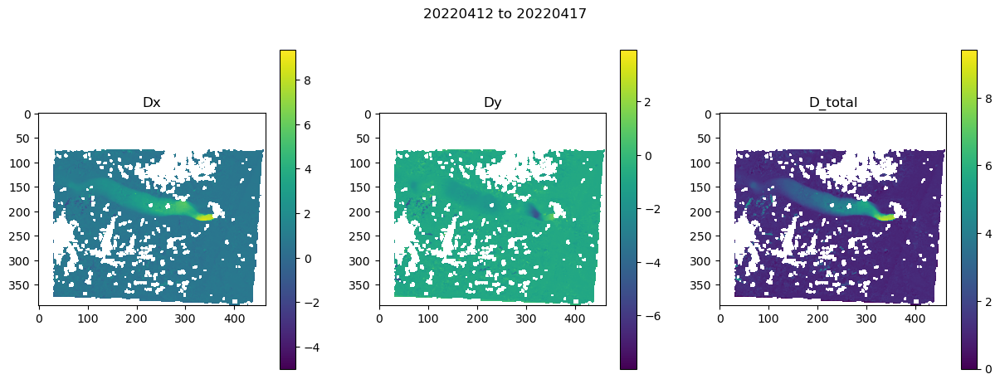

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32804298400878906
20220417 20220422
S2A_8VLM_20220417_B08_clipped.tif S2B_8VLM_20220422_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220417 20220422

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

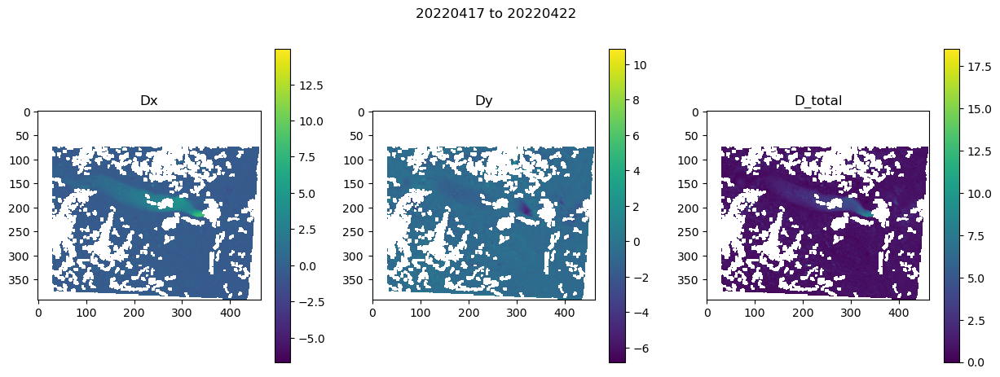

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2813432216644287
S2B_8VLM_20220422_B08_clipped.tif S2A_8VLM_20220504_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220422 20220504

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

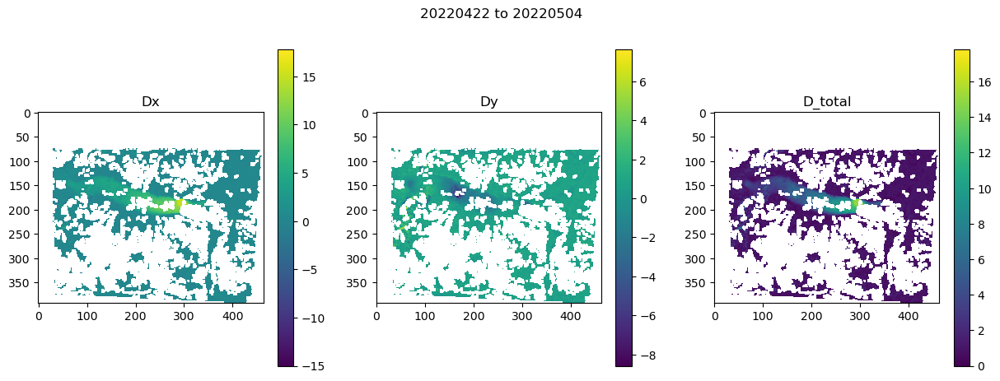

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.39421582221984863
S2A_8VLM_20220504_B08_clipped.tif S2B_8VLM_20220512_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220504 20220512

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

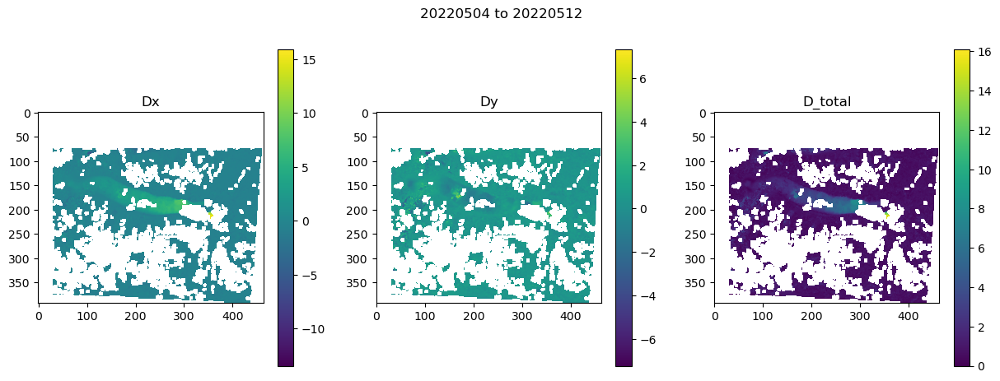

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29937076568603516
S2B_8VLM_20220512_B08_clipped.tif S2B_8VLM_20220519_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220512 20220519

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

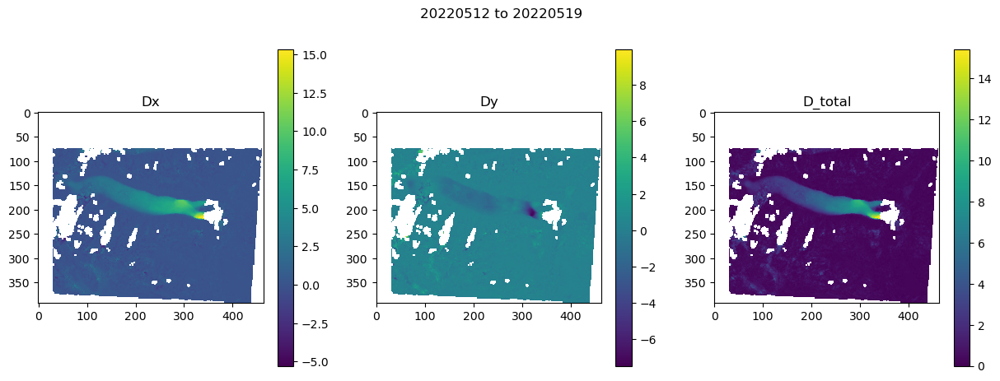

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32979702949523926
20220519 20220524
S2B_8VLM_20220519_B08_clipped.tif S2A_8VLM_20220524_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220519 20220524

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

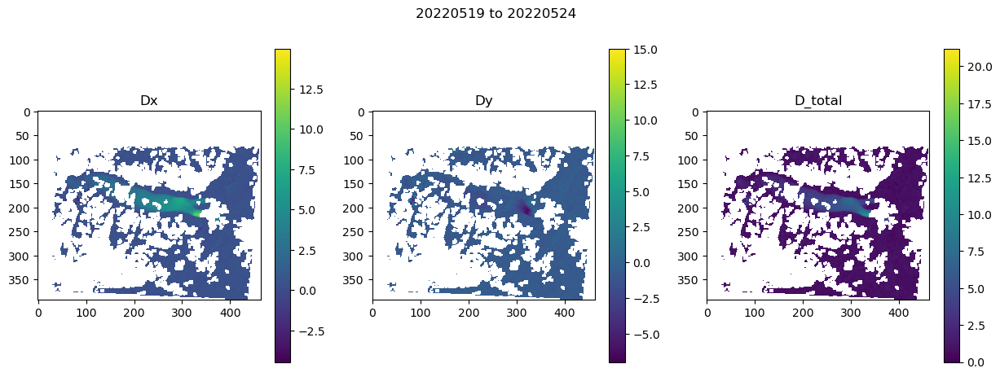

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2926959991455078
S2A_8VLM_20220524_B08_clipped.tif S2B_8VLM_20220529_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220524 20220529

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

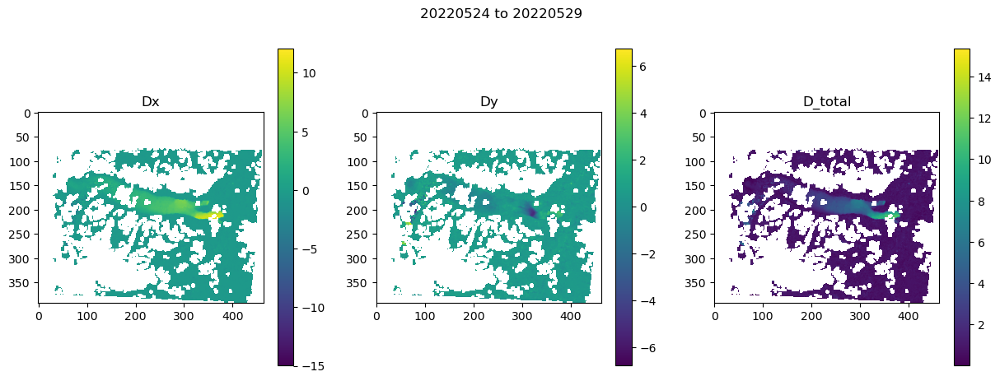

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2808070182800293
20220529 20220603
S2B_8VLM_20220529_B08_clipped.tif S2A_8VLM_20220603_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220529 20220603

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

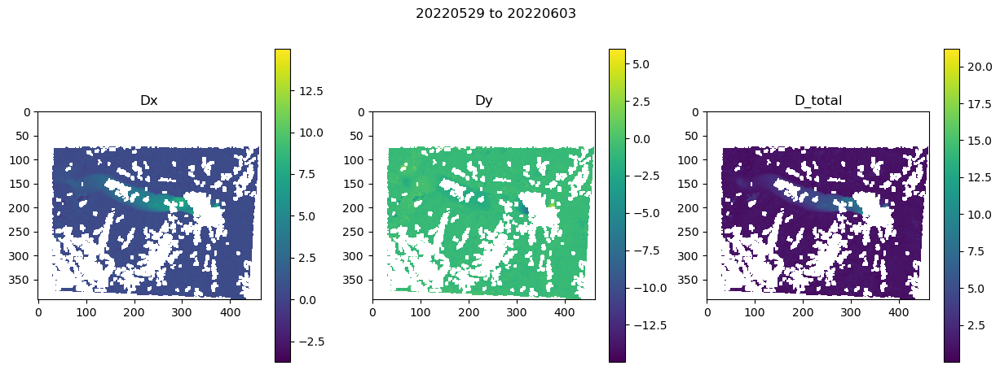

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30621790885925293
S2A_8VLM_20220603_B08_clipped.tif S2B_8VLM_20220608_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220603 20220608

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

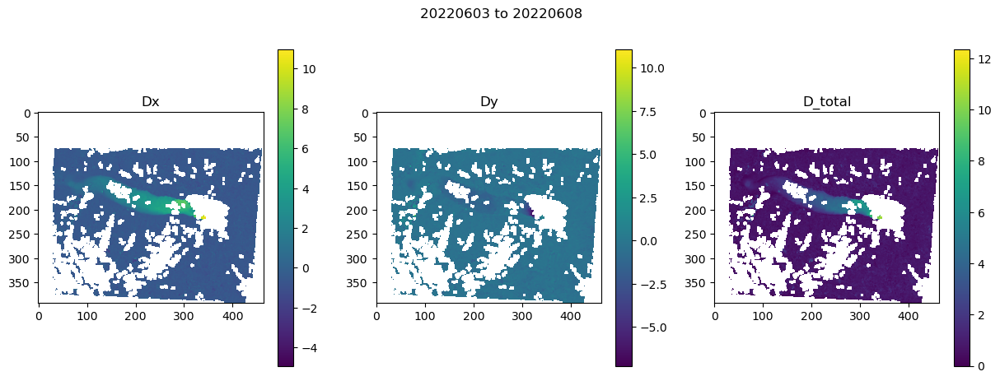

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2842748165130615
20220608 20220616
S2B_8VLM_20220608_B08_clipped.tif S2A_8VLM_20220616_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220608 20220616

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

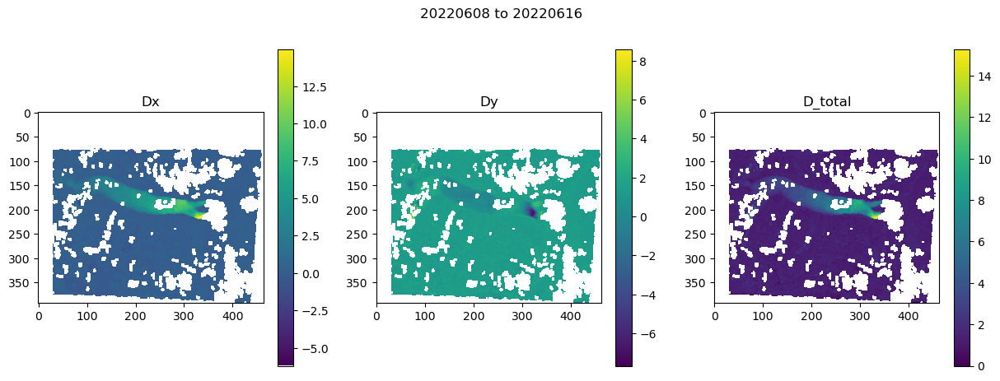

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
7.160244941711426
20220616 20220621
S2A_8VLM_20220616_B08_clipped.tif S2B_8VLM_20220621_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220616 20220621

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wi

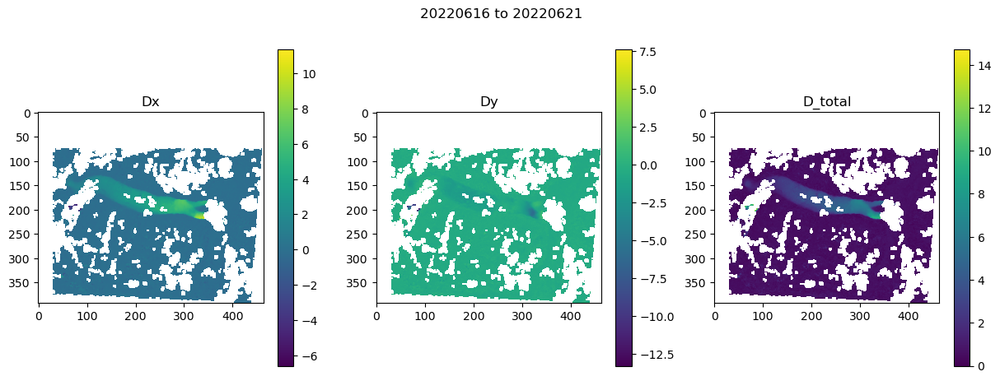

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2944498062133789
20220621 20220626
S2B_8VLM_20220621_B08_clipped.tif S2A_8VLM_20220626_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220621 20220626

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

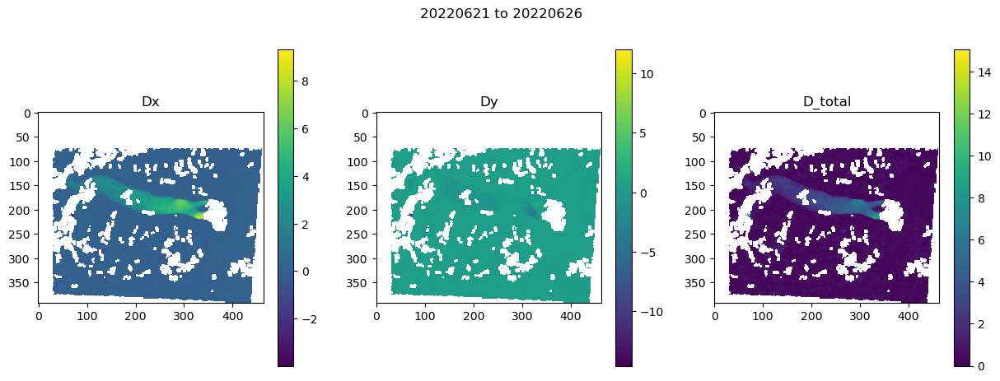

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29341697692871094
20220626 20220701
S2A_8VLM_20220626_B08_clipped.tif S2B_8VLM_20220701_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220626 20220701

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

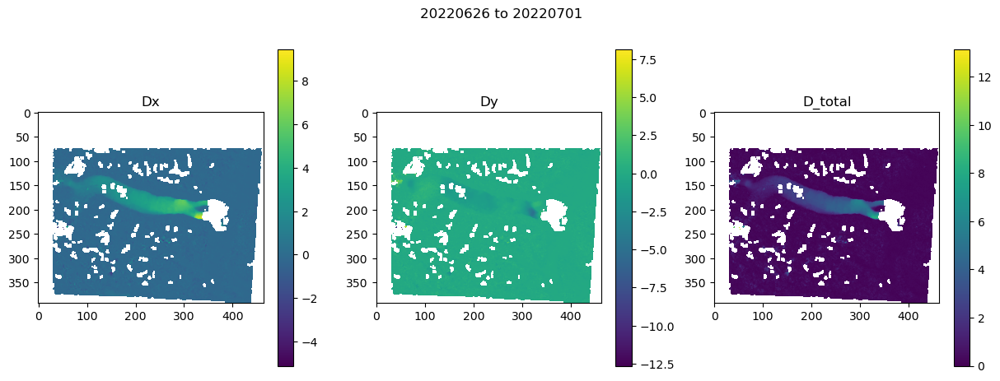

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30977725982666016
20220701 20220706
S2B_8VLM_20220701_B08_clipped.tif S2A_8VLM_20220706_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220701 20220706

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

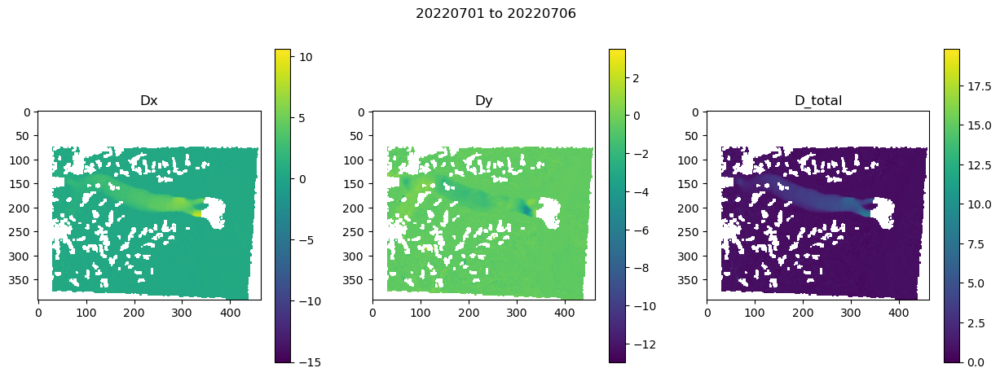

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2976078987121582
20220706 20220718
S2A_8VLM_20220706_B08_clipped.tif S2B_8VLM_20220718_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220706 20220718

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: 

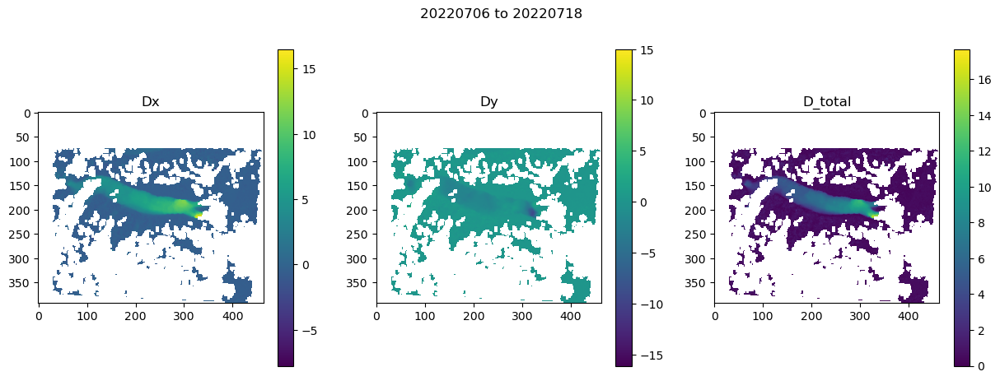

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3016810417175293
20220718 20220726
S2B_8VLM_20220718_B08_clipped.tif S2A_8VLM_20220726_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220718 20220726

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: w

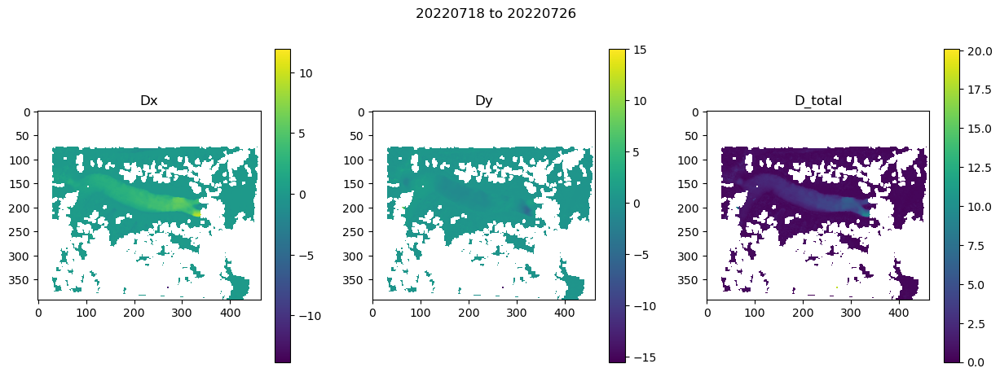

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3282899856567383
S2A_8VLM_20220726_B08_clipped.tif S2B_8VLM_20220807_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220726 20220807

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

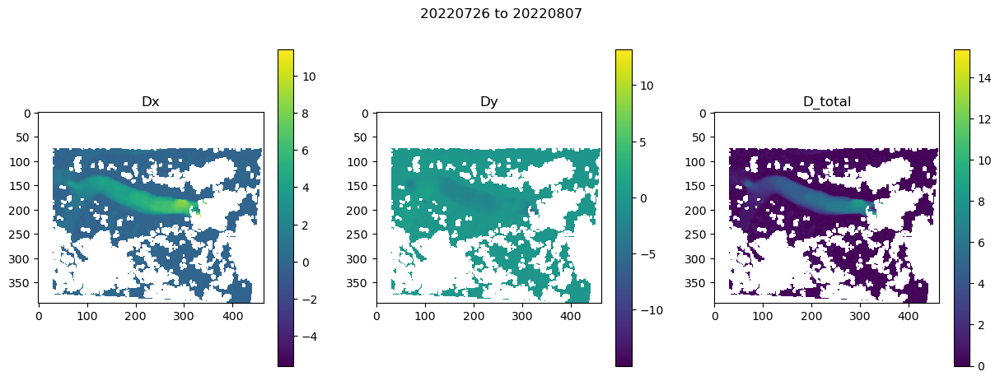

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.31398892402648926
S2B_8VLM_20220807_B08_clipped.tif S2A_8VLM_20220812_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220807 20220812

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

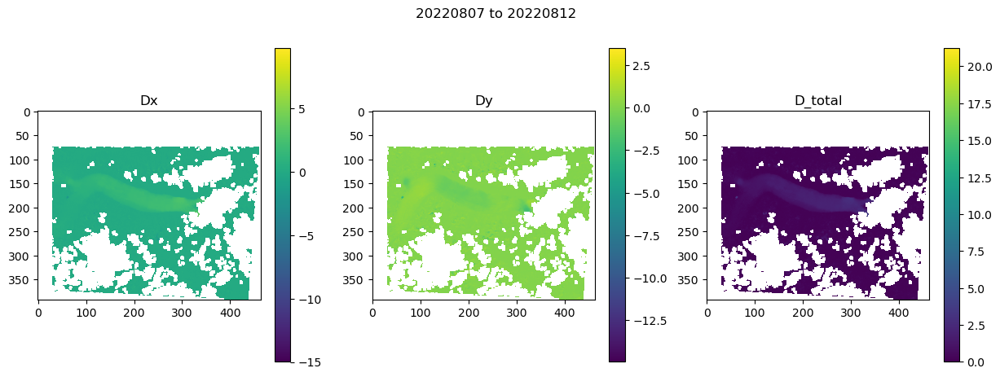

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2942161560058594
S2A_8VLM_20220812_B08_clipped.tif S2B_8VLM_20220820_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220812 20220820

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif

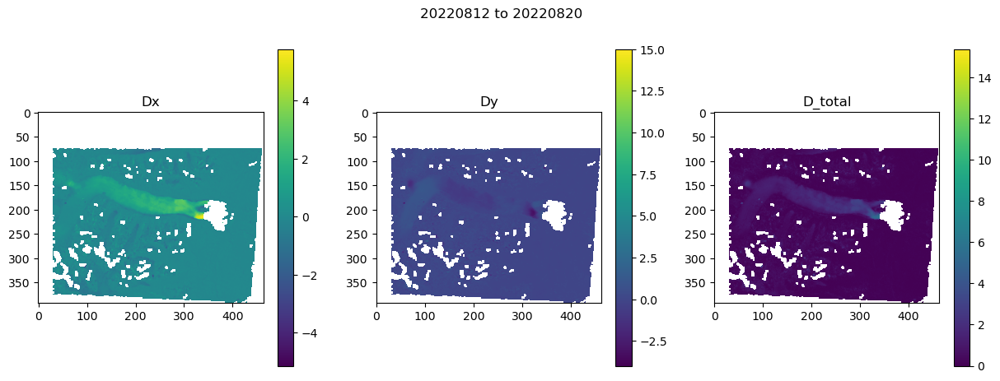

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3259468078613281
S2B_8VLM_20220820_B08_clipped.tif S2A_8VLM_20220904_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220820 20220904

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

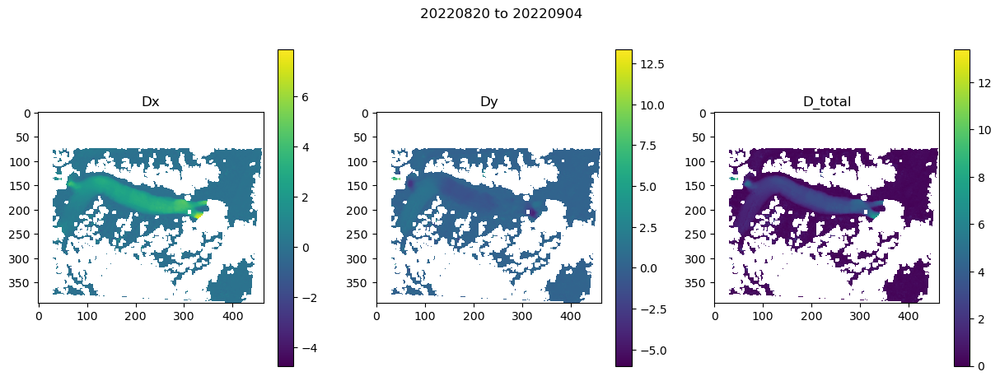

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29537105560302734
S2A_8VLM_20220904_B08_clipped.tif S2A_8VLM_20220911_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220904 20220911

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

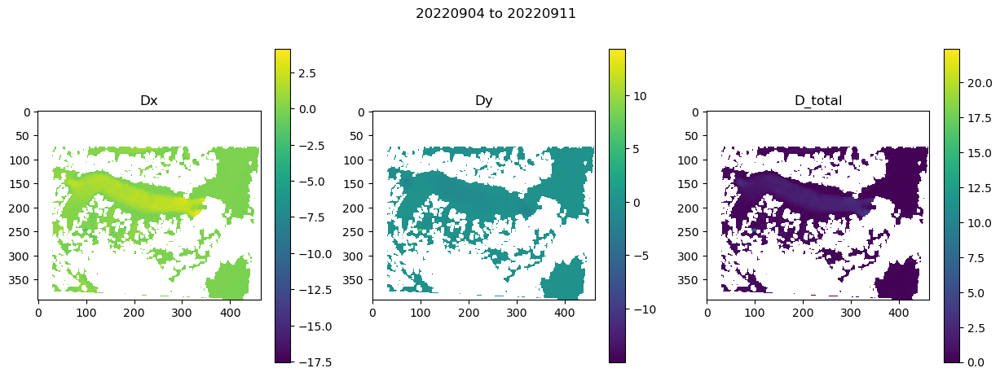

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.275209903717041
S2A_8VLM_20220911_B08_clipped.tif S2B_8VLM_20220916_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220911 20220916

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif


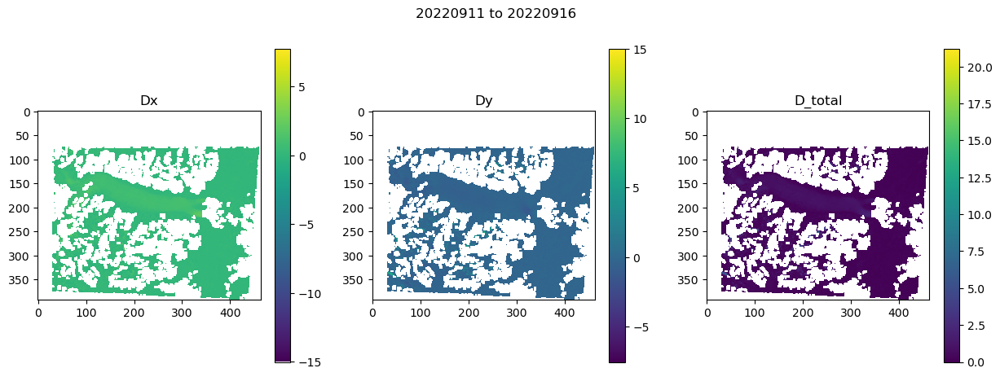

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30037927627563477
S2B_8VLM_20220916_B08_clipped.tif S2A_8VLM_20221004_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220916 20221004

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1555200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.t

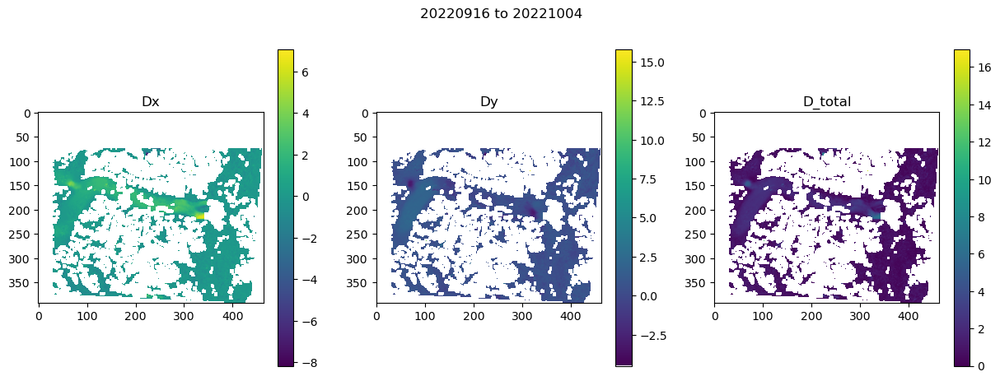

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30240321159362793
20221004 20221029
S2A_8VLM_20221004_B08_clipped.tif S2B_8VLM_20221029_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221004 20221029

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations:

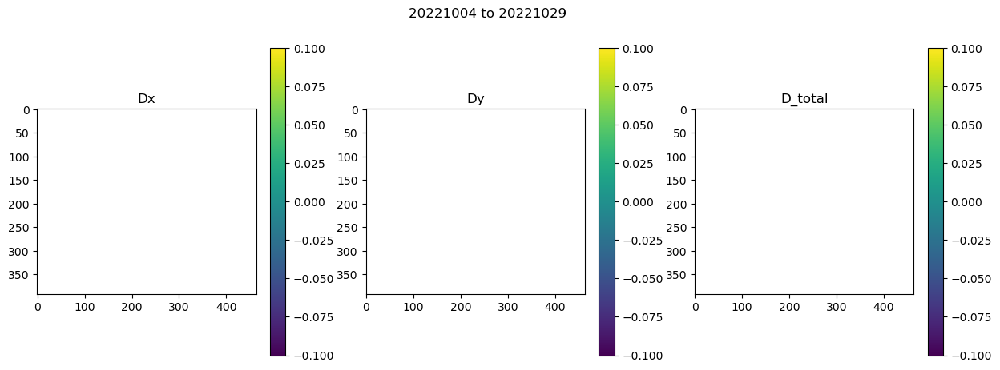

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06702494621276855
S2B_8VLM_20221029_B08_clipped.tif S2B_8VLM_20221108_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221029 20221108

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

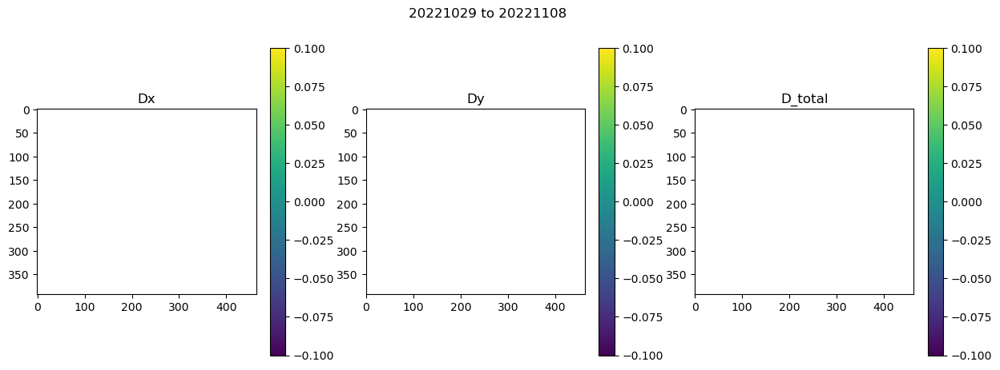

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.45113182067871094
S2B_8VLM_20221108_B08_clipped.tif S2B_8VLM_20221118_B08_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221108 20221118

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  10.0
Y-direction coordinate: 6707500.0  -10.0
Dimensions: 4646  3921

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707500.0
Extent in km: 46.46  39.21
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.ti

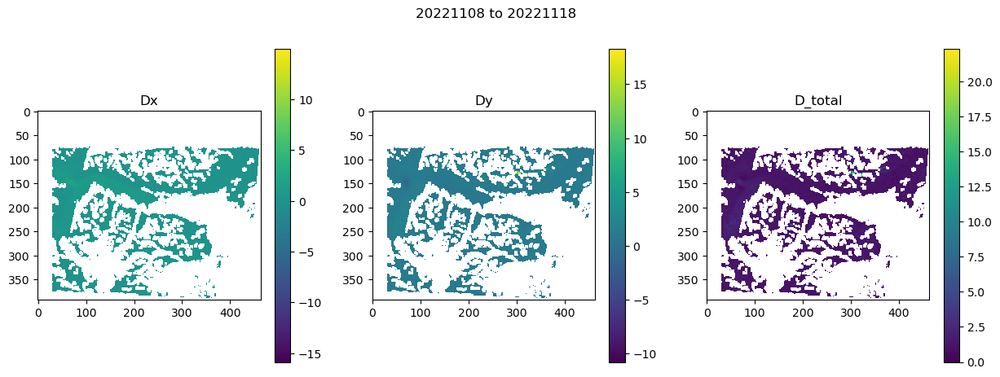

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.34369707107543945
Finished searching.
Number of files found: 27
LO_ArcticDEM_clipped_100m.tif  already exists.
LO_ArcticDEM_clipped_dhdy_100m.tif and LO_ArcticDEM_clipped_dhdx_100m.tif already exist.
LC08_L1TP_061018_20210328_20210402_02_T1_B8.TIF LC08_L1TP_060018_20210422_20210430_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210328 20210422

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707497.5  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 2160000.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668298.035

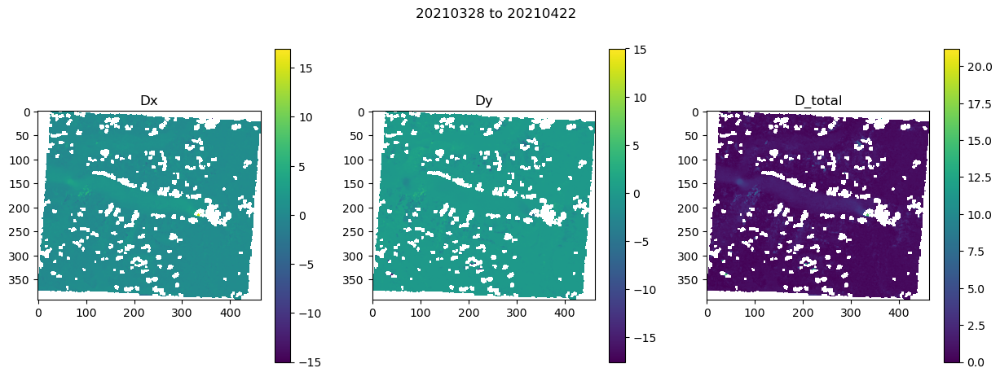

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.27870702743530273
LC08_L1TP_060018_20210422_20210430_02_T1_B8.TIF LC08_L1TP_060018_20210609_20210615_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210422 20210609

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296887.5  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 4147200.0
XLimits: 296887.5  343342.5
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Windo

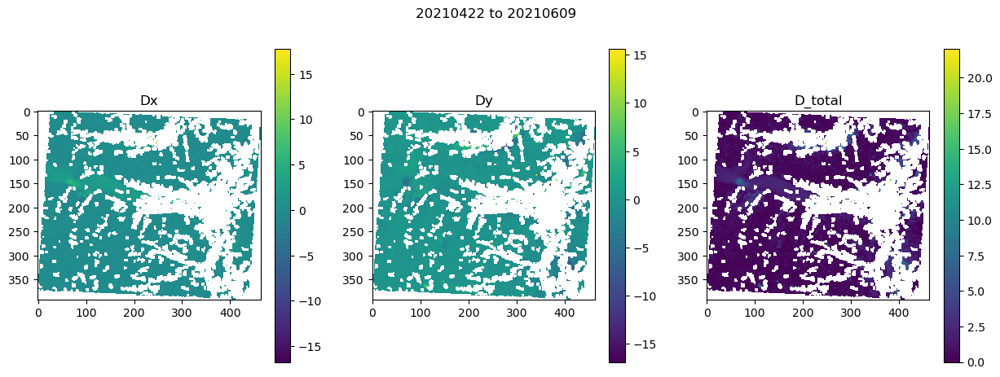

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.296864748001099
LC08_L1TP_060018_20210609_20210615_02_T1_B8.TIF LC08_L1TP_061018_20210616_20210622_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210609 20210616

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296889.10108337295  343344.10108337295
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhd

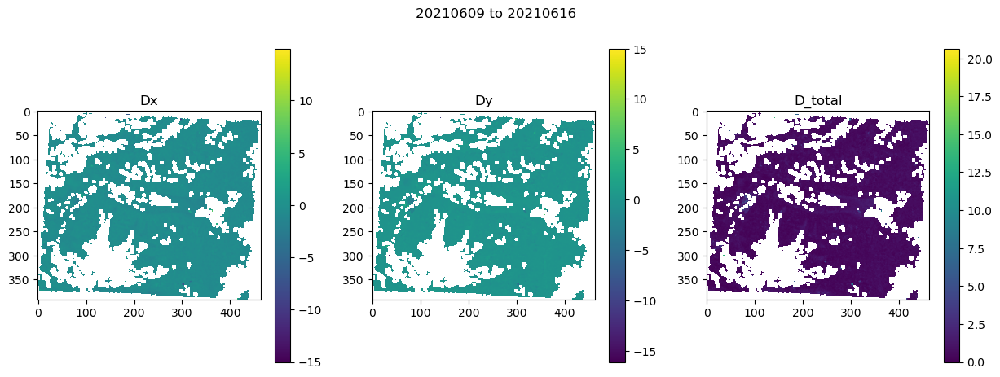

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3139338493347168
LC08_L1TP_061018_20210616_20210622_02_T1_B8.TIF LC08_L1TP_061018_20210702_20210712_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210616 20210702

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDE

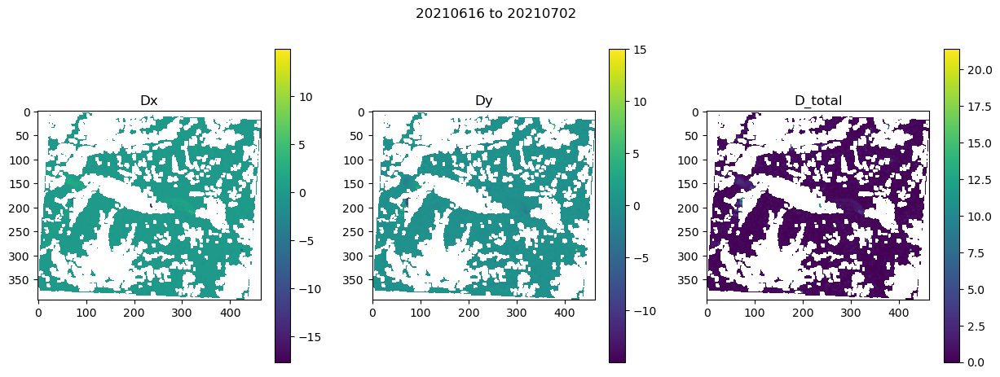

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.31850290298461914
LC08_L1TP_061018_20210702_20210712_02_T1_B8.TIF LC08_L1TP_061018_20210718_20210729_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210702 20210718

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticD

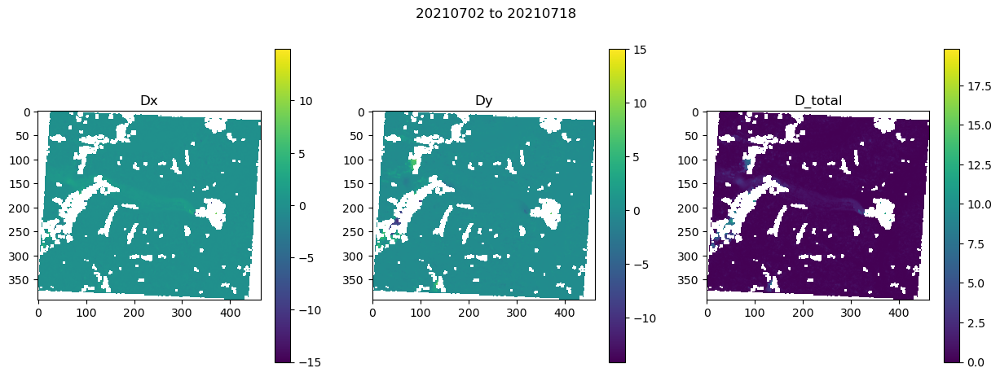

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30959200859069824
20210718 20211107
20210718 20220219
20210718 20220307
20210718 20220417
20210718 20220518
20210718 20220519
20210718 20220526
20210718 20220603
20210718 20220604
20210718 20220611
20210718 20220627
20210718 20220628
20210718 20220706
20210718 20220807
20210718 20220915
20210718 20220916
20210718 20221025
20210718 20221111
20210718 20221118
20210718 20221127
No image pair with correct time separation found. Skip to next.
LC08_L1TP_060018_20210929_20211013_02_T1_B8.TIF LC08_L1TP_061018_20211107_20211116_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210929 20211107

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.0
Y-di

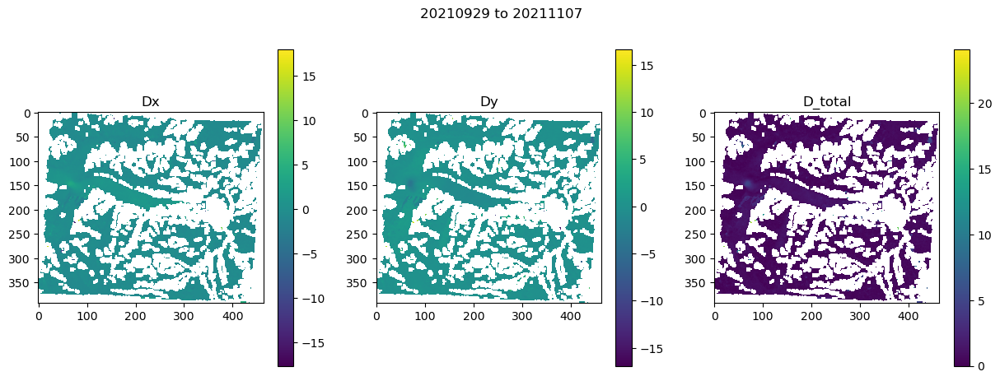

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.475856065750122
20211107 20220307
20211107 20220417
20211107 20220518
20211107 20220519
20211107 20220526
20211107 20220603
20211107 20220604
20211107 20220611
20211107 20220627
20211107 20220628
20211107 20220706
20211107 20220807
20211107 20220915
20211107 20220916
20211107 20221025
20211107 20221111
20211107 20221118
20211107 20221127
No image pair with correct time separation found. Skip to next.
LC09_L1TP_061018_20220219_20230427_02_T1_B8.TIF LC09_L1TP_061018_20220307_20230425_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220219 20220307

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707

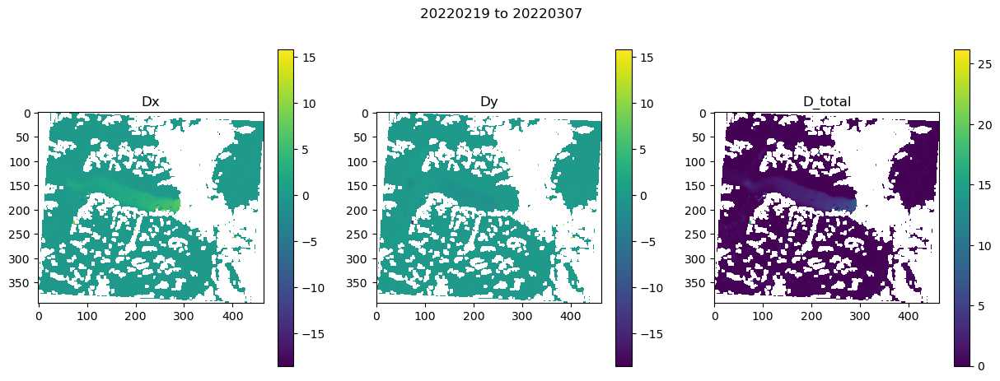

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.393976211547852
LC09_L1TP_061018_20220307_20230425_02_T1_B8.TIF LC09_L1TP_060018_20220417_20230421_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220307 20220417

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707497.5  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 3542400.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668298.035256202  6707497.5
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_

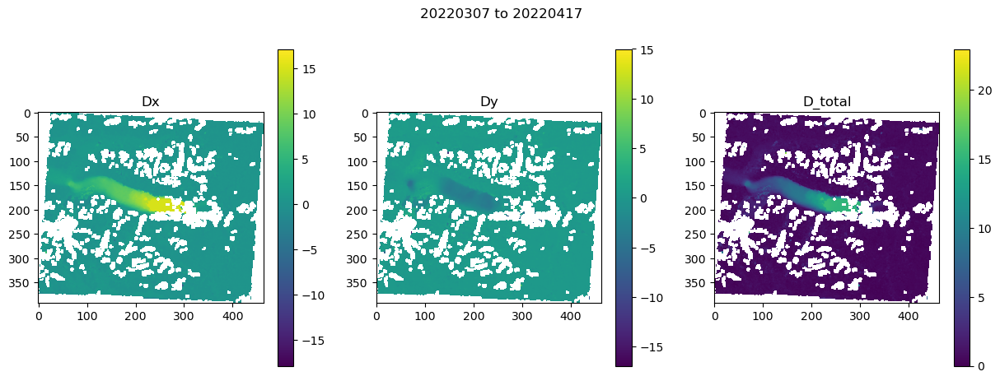

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3283350467681885
LC09_L1TP_060018_20220417_20230421_02_T1_B8.TIF LC08_L1TP_061018_20220518_20220525_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220417 20220518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 2678400.0
XLimits: 296889.10108337295  343344.10108337295
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_d

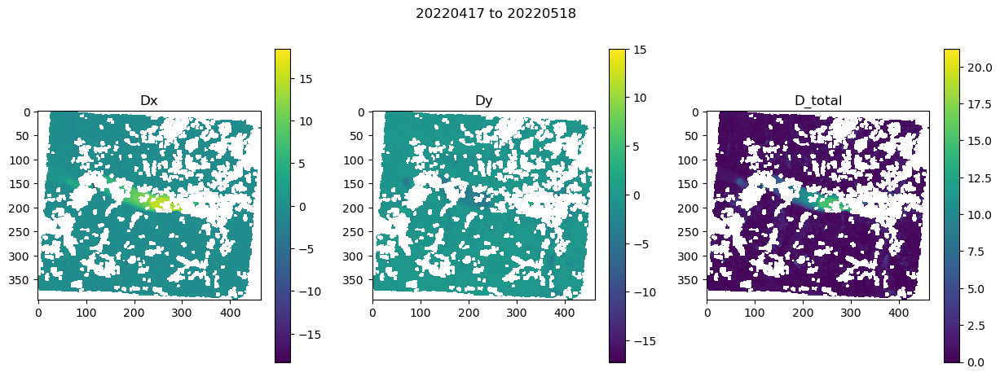

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30189085006713867
20220518 20220526
LC08_L1TP_061018_20220518_20220525_02_T1_B8.TIF LC09_L1TP_061018_20220526_20230415_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220518 20220526

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_D

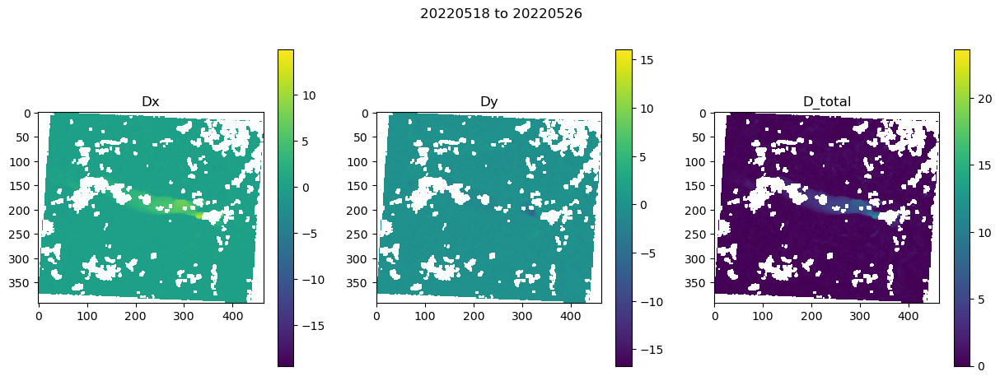

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30910277366638184
LC09_L1TP_061018_20220526_20230415_02_T1_B8.TIF LC08_L1TP_061018_20220603_20220610_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220526 20220603

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDE

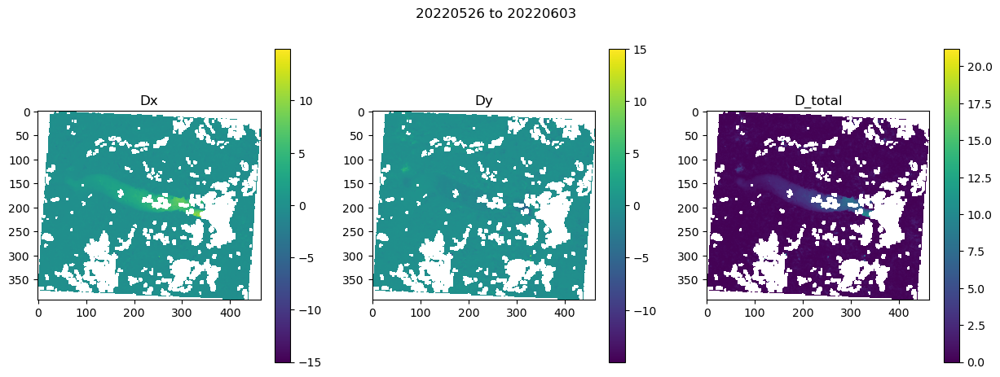

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7677457332611084
20220603 20220611
LC08_L1TP_061018_20220603_20220610_02_T1_B8.TIF LC09_L1TP_061018_20220611_20230413_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220603 20220611

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DI

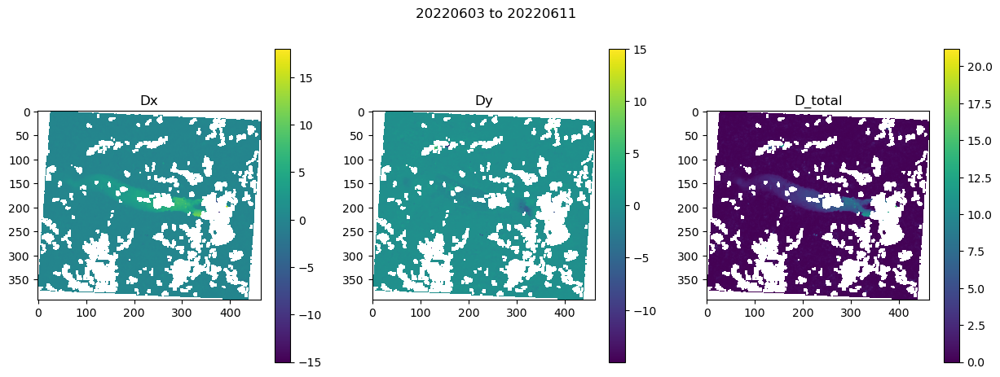

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.599236249923706
LC09_L1TP_061018_20220611_20230413_02_T1_B8.TIF LC09_L1TP_061018_20220627_20230409_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220611 20220627

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM

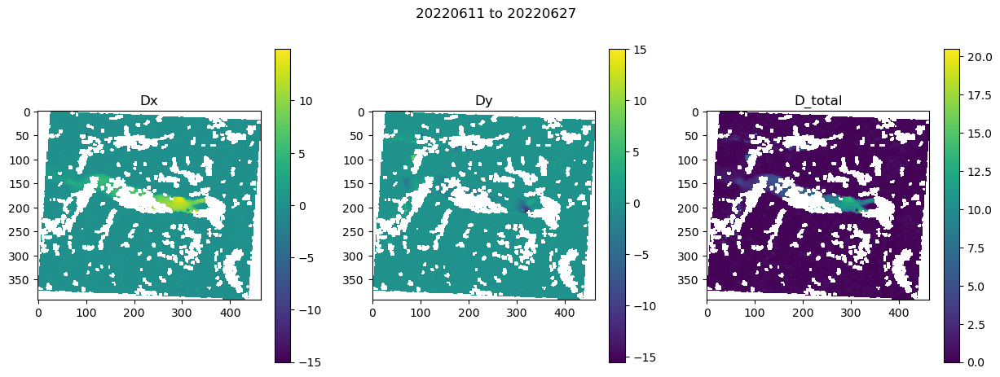

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30184483528137207
20220627 20220706
LC09_L1TP_061018_20220627_20230409_02_T1_B8.TIF LC09_L1TP_060018_20220706_20230408_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220627 20220706

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707497.5  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668298.035256202  6707497.5
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_Arct

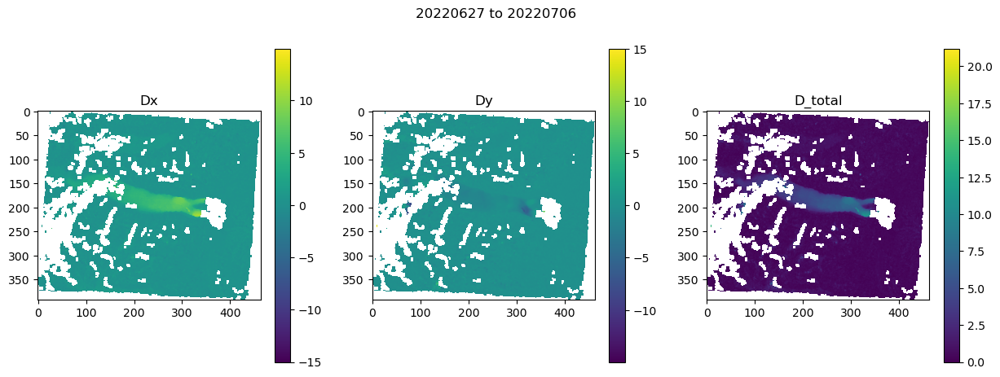

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0644080638885498
LC09_L1TP_060018_20220706_20230408_02_T1_B8.TIF LC09_L1TP_060018_20220807_20230403_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220706 20220807

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296887.5  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 2764800.0
XLimits: 296887.5  343342.5
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window

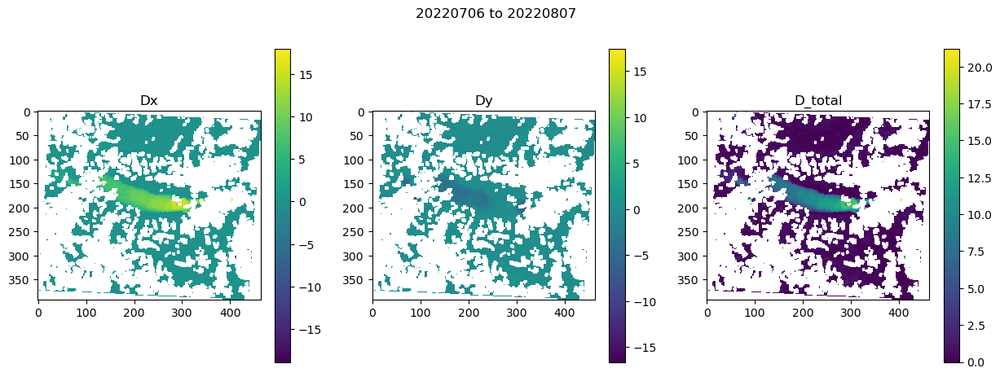

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30063414573669434
LC09_L1TP_060018_20220807_20230403_02_T1_B8.TIF LC09_L1TP_061018_20220915_20230329_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220807 20220915

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 3369600.0
XLimits: 296889.10108337295  343344.10108337295
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_

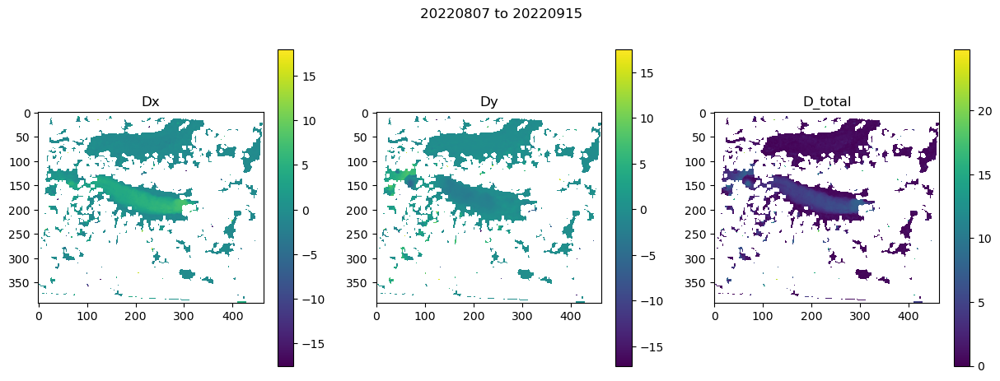

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9099969863891602
20220915 20221025
LC09_L1TP_061018_20220915_20230329_02_T1_B8.TIF LC08_L1TP_061018_20221025_20221107_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220915 20221025

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707501.17934736  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 3456000.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668301.714603562  6707501.17934736
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_D

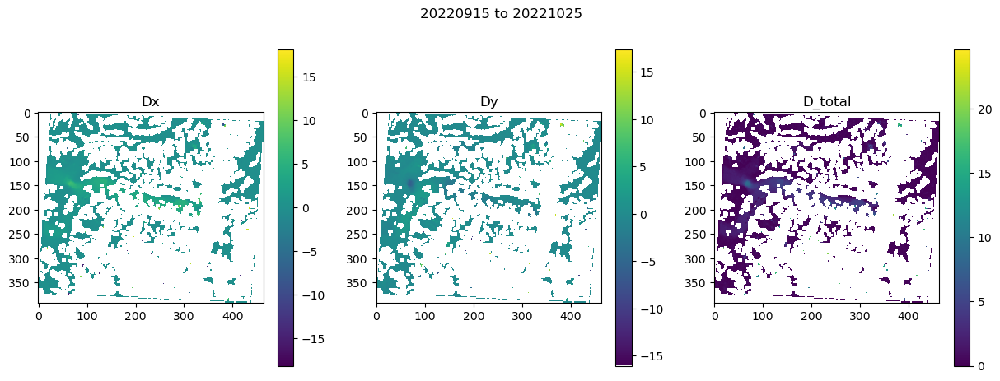

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.310490131378174
LC08_L1TP_061018_20221025_20221107_02_T1_B8.TIF LC09_L1TP_060018_20221111_20230322_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221025 20221111

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707497.5  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1468800.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668298.035256202  6707497.5
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_

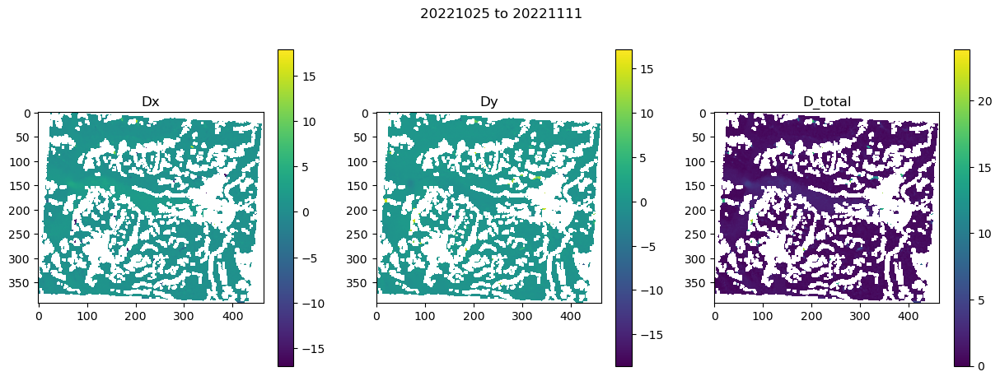

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3052220344543457
LC09_L1TP_060018_20221111_20230322_02_T1_B8.TIF LC09_L1TP_061018_20221118_20230321_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221111 20221118

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.0
Y-direction coordinate: 6707497.5  -15.0
Dimensions: 3097  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296889.10108337295  343344.10108337295
YLimits: 6668302.5  6707497.5
Extent in km: 46.455  39.195
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dh

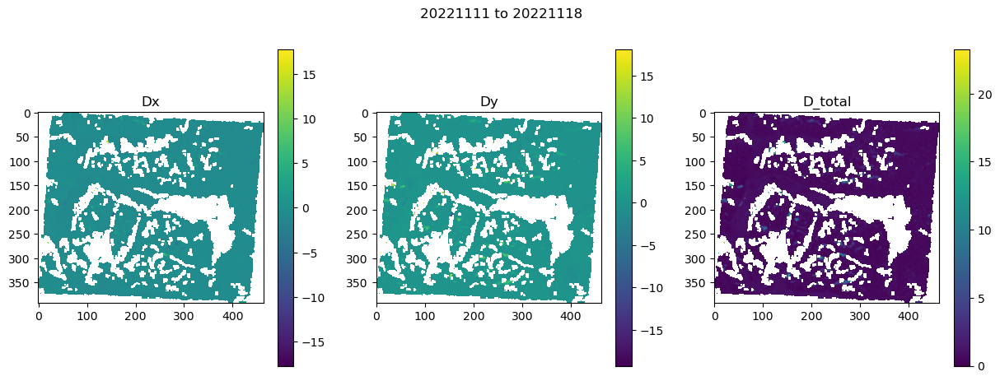

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2678101062774658
LC09_L1TP_061018_20221118_20230321_02_T1_B8.TIF LC09_L1TP_060018_20221127_20230320_02_T1_B8.TIF
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221118 20221127

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296889.10108337295  15.001708665823536
Y-direction coordinate: 6707497.5  -15.00170866582383
Dimensions: 3096  2613

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296889.10108337295  343334.3911127626
YLimits: 6668298.035256202  6707497.5
Extent in km: 46.44529002938967  39.19946474379767
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_

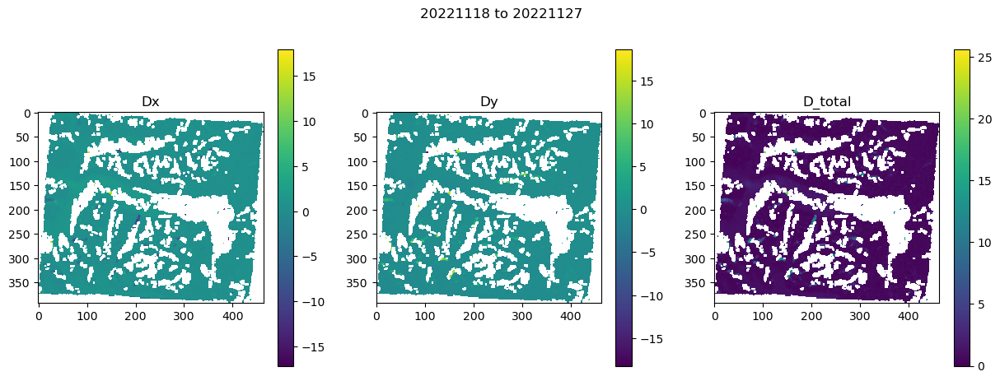

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2907578945159912
Finished searching.
Number of files found: 129
LO_ArcticDEM_clipped_100m.tif  already exists.
LO_ArcticDEM_clipped_dhdy_100m.tif and LO_ArcticDEM_clipped_dhdx_100m.tif already exist.
20210202 20210204
20210202 20210206
20210202 20210208
PS_20210202_clipped.tif PS_20210208_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210202 20210208

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/S

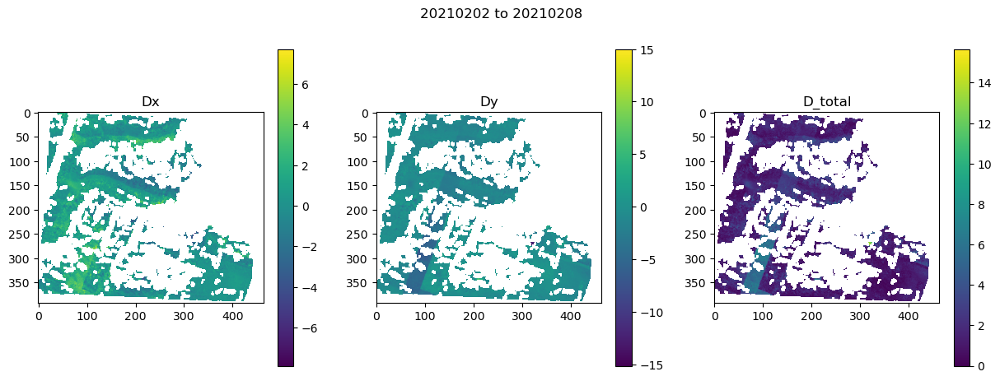

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.6018059253692627
20210208 20210210
20210208 20210212
20210208 20210213
PS_20210208_clipped.tif PS_20210213_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210208 20210213

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Wind

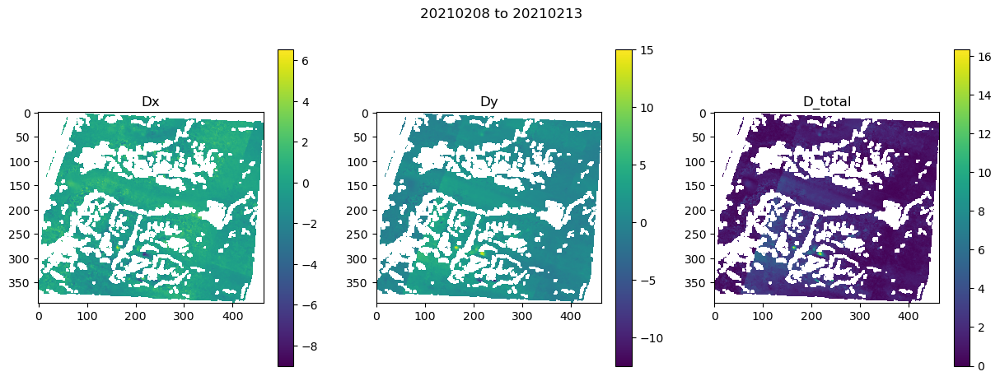

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7049868106842041
20210213 20210215
20210213 20210222
PS_20210213_clipped.tif PS_20210222_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210213 20210222

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

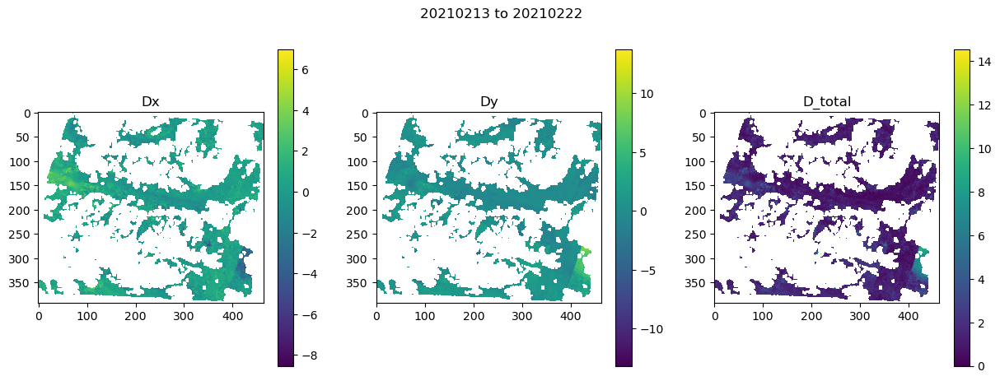

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.6848320960998535
PS_20210222_clipped.tif PS_20210304_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210222 20210304

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

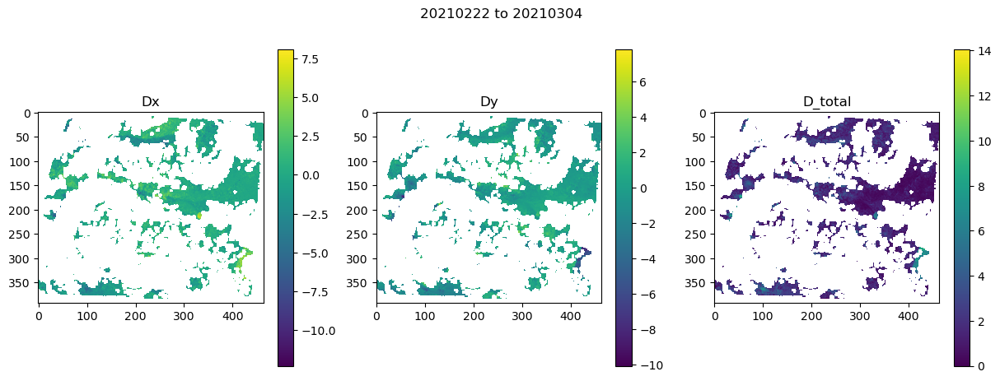

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7947289943695068
20210304 20210309
PS_20210304_clipped.tif PS_20210309_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210304 20210309

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

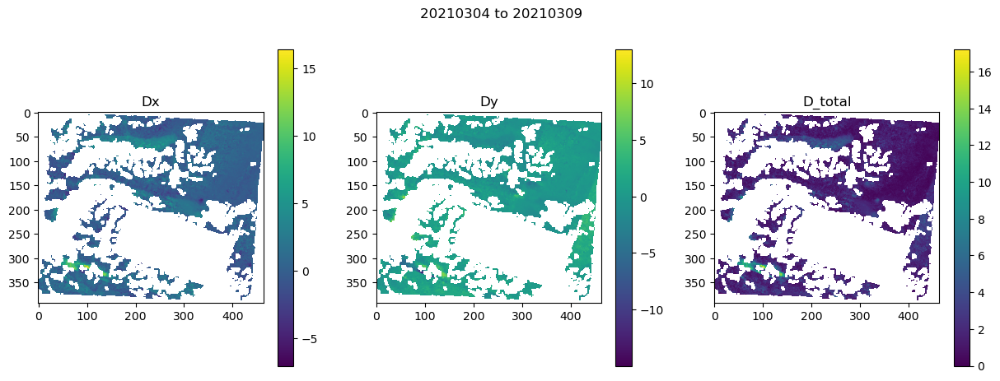

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.06599593162536621
20210309 20210316
PS_20210309_clipped.tif PS_20210316_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210309 20210316

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

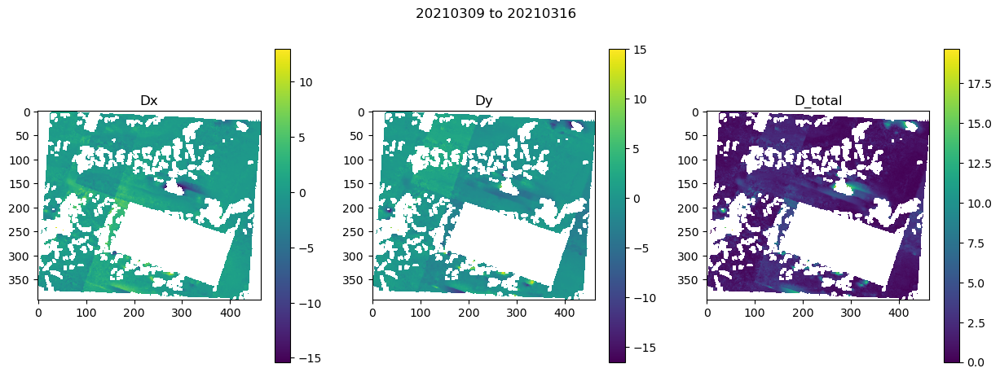

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.486698865890503
20210316 20210320
20210316 20210324
PS_20210316_clipped.tif PS_20210324_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210316 20210324

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: windo

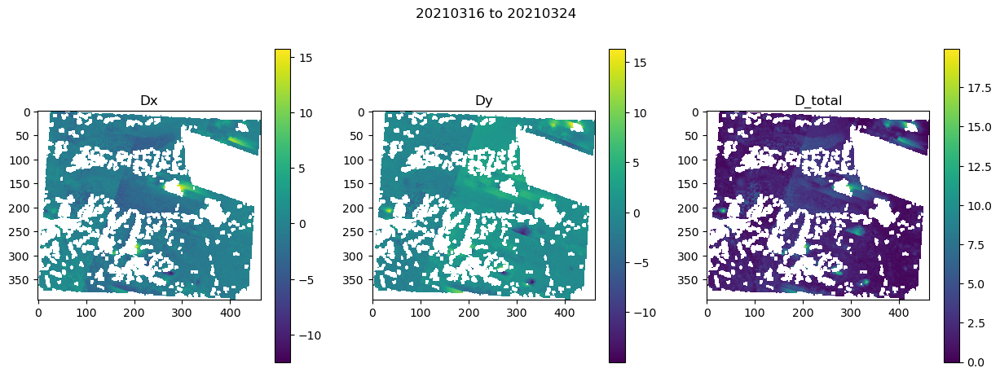

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
2.2265708446502686
PS_20210324_clipped.tif PS_20210415_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210324 20210415

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1900800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

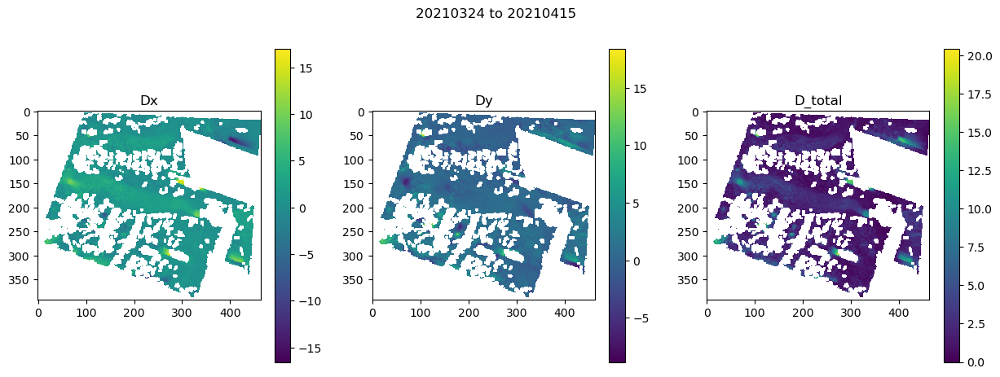

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.960752010345459
20210415 20210420
PS_20210415_clipped.tif PS_20210420_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210415 20210420

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Win

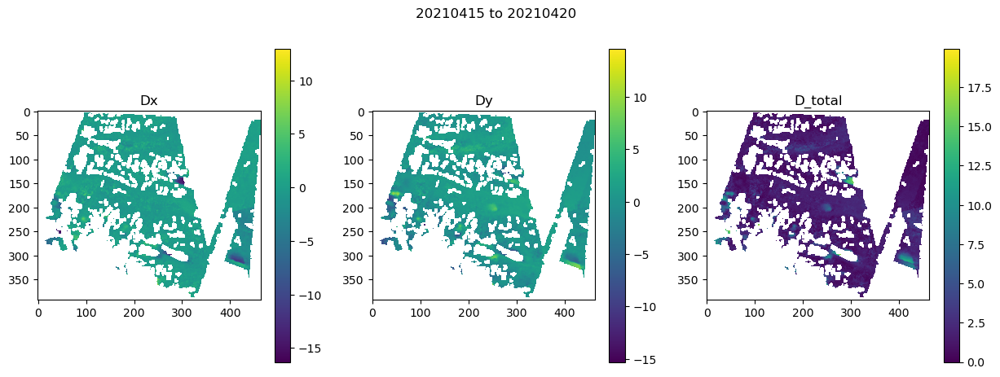

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9665961265563965
20210420 20210430
PS_20210420_clipped.tif PS_20210430_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210420 20210430

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

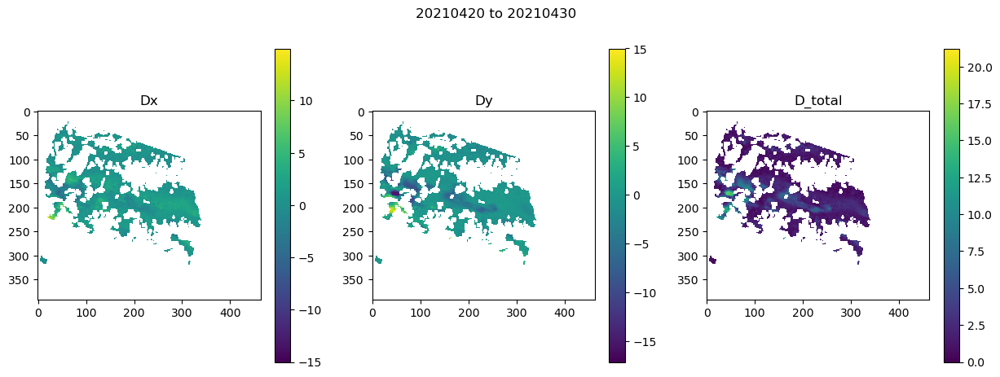

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7893760204315186
PS_20210430_clipped.tif PS_20210517_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210430 20210517

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1468800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

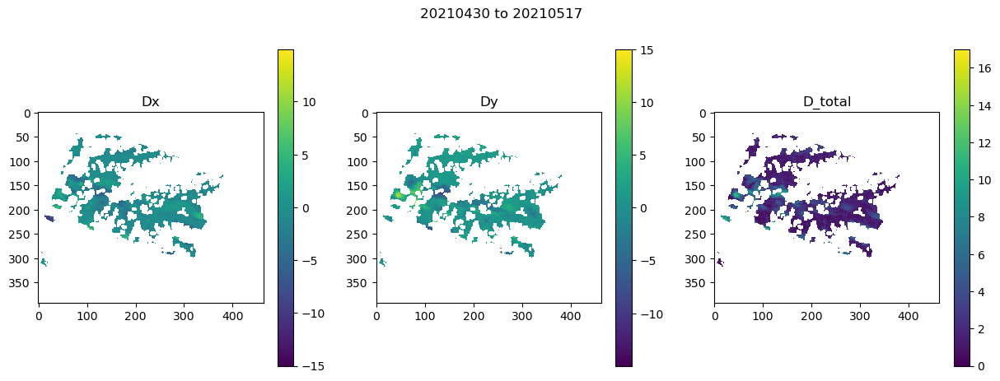

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.30671167373657227
PS_20210517_clipped.tif PS_20210601_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210517 20210601

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1296000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel

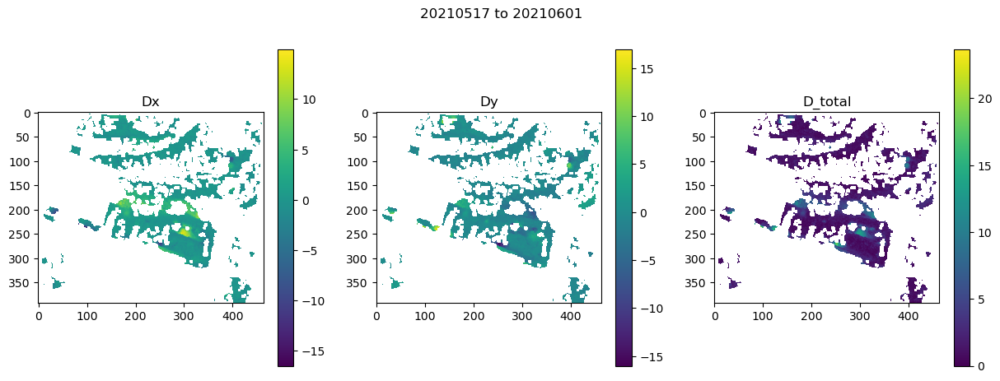

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
2.193998098373413
20210601 20210608
PS_20210601_clipped.tif PS_20210608_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210601 20210608

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Win

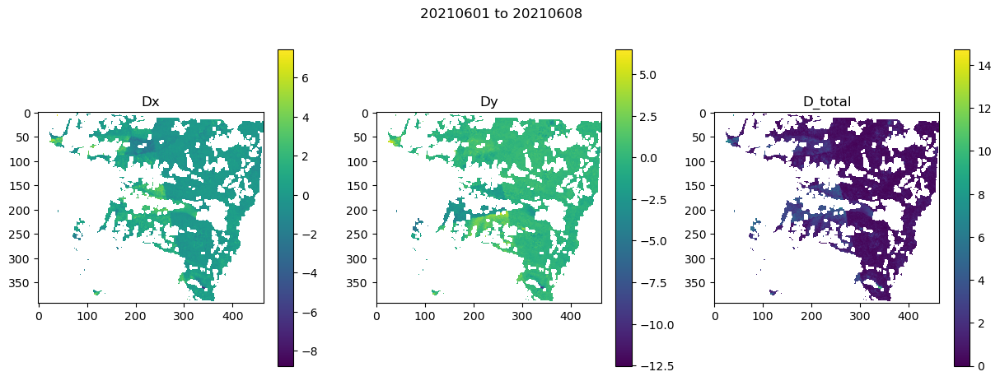

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7868192195892334
20210608 20210613
PS_20210608_clipped.tif PS_20210613_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210608 20210613

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

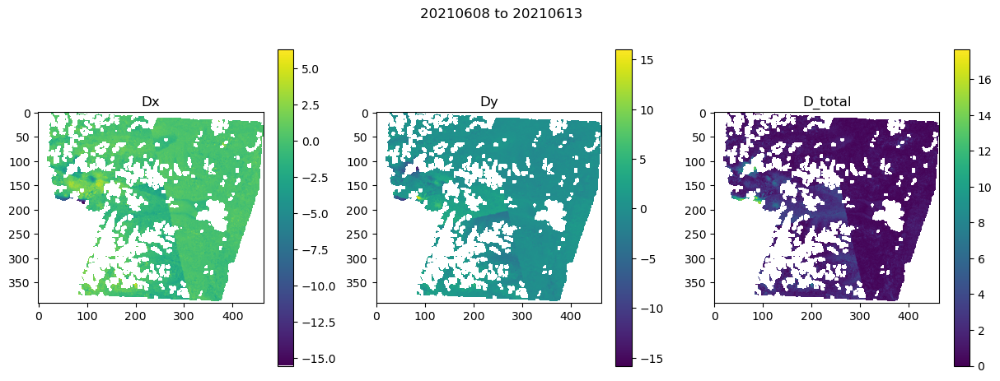

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.5752780437469482
PS_20210613_clipped.tif PS_20210619_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210613 20210619

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

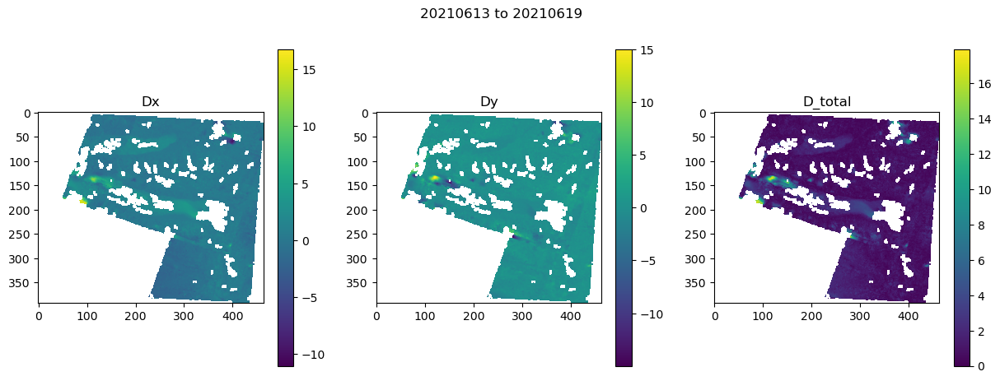

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
8.055951118469238
20210619 20210627
PS_20210619_clipped.tif PS_20210627_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210619 20210627

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Win

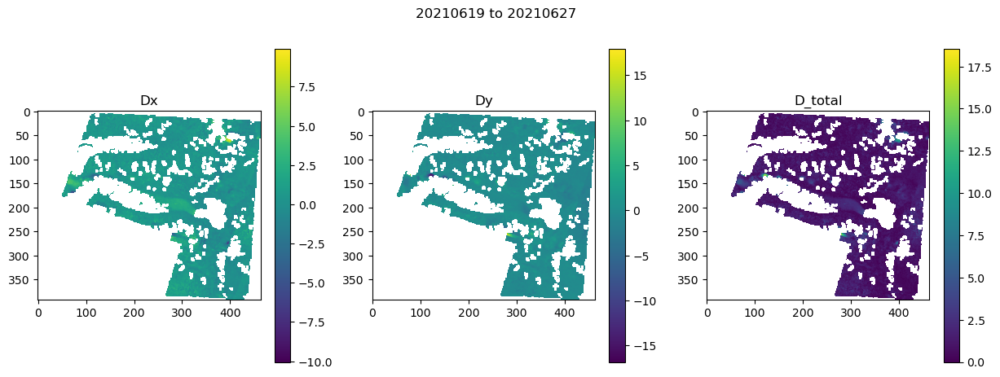

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.2674539089202881
PS_20210627_clipped.tif PS_20210703_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210627 20210703

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

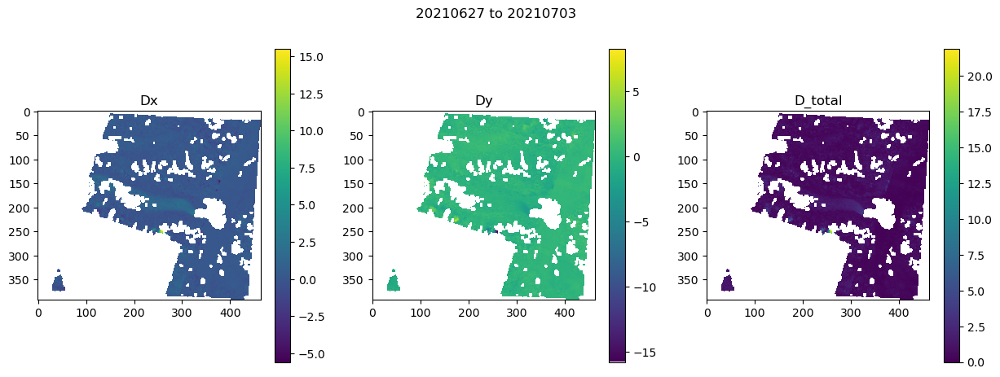

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3066258430480957
20210703 20210705
20210703 20210707
20210703 20210719
PS_20210703_clipped.tif PS_20210719_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210703 20210719

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1382400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Win

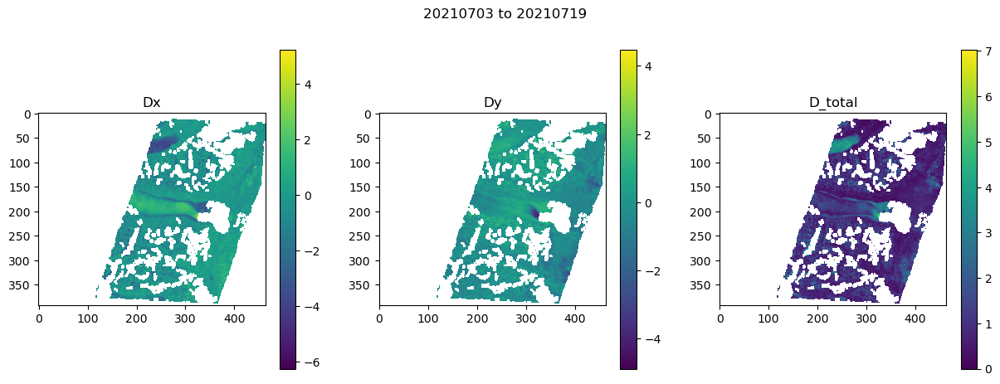

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3257629871368408
20210719 20210722
20210719 20210723
20210719 20210730
PS_20210719_clipped.tif PS_20210730_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210719 20210730

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 950400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Wind

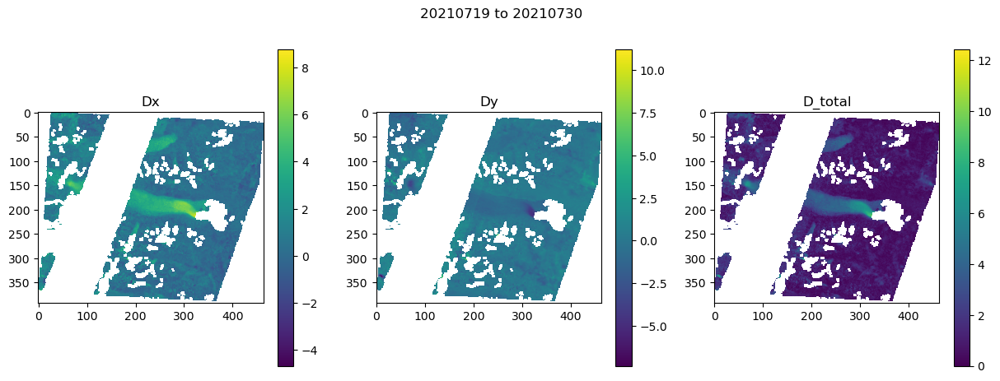

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.32917284965515137
20210730 20210801
20210730 20210803
20210730 20210807
PS_20210730_clipped.tif PS_20210807_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210730 20210807

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Win

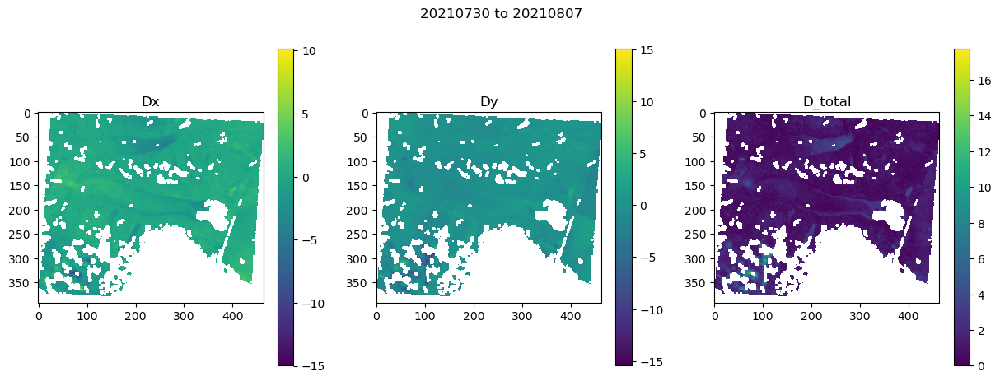

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.29823994636535645
PS_20210807_clipped.tif PS_20210815_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210807 20210815

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

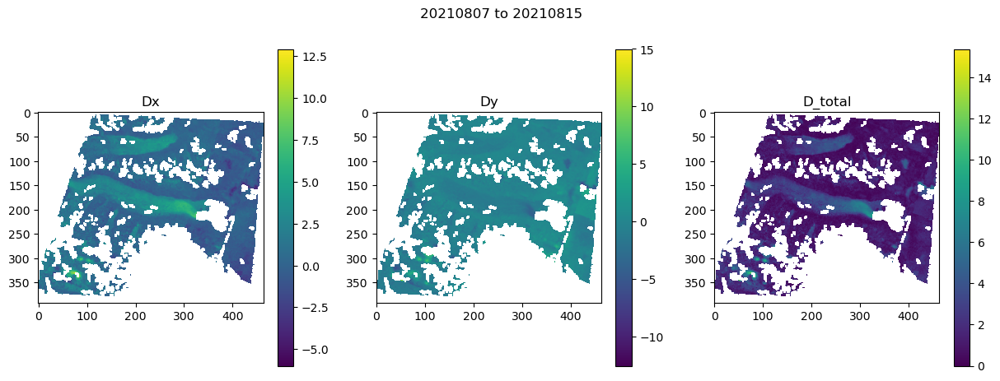

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.6648697853088379
20210815 20210819
20210815 20210822
PS_20210815_clipped.tif PS_20210822_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210815 20210822

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

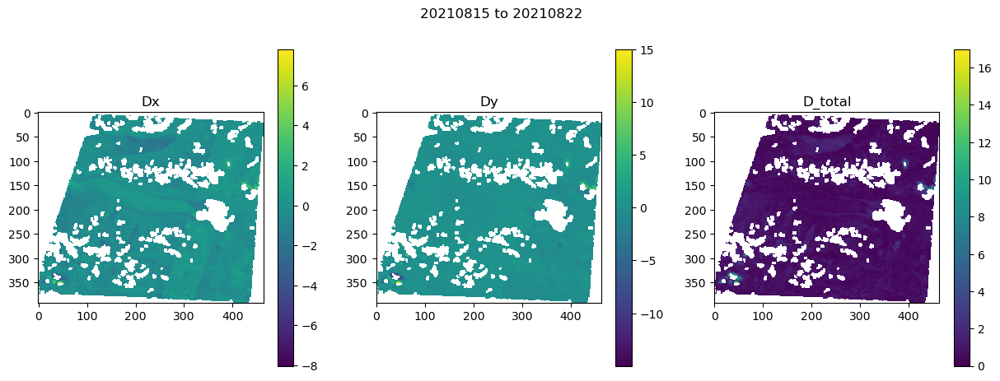

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3843507766723633
20210822 20210830
PS_20210822_clipped.tif PS_20210830_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210822 20210830

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

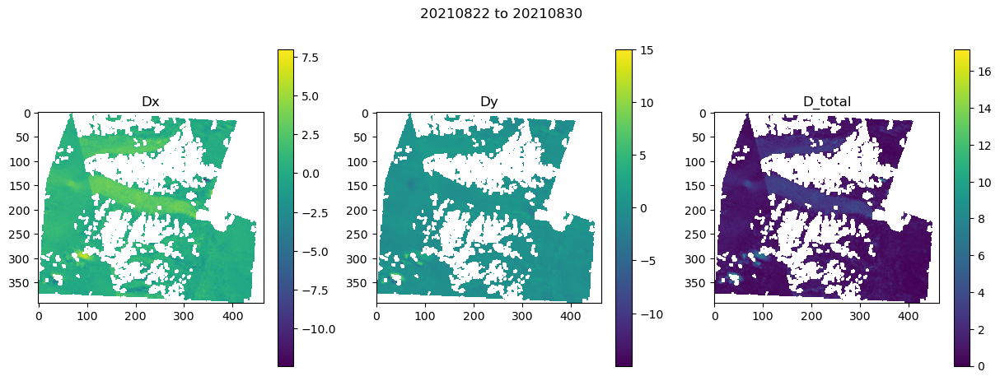

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.693723201751709
20210830 20210907
PS_20210830_clipped.tif PS_20210907_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210830 20210907

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Win

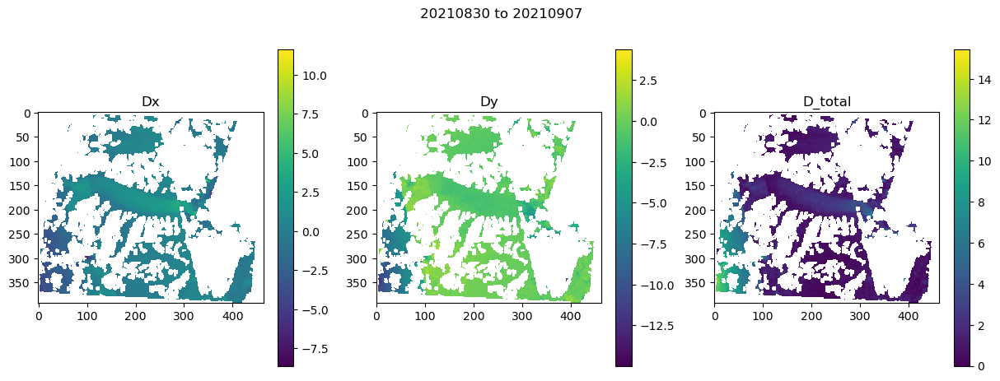

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.8019821643829346
20210907 20210914
PS_20210907_clipped.tif PS_20210914_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210907 20210914

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

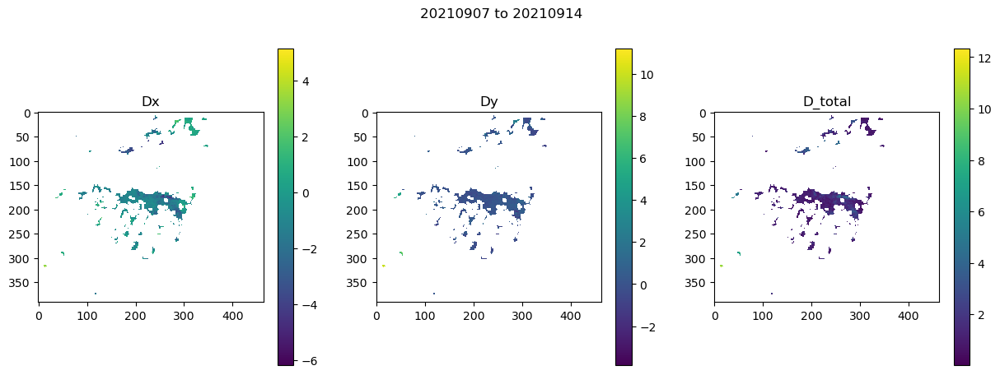

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7046918869018555
20210914 20210919
PS_20210914_clipped.tif PS_20210919_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210914 20210919

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

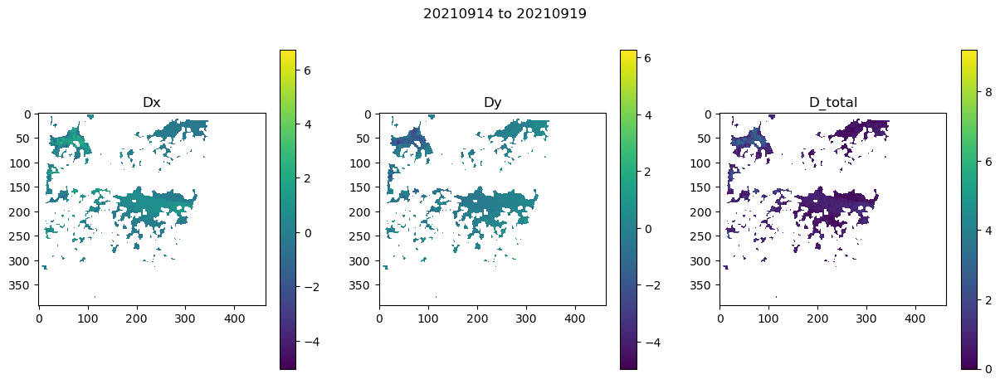

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7680480480194092
PS_20210919_clipped.tif PS_20210925_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210919 20210925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

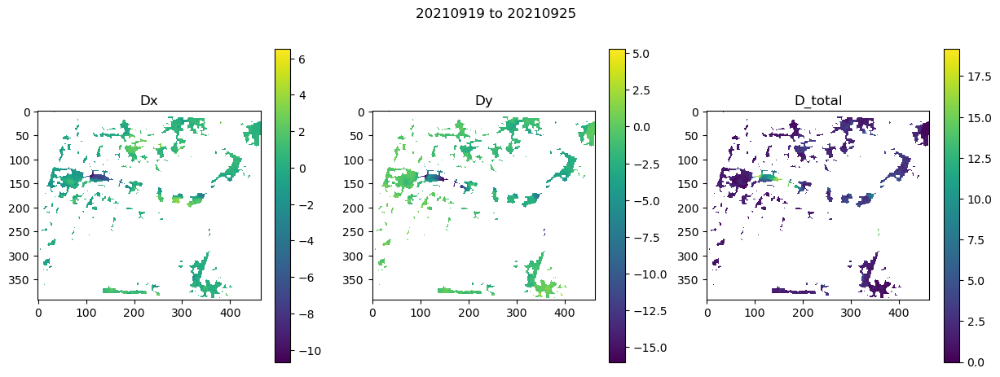

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7379231452941895
20210925 20211015
PS_20210925_clipped.tif PS_20211015_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20210925 20211015

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1728000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

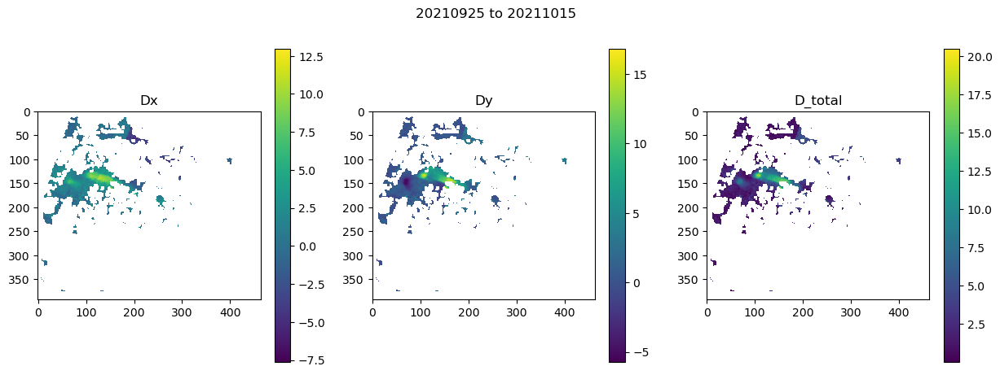

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7859129905700684
20211015 20211021
PS_20211015_clipped.tif PS_20211021_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211015 20211021

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

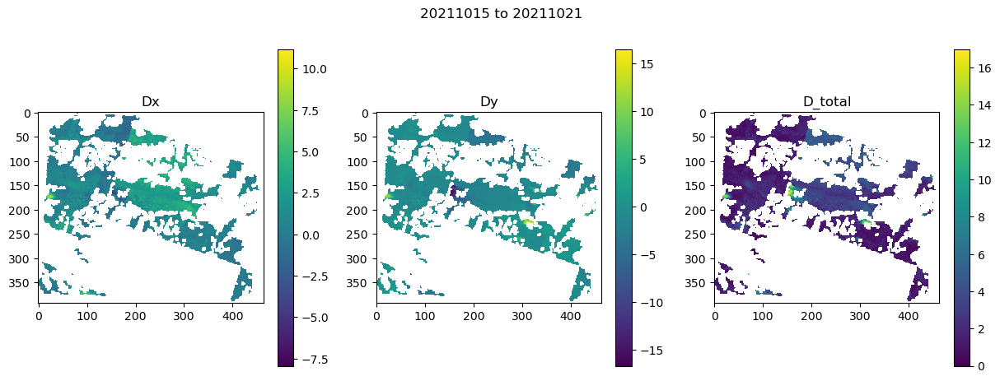

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.156376838684082
20211021 20211028
PS_20211021_clipped.tif PS_20211028_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211021 20211028

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Win

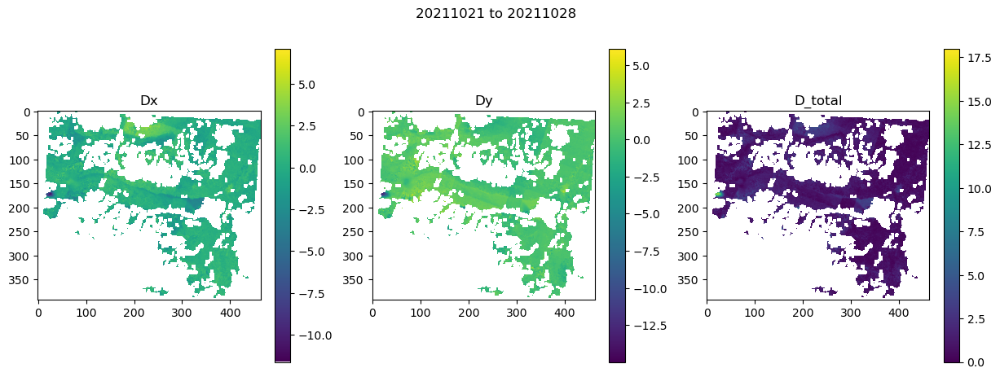

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.39424896240234375
20211028 20211104
PS_20211028_clipped.tif PS_20211104_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211028 20211104

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

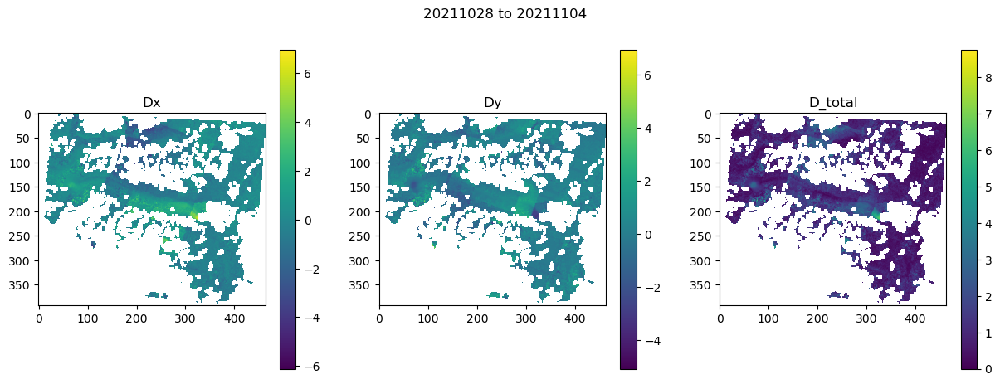

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.07333993911743164
20211104 20211108
20211104 20211113
PS_20211104_clipped.tif PS_20211113_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20211104 20211113

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: win

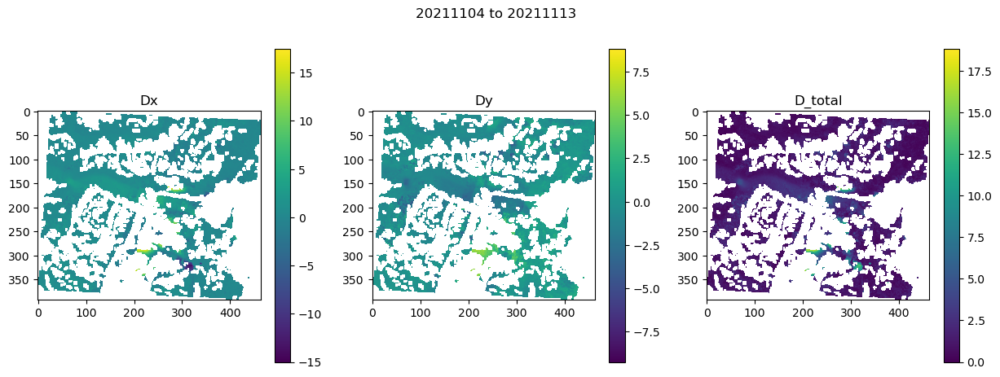

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
9.226990222930908
20211113 20220202
20211113 20220215
20211113 20220219
20211113 20220220
20211113 20220221
20211113 20220224
20211113 20220228
20211113 20220402
20211113 20220404
20211113 20220406
20211113 20220413
20211113 20220415
20211113 20220417
20211113 20220420
20211113 20220421
20211113 20220422
20211113 20220429
20211113 20220506
20211113 20220518
20211113 20220520
20211113 20220522
20211113 20220526
20211113 20220604
20211113 20220608
20211113 20220616
20211113 20220617
20211113 20220624
20211113 20220625
20211113 20220627
20211113 20220703
20211113 20220704
20211113 20220706
20211113 20220707
20211113 20220726
20211113 20220729
20211113 20220807
20211113 20220809
20211113 20220812
20211113 20220820
20211113 20220830
20211113 20220905
20211113 20220906
20211113 20220916
20211113 20220925
20211113 20220927
20211113 20220928
20211113 20221006
20211113 20221008
20211113 20

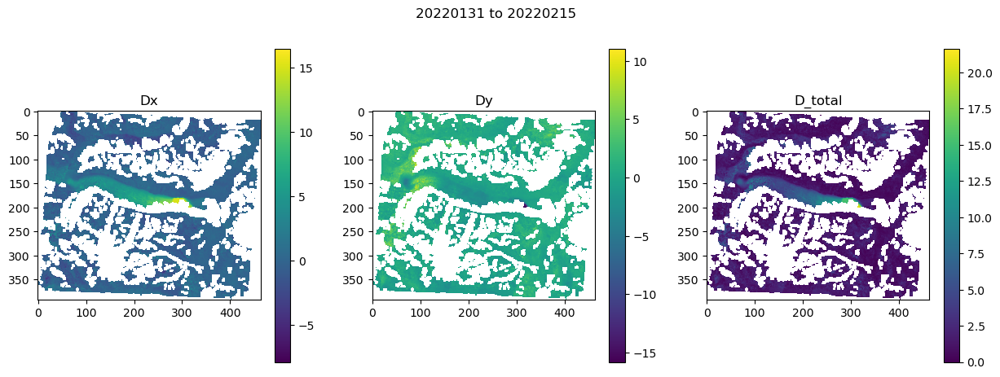

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.27813196182250977
20220215 20220220
PS_20220215_clipped.tif PS_20220220_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220215 20220220

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

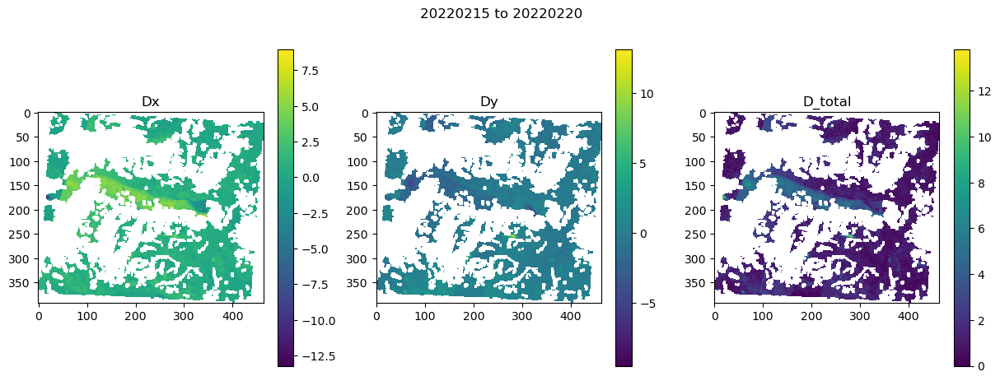

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
9.082949161529541
20220220 20220224
20220220 20220228
PS_20220220_clipped.tif PS_20220228_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220220 20220228

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: windo

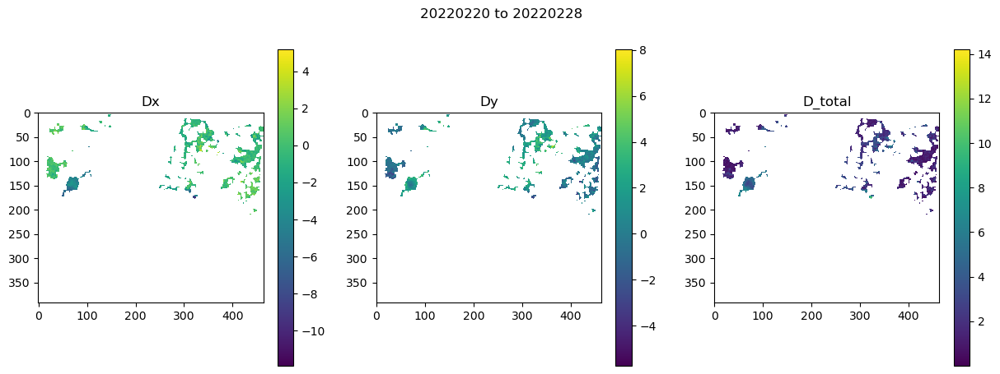

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7870299816131592
PS_20220228_clipped.tif PS_20220402_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220228 20220402

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 2851200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

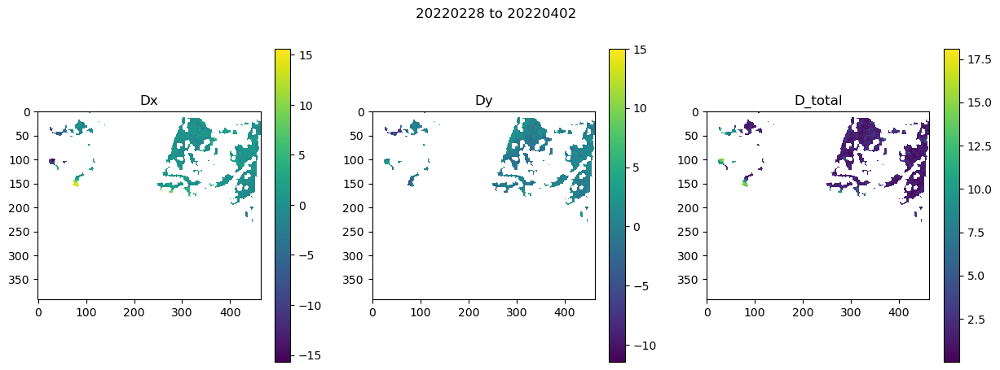

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.6322250366210938
20220402 20220406
20220402 20220413
PS_20220402_clipped.tif PS_20220413_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220402 20220413

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 950400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

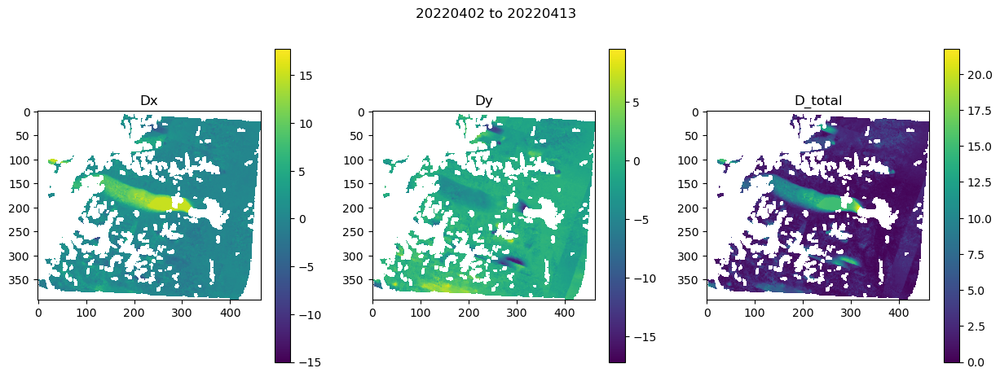

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.5987310409545898
20220413 20220417
20220413 20220420
PS_20220413_clipped.tif PS_20220420_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220413 20220420

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

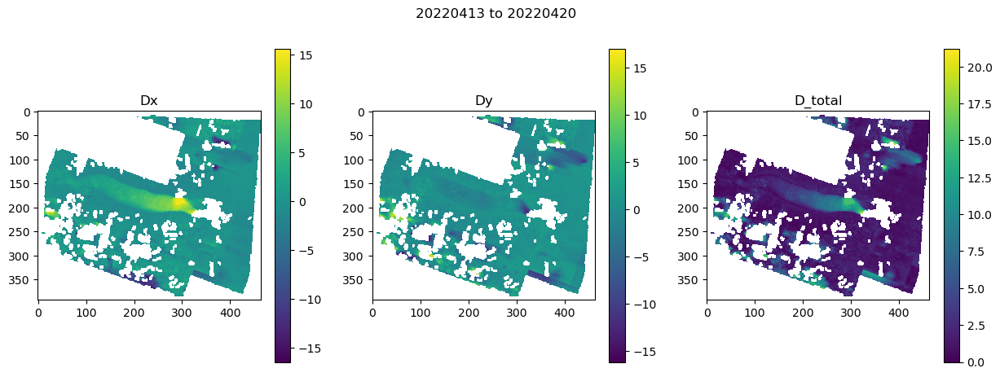

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.077118158340454
20220420 20220422
20220420 20220429
PS_20220420_clipped.tif PS_20220429_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220420 20220429

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: windo

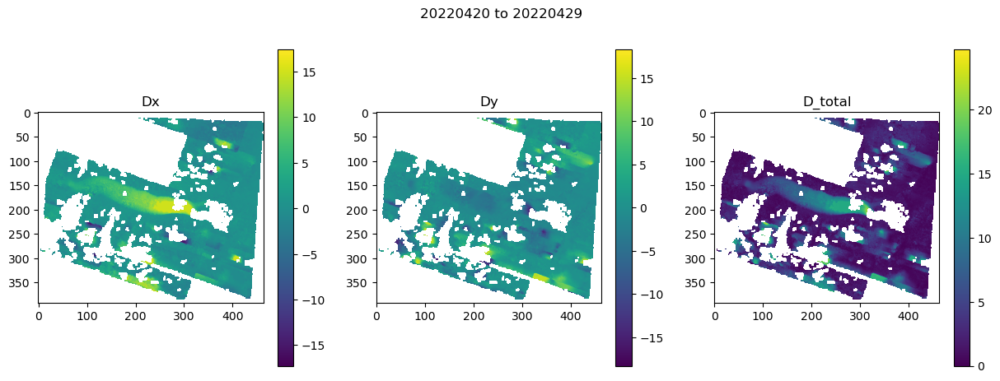

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.08798003196716309
PS_20220429_clipped.tif PS_20220506_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220429 20220506

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

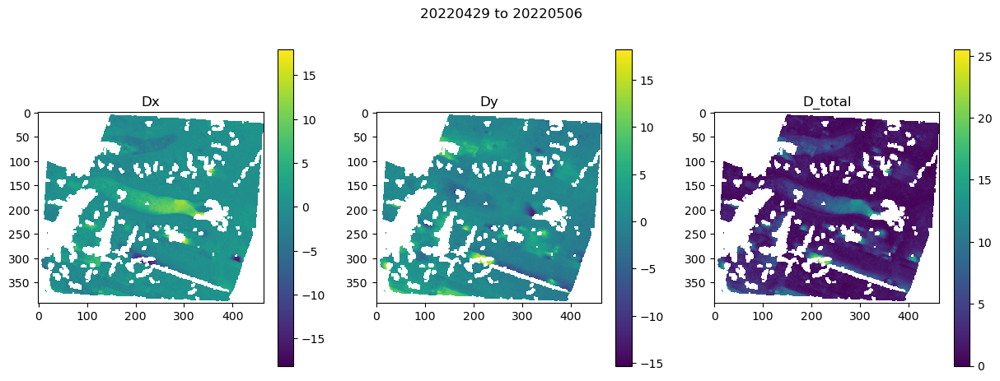

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.36205315589904785
PS_20220506_clipped.tif PS_20220518_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220506 20220518

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel

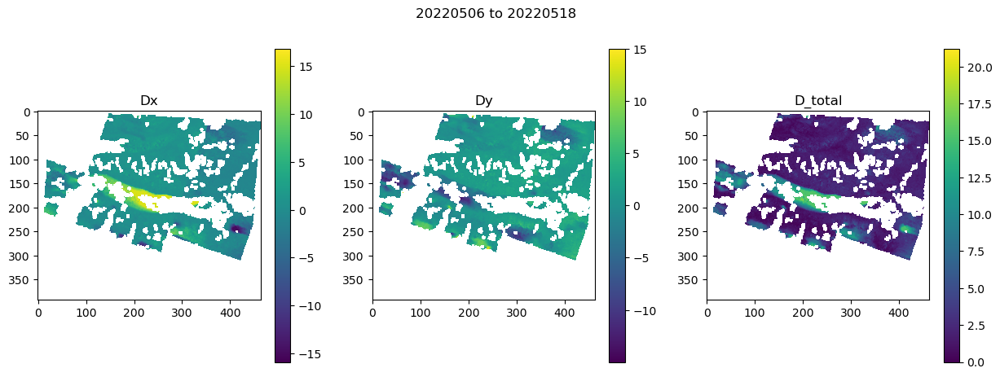

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9054861068725586
20220518 20220522
20220518 20220526
PS_20220518_clipped.tif PS_20220526_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220518 20220526

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

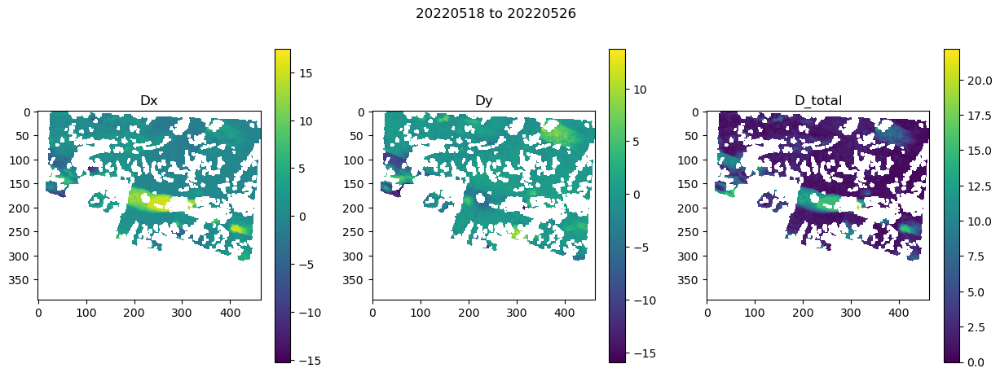

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.13355493545532227
PS_20220526_clipped.tif PS_20220604_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220526 20220604

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

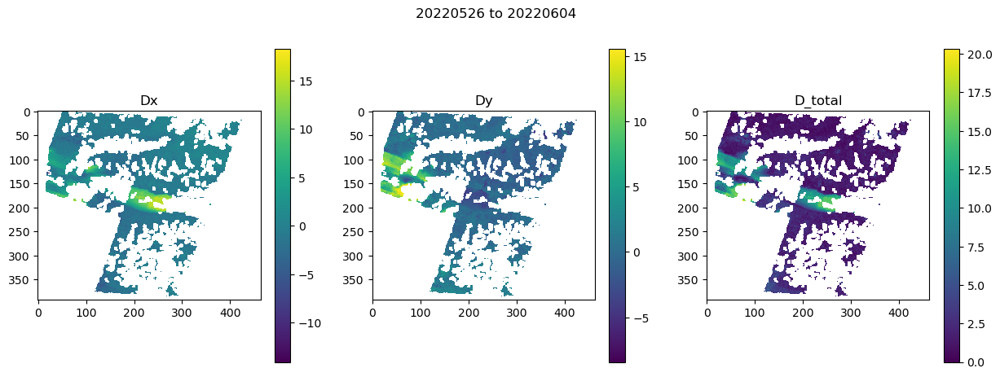

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.09020495414733887
20220604 20220616
PS_20220604_clipped.tif PS_20220616_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220604 20220616

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif


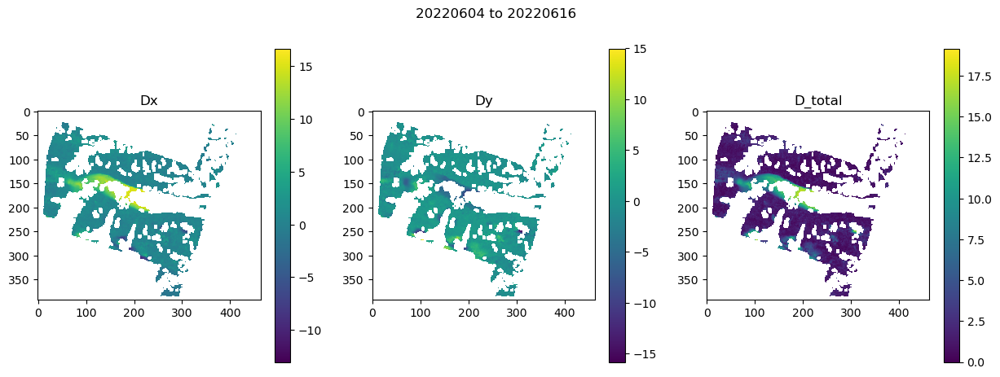

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.4742739200592041
20220616 20220624
PS_20220616_clipped.tif PS_20220624_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220616 20220624

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

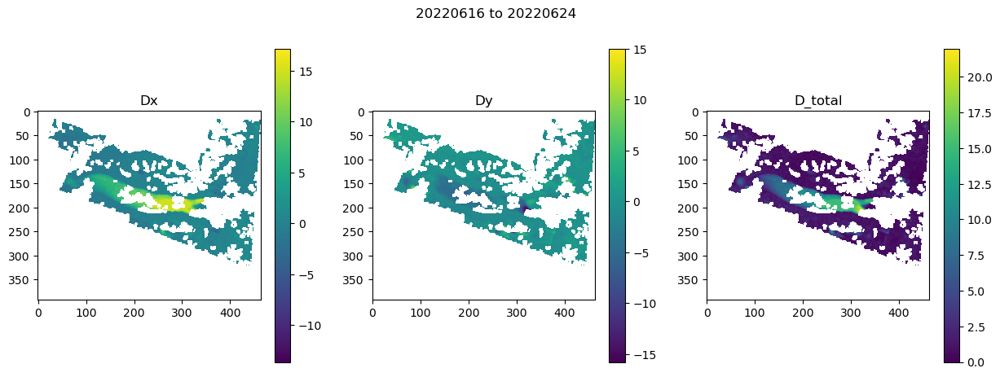

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.8899500370025635
20220624 20220627
20220624 20220703
PS_20220624_clipped.tif PS_20220703_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220624 20220703

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

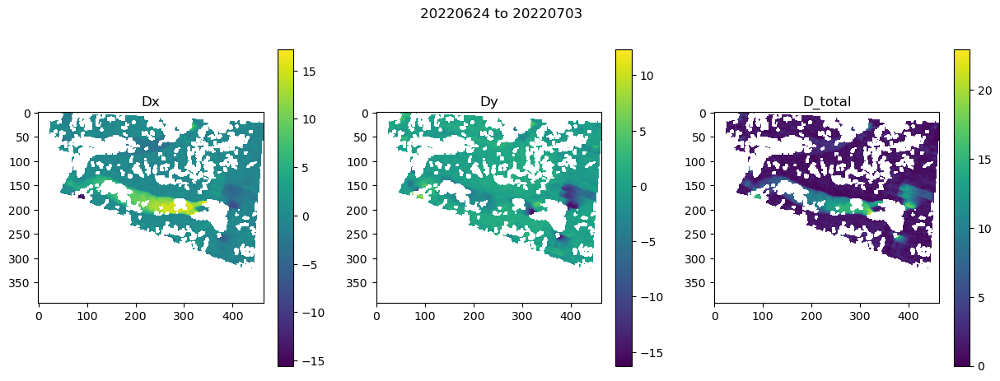

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.44744396209716797
20220703 20220706
20220703 20220707
20220703 20220726
PS_20220703_clipped.tif PS_20220726_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220703 20220726

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1987200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Wi

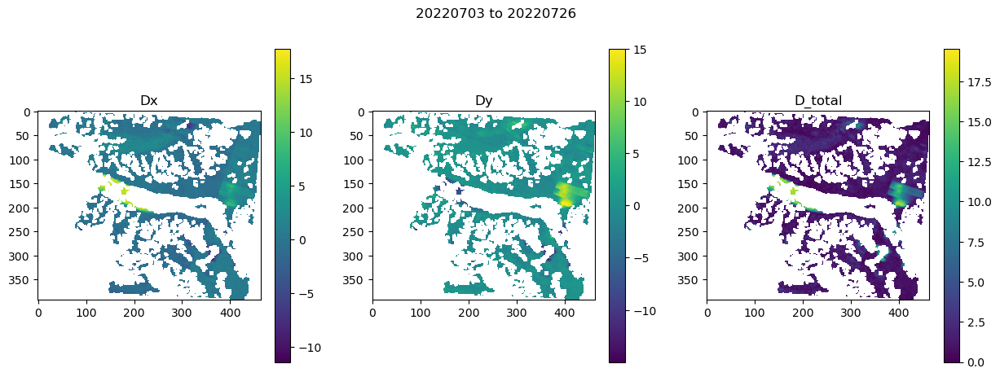

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.6559181213378906
20220726 20220807
PS_20220726_clipped.tif PS_20220807_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220726 20220807

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 1036800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

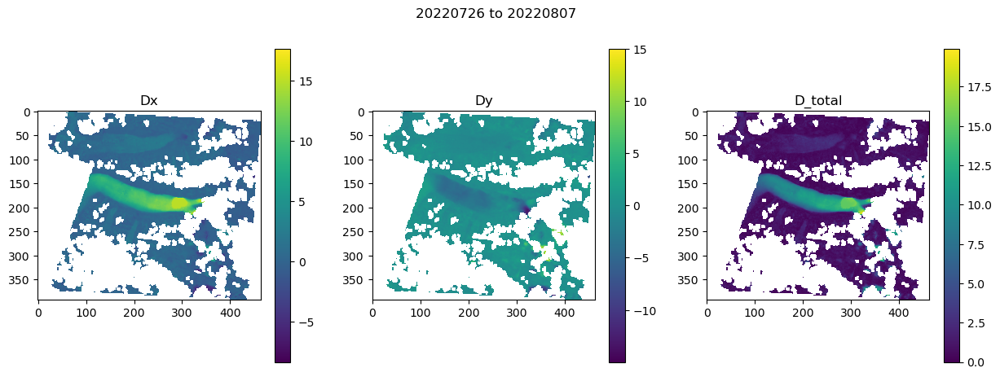

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.8107571601867676
20220807 20220812
PS_20220807_clipped.tif PS_20220812_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220807 20220812

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

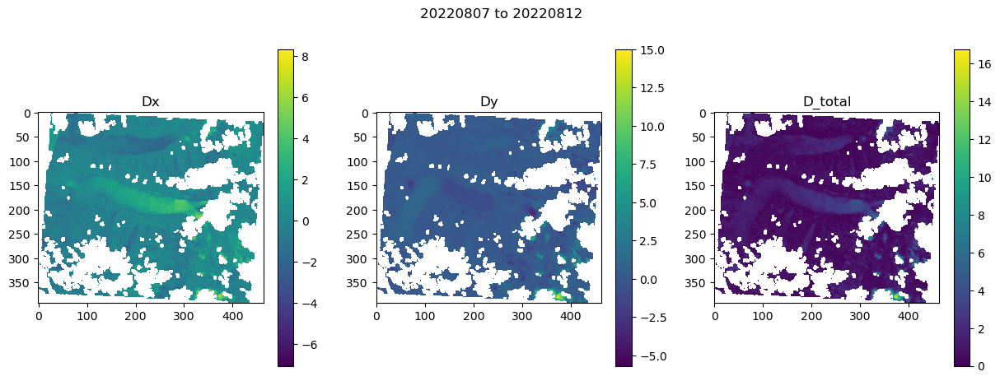

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9229340553283691
PS_20220812_clipped.tif PS_20220820_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220812 20220820

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 691200.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

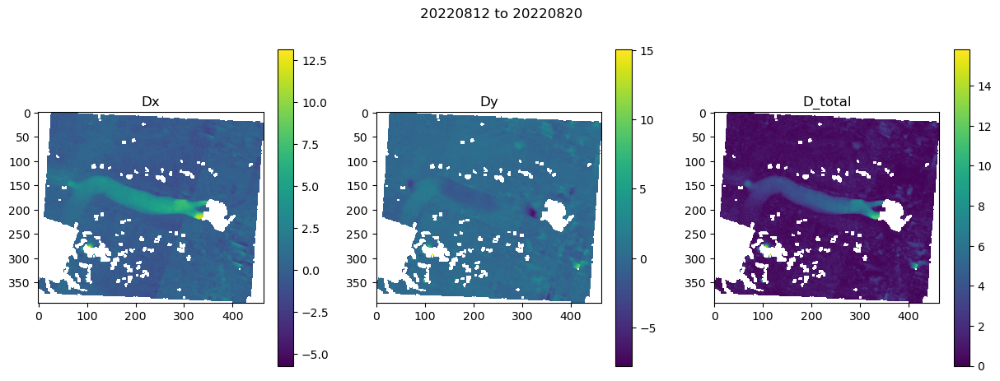

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.7848377227783203
PS_20220820_clipped.tif PS_20220830_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220820 20220830

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

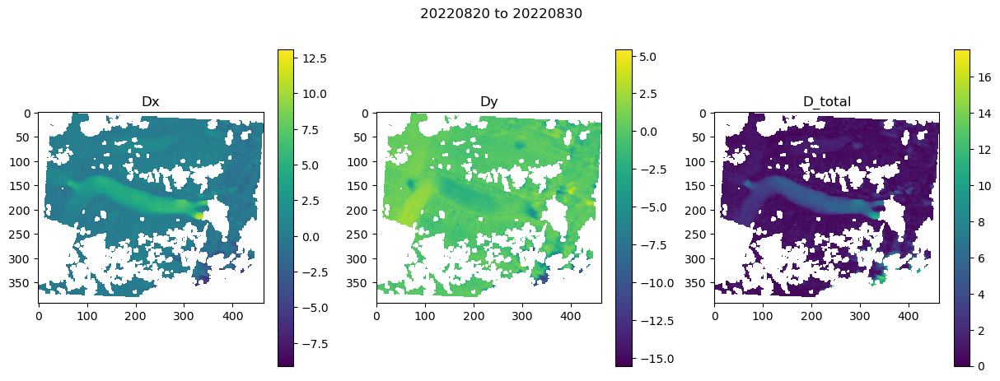

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3943517208099365
PS_20220830_clipped.tif PS_20220905_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220830 20220905

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 518400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

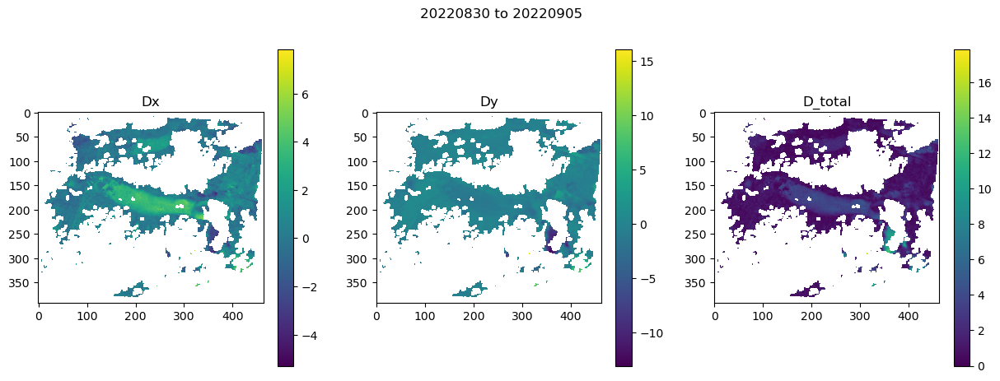

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.3662409782409668
20220905 20220916
PS_20220905_clipped.tif PS_20220916_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220905 20220916

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 950400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

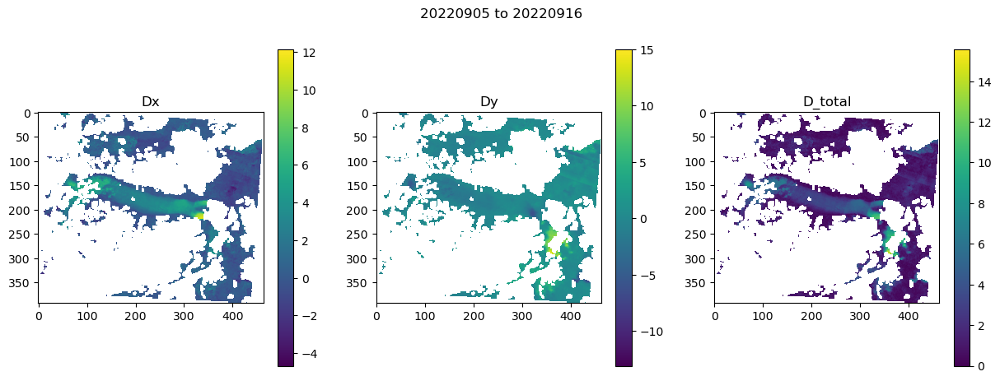

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.12371015548706055
PS_20220916_clipped.tif PS_20220925_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220916 20220925

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

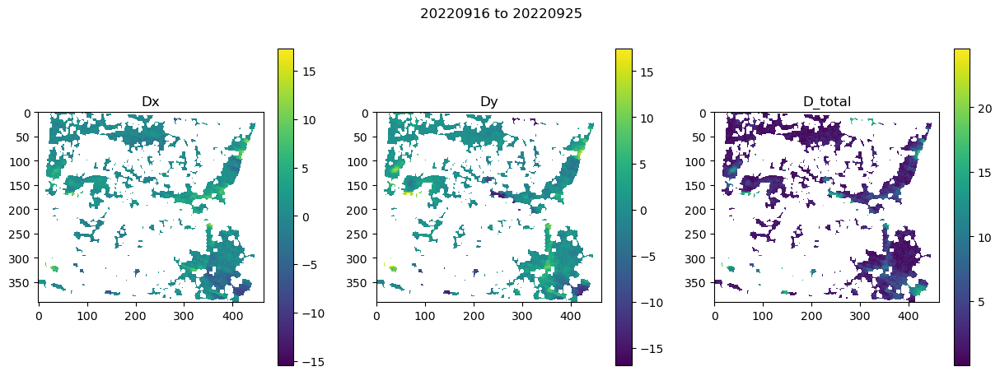

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.4045729637145996
20220925 20220928
20220925 20221006
PS_20220925_clipped.tif PS_20221006_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20220925 20221006

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 950400.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: wind

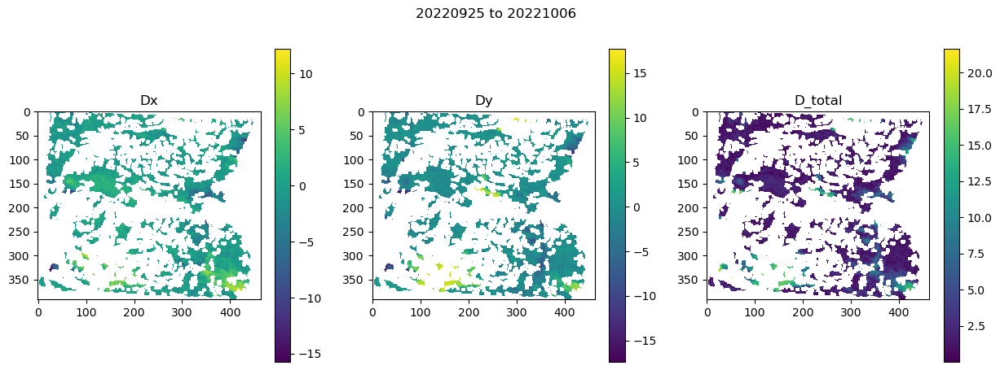

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.9714696407318115
20221006 20221013
PS_20221006_clipped.tif PS_20221013_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221006 20221013

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 604800.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

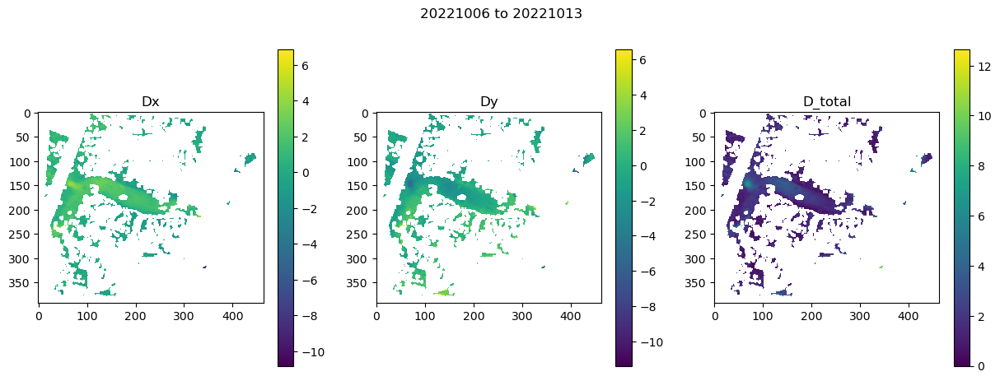

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.0979151725769043
PS_20221013_clipped.tif PS_20221022_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221013 20221022

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 777600.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

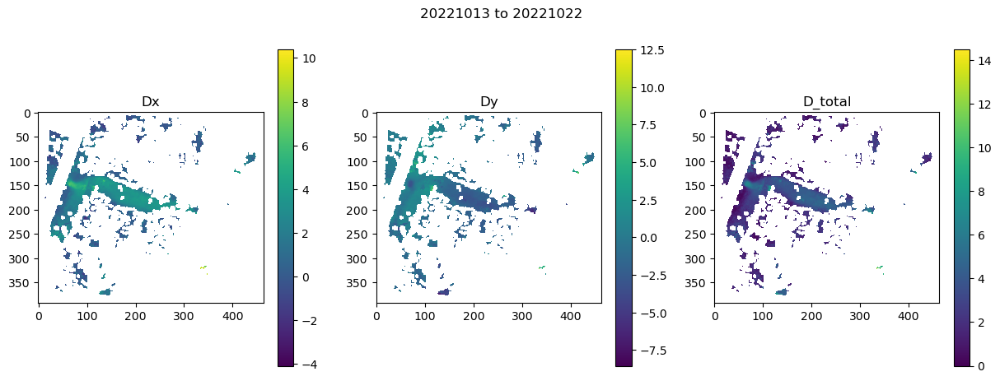

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
1.3209457397460938
20221022 20221101
PS_20221022_clipped.tif PS_20221101_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221022 20221101

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 864000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Wi

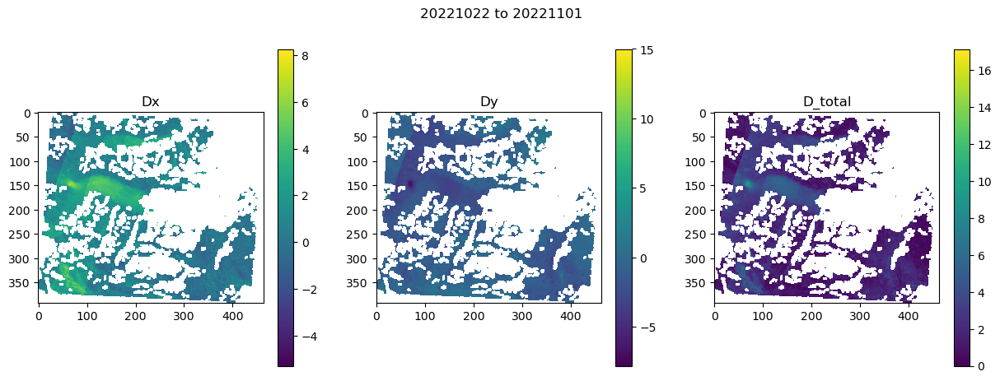

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.5711841583251953
PS_20221101_clipped.tif PS_20221106_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221101 20221106

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_x

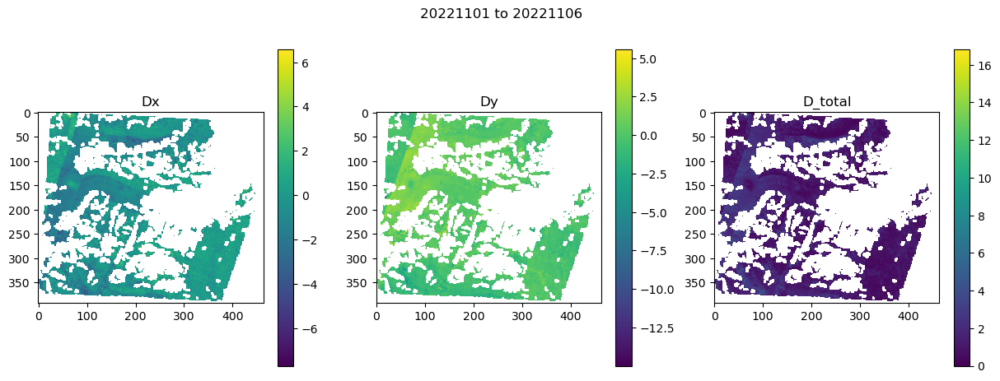

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.48099303245544434
20221106 20221111
PS_20221106_clipped.tif PS_20221111_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221106 20221111

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
W

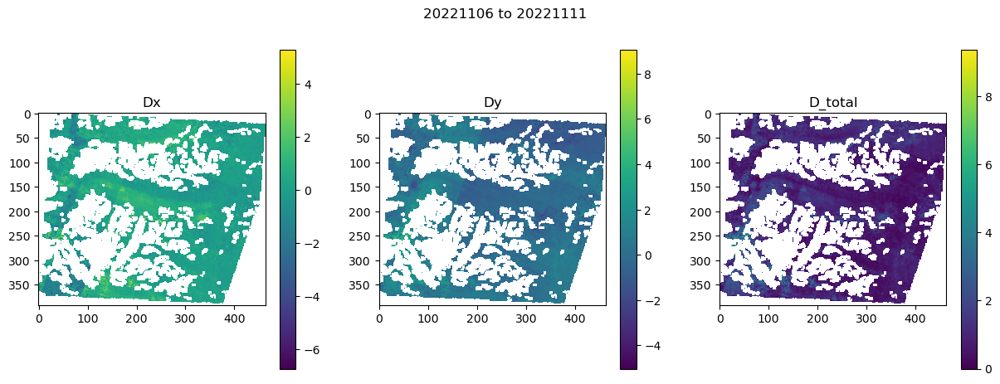

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.37335896492004395
PS_20221111_clipped.tif PS_20221116_clipped.tif
removed window_rdr_off2vel_y_vec.tif
removed window_location.tif
removed window_rdr_off2vel_x_vec.tif
Old files cleared.

Obtained DEM info.

Processing optical images with geogrid.

Optical images coregistered.

20221111 20221116

Reading input images locally from files

Optical Image parameters: 
X-direction coordinate: 296880.0  5.0
Y-direction coordinate: 6707505.0  -5.0
Dimensions: 9292  7843

Map inputs: 
EPSG: 32608
Smallest Allowable Chip Size in m: 100
Repeat Time: 432000.0
XLimits: 296880.0  343340.0
YLimits: 6668290.0  6707505.0
Extent in km: 46.46  39.215
DEM: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_100m.tif
Slopes: /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdx_100m.tif  /Volumes/SURGE_DISK/LO/LO_ArcticDEM_clipped_dhdy_100m.tif

Outputs: 
Window locations: window_location.tif
Window rdr_off2vel_

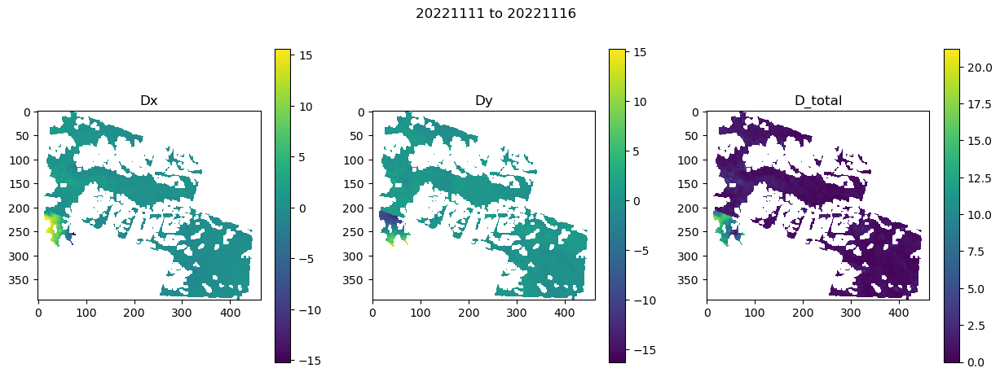

Write Outputs Start!!!
Offset.mat written.
Offset.tif written.
Velocity.tif written.
Write Outputs Done!!!
0.4548947811126709
No image pair with correct time separation found. Skip to next.
Finished searching.


In [173]:
# try multiple chip sizes and sats
for platform in PLATFORM_LIST:
    # assign the folder path based on the platform
    if platform == 'S2': # sentinel-2
        path = s2path
        ext = '_clipped.tif' # image filename extension
        img_type = 'OPT'
        date_split_idx = 2 # split filename by underscore, index corresponds to image date
    elif platform == 'LS': # landsat
        path = LSpath
        ext = '.TIF'
        img_type = 'OPT'
        date_split_idx = 3
    elif platform == 'PS': # PlanetScope
        path = PSpath
        ext = '.tif' 
        img_type = 'OPT'
        date_split_idx = 1
    else:
        print('Platform', platform, 'not recognized. Options are "S2", "LS", "PS"')

    # record all possible images and their dates
    dates = []; files = []  
    for file in os.listdir(path):
        if file.endswith(ext):
            date = file.split('_')[date_split_idx] # grab the date from the filename
            dates.append(date); files.append(file) # store the date and filename
    files_df = pd.DataFrame(list(zip(files,dates)),columns=['filename','date'])
    files_df = files_df.sort_values(by='date',ignore_index=True) # sort the dataframe by ascending date
    files_df = files_df[(files_df.date >= startdate) & (files_df.date <= enddate)]
    files_df = files_df.reset_index(drop=True) # reset index for searching
    print("Number of files found:",len(files_df))
    
    for min_chipsize in CHIPSIZE_LIST: # MULTIPLE CHIP SIZES
        MINCHIPSIZE = min_chipsize
        # generate geogrid inputs and grab outfilenames
#         [dem_outfile, dhdx_outfile, dhdy_outfile, 
#          vx_outfile, vy_outfile, srx_outfile, 
#          sry_outfile, ssm_outfile, tg_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
#                                                                          refvpath, vx_fname, vy_fname, 
#                                                                          sr_scaling)
        [dem_outfile, dhdx_outfile, dhdy_outfile] = generate_geogrid_inputs(min_chipsize, dempath, demname, 
                                                                         refvpath, vx_fname, vy_fname, 
                                                                         sr_scaling)
        #######################################################################
        # # CHOOSE OPTIONAL INPUTS: (set as '' to leave blank)
        # # 1) surface slope:
        #   dhdx = ''; dhdy = ''  
        dhdx = dempath+dhdx_outfile; dhdy = dempath+dhdy_outfile
        
        # # 2) reference velocity:
        vx = ''; vy = ''    
#         vx = refvpath+'vx_'+str(MINCHIPSIZE)+'m.tif'; vy = refvpath+'vy_'+str(MINCHIPSIZE)+'m.tif'
        
        # # 3) chip sizes:
        csminx = ''; csminy = ''
        csmaxx = ''; csmaxy = ''  
        #             csminx = refvpath+csminx_fname; csminy = refvpath+csminy_fname
        #             csmaxx = refvpath+csmaxx_fname; csmaxy = refvpath+csmaxy_fname
        
        # # 4) stable surface mask:
        ssm = ''
        #             ssm = refvpath+ssm_outfile # stable surface mask 
        
        # # 5) search range limit:
        srx = ''; sry = '' # for best results, never input search range limit
        #######################################################################
        
        for rownum in range(0,len(files_df)-1):
            if rownum == 0: # for the first row, idx1 = 0 and idx2 = 1
                idx1 = rownum
            idx2 = idx1+1 # reset index 2 as the next item 

            if idx1 < len(files_df) and idx2 < len(files_df): # don't surpass the end of the data
                # identify the successive image pairs:
                m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

                # grab the two dates and convert to datetime objects
                d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
#                 if platform == 'PS':
#                     d1s = d1s[:-4]; d2s = d2s[:-4]
                
                # Skip if output already exists for this combination of parameters
                if not os.path.exists(out_path+'velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif'):
                    # calculate time separation
                    d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                    dt = d2-d1; dt = int(dt.days)

                    # evaluate if dates are within the appropriate time separation
                    while (dt < min_dt or dt > max_dt): # dt is outside of appropriate time separation
                        idx2 += 1 # increment index 2

                        if idx2 > len(files_df)-1:
                            print('No image pair with correct time separation found. Skip to next.')
                            idx2 = idx1+1 # reset index 2 as the next item 
                            m = None; s = None
                            break

                        # Keep looking for the correct time separation:
                        m = files_df.loc[idx1,'filename']; s = files_df.loc[idx2, 'filename']

                        # grab the two dates and convert to datetime objects
                        d1s = m.split('_')[date_split_idx]; d2s = s.split('_')[date_split_idx]
                        print(d1s, d2s)
                        d1 = datetime.datetime.strptime(d1s, '%Y%m%d'); d2 = datetime.datetime.strptime(d2s, '%Y%m%d')
                        dt = d2-d1; dt = int(dt.days)

                    # run geogrid and autoRIFT
                    if m is not None and s is not None:
                        print(m,s)
                        indir_m = path+m; indir_s = path+s # path to the two images
                        
                        # ADJUST CODE TO NOT HAVE TO CHANGE THIS BETWEEN SK AND LOWELL
                        dem = dempath+dem_outfile
                        dhdx = dempath+dhdx_outfile
                        dhdy = dempath+dhdy_outfile
                        ###################### RUN GEOGRID ################################
                        run_geogrid_inhouse(out_path, indir_m, indir_s, MINCHIPSIZE, NO_DATA_VAL, dem, # required inputs
                                            dhdx, dhdy, vx, vy, srx, sry, csminx, csminy, csmaxx, csmaxy, ssm)
                        
                        ##################### PREP AUTORIFT ##############################
                        gp = out_path # identify files produced from geogrid
                        # remove all empty grids
                        for grid in os.listdir(gp): 
                            if grid.startswith('window') and grid.endswith('.tif'):
                                reader = rio.open(gp+grid) # read dataset
                                data_found = False 
                                for band in range(1,reader.count+1):
                                    testband = reader.read(band) # read in the band
                                    if np.count_nonzero(testband[testband != NO_DATA_VAL]) > 0:
                                        data_found = True
                                if not data_found:
                                    print(grid, 'has no data. Removed.')
                                    os.remove(gp+grid)

                        # fill in AutoRIFT parameters using the files
                        mpflag = 0 # leave multiprocessing off

                        # GRID LOCATION (required) from window_location.tif
                        grid_location = rio.open(gp+'window_location.tif')
                        xGrid = grid_location.read(1) # 1st band in window location
                        yGrid = grid_location.read(2) # 2nd band in window location

                        # optional parameters (default None or zero until filled)
                        init_offset = None; search_range = None
                        chip_size_min = None; chip_size_max = None
                        offset2vx = None; offset2vy = None; stable_surface_mask = None
                        Dx0 = None; Dy0 = None; CSMINx0 = None
                        SRx0 = None; SRy0 = None;
                        CSMAXx0 = None; CSMAXy0 = None; SSM = None
                        noDataMask = np.zeros(xGrid.shape).astype(int)

                        if os.path.exists(gp+'window_offset.tif'): # Dx0 and Dy0 from window_offset.tif
                            init_offset = rio.open(gp+'window_offset.tif')
                            Dx0 = init_offset.read(1); Dy0 = init_offset.read(2)
                        if os.path.exists(gp+'window_search_range.tif'): # SRx0 and SRy0 from window_search_range.tif
                            search_range = rio.open(gp+'window_search_range.tif')
                            SRx0 = search_range.read(1); SRy0 = search_range.read(2)
                        if os.path.exists(gp+'window_chip_size_min.tif'): # CSMINx0 and CSMINy0 from window_chip_size_min.tif
                            chip_size_min = rio.open(gp+'window_chip_size_min.tif')
                            CSMINx0 = chip_size_min.read(1); CSMINy0 = chip_size_min.read(2)
                        if os.path.exists(gp+'window_chip_size_max.tif'): # CSMAXx0 and CSMAXy0 from window_chip_size_max.tif
                            chip_size_max = rio.open(gp+'window_chip_size_max.tif')
                            CSMAXx0 = chip_size_max.read(1); CSMAXy0 = chip_size_max.read(2)
                        if os.path.exists(gp+'window_rdr_off2vel_x_vec.tif'): # offset2vx from window_rdr_off2vel_x_vec.tif
                            offset2vx = gp+'window_rdr_off2vel_x_vec.tif' # path to be read in with GDAL
                        if os.path.exists(gp+'window_rdr_off2vel_y_vec.tif'): # offset2vy from window_rdr_off2vel_y_vec.tif
                            offset2vy = gp+'window_rdr_off2vel_y_vec.tif' 
                        if os.path.exists(gp+'window_stable_surface_mask.tif'): # noDataMask from window_stable_surface_mask.tif
                            stable_surface_mask = rio.open(gp+'window_stable_surface_mask.tif')
                            noDataMask = stable_surface_mask.read(1)

                        # other parameters
                        nodata = NO_DATA_VAL # use same as in previous steps
                        geogrid_run_info=None
                        print('AutoRIFT parameters loaded.')

                        ##################### RUN AUTORIFT ##############################
                        # run autoRIFT with function
                        run_autoRIFT_inhouse(indir_m, indir_s, out_path, mpflag, xGrid, yGrid, # required parameters
                                                 FILTER, WALLISFILTERWIDTH, SPARSE_SEARCH_SAMPLE_RATE, 
                                                 OVERSAMPLE_RATIO, MINCHIPSIZE,
                                                 Dx0, Dy0, CSMINx0, SRx0, SRy0, CSMAXx0, CSMAXy0, SSM, # optional parameters
                                             noDataMask, nodata, geogrid_run_info=None)
                else:
                    print('velocity_'+d1s+'_'+d2s+'_'+str(min_chipsize)+'m_'+platform+'.tif already exists.')
                idx1 = idx2 # set the second image index as the new first image index
                if idx2 >= len(files_df)-1:
                    print('Finished searching.')
                    break
